In [1]:
# Passage extremes

In [2]:
import sys; sys.path.append('../..')

In [3]:
from abslithist import *

In [4]:

def get_current_dfall(corpus_name='CanonFiction'):
    cdf=pd.DataFrame(readgen_jsonl(PATH_PSGS))
    cdf=cdf[cdf.num_total == cdf.num_total.max()]
    cdf['abs-conc']=cdf['num_abs']-cdf['num_conc']
    cdf['abs/conc']=cdf['num_abs']/cdf['num_conc']

    import lltk
    C=lltk.load(corpus_name)
    cdf['abs/conc']=cdf['num_abs']/cdf['num_conc']
    cdf['abs-conc']=cdf['num_abs']-cdf['num_conc']
    cdf['abs-conc_z']=zscore(cdf['abs-conc'])
    dfall=cdf.merge(C.metadata,on='id').sort_values('abs-conc')
    dfall=dfall[
        ['id','year','title','author','passage','abs-conc','abs-conc_z',
        'num_abs','num_conc','num_neither','num_types','num_total','num_tokens']
    ]
    return dfall

In [5]:
dfall=get_current_dfall()
dfall

Reading data.absconc.CanonFiction.psgs.v9-zcut05.jsonl: 100%|██████████| 548268/548268 [00:34<00:00, 16016.52it/s]


,id,year,title,author,passage,abs-conc,abs-conc_z,num_abs,num_conc,num_neither,num_types,num_total,num_tokens
313913,chadwyck.Scott.Kenilworth_in_the_Waverle.1316,1831,"Kenilworth [in, the Waverley Novels]","Scott, Walter, Sir, 1771-1832",***richly*** embrothered with my Lo. ***arms**...,-90,-3.138305,1,91,8,61,100,100
38732,Rabelais.Gargantua and Pantagruel,1534,Gargantua and Pantagruel,Rabelais,"***Fawns***, ***deer***.\\ ***Lumber*** ***pie...",-88,-3.075373,1,89,10,83,100,100
38845,Rabelais.Gargantua and Pantagruel,1534,Gargantua and Pantagruel,Rabelais,***Eggs***.\\\\ ***Pan***. How do they Like'em...,-87,-3.043907,1,88,11,56,100,100
485021,markmark.Le Guin.Always_Coming_Home.1551,1985,Always Coming Home,"Le Guin, Ursula K.","***tomatoes*** are not in ***season***, ***dou...",-87,-3.043907,1,88,11,72,100,100
461364,markmark.Hemingway.In_Our_Time.1497,1925,In Our Time,"Hemingway, Ernest Miller",. He ***shook*** the ***skillet*** ***sideways...,-86,-3.012441,1,87,12,73,100,100
...,...,...,...,...,...,...,...,...,...,...,...,...,...
519750,markmark.Stein.The_Making_of_Americans.1630,1925,The Making of Americans,"Stein, Gertrude",to be doing to be one going on being ```living...,95,2.682942,96,1,3,16,100,100
519746,markmark.Stein.The_Making_of_Americans.1630,1925,The Making of Americans,"Stein, Gertrude",. Some are almost really certain sometime that...,98,2.777341,98,0,2,8,100,100
519824,markmark.Stein.The_Making_of_Americans.1630,1925,The Making of Americans,"Stein, Gertrude",. Any one in any family ```living``` can be on...,99,2.808807,99,0,1,6,100,100
519693,markmark.Stein.The_Making_of_Americans.1630,1925,The Making of Americans,"Stein, Gertrude",```wanting``` not ```angry``` ```feeling``` be...,99,2.808807,99,0,1,10,100,100


In [8]:


def show_extremes(dfall, name='concrete',corpus_name='CanonFiction',topn=100):
    C=lltk.load(corpus_name)
    most_conc = dfall.head(topn)
    most_abs = dfall[dfall.title!='The Making of Americans'].sort_values('abs-conc',ascending=False).head(topn)
#     most_abs = dfall.sort_values('abs-conc',ascending=False).head(topn)
    most = most_conc if name.startswith('c') else most_abs
    
    for i,(index,row) in enumerate(tqdm(list(most.iterrows()))):
        idx=row.id
        t=C.textd[idx]
        title=f'''#{i+1} most {name} passage: {row.author.split(',')[0]}, _{row.title[:50]}_ ({row.year})'''
        showpsg(
            row.passage,
            title,
            t.txt,
            periods={year2period(t.year)}
        )
    #     break


  0%|          | 0/100 [00:00<?, ?it/s]

#### #1 most abstract passage: McHenry, _O'Halloran; or, The Insurgent Chief. An Irish Hist_ (1824)

<p>; and that it was my <abs><conc127>duty</conc127></abs> to <neither><conc436>lend</conc436></neither> it my <abs><conc148>support</conc148></abs>. With <abs><conc021>respect</conc021></abs> to the <abs><conc017>views</conc017></abs> of such of my <abs><conc207>unfortunate</conc207></abs> <abs><conc078>coadjutors</conc078></abs>, as were <abs><conc150>active</conc150></abs> in this <abs><conc101>disastrous</conc101></abs> <abs><conc106>attempt</conc106></abs> to <abs><conc022>emancipate</conc022></abs> our country, so far as I am <neither><conc291>acquainted</conc291></neither> with them, they were <neither><conc285>directed</conc285></neither> only to her <abs><conc132>benefit</conc132></abs>. If they had any <abs><conc246>sinister</conc246></abs> <abs><conc017>views</conc017></abs> of <abs><conc077>ambition</conc077></abs> or <abs><conc015>personal</conc015></abs> <abs><conc022>aggrandizement</conc022></abs>, or the <neither><conc281>introduction</conc281></neither> of any <neither><conc556>favourite</conc556></neither> <abs><conc098>national</conc098></abs> <neither><conc341>establishment</conc341></neither>, whither <abs><conc069>civil</conc069></abs> or <abs><conc043>religious</conc043></abs>, <abs><conc001>inimical</conc001></abs> to <abs><conc024>true</conc024></abs> <abs><conc056>liberty</conc056></abs>, I know nothing of them. What would have been their <abs><conc010>conduct</conc010></abs> had we been <abs><conc131>successful</conc131></abs>, I can not say; but I can state what I believe would have been my own. I never should have <neither><conc382>consented</conc382></neither> to the <neither><conc341>establishment</conc341></neither> of a French <abs><conc082>influence</conc082></abs> in the <abs><conc050>government</conc050></abs> of this country. We <abs><conc225>solicited</conc225></abs> the <abs><conc137>aid</conc137></abs> of France in the <abs><conc145>struggle</conc145></abs> for our <abs><conc099>independence</conc099></abs>, but not at the <neither><conc443>price</conc443></neither> of <abs><conc207>permitting</conc207></abs> her <abs><conc050>government</conc050></abs> to <abs><conc018>infringe</conc018></abs> that <abs><conc099>independence</conc099></abs>. I believe that my <abs><conc052>colleagues</conc052></abs> were of the same mind with myself on this <abs><conc047>subject</conc047></abs>. In our <abs><conc227>conversations</conc227></abs>, we have often <neither><conc299>agreed</conc299></neither> in the <abs><conc050>sentiment</conc050></abs>, that if we must <abs><conc240>yield</conc240></abs> to a <abs><conc170>foreign</conc170></abs> <abs><conc098>connexion</conc098></abs> in <abs><conc163>matters</conc163></abs> of state, it should be a <abs><conc098>connexion</conc098></abs> with Britain, in <abs><conc236>preference</conc236></abs> to any other country.-- The from of <abs><conc050>government</conc050></abs> I should have <neither><conc368>preferred</conc368></neither>, would have been a <abs><conc144>republic</conc144></abs> of the <abs><conc017>democratical</conc017></abs> <neither><conc265>kind</conc265></neither>; but so <abs><conc236>constituted</conc236></abs>, as while it <neither><conc288>allowed</conc288></neither> the people their just <abs><conc056>ascendancy</conc056></abs> in the <abs><conc098>national</conc098></abs> <abs><conc124>affairs</conc124></abs>, it would have <neither><conc269>afforded</conc269></neither> <abs><conc181>strength</conc181></abs> and <abs><conc098>energy</conc098></abs> <abs><conc225>sufficient</conc225></abs> to the <abs><conc125>executive</conc125></abs> for every useful <abs><conc211>purpose</conc211></abs>, whither <abs><conc183>external</conc183></abs> or <abs><conc169>internal</conc169></abs>. Should the <abs><conc061>attainment</conc061></abs> of this <neither><conc264>desirable</conc264></neither> <neither><conc448>species</conc448></neither> of <abs><conc050>government</conc050></abs> have been <abs><conc110>impracticable</conc110></abs>, the state of things that I would have next <neither><conc368>preferred</conc368></neither>, would have been British <abs><conc098>connexion</conc098></abs> without British <abs><conc017>authority</conc017></abs>. I should have no <abs><conc210>objection</conc210></abs> for the king of Great Britain to be our king, <abs><conc070>constitutionally</conc070></abs> <abs><conc118>limited</conc118></abs>, and without the <abs><conc028>power</conc028></abs> of <abs><conc180>appointing</conc180></abs> any <neither><conc295>foreigner</conc295></neither> our <neither><conc299>viceroy</conc299></neither>, if it were found that such a state of things would be necessary to the <abs><conc252>preservation</conc252></abs> of <abs><conc093>peace</conc093></abs> between the two <abs><conc249>countries</conc249></abs>. The <abs><conc219>United</conc219></abs> Irishmen have been <abs><conc241>charged</conc241></abs> with the <abs><conc191>intention</conc191></abs> of <abs><conc136>establishing</conc136></abs> the <abs><conc194>Catholic</conc194></abs> as the <abs><conc098>national</conc098></abs> <abs><conc025>religion</conc025></abs>. Whatever <abs><conc076>dispositions</conc076></abs> of the <neither><conc265>kind</conc265></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

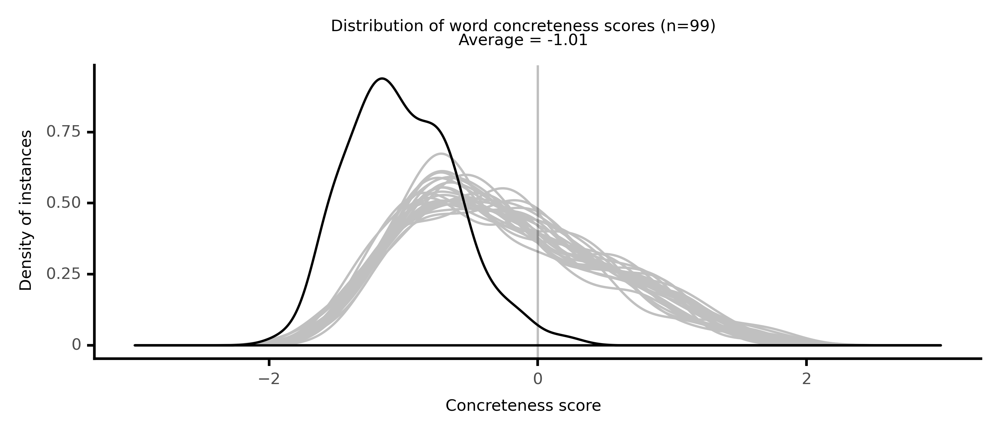

<ggplot: (8764106402485)>

  1%|          | 1/100 [00:11<18:15, 11.06s/it]

#### #2 most abstract passage: Plato, _Dialogues_ (-375)

<p>of a thing, would you not? That is my <abs><conc014>opinion</conc014></abs>: would it not be yours also? Mine also, he said. And <abs><conc142>suppose</conc142></abs> that some one were to ask us, saying,' O Protagoras, and you, Socrates, what about this thing which you were <abs><conc082>calling</conc082></abs> <abs><conc009>justice</conc009></abs>, is it just or <abs><conc025>unjust</conc025></abs>?'-- and I were to <abs><conc092>answer</conc092></abs>, just: would you <abs><conc078>vote</conc078></abs> with me or against me? With you, he said. Thereupon I should <abs><conc092>answer</conc092></abs> to him who <neither><conc514>asked</conc514></neither> me, that <abs><conc009>justice</conc009></abs> is of the <abs><conc157>nature</conc157></abs> of the just: would not you? Yes, he said. And <abs><conc142>suppose</conc142></abs> that he went on to say: Well now, is there also such a thing as <abs><conc101>holiness</conc101></abs>?'-- we should <abs><conc092>answer</conc092></abs>, Yes,' if I am not <abs><conc166>mistaken</conc166></abs>? Yes, he said. Which you would also <abs><conc002>acknowledge</conc002></abs> to be a thing-- should we not say so? He <abs><conc230>assented</conc230></abs>.' And is this a sort of thing which is of the <abs><conc157>nature</conc157></abs> of the <abs><conc149>holy</conc149></abs>, or of the <abs><conc157>nature</conc157></abs> of the <abs><conc207>unholy</conc207></abs>?' I should be <neither><conc400>angry</conc400></neither> at his <neither><conc730>putting</conc730></neither> such a <abs><conc119>question</conc119></abs>, and should say,' <abs><conc171>Peace</conc171></abs>, man; nothing can be <abs><conc149>holy</conc149></abs> if <abs><conc101>holiness</conc101></abs> is not <abs><conc149>holy</conc149></abs>. What would you say? Would you not <abs><conc092>answer</conc092></abs> in the same way? Certainly, he said. And then after this <abs><conc142>suppose</conc142></abs> that he came and <neither><conc514>asked</conc514></neither> us,'What were you saying just now? Perhaps I may not have <neither><conc401>heard</conc401></neither> you <abs><conc065>rightly</conc065></abs>, but you seemed to me to be saying that the <neither><conc615>parts</conc615></neither> of <abs><conc125>virtue</conc125></abs> were not the same as one another.' I should reply, You certainly <neither><conc401>heard</conc401></neither> that said, but not, as you331 <abs><conc079>imagine</conc079></abs>, by me; for I only <neither><conc514>asked</conc514></neither> the <abs><conc119>question</conc119></abs>; Protagoras gave the <abs><conc092>answer</conc092></abs>.' And <abs><conc142>suppose</conc142></abs> that he <neither><conc710>turned</conc710></neither> to you and said,' Is this <abs><conc034>true</conc034></abs>, Protagoras? and do you <abs><conc070>maintain</conc070></abs> that one part of <abs><conc125>virtue</conc125></abs> is unlike another, and is this your <abs><conc219>position</conc219></abs>?'-- how would you <abs><conc092>answer</conc092></abs> him? I could not help <abs><conc010>acknowledging</conc010></abs> the <abs><conc025>truth</conc025></abs> of what he said, Socrates. Well then, Protagoras, we will <abs><conc086>assume</conc086></abs> this; and now supposing that he <abs><conc107>proceeded</conc107></abs> to say fiuther,'Then <abs><conc101>holiness</conc101></abs> is not of the <abs><conc157>nature</conc157></abs> of <abs><conc009>justice</conc009></abs>, nor <abs><conc009>justice</conc009></abs> of the <abs><conc157>nature</conc157></abs> of I The <abs><conc015>continuation</conc015></abs> of the argument.153 <abs><conc101>holiness</conc101></abs>, but of the <abs><conc157>nature</conc157></abs> of <abs><conc070>unholiness</conc070></abs>; and <abs><conc101>holiness</conc101></abs> is of Protagtmu, the <abs><conc157>nature</conc157></abs> of the not just, and therefore of the <abs><conc025>unjust</conc025></abs>, and the Sockatbs, <abs><conc025>unjust</conc025></abs> is the <abs><conc207>unholy</conc207></abs>:' how shall we <abs><conc092>answer</conc092></abs> him? I should^« ot^«>« as. certainly <abs><conc092>answer</conc092></abs> him on my own behalf that <abs><conc009>justice</conc009></abs> is <abs><conc149>holy</conc149></abs>, hoUness and and that <abs><conc101>holiness</conc101></abs> is just; and I would say in Like manner on J'''»^''•' very much your behalf also, if you would allow me, that <abs><conc009>justice</conc009></abs> is either <neither><conc259>alike</conc259></neither>. the same with <abs><conc101>holiness</conc101></abs>, or very nearly the same; and above all I would <abs><conc003>assert</conc003></abs> that <abs><conc009>justice</conc009></abs> is Like <abs><conc101>holiness</conc101></abs> and <abs><conc101>holiness</conc101></abs> is Like <abs><conc009>justice</conc009></abs>; and I wish that you would tell me whither I may be <abs><conc156>permitted</conc156></abs> to give this <abs><conc092>answer</conc092></abs> on your behalf, and whither you would <abs><conc155>agree</conc155></abs> with me. He replied, I can not <abs><conc065>simply</conc065></abs> <abs><conc155>agree</conc155></abs>, Socrates, to the propo- sition that <abs><conc009>justice</conc009></abs> is <abs><conc149>holy</conc149></abs> and that <abs><conc101>holiness</conc101></abs> is just, for there <abs><conc227>appears</conc227></abs> to me to be a <abs><conc131>difference</conc131></abs> between them. But what matter? if you please I please; and let us <abs><conc086>assume</conc086></abs>, if you will, that <abs><conc009>justice</conc009></abs> is <abs><conc149>holy</conc149></abs>, and that <abs><conc101>holiness</conc101></abs> is just. <abs><conc052>Pardon</conc052></abs> me, I replied; I do not want this' if you wish or' if you will sort of <abs><conc063>conclusion</conc063></abs> to be proven, but I want you and me to be proven: I mean to say that the <abs><conc063>conclusion</conc063></abs> will be best proven</p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

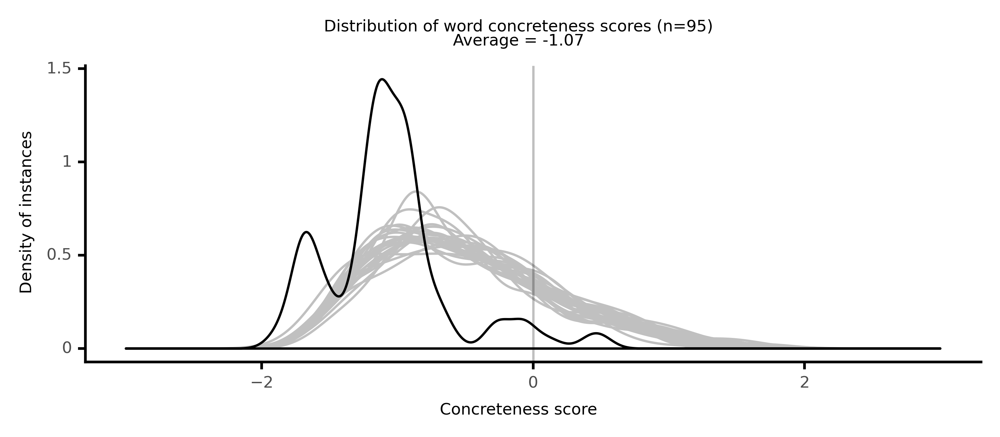

<ggplot: (8764171720817)>

  2%|▏         | 2/100 [00:25<19:35, 12.00s/it]

#### #3 most abstract passage: Johnston, _Chrysal; or adventures of a guinea_ (1760)

<p>of both, which are to be the <abs><conc065>rule</conc065></abs> of their <abs><conc007>actions</conc007></abs>. But, as it is <abs><conc133>impossible</conc133></abs> for <abs><conc115>human</conc115></abs> <abs><conc033>wisdom</conc033></abs> to <abs><conc068>foresee</conc068></abs> and <neither><conc367>provide</conc367></neither> for every <abs><conc210>occurrence</conc210></abs> that may <neither><conc262>happen</conc262></neither>, there is <abs><conc022>essentially</conc022></abs> <abs><conc023>implied</conc023></abs> in the first <abs><conc101>trust</conc101></abs> a further <abs><conc020>power</conc020></abs> of <abs><conc229>applying</conc229></abs> <neither><conc295>unprovided</conc295></neither> <neither><conc291>remedies</conc291></neither> to <abs><conc118>unforeseen</conc118></abs> <abs><conc160>cases</conc160></abs>, for the <abs><conc117>safety</conc117></abs> and <abs><conc139>advantage</conc139></abs> of the whole. If it be <abs><conc104>objected</conc104></abs> that these <neither><conc291>remedies</conc291></neither> may sometime be <abs><conc061>injurious</conc061></abs> to <abs><conc051>individuals</conc051></abs>, by being in- <neither><conc253>judiciously</conc253></neither> or <abs><conc123>wrongfully</conc123></abs> <abs><conc226>applied</conc226></abs>, the <abs><conc148>answer</conc148></abs> is obdous. The Bufferings of a few are not to be <neither><conc597>set</conc597></neither> in competition-^dth the <abs><conc117>safety</conc117></abs> of the many. Beside, if the <neither><conc291>remedies</conc291></neither> were never to be <abs><conc226>applied</conc226></abs>, where there was a <abs><conc079>possibility</conc079></abs> of a <abs><conc168>mistake</conc168></abs>, the <abs><conc032>evil</conc032></abs> might <neither><conc262>happen</conc262></neither> in the time necessary for <abs><conc075>inquiry</conc075></abs> and <abs><conc071>deliberation</conc071></abs>. For, though <abs><conc071>penal</conc071></abs> <abs><conc023>laws</conc023></abs> are <neither><conc287>designed</conc287></neither> only to <neither><conc260>prevent</conc260></neither> <abs><conc039>future</conc039></abs> by the <abs><conc040>punishment</conc040></abs> of <neither><conc366>passed</conc366></neither> <abs><conc059>crimes</conc059></abs>, yet where such <abs><conc059>crimes</conc059></abs>, if <abs><conc134>committed</conc134></abs>, vdll <neither><conc318>exceed</conc318></neither> the <neither><conc442>reach</conc442></neither> of <abs><conc040>punishment</conc040></abs> and <abs><conc094>defeat</conc094></abs> the <abs><conc023>laws</conc023></abs>, the <abs><conc020>power</conc020></abs> of <abs><conc103>prevention</conc103></abs> must be <abs><conc058>exerted</conc058></abs> <neither><conc336>earlier</conc336></neither>, to <abs><conc038>anticipate</conc038></abs> them before <abs><conc089>commission</conc089></abs>. Without such <abs><conc020>power</conc020></abs> the <abs><conc101>trust</conc101></abs> of <abs><conc027>government</conc027></abs> would be <abs><conc102>imperfect</conc102></abs> and <abs><conc043>inadequate</conc043></abs> to the end; as, if no <abs><conc040>punishment</conc040></abs> could be <abs><conc116>inflicted</conc116></abs> thus for <abs><conc103>prevention</conc103></abs>, but by <abs><conc203>prescribed</conc203></abs> <neither><conc514>forms</conc514></neither>, <abs><conc115>human</conc115></abs> <abs><conc128>ingenuity</conc128></abs>, ever most <neither><conc559>fertile</conc559></neither> in <abs><conc032>evil</conc032></abs>, would <neither><conc244>devise</conc244></neither> <abs><conc131>expedients</conc131></abs> to <abs><conc093>evade</conc093></abs> it, till <abs><conc019>perpetration</conc019></abs> should <abs><conc208>secure</conc208></abs> <abs><conc089>impunity</conc089></abs>, as I said before, perhaps to the <neither><conc297>ruin</conc297></neither> of the state. For these <abs><conc058>reasons</conc058></abs> an <abs><conc134>extraordinary</conc134></abs> <abs><conc020>power</conc020></abs> must have been <abs><conc035>implicitly</conc035></abs> given for <abs><conc134>extraordinary</conc134></abs> <abs><conc160>cases</conc160></abs>, or the good of the <abs><conc115>community</conc115></abs>, which is the end of <abs><conc027>government</conc027></abs>, can not, be obtained. If this <abs><conc020>power</conc020></abs>, though, should be <abs><conc095>abused</conc095></abs>, the <neither><conc283>sacred</conc283></neither> <abs><conc032>spirit</conc032></abs> of the <abs><conc023>laws</conc023></abs> of your <abs><conc211>happy</conc211></abs> country will <neither><conc370>supply</conc370></neither> the <abs><conc086>inevitable</conc086></abs> <abs><conc105>defect</conc105></abs> of the latter, and <abs><conc109>grant</conc109></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

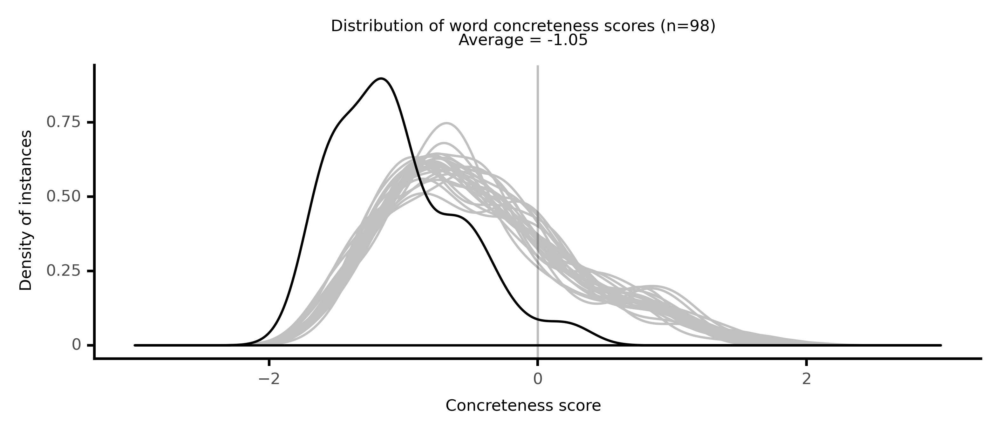

<ggplot: (8764106454013)>

  3%|▎         | 3/100 [00:40<20:48, 12.87s/it]

#### #4 most abstract passage: Newman, _Loss and Gain_ (1848)

<p>once or twice, and <neither><conc379>asked</conc379></neither> information of Mr. Upton the <neither><conc298>tutor</conc298></neither>, who was quite <neither><conc389>ready</conc389></neither> to give it; but nothing came of these <abs><conc195>applications</conc195></abs> as regards the <abs><conc162>object</conc162></abs> which <abs><conc201>led</conc201></abs> him to make them. One <abs><conc217>difficulty</conc217></abs> which Charles <abs><conc182>experienced</conc182></abs> was, to know whither, according to the <neither><conc504>Articles</conc504></neither>, <abs><conc020>divine</conc020></abs> <abs><conc013>truth</conc013></abs> was <neither><conc302>directly</conc302></neither> given us, or whither we had to <abs><conc097>seek</conc097></abs> it for ourselves from <abs><conc123>Scripture</conc123></abs>. Several <neither><conc504>Articles</conc504></neither> <abs><conc201>led</conc201></abs> to this <abs><conc153>question</conc153></abs>; and Mr. Upton, who was a High-Churchman, answered him, that the <neither><conc276>saving</conc276></neither> <abs><conc008>doctrine</conc008></abs> neither was given nor was to be <abs><conc133>sought</conc133></abs>, but that it was <abs><conc230>proposed</conc230></abs> by the <neither><conc309>Church</conc309></neither>, and <abs><conc155>proved</conc155></abs> by the <abs><conc038>individual</conc038></abs>. Charles did not see this <abs><conc080>distinction</conc080></abs> between <abs><conc194>seeking</conc194></abs> and <abs><conc130>proving</conc130></abs>; for how can we <abs><conc060>prove</conc060></abs> except by <abs><conc194>seeking</conc194></abs>( in <abs><conc123>Scripture</conc123></abs>) for <abs><conc100>reasons</conc100></abs>? He put the <abs><conc153>question</conc153></abs> in another from, and <neither><conc379>asked</conc379></neither> if the <abs><conc057>Christian</conc057></abs> <abs><conc025>Religion</conc025></abs> <neither><conc288>allowed</conc288></neither> of <abs><conc152>private</conc152></abs> <abs><conc006>judgement</conc006></abs>? This was no <abs><conc054>abstruse</conc054></abs> <abs><conc153>question</conc153></abs>, and a very <abs><conc040>practical</conc040></abs> one. Had he <neither><conc379>asked</conc379></neither> a Wesleyan or <abs><conc109>Independent</conc109></abs>, he would have had an <abs><conc019>unconditional</conc019></abs> <abs><conc207>answer</conc207></abs> in the <neither><conc334>affirmative</conc334></neither>; had he <neither><conc379>asked</conc379></neither> a <abs><conc194>Catholic</conc194></abs>, he would have been told that we used our <abs><conc152>private</conc152></abs> <abs><conc006>judgement</conc006></abs> to find the <neither><conc309>Church</conc309></neither>, and then the <neither><conc309>Church</conc309></neither> <abs><conc189>superseded</conc189></abs> it; but from this Oxford <abs><conc020>divine</conc020></abs> he could not get a <abs><conc250>distinct</conc250></abs> <abs><conc207>answer</conc207></abs>. First, he was told that <abs><conc078>doubtless</conc078></abs> we must use our <abs><conc006>judgement</conc006></abs> in the <abs><conc088>determination</conc088></abs> of <abs><conc043>religious</conc043></abs> <abs><conc008>doctrine</conc008></abs>; but next he was told that it was <abs><conc081>sin</conc081></abs>( as it <abs><conc073>undoubtedly</conc073></abs> is) to <abs><conc082>doubt</conc082></abs> the <abs><conc008>doctrine</conc008></abs> of the <neither><conc343>Blessed</conc343></neither> <neither><conc319>Trinity</conc319></neither>. Yet, while he was told that to <abs><conc082>doubt</conc082></abs> of that <abs><conc008>doctrine</conc008></abs> was a <abs><conc081>sin</conc081></abs>, he was told in another <neither><conc391>conversation</conc391></neither> that our <abs><conc137>highest</conc137></abs> state here is one of <abs><conc082>doubt</conc082></abs>. What did this mean? Surely <abs><conc058>certainty</conc058></abs> was <abs><conc146>simply</conc146></abs> necessary on some <neither><conc361>points</conc361></neither>, as on the <abs><conc162>Object</conc162></abs> of <abs><conc208>worship</conc208></abs>; how could we <abs><conc208>worship</conc208></abs> what we <abs><conc155>doubted</conc155></abs> of? The two <abs><conc031>acts</conc031></abs> were <neither><conc447>contrasted</conc447></neither> by the <abs><conc233>Evangelist</conc233></abs>; when the <abs><conc131>disciples</conc131></abs> saw our Lord after the <abs><conc203>resurrection</conc203></abs>, they <neither><conc338>worshipped</conc338></neither> Him, but some <abs><conc155>doubted</conc155></abs>;'' yet, in spite of this, he was told that there was <neither><conc311>impatience</conc311></neither>'' in the very <abs><conc104>idea</conc104></abs> of <abs><conc183>desiring</conc183></abs> <abs><conc058>certainty</conc058></abs>. At another time he <neither><conc379>asked</conc379></neither> whither the <abs><conc147>anathemas</conc147></abs> of the Athanasian <abs><conc062>Creed</conc062></abs> <abs><conc211>applied</conc211></abs> to all its <abs><conc139>clauses</conc139></abs>; for <abs><conc233>instance</conc233></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

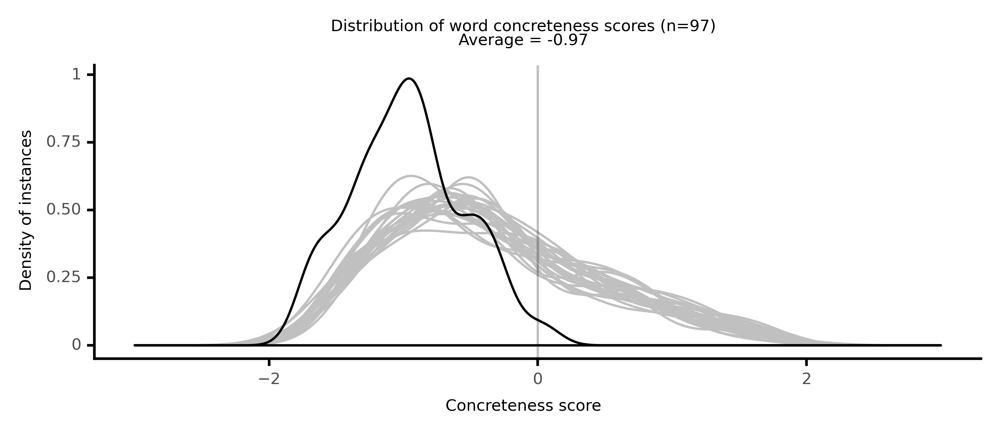

<ggplot: (8764098466185)>

  4%|▍         | 4/100 [00:51<19:41, 12.31s/it]

#### #5 most abstract passage: Cooper, _The Redskins; or Indian and Injin: Being the Concl_ (1846)

<p>is to place a <neither><conc310>check</conc310></neither> on the <abs><conc072>natural</conc072></abs> <abs><conc100>propensities</conc100></abs> of men, to <abs><conc162>restrain</conc162></abs> them, and keep them within due <abs><conc251>bounds</conc251></abs>; while the <abs><conc041>tendencies</conc041></abs> <abs><conc177>follow</conc177></abs> those <abs><conc100>propensities</conc100></abs>, and are quite often in <abs><conc044>direct</conc044></abs> <abs><conc019>opposition</conc019></abs> to the <abs><conc008>spirit</conc008></abs>. That this <neither><conc322>outcry</conc322></neither> against leasehold <abs><conc160>tenures</conc160></abs> in America is following the <abs><conc041>tendencies</conc041></abs> of our <abs><conc089>institutions</conc089></abs>, I am <neither><conc435>afraid</conc435></neither> is only too <abs><conc024>true</conc024></abs>; but that it is in any manner in <abs><conc146>compliance</conc146></abs> with their <abs><conc008>spirit</conc008></abs>, I <abs><conc087>utterly</conc087></abs> <abs><conc036>deny</conc036></abs>.'' You will allow that <abs><conc089>institutions</conc089></abs> have their <abs><conc008>spirit</conc008></abs>, which aught always to be <abs><conc188>respected</conc188></abs>, in <abs><conc191>order</conc191></abs> to <abs><conc239>preserve</conc239></abs> <abs><conc196>harmony</conc196></abs>?'' Out of all <abs><conc153>question</conc153></abs>. The first great <abs><conc208>requisite</conc208></abs> of a <abs><conc009>political</conc009></abs> system is the means of <neither><conc354>protecting</conc354></neither> itself; the second, to <neither><conc310>check</conc310></neither> its <abs><conc041>tendencies</conc041></abs> at the <neither><conc363>point</conc363></neither> <abs><conc238>required</conc238></abs> by <abs><conc027>justice</conc027></abs>, <abs><conc019>wisdom</conc019></abs> and good <abs><conc023>faith</conc023></abs>. In a <abs><conc096>despotism</conc096></abs>, for <abs><conc233>instance</conc233></abs>, the <abs><conc008>spirit</conc008></abs> of the system is to <abs><conc064>maintain</conc064></abs> that one man, who is <neither><conc346>elevated</conc346></neither> above the <abs><conc112>necessities</conc112></abs> and <abs><conc108>temptations</conc108></abs> of a <abs><conc061>nation</conc061></abs>-- who is <neither><conc399>solemnly</conc399></neither> <neither><conc564>set</conc564></neither> apart for the <neither><conc285>sole</conc285></neither> <abs><conc211>purpose</conc211></abs> of <abs><conc050>government</conc050></abs>, <neither><conc311>fortified</conc311></neither> by <abs><conc163>dignity</conc163></abs>, and <abs><conc121>rendered</conc121></abs> <abs><conc028>impartial</conc028></abs> by <neither><conc268>position</conc268></neither>-- will <abs><conc103>rule</conc103></abs> in the manner most <abs><conc066>conducive</conc066></abs> to the <abs><conc024>true</conc024></abs> <abs><conc081>interests</conc081></abs> of his <abs><conc047>Subject</conc047></abs>'s. It is just as much the <abs><conc053>theory</conc053></abs> of Russia and Prussia that their <abs><conc215>monarchs</conc215></abs> <abs><conc218>reign</conc218></abs> not for their own good, but for the good of those over whom they are placed, as it is the <abs><conc053>theory</conc053></abs> in regard to the <abs><conc138>President</conc138></abs> of the <abs><conc219>United</conc219></abs> <abs><conc233>States</conc233></abs>. We all know that the <abs><conc041>tendencies</conc041></abs> of a <abs><conc096>despotism</conc096></abs> are to <abs><conc033>abuses</conc033></abs> of a particular <abs><conc025>character</conc025></abs>; and it is just as certain that the <abs><conc041>tendencies</conc041></abs> of a <abs><conc144>republic</conc144></abs>, or rather of a <abs><conc174>democratic</conc174></abs> <abs><conc144>republic</conc144></abs>-- for <abs><conc144>republic</conc144></abs> of itself means but little, many <abs><conc245>republics</conc245></abs> having had <neither><conc268>kings</conc268></neither>-- but it is just as certain that the <abs><conc041>tendencies</conc041></abs> of a <abs><conc101>democracy</conc101></abs> are to <abs><conc033>abuses</conc033></abs> of another <abs><conc025>character</conc025></abs>. Whatever man <neither><conc574>touches</conc574></neither>, he <abs><conc096>infallibly</conc096></abs> <abs><conc033>abuses</conc033></abs>; and this more in <abs><conc179>connection</conc179></abs> with the <abs><conc097>exercise</conc097></abs> of <abs><conc009>political</conc009></abs> <abs><conc028>power</conc028></abs>, perhaps, than in the <neither><conc264>management</conc264></neither> of any one interest of life, though he <abs><conc033>abuses</conc033></abs> all, even to <abs><conc025>religion</conc025></abs>. Less <neither><conc298>depends</conc298></neither> on the <abs><conc152>nominal</conc152></abs> <abs><conc025>character</conc025></abs> of <abs><conc089>institutions</conc089></abs>, perhaps, than on their <abs><conc050>ability</conc050></abs> to <abs><conc237>arrest</conc237></abs> their own <abs><conc041>tendencies</conc041></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

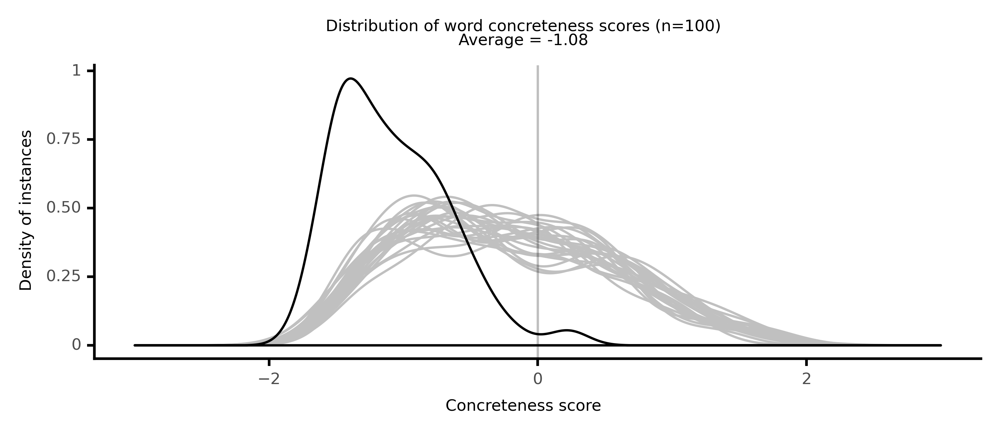

<ggplot: (8764111968745)>

  5%|▌         | 5/100 [01:03<19:33, 12.35s/it]

#### #6 most abstract passage: Herbert, _Persons and Pictures from the Histories of France _ (1854)

<p>to <abs><conc009>political</conc009></abs> <abs><conc050>government</conc050></abs>. So that in almost every case the <abs><conc220>extreme</conc220></abs> <abs><conc031>dissenter</conc031></abs> will be found the <abs><conc108>extremest</conc108></abs> <abs><conc031>dissenter</conc031></abs>. How far this may have <neither><conc437>weighed</conc437></neither> with Henry and <abs><conc100>prompted</conc100></abs> him to the <abs><conc249>cruel</conc249></abs> <abs><conc103>rigor</conc103></abs> with which he <abs><conc170>repressed</conc170></abs> the <abs><conc239>advance</conc239></abs> of <abs><conc160>protestant</conc160></abs> <abs><conc065>reform</conc065></abs>, is not so <neither><conc302>directly</conc302></neither> <abs><conc047>apparent</conc047></abs> as it is in the case of his <neither><conc682>daughter</conc682></neither> Elizabeth; but as Henry in no <abs><conc021>respect</conc021></abs> <abs><conc243>lacked</conc243></abs> <abs><conc009>political</conc009></abs> <abs><conc152>shrewdness</conc152></abs> or <abs><conc015>foresight</conc015></abs>, though he at times <abs><conc155>suffered</conc155></abs> his <abs><conc228>violent</conc228></abs> <abs><conc169>passion</conc169></abs> to <abs><conc094>prevail</conc094></abs> against the <abs><conc043>maxims</conc043></abs> of found <abs><conc015>statesmanship</conc015></abs>, and as no king ever <neither><conc460>lived</conc460></neither> who was more <neither><conc285>jealous</conc285></neither> of his <abs><conc017>authority</conc017></abs>, there is no <abs><conc020>reason</conc020></abs> to <abs><conc082>doubt</conc082></abs> that he clearly <abs><conc049>foresaw</conc049></abs> the <neither><conc446>parallel</conc446></neither> and <abs><conc040>contemporaneous</conc040></abs> <neither><conc621>spread</conc621></neither> of <abs><conc073>liberal</conc073></abs> <abs><conc081>feelings</conc081></abs> in <abs><conc163>matters</conc163></abs> of <neither><conc309>church</conc309></neither> and state, of <abs><conc043>religious</conc043></abs> and <abs><conc009>political</conc009></abs> <abs><conc065>reform</conc065></abs>. But apart from this, he had the <neither><conc349>stern</conc349></neither> and <abs><conc212>obstinate</conc212></abs> <abs><conc083>veneration</conc083></abs> of the <abs><conc098>bigot</conc098></abs> for his own <abs><conc062>creed</conc062></abs>-- a <abs><conc083>veneration</conc083></abs> <abs><conc254>enhanced</conc254></abs> in his proud and despotical mind by the <abs><conc090>consideration</conc090></abs> that it was his own-- a <abs><conc090>consideration</conc090></abs> which <abs><conc201>led</conc201></abs> him to regard all <abs><conc038>dissent</conc038></abs> from it as an <abs><conc124>affront</conc124></abs> in some <abs><conc077>degree</conc077></abs> <abs><conc015>personal</conc015></abs> to himself. Besides this, he <neither><conc329>prided</conc329></neither> himself on his <abs><conc105>learning</conc105></abs> and <abs><conc039>orthodoxy</conc039></abs> as a <abs><conc042>theologian</conc042></abs>, on his <abs><conc060>subtlety</conc060></abs> as a <abs><conc031>polemical</conc031></abs> <abs><conc129>casuist</conc129></abs>, and on his <abs><conc125>eloquence</conc125></abs> as a <abs><conc043>religious</conc043></abs> <abs><conc068>disputant</conc068></abs>; so that <abs><conc196>vanity</conc196></abs>, <abs><conc068>selfishness</conc068></abs>, <abs><conc029>bigotry</conc029></abs>, and interest all <abs><conc123>urged</conc123></abs> him to the <abs><conc079>infliction</conc079></abs> of the <abs><conc147>cruelest</conc147></abs> <abs><conc020>punishments</conc020></abs> on the <neither><conc501>wretches</conc501></neither> who <abs><conc209>differed</conc209></abs> from the <abs><conc008>tenets</conc008></abs> of the <abs><conc194>catholic</conc194></abs> <neither><conc309>church</conc309></neither>, and <neither><conc305>held</conc305></neither> <abs><conc013>opinions</conc013></abs> at <abs><conc051>variance</conc051></abs> to his own, especially on the <abs><conc153>question</conc153></abs> of the real <abs><conc177>presence</conc177></abs>.'' So far, therefore, was Henry from being a <abs><conc043>religious</conc043></abs> <abs><conc051>reformer</conc051></abs>, or a favorer of <abs><conc063>protestantism</conc063></abs>, that the <abs><conc130>condition</conc130></abs> of the Lollard, the <abs><conc160>protestant</conc160></abs> <abs><conc051>reformer</conc051></abs>, or the <abs><conc007>heretical</conc007></abs> disbeliever in any of the <abs><conc190>peculiar</conc190></abs> <abs><conc017>doctrines</conc017></abs> of the Romish <neither><conc309>church</conc309></neither>, was <abs><conc128>infinitely</conc128></abs> more <abs><conc251>perilous</conc251></abs> than that of the most <abs><conc228>violent</conc228></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

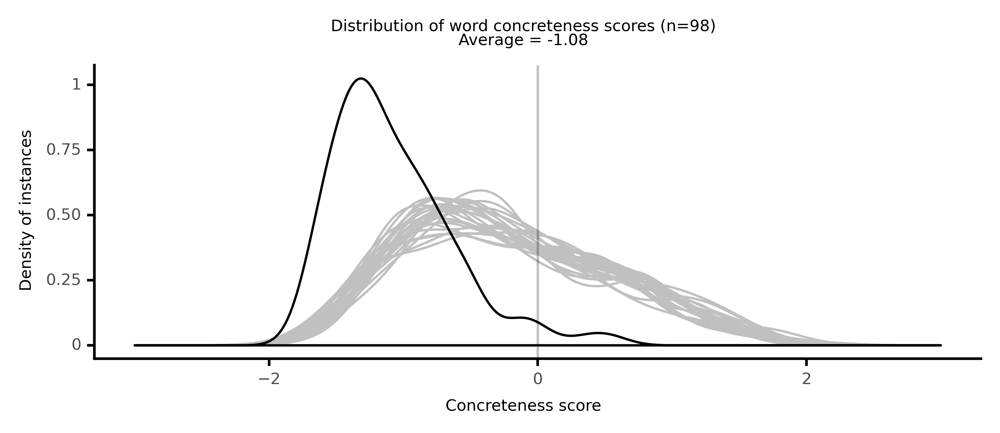

<ggplot: (8764118006705)>

  6%|▌         | 6/100 [01:14<18:42, 11.94s/it]

#### #7 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>of my <abs><conc072>salvation</conc072></abs>, and think I can not be <abs><conc124>thankful</conc124></abs> enough for the <neither><conc257>inestimable</conc257></neither> <abs><conc187>blessing</conc187></abs>. It is to me a <abs><conc153>glorious</conc153></abs> <abs><conc130>instance</conc130></abs> of the great <abs><conc033>wisdom</conc033></abs> and <abs><conc093>goodness</conc093></abs> of God. Madam,( I replied) in <abs><conc127>relation</conc127></abs> to your first <abs><conc143>objection</conc143></abs>, that I make no <abs><conc204>difference</conc204></abs> between <abs><conc040>revealed</conc040></abs> and <abs><conc077>natural</conc077></abs> <abs><conc043>religion</conc043></abs>, for <abs><conc083>nature</conc083></abs> is as <abs><conc164>sufficient</conc164></abs> as <neither><conc291>grace</conc291></neither>, in my account, I <neither><conc245>assure</conc245></neither> you that I think the <abs><conc017>revelation</conc017></abs> of the <abs><conc051>gospel</conc051></abs> <neither><conc340>excels</conc340></neither> the best <abs><conc131>scheme</conc131></abs> of <abs><conc077>natural</conc077></abs> <abs><conc043>religion</conc043></abs> that could be <abs><conc135>proposed</conc135></abs>; in <abs><conc041>declaring</conc041></abs> the terms of <abs><conc063>reconcilement</conc063></abs>, in <abs><conc012>demonstrating</conc012></abs> the <abs><conc054>divine</conc054></abs> <abs><conc146>wrath</conc146></abs> against <abs><conc130>sin</conc130></abs>, in the <abs><conc185>method</conc185></abs> of <abs><conc181>showing</conc181></abs> <abs><conc129>mercy</conc129></abs> by the <abs><conc199>death</conc199></abs> of God's <neither><conc275>beloved</conc275></neither> <abs><conc201>Son</conc201></abs>, and the <abs><conc156>promise</conc156></abs> of free <abs><conc130>pardon</conc130></abs> on the <abs><conc148>condition</conc148></abs> of <abs><conc073>repentance</conc073></abs> and <abs><conc022>newness</conc022></abs> of life. This manner gives <abs><conc228>unspeakable</conc228></abs> <abs><conc226>comfort</conc226></abs> to <abs><conc094>repenting</conc094></abs> <abs><conc138>sinners</conc138></abs>. It gives the greatest <abs><conc098>encouragement</conc098></abs> to <abs><conc139>engage</conc139></abs> them to the love of God and the <abs><conc052>practice</conc052></abs> of all his <abs><conc108>commandments</conc108></abs>; an <abs><conc098>encouragement</conc098></abs> that <abs><conc031>reason</conc031></abs> could not <neither><conc248>discover</conc248></neither>. To <abs><conc033>christianity</conc033></abs> therefore the <abs><conc073>true</conc073></abs> <abs><conc164>preference</conc164></abs> is due. Tho' <abs><conc086>philosophy</conc086></abs> or the <abs><conc012>doctrine</conc012></abs> of <abs><conc031>reason</conc031></abs> may <abs><conc021>reform</conc021></abs> men, yet the <abs><conc044>christian</conc044></abs> <abs><conc043>religion</conc043></abs> is a <neither><conc286>clearer</conc286></neither> and more <abs><conc119>powerful</conc119></abs> <abs><conc216>guide</conc216></abs>. It <neither><conc354>improves</conc354></neither> the <neither><conc581>light</conc581></neither> of <abs><conc031>reason</conc031></abs> by the <abs><conc044>supernatural</conc044></abs> <abs><conc054>evidence</conc054></abs> and <abs><conc052>declaration</conc052></abs> of God's will, and the means of man's <abs><conc059>redemption</conc059></abs> is a more <neither><conc256>efficacious</conc256></neither> <abs><conc024>motive</conc024></abs> and <abs><conc041>obligation</conc041></abs> to <abs><conc046>universal</conc046></abs> <abs><conc022>obedience</conc022></abs> than <abs><conc083>nature</conc083></abs> could ever with <abs><conc055>certainty</conc055></abs> <abs><conc135>propose</conc135></abs>. A <abs><conc017>revelation</conc017></abs> that has the <neither><conc235>clearest</conc235></neither> and <neither><conc242>strongest</conc242></neither> <abs><conc054>evidence</conc054></abs> of being the <abs><conc054>divine</conc054></abs> will, must be the most <neither><conc269>easy</conc269></neither> and <abs><conc093>effectual</conc093></abs> <abs><conc185>method</conc185></abs> of <abs><conc104>instruction</conc104></abs>, and be more <neither><conc423>noticed</conc423></neither> than the best <abs><conc115>human</conc115></abs> <abs><conc147>teaching</conc147></abs>: and this will of God being truly and <abs><conc138>faithfully</conc138></abs> <abs><conc134>committed</conc134></abs> to <abs><conc206>writing</conc206></abs>, and <neither><conc372>preserved</conc372></neither> <abs><conc020>uncorrupt</conc020></abs>, must always be the best and <abs><conc233>surest</conc233></abs> <abs><conc065>rule</conc065></abs> of <abs><conc070>faith</conc070></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

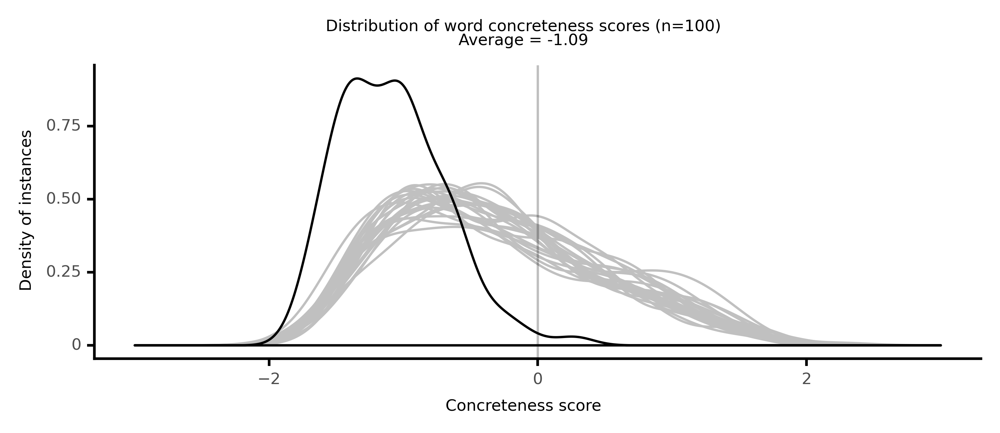

<ggplot: (8764096529005)>

  7%|▋         | 7/100 [01:29<20:03, 12.95s/it]

#### #8 most abstract passage: Disraeli, _Coningsby; or The New Generation. By B. Disraeli ._ (1844)

<p>of <abs><conc081>Parliamentary</conc081></abs> <abs><conc186>Monarchy</conc186></abs> and <abs><conc081>Parliamentary</conc081></abs> <neither><conc309>Church</conc309></neither>?''' T is <abs><conc024>true</conc024></abs>,'' said Coningsby. We can not <neither><conc381>conceal</conc381></neither> it from ourselves, that the first has made <abs><conc050>Government</conc050></abs> <abs><conc184>detested</conc184></abs>, and the second, <abs><conc025>Religion</conc025></abs> <abs><conc018>disbelieved</conc018></abs>.'' Many men in this country,'' said <neither><conc660>Millbank</conc660></neither>, and especially in the <abs><conc218>class</conc218></abs> to which I <neither><conc283>belong</conc283></neither>, are <abs><conc077>reconciled</conc077></abs> to the <abs><conc121>contemplation</conc121></abs> of <abs><conc101>democracy</conc101></abs>, because they have <neither><conc282>accustomed</conc282></neither> themselves to believe that it is the only <abs><conc028>power</conc028></abs> by which we can <neither><conc654>sweep</conc654></neither> away those <abs><conc114>sectional</conc114></abs> <abs><conc128>privileges</conc128></abs> and <abs><conc081>interests</conc081></abs> that <abs><conc239>impede</conc239></abs> the <abs><conc081>intelligence</conc081></abs> and <abs><conc196>industry</conc196></abs> of the <abs><conc103>community</conc103></abs>.'' And yet,'' said Coningsby, the only way to <abs><conc249>terminate</conc249></abs> what in the <abs><conc082>language</conc082></abs> of the present day is <neither><conc463>called</conc463></neither> <abs><conc218>Class</conc218></abs> <abs><conc079>Legislation</conc079></abs> is not to <abs><conc105>intrust</conc105></abs> <abs><conc028>power</conc028></abs> to <abs><conc241>classes</conc241></abs>. You would find a <neither><conc338>loco-foco</conc338></neither> <abs><conc158>majority</conc158></abs> as much <abs><conc239>addicted</conc239></abs> to <abs><conc218>Class</conc218></abs> <abs><conc079>Legislation</conc079></abs> as a <abs><conc052>factitious</conc052></abs> <abs><conc257>aristocracy</conc257></abs>. The only <abs><conc028>power</conc028></abs>, that has no <abs><conc218>class</conc218></abs> <abs><conc100>sympathy</conc100></abs> is the <abs><conc097>Sovereign</conc097></abs>.'' But <abs><conc191>suppose</conc191></abs> the case of an <abs><conc012>arbitrary</conc012></abs> <abs><conc097>Sovereign</conc097></abs>, what would be your <neither><conc310>check</conc310></neither> against him?'' The same as against an <abs><conc012>arbitrary</conc012></abs> <abs><conc165>Parliament</conc165></abs>.'' But a <abs><conc165>Parliament</conc165></abs> is <abs><conc081>responsible</conc081></abs>.'' To whom?'' To their <abs><conc249>constituent</conc249></abs> body.'' <abs><conc191>Suppose</conc191></abs> it was to <abs><conc260>vote</conc260></abs> itself <abs><conc170>perpetual</conc170></abs>?'' But <abs><conc049>public</conc049></abs> <abs><conc020>opinion</conc020></abs> would <neither><conc280>prevent</conc280></neither> that.'' And is <abs><conc049>public</conc049></abs> <abs><conc020>opinion</conc020></abs> of less <abs><conc082>influence</conc082></abs> on an <abs><conc038>individual</conc038></abs> than on a body?'' But <abs><conc049>public</conc049></abs> <abs><conc020>opinion</conc020></abs> may be <abs><conc164>indifferent</conc164></abs>: a <abs><conc061>nation</conc061></abs> may be <abs><conc023>misled</conc023></abs>, may be <abs><conc049>corrupt</conc049></abs>.'' If the <abs><conc061>nation</conc061></abs> that <abs><conc196>elects</conc196></abs> the <abs><conc165>Parliament</conc165></abs> be <abs><conc049>corrupt</conc049></abs>, the <abs><conc224>elected</conc224></abs> body will <neither><conc587>resemble</conc587></neither> it. The <abs><conc061>nation</conc061></abs> that is <abs><conc049>corrupt</conc049></abs>, <abs><conc226>deserves</conc226></abs> to <neither><conc404>fall</conc404></neither>. But this only shows that there is something to be <abs><conc135>considered</conc135></abs> beyond <neither><conc274>forms</conc274></neither> of <abs><conc050>government</conc050></abs>-- <abs><conc098>national</conc098></abs> <abs><conc025>character</conc025></abs>. And herein mainly should we <neither><conc347>repose</conc347></neither> our <abs><conc100>Hope</conc100></abs>'s. If a <abs><conc061>nation</conc061></abs> be <abs><conc201>led</conc201></abs> to <abs><conc146>aim</conc146></abs> at the good and the great, <abs><conc251>depend</conc251></abs> upon it, whatever be its from, the <abs><conc050>government</conc050></abs> will <abs><conc206>respond</conc206></abs> to its <abs><conc006>convictions</conc006></abs> and its <abs><conc034>sentiments</conc034></abs>.'' Do you then <abs><conc102>declare</conc102></abs> against <abs><conc081>Parliamentary</conc081></abs> <abs><conc050>government</conc050></abs>?'' Far from it: I look upon <abs><conc009>political</conc009></abs> <abs><conc200>change</conc200></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

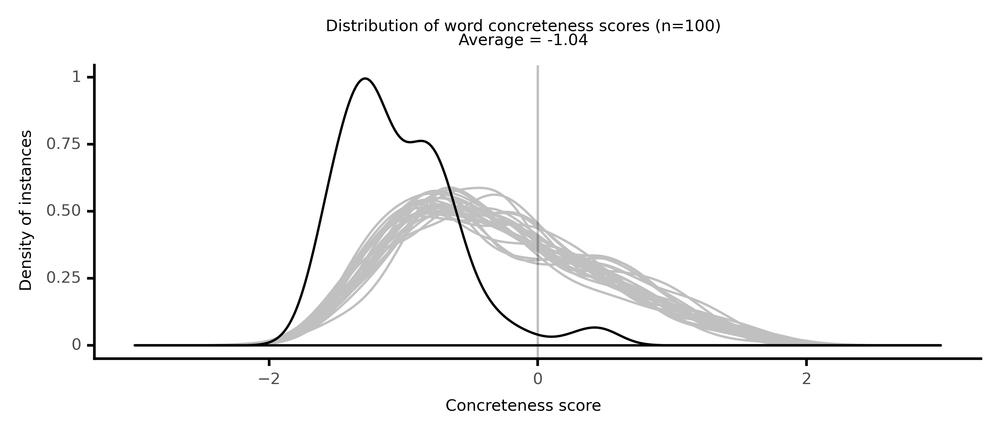

<ggplot: (8764162936385)>

  8%|▊         | 8/100 [01:41<19:16, 12.57s/it]

#### #9 most abstract passage: Cooper, _The Bravo, volume 2 (1831)_ (1831)

<p>had to <abs><conc175>overcome</conc175></abs> the <abs><conc167>generous</conc167></abs> <abs><conc069>disposition</conc069></abs> of a <abs><conc113>colleague</conc113></abs>, before the <abs><conc083>action</conc083></abs> of the <neither><conc274>terrible</conc274></neither> <neither><conc508>machine</conc508></neither> could go on. It is <abs><conc118>worthy</conc118></abs> of <abs><conc190>remark</conc190></abs>, that <abs><conc169>communities</conc169></abs> always <abs><conc104>establish</conc104></abs> a <neither><conc262>higher</conc262></neither> <abs><conc180>standard</conc180></abs> of <abs><conc027>justice</conc027></abs> and <abs><conc013>truth</conc013></abs>, than is <abs><conc099>exercised</conc099></abs> by their <abs><conc038>individual</conc038></abs> <abs><conc246>members</conc246></abs>. The <abs><conc020>reason</conc020></abs> is not to be <abs><conc133>sought</conc133></abs> for, since <abs><conc041>nature</conc041></abs> hath left to all a <abs><conc123>perception</conc123></abs> of that right, which is <abs><conc248>abandoned</conc248></abs> only under the <neither><conc269>stronger</conc269></neither> <abs><conc103>impulses</conc103></abs> of <abs><conc015>personal</conc015></abs> <abs><conc200>temptation</conc200></abs>. We <abs><conc145>commend</conc145></abs> the <abs><conc041>virtue</conc041></abs> we can not <neither><conc317>imitate</conc317></neither>. Thus it is that those <abs><conc249>countries</conc249></abs>, in which <abs><conc049>public</conc049></abs> <abs><conc020>opinion</conc020></abs> has most <abs><conc082>influence</conc082></abs>, are always of the <neither><conc419>purest</conc419></neither> <abs><conc049>public</conc049></abs> <abs><conc086>practice</conc086></abs>. It follows as a <abs><conc106>corollary</conc106></abs> from this <abs><conc120>proposition</conc120></abs>, that a <abs><conc205>representation</conc205></abs> should be as real as possible, for its <abs><conc060>tendency</conc060></abs> will be <abs><conc082>inevitably</conc082></abs> to <abs><conc131>elevate</conc131></abs> <abs><conc098>national</conc098></abs> <abs><conc077>morals</conc077></abs>. <neither><conc388>Miserable</conc388></neither>, indeed, is the <abs><conc130>condition</conc130></abs> of that people, whose <abs><conc043>maxims</conc043></abs> and <abs><conc079>measures</conc079></abs> of <abs><conc049>public</conc049></abs> <abs><conc029>policy</conc029></abs> are below the <abs><conc180>standard</conc180></abs> of its <abs><conc152>private</conc152></abs> <abs><conc041>integrity</conc041></abs>, for the <abs><conc067>fact</conc067></abs> not only <abs><conc080>proves</conc080></abs> it is not the master of its own <abs><conc158>destinies</conc158></abs>, but the still more <abs><conc175>dangerous</conc175></abs> <abs><conc013>truth</conc013></abs>, that the <abs><conc075>collective</conc075></abs> <abs><conc028>power</conc028></abs> is <neither><conc340>employed</conc340></neither> in the <abs><conc176>fatal</conc176></abs> <abs><conc170>service</conc170></abs> of <abs><conc165>undermining</conc165></abs> those very <abs><conc173>qualities</conc173></abs> which are necessary to <abs><conc041>virtue</conc041></abs>, and which have enough to do, at all times, in <abs><conc119>resisting</conc119></abs> the <abs><conc228>attacks</conc228></abs> of immediate <abs><conc068>selfishness</conc068></abs>. A <abs><conc114>strict</conc114></abs> <abs><conc107>legal</conc107></abs> <abs><conc205>representation</conc205></abs> of all its <abs><conc081>interests</conc081></abs> is far more necessary to a <abs><conc135>worldly</conc135></abs> than to a <neither><conc274>simple</conc274></neither> people, since <abs><conc059>responsibility</conc059></abs>, which is the <abs><conc246>essence</conc246></abs> of a free <abs><conc050>government</conc050></abs>, is more likely to keep the <abs><conc143>agents</conc143></abs> of a <abs><conc061>nation</conc061></abs> near to its own <abs><conc180>standard</conc180></abs> of <abs><conc041>virtue</conc041></abs> than any other means. The <abs><conc256>common</conc256></abs> <abs><conc020>opinion</conc020></abs> that a <abs><conc144>republic</conc144></abs> can not <abs><conc115>exist</conc115></abs>, without an <abs><conc138>extraordinary</conc138></abs> <abs><conc077>degree</conc077></abs> of <abs><conc041>virtue</conc041></abs> in its <abs><conc194>citizens</conc194></abs>, is so <abs><conc153>flattering</conc153></abs> to our own <abs><conc033>actual</conc033></abs> <abs><conc130>condition</conc130></abs>, that we <neither><conc302>seldom</conc302></neither> take the <neither><conc312>trouble</conc312></neither> to <neither><conc264>inquire</conc264></neither> into its <abs><conc013>truth</conc013></abs>; but, to us, it seems quite <abs><conc047>apparent</conc047></abs> that effect is here <abs><conc174>mistaken</conc174></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

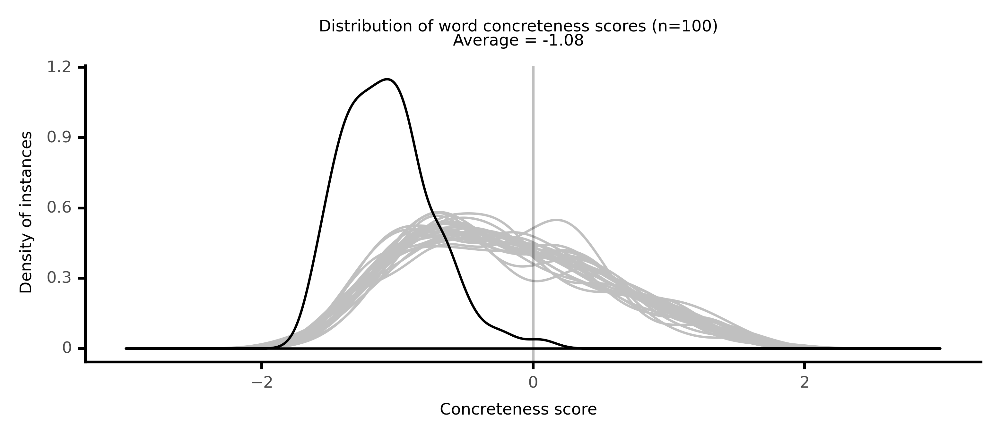

<ggplot: (8764117761961)>

  9%|▉         | 9/100 [01:52<18:15, 12.04s/it]

#### #10 most abstract passage: Richardson, _Familiar Letters (1750)_ (1750)

<p>to you, to <abs><conc206>continue</conc206></abs> my <abs><conc176>Address</conc176></abs>. As therefore you have, by your <abs><conc016>Appeal</conc016></abs> to me, in so <neither><conc328>uncommon</conc328></neither> a way, <abs><conc171>endeavoured</conc171></abs> to make me a <abs><conc165>Party</conc165></abs> against myself, and I have shown so much Regard to you, as to be willing to <abs><conc143>oblige</conc143></abs> you, as far as I can, may I not <abs><conc131>hope</conc131></abs> the <abs><conc067>Favour</conc067></abs> of you to <abs><conc043>declare</conc043></abs> <abs><conc205>generously</conc205></abs>, whither I <abs><conc129>owe</conc129></abs> my <abs><conc088>Unhappiness</conc088></abs> to such a <abs><conc084>Prepossession</conc084></abs>, and whither your <neither><conc325>Heart</conc325></neither> is given to some other?-- If this be the Case, you shall find all you wish on my Part; and I shall take a <neither><conc248>Pride</conc248></neither> to <abs><conc064>plead</conc064></abs> against myself, let me <abs><conc085>suffer</conc085></abs> ever so much by it, to your Father and Mother: But if not, and you have taken any other <abs><conc121>Disgusts</conc121></abs> to my Person or <abs><conc093>Behaviour</conc093></abs>, that there may be <abs><conc131>Hope</conc131></abs> my utmost <abs><conc144>Affection</conc144></abs> and <neither><conc236>Assiduity</conc236></neither>, or a <abs><conc057>contrary</conc057></abs> <abs><conc010>Conduct</conc010></abs>, may, in time, get the better of, let me <abs><conc186>implore</conc186></abs> you to <abs><conc209>permit</conc209></abs> me still to <abs><conc206>continue</conc206></abs> my <abs><conc044>zealous</conc044></abs> <abs><conc210>Respects</conc210></abs> to you; for this I will say, that there is not a Man in the World who can <abs><conc176>address</conc176></abs> you with a <abs><conc161>sincerer</conc161></abs> and more <abs><conc223>ardent</conc223></abs> <neither><conc620>Flame</conc620></neither>, than, dear Madam, Your <neither><conc275>affectionate</conc275></neither> <neither><conc366>Admirer</conc366></neither>, and <neither><conc292>humble</conc292></neither> Servant. SIR, I Thank you for your <neither><conc392>kind</conc392></neither> <abs><conc054>Assurance</conc054></abs>, that you will <abs><conc181>befriend</conc181></abs> me in the manner I wish; and I think I <abs><conc129>owe</conc129></abs> it to your <abs><conc084>Generosity</conc084></abs> to <abs><conc043>declare</conc043></abs>, that there is a Person in the World, that, might I be left to my own <abs><conc145>Choice</conc145></abs>, I should <abs><conc219>prefer</conc219></abs> to all other Men. To this, Sir, it is owing, that your <abs><conc176>Address</conc176></abs> can not <neither><conc336>meet</conc336></neither> with the Return it might otherwise <abs><conc088>deserve</conc088></abs> from me. Yet are Things so <abs><conc108>circumstanced</conc108></abs>, that while my Friends <abs><conc219>prefer</conc219></abs> you, and know nothing of the other, I should find it very <abs><conc174>difficult</conc174></abs> to obtain their <neither><conc258>Consents</conc258></neither>. But your <abs><conc107>generous</conc107></abs> <abs><conc061>Discontinuance</conc061></abs>, without giving them the <abs><conc073>true</conc073></abs> <abs><conc031>Reason</conc031></abs> for it, will lay an <abs><conc041>Obligation</conc041></abs>, <abs><conc211>greater</conc211></abs> than I can <abs><conc106>express</conc106></abs>, on Your most <neither><conc292>humble</conc292></neither> Servant. SIR, I am sorry to say, that my <abs><conc022>Disapprobation</conc022></abs> of your <abs><conc176>Address</conc176></abs> is <abs><conc060>insuperable</conc060></abs>-- Yet I can not but think myself <abs><conc092>beholden</conc092></abs> to you for the <abs><conc084>Generosity</conc084></abs> of your <abs><conc148>Answer</conc148></abs> to my <abs><conc165>earnest</conc165></abs> <neither><conc266>Request</conc266></neither>. I must <neither><conc288>beg</conc288></neither> you, Sir, to give over your <abs><conc044>Application</conc044></abs>: But how can I say, while I can not help being of this Mind, that it is or is not owing to <abs><conc084>Prepossession</conc084></abs>; when you <abs><conc043>declare</conc043></abs>, that in the one <abs><conc130>Instance</conc130></abs>( and that is very <abs><conc107>generous</conc107></abs> too) you will <abs><conc143>oblige</conc143></abs> me; but in the other you will not? If I can not return Love for Love, be the <abs><conc024>Motive</conc024></abs> what it will, <neither><conc608>prey</conc608></neither>, Sir, for your own <neither><conc253>sake</conc253></neither>, as well as mine, <abs><conc135>discontinue</conc135></abs> your <abs><conc176>Address</conc176></abs>-- In case of <abs><conc084>Prepossession</conc084></abs>, you say you can, and you will <abs><conc143>oblige</conc143></abs> me: Let my <abs><conc052>Unworthiness</conc052></abs>, Sir, have the same Effect upon you, as if that <abs><conc084>Prepossession</conc084></abs> were to be <abs><conc018>avowed</conc018></abs>. This will <abs><conc204>inspire</conc204></abs> me with a <abs><conc108>Gratitude</conc108></abs> that will always make me Your most <abs><conc231>obliged</conc231></abs> Servant. SIR, After many <abs><conc075>unaccountable</conc075></abs> <neither><conc349>Hesitations</conc349></neither>, and <neither><conc475>concealed</conc475></neither> <abs><conc232>Meanings</conc232></abs>, that your Mind seemed of <neither><conc291>late</conc291></neither> <conc><conc803>big</conc803></conc> with, but hardly knew how to <abs><conc106>express</conc106></abs>, you have, at last, spoken out all your Mind; and I know what I am to <abs><conc101>trust</conc101></abs> to! I have that <abs><conc215>Disdain</conc215></abs> of your <abs><conc227>Proposal</conc227></abs> that an <abs><conc184>honest</conc184></abs> Mind aught to have. But I wish, for my own <neither><conc253>sake</conc253></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

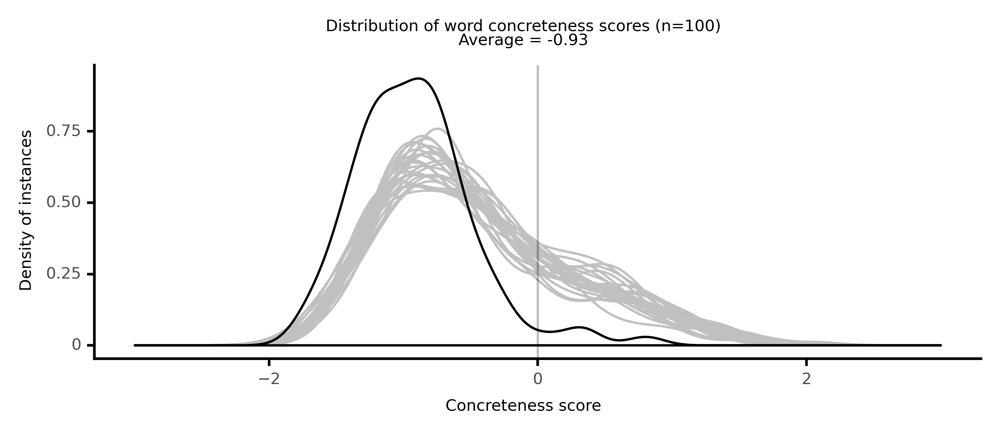

<ggplot: (8764107935485)>

 10%|█         | 10/100 [02:03<17:47, 11.86s/it]

#### #11 most abstract passage: Samuel Johnson, _The Rambler_ (1750)

<p>are to be <abs><conc201>directed</conc201></abs>; and he that is most <abs><conc100>deficient</conc100></abs> in the <abs><conc155>duties</conc155></abs> of life, makes some <abs><conc070>atonement</conc070></abs> for his <abs><conc107>faults</conc107></abs>, if he <abs><conc141>warns</conc141></abs> others against his own <abs><conc098>failings</conc098></abs>, and <abs><conc190>hinders</conc190></abs>, by the-90- <neither><conc300>salubrity</conc300></neither> of his <abs><conc031>admonitions</conc031></abs>, the <neither><conc323>contagion</conc323></neither> of his example. Nothing is more <abs><conc004>unjust</conc004></abs>, however <abs><conc232>common</conc232></abs>, than to <abs><conc181>charge</conc181></abs> with <abs><conc133>hypocrisy</conc133></abs> him that <abs><conc140>expresses</conc140></abs> <abs><conc054>zeal</conc054></abs> for those <abs><conc126>virtues</conc126></abs> which he <abs><conc068>neglects</conc068></abs> to <abs><conc052>practice</conc052></abs>; since he may be <abs><conc078>sincerely</conc078></abs> <abs><conc049>convinced</conc049></abs> of the <abs><conc058>advantages</conc058></abs> of <abs><conc200>conquering</conc200></abs> his <abs><conc175>passion</conc175></abs>, without having yet obtained the <neither><conc240>victory</conc240></neither>, as a man may be <abs><conc058>confident</conc058></abs> of the <abs><conc058>advantages</conc058></abs> of a <neither><conc532>voyage</conc532></neither>, or a <neither><conc473>journey</conc473></neither>, without having <abs><conc115>courage</conc115></abs> or <abs><conc148>industry</conc148></abs> to <abs><conc097>undertake</conc097></abs> it, and may <abs><conc108>honestly</conc108></abs> <abs><conc212>recommend</conc212></abs> to others, those <abs><conc137>attempts</conc137></abs> which he <abs><conc068>neglects</conc068></abs> himself. The interest which the <abs><conc077>corrupt</conc077></abs> part of <abs><conc017>mankind</conc017></abs> have in <neither><conc395>hardening</conc395></neither> themselves against every <abs><conc024>motive</conc024></abs> to <abs><conc087>amendment</conc087></abs>, has <neither><conc350>disposed</conc350></neither> them to give to these <abs><conc026>contradictions</conc026></abs>, when they can be <neither><conc292>produced</conc292></neither> against the cause of <abs><conc076>virtue</conc076></abs>, that <neither><conc495>weight</conc495></neither> which they will not allow them in any other case. They see men act in <abs><conc003>opposition</conc003></abs> to their interest, without supposing, that they do not know it; those who give way to the <neither><conc417>sudden</conc417></neither> <abs><conc202>violence</conc202></abs> of <abs><conc175>passion</conc175></abs>, and <neither><conc285>forsake</conc285></neither> the most important <abs><conc036>pursuits</conc036></abs> for <abs><conc157>petty</conc157></abs> <abs><conc198>pleasures</conc198></abs>, are not <abs><conc230>supposed</conc230></abs> to have <neither><conc384>changed</conc384></neither> their <abs><conc009>opinions</conc009></abs>, or to <abs><conc075>approve</conc075></abs> their own <abs><conc010>conduct</conc010></abs>. In <abs><conc013>moral</conc013></abs> or <abs><conc059>religious</conc059></abs> <abs><conc151>questions</conc151></abs> alone, they <abs><conc095>determine</conc095></abs> the <abs><conc016>sentiments</conc016></abs> by the <abs><conc007>actions</conc007></abs>, and <abs><conc181>charge</conc181></abs> every man with <abs><conc182>endeavouring</conc182></abs> to <abs><conc090>impose</conc090></abs> upon the world, whose <abs><conc064>writings</conc064></abs> are not <abs><conc082>confirmed</conc082></abs> by his life. They never consider that themselves <abs><conc057>neglect</conc057></abs> or <abs><conc052>practice</conc052></abs> something every day <abs><conc000>inconsistently</conc000></abs> with their own <neither><conc252>settled</conc252></neither> <abs><conc016>judgement</conc016></abs>, nor <neither><conc248>discover</conc248></neither> that the <abs><conc010>conduct</conc010></abs> of the <abs><conc055>advocates</conc055></abs> for <abs><conc076>virtue</conc076></abs> can-91- little <abs><conc233>increase</conc233></abs>, or <abs><conc164>lessen</conc164></abs>, the <abs><conc042>obligations</conc042></abs> of their <abs><conc019>dictates</conc019></abs>; <abs><conc061>argument</conc061></abs> is to be <abs><conc002>invalidated</conc002></abs> only by <abs><conc061>argument</conc061></abs>, and is in itself of the same <abs><conc176>force</conc176></abs>, whither or not it <abs><conc056>convinces</conc056></abs> him by whom it is <abs><conc135>proposed</conc135></abs>. Yet since this <abs><conc028>prejudice</conc028></abs>, however <abs><conc021>unreasonable</conc021></abs>, is always likely to have some <abs><conc040>prevalence</conc040></abs>, it is the <abs><conc135>duty</conc135></abs> of every man to take <neither><conc375>care</conc375></neither> lest he should <neither><conc348>hinder</conc348></neither> the <abs><conc092>efficacy</conc092></abs> of his own <abs><conc106>instructions</conc106></abs>. When he <abs><conc133>desires</conc133></abs> to <abs><conc202>gain</conc202></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

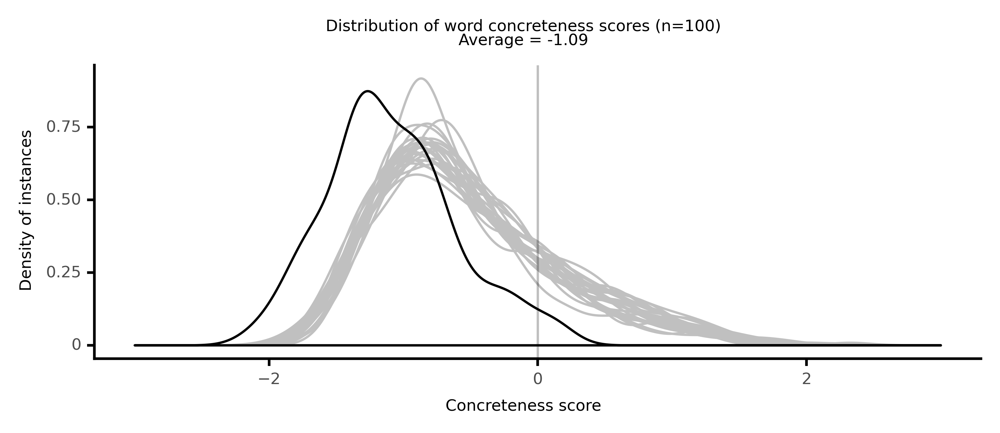

<ggplot: (8764098666153)>

 11%|█         | 11/100 [02:14<17:02, 11.49s/it]

#### #12 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>did all that was possible for men to do, to <neither><conc401>turn</conc401></neither> the world from <abs><conc182>superstition</conc182></abs> of every <neither><conc392>kind</conc392></neither> to that <abs><conc106>express</conc106></abs> <abs><conc017>revelation</conc017></abs> which <abs><conc227>restores</conc227></abs> the <abs><conc019>dictates</conc019></abs> of <abs><conc064>uncorrupted</conc064></abs> <abs><conc031>reason</conc031></abs> to their <abs><conc176>force</conc176></abs> and <abs><conc008>authority</conc008></abs>; which <abs><conc071>teaches</conc071></abs> the <abs><conc029>knowledge</conc029></abs> of one <abs><conc022>supreme</conc022></abs> <abs><conc032>Spirit</conc032></abs> or God, and the <abs><conc083>nature</conc083></abs> of that <abs><conc172>worship</conc172></abs> which is due to a Being not <neither><conc261>confined</conc261></neither> to, or <abs><conc121>dependent</conc121></abs> upon particular <neither><conc434>places</conc434></neither>, or circumstances; but always and every where present with us: she answered, that such <abs><conc193>clergymen</conc193></abs> are <abs><conc153>glorious</conc153></abs>, and can not be enough <neither><conc356>admired</conc356></neither>; and great is the <abs><conc009>unreasonableness</conc009></abs> of the men who <abs><conc045>opposed</conc045></abs> them, and <neither><conc303>forced</conc303></neither> them into the <neither><conc477>field</conc477></neither> of <abs><conc044>disputation</conc044></abs>, from their <abs><conc194>holy</conc194></abs> <neither><conc250>labour</conc250></neither> of <abs><conc138>instructing</conc138></abs> the people in <neither><conc317>penitential</conc317></neither> <abs><conc099>piety</conc099></abs> and <abs><conc021>sanctification</conc021></abs>: I mean the <abs><conc068>infidels</conc068></abs> and the <abs><conc089>bigots</conc089></abs>. What can be more <abs><conc004>unjust</conc004></abs> and <abs><conc099>impious</conc099></abs>,( Azora <neither><conc270>continued</conc270></neither>) than for men to <abs><conc070>declaim</conc070></abs> against a <abs><conc017>revelation</conc017></abs> which <neither><conc344>displays</conc344></neither> the <neither><conc245>paternal</conc245></neither> regard of God for his <abs><conc229>creatures</conc229></abs>, by doing more than was <abs><conc065>strictly</conc065></abs> necessary for their <abs><conc063>happiness</conc063></abs>, as they had his <abs><conc110>original</conc110></abs> <abs><conc016>law</conc016></abs> of <abs><conc031>reason</conc031></abs> before he gave them the <abs><conc051>gospel</conc051></abs>; and which <abs><conc217>enables</conc217></abs> us to <neither><conc339>extend</conc339></neither> our <abs><conc029>knowledge</conc029></abs> even as to those things which we are by <abs><conc083>nature</conc083></abs> <abs><conc107>capable</conc107></abs> of <abs><conc091>knowing</conc091></abs>; which <abs><conc202>awakens</conc202></abs> us to <abs><conc135>duty</conc135></abs>, and <abs><conc190>advises</conc190></abs> us how to <conc><conc788>walk</conc788></conc> in the ways of <abs><conc081>prudence</conc081></abs> and <abs><conc117>safety</conc117></abs>. To <abs><conc038>reject</conc038></abs> such an <abs><conc134>extraordinary</conc134></abs> <abs><conc185>method</conc185></abs> of <abs><conc171>saving</conc171></abs> us, is <neither><conc375>senseless</conc375></neither> and <abs><conc020>culpable</conc020></abs> indeed. Surely, when <abs><conc182>superstition</conc182></abs> and <abs><conc103>enthusiasm</conc103></abs> has <neither><conc312>led</conc312></neither> <abs><conc017>mankind</conc017></abs> into <abs><conc018>errors</conc018></abs>, we aught to <neither><conc328>adore</conc328></neither> the <abs><conc054>divine</conc054></abs> <abs><conc093>goodness</conc093></abs> for recommunicating a <abs><conc029>knowledge</conc029></abs> of <abs><conc073>true</conc073></abs> <abs><conc043>religion</conc043></abs>; of <abs><conc135>duty</conc135></abs> in this life, and of what we are to <abs><conc068>expect</conc068></abs> in that which is to come. We can never be <abs><conc124>thankful</conc124></abs> enough for a <abs><conc017>revelation</conc017></abs>, that has a <abs><conc044>tendency</conc044></abs> to <abs><conc061>promote</conc061></abs> the <abs><conc063>happiness</conc063></abs> of <abs><conc017>mankind</conc017></abs> both here and hereafter. The <abs><conc003>opposition</conc003></abs>, in my <abs><conc033>opinion</conc033></abs>, is without <abs><conc140>excuse</conc140></abs>; as the <neither><conc281>external</conc281></neither> <abs><conc054>evidence</conc054></abs> of <abs><conc144>history</conc144></abs>, <abs><conc099>miracles</conc099></abs>, and <abs><conc112>prophecy</conc112></abs> for the <abs><conc051>gospel</conc051></abs>, is <abs><conc079>incontestably</conc079></abs> <neither><conc460>strong</conc460></neither>, when <neither><conc274>fairly</conc274></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

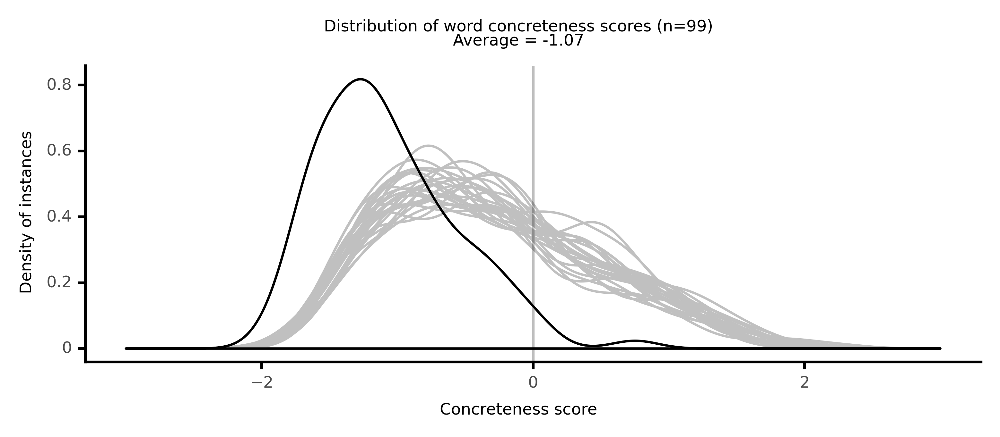

<ggplot: (8764098909229)>

 12%|█▏        | 12/100 [02:27<17:43, 12.08s/it]

#### #13 most abstract passage: Cooper, _The Crater; or, Vulcan's Peak. A Tale of the Pacif_ (1847)

<p><abs><conc025>consequences</conc025></abs>. Now, if a <abs><conc158>majority</conc158></abs> has a right to <abs><conc103>rule</conc103></abs>, in this <abs><conc012>arbitrary</conc012></abs> manner, it has a right to <neither><conc564>set</conc564></neither> its <abs><conc049>dogmas</conc049></abs> above the <abs><conc191>commandments</conc191></abs>, and to <abs><conc082>legalize</conc082></abs> <neither><conc318>theft</conc318></neither>, <neither><conc377>murder</conc377></neither>, <abs><conc223>adultery</conc223></abs>, and all the other <abs><conc152>sins</conc152></abs> <abs><conc042>denounced</conc042></abs> in the twentieth chapter of <abs><conc237>Exodus</conc237></abs>. This was a <neither><conc487>poser</conc487></neither> to the <abs><conc082>demagogue</conc082></abs>, but he made an <abs><conc124>effort</conc124></abs> to get <neither><conc341>rid</conc341></neither> of it, by excepting the <abs><conc048>laws</conc048></abs> of God, which he <neither><conc288>allowed</conc288></neither> that even <abs><conc126>majorities</conc126></abs> were <neither><conc286>bound</conc286></neither> to <abs><conc021>respect</conc021></abs>. Thereupon, the governor replied that the <abs><conc048>laws</conc048></abs> of God were nothing but the great <abs><conc016>principles</conc016></abs> which aught to <abs><conc042>govern</conc042></abs> <abs><conc115>human</conc115></abs> <abs><conc010>conduct</conc010></abs>, and that his <abs><conc100>concession</conc100></abs> was an <abs><conc021>avowal</conc021></abs> that there was a <abs><conc028>power</conc028></abs> to which <abs><conc126>majorities</conc126></abs> should <abs><conc114>defer</conc114></abs>. Now, this was just as <abs><conc024>true</conc024></abs> of <abs><conc068>minorities</conc068></abs> as it was of <abs><conc126>majorities</conc126></abs>, and the amount of it all was that men, in <abs><conc136>establishing</conc136></abs> <abs><conc097>governments</conc097></abs>, merely <neither><conc564>set</conc564></neither> up a <abs><conc180>standard</conc180></abs> of <abs><conc016>principles</conc016></abs> which they <abs><conc208>pledged</conc208></abs> themselves to <abs><conc021>respect</conc021></abs>; and that, even in the most <abs><conc017>democratical</conc017></abs> <abs><conc169>communities</conc169></abs>, all that <abs><conc126>majorities</conc126></abs> could <abs><conc231>legally</conc231></abs> effect was to <abs><conc219>decide</conc219></abs> certain <neither><conc281>minor</conc281></neither> <abs><conc154>questions</conc154></abs> which, being necessarily <abs><conc243>referred</conc243></abs> to some <abs><conc118>tribunal</conc118></abs> for <abs><conc112>decision</conc112></abs>, was of <abs><conc236>preference</conc236></abs> <abs><conc243>referred</conc243></abs> to them. If there was a <abs><conc028>power</conc028></abs> <abs><conc164>superior</conc164></abs> to the will of the <abs><conc158>majority</conc158></abs>, in the <neither><conc264>management</conc264></neither> of <abs><conc115>human</conc115></abs> <abs><conc124>affairs</conc124></abs>, then <abs><conc126>majorities</conc126></abs> were not <abs><conc098>supreme</conc098></abs>; and it <abs><conc178>behooved</conc178></abs> the <abs><conc238>citizen</conc238></abs> to regard the last as only what they really are, and what they were probably <abs><conc261>designed</conc261></abs> to be-- <abs><conc071>tribunals</conc071></abs> <abs><conc047>subject</conc047></abs> to the <abs><conc124>control</conc124></abs> of certain just <abs><conc016>principles</conc016></abs>. <abs><conc199>Constitutions</conc199></abs>, or the <abs><conc054>fundamental</conc054></abs> <abs><conc022>law</conc022></abs>, the governor went on to say, were <abs><conc223>meant</conc223></abs> to be the <abs><conc132>expression</conc132></abs> of those just and <abs><conc129>general</conc129></abs> <abs><conc016>principles</conc016></abs> which should <abs><conc124>control</conc124></abs> <abs><conc115>human</conc115></abs> <abs><conc147>society</conc147></abs>, and as such should <abs><conc094>prevail</conc094></abs> over <abs><conc126>majorities</conc126></abs>. <abs><conc199>Constitutions</conc199></abs> were <abs><conc262>expressly</conc262></abs> <abs><conc245>intended</conc245></abs> to <abs><conc181>defend</conc181></abs> the <abs><conc096>rights</conc096></abs> of <abs><conc068>minorities</conc068></abs>; since without them, each <abs><conc153>question</conc153></abs>, or interest, might be <neither><conc333>settled</conc333></neither> by the <abs><conc158>majority</conc158></abs>, as it <neither><conc404>arose</conc404></neither>. It was but a <abs><conc055>truism</conc055></abs> to say that the <abs><conc064>oppression</conc064></abs> of the <abs><conc158>majority</conc158></abs> was the worst sort of <abs><conc064>oppression</conc064></abs>; since the <abs><conc193>parties</conc193></abs> <neither><conc448>injured</conc448></neither> not only <abs><conc184>endured</conc184></abs> the <neither><conc361>burden</conc361></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

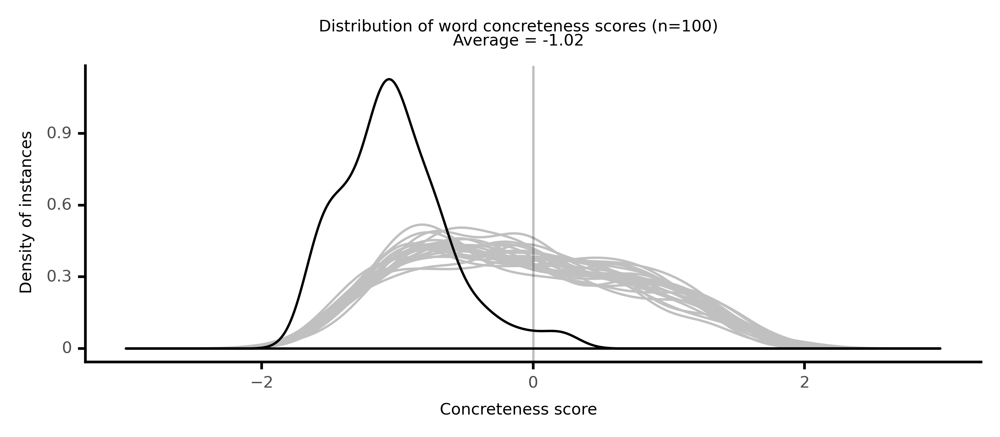

<ggplot: (8764098445725)>

 13%|█▎        | 13/100 [02:38<16:58, 11.71s/it]

#### #14 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>, <abs><conc033>wisdom</conc033></abs> and <abs><conc093>goodness</conc093></abs>; the <abs><conc042>Creator</conc042></abs>, <abs><conc163>Contriver</conc163></abs>, and Governor of this world, to whom <abs><conc017>mankind</conc017></abs> are <abs><conc140>indebted</conc140></abs> for <neither><conc263>innumerable</conc263></neither> <abs><conc019>benefits</conc019></abs> most <abs><conc027>gratuitously</conc027></abs> <neither><conc243>bestowed</conc243></neither>; we aught to <abs><conc012>manifest</conc012></abs> the most <abs><conc223>ardent</conc223></abs> love and <abs><conc119>veneration</conc119></abs> towards the <abs><conc090>Deity</conc090></abs>, and <abs><conc172>worship</conc172></abs> him with <abs><conc140>affections</conc140></abs> of <abs><conc194>Soul</conc194></abs> <abs><conc161>suited</conc161></abs> to the <abs><conc013>preeminence</conc013></abs> and <abs><conc124>infinite</conc124></abs> <neither><conc299>grandeur</conc299></neither> of the <abs><conc110>original</conc110></abs> Cause of all; aught to <abs><conc151>obey</conc151></abs> him, as far as <abs><conc115>human</conc115></abs> <abs><conc061>weakness</conc061></abs> can go, and <abs><conc233>humbly</conc233></abs> <abs><conc033>submit</conc033></abs> and <neither><conc250>resign</conc250></neither> ourselves and all our <abs><conc036>interests</conc036></abs> to his will; <neither><conc284>continually</conc284></neither> <abs><conc101>confide</conc101></abs> in his <abs><conc093>goodness</conc093></abs>, and <neither><conc326>constantly</conc326></neither> <abs><conc182>imitate</conc182></abs> him as far as our <abs><conc192>weak</conc192></abs> <abs><conc083>nature</conc083></abs> is <abs><conc107>capable</conc107></abs>. This is due to that <abs><conc110>original</conc110></abs> most <abs><conc147>gracious</conc147></abs> <abs><conc020>Power</conc020></abs> who <neither><conc429>formed</conc429></neither> us, and with a <abs><conc093>liberal</conc093></abs> <neither><conc549>hand</conc549></neither> <neither><conc328>supplies</conc328></neither> us with all things <abs><conc061>conducive</conc061></abs> to such <abs><conc191>pleasure</conc191></abs> and <abs><conc063>happiness</conc063></abs> as our <abs><conc083>nature</conc083></abs> can <neither><conc238>receive</conc238></neither>:-- That in <abs><conc047>respect</conc047></abs> of <abs><conc017>mankind</conc017></abs>, our <abs><conc077>natural</conc077></abs> <abs><conc039>sense</conc039></abs> of right and <abs><conc085>wrong</conc085></abs> <neither><conc320>points</conc320></neither> out to us the <abs><conc155>duties</conc155></abs> to be <neither><conc351>performed</conc351></neither> towards others, and the <neither><conc392>kind</conc392></neither> <abs><conc140>affections</conc140></abs> <abs><conc063>implanted</conc063></abs> by <abs><conc083>nature</conc083></abs>, <abs><conc163>excites</conc163></abs> us to the <neither><conc252>discharge</conc252></neither> of them: that by the <abs><conc016>law</conc016></abs> of our <abs><conc098>constitution</conc098></abs> and <abs><conc083>nature</conc083></abs>, <abs><conc028>justice</conc028></abs> and <abs><conc031>benevolence</conc031></abs> are <abs><conc203>prescribed</conc203></abs>; and <abs><conc080>aids</conc080></abs> and an <abs><conc201>intercourse</conc201></abs> of <abs><conc170>mutual</conc170></abs> <abs><conc150>offices</conc150></abs> <abs><conc090>required</conc090></abs>, not only to <abs><conc208>secure</conc208></abs> our <abs><conc191>pleasure</conc191></abs> and <abs><conc063>happiness</conc063></abs>, but to <abs><conc227>preserve</conc227></abs> ourselves in <abs><conc117>safety</conc117></abs> and in life: that the <abs><conc016>law</conc016></abs> of <abs><conc083>nature</conc083></abs>, or <abs><conc077>natural</conc077></abs> right, <abs><conc132>forbids</conc132></abs> every <abs><conc130>instance</conc130></abs> of <abs><conc007>injustice</conc007></abs>, a <abs><conc052>violation</conc052></abs> of life, <abs><conc055>liberty</conc055></abs>, <neither><conc363>health</conc363></neither>, <abs><conc174>property</conc174></abs>; and the <abs><conc064>exercise</conc064></abs> of our <abs><conc085>honourable</conc085></abs>, <neither><conc392>kind</conc392></neither> <abs><conc054>powers</conc054></abs>, are not only a <conc><conc813>spring</conc813></conc> of <abs><conc182>vigorous</conc182></abs> <abs><conc135>efforts</conc135></abs> to do good to others, and thereby <abs><conc208>secure</conc208></abs> the <abs><conc232>common</conc232></abs> <abs><conc063>happiness</conc063></abs>; but they really <neither><conc290>procure</conc290></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

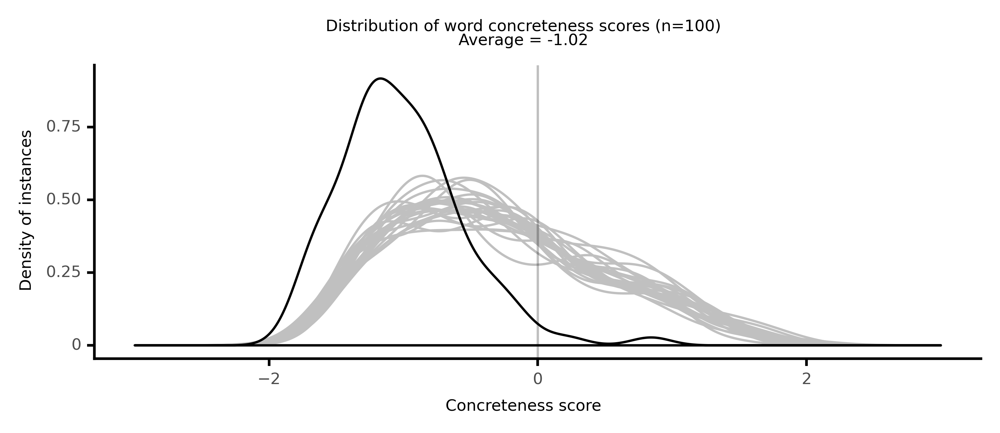

<ggplot: (8764107622765)>

 14%|█▍        | 14/100 [02:52<17:44, 12.38s/it]

#### #15 most abstract passage: Brunton, _Self-Control: A Novel. Second Edition._ (1811)

<p>the <abs><conc081>impossibility</conc081></abs> that <abs><conc088>repentance</conc088></abs> should, of itself, <abs><conc257>cancel</conc257></abs> <abs><conc020>errors</conc020></abs> <neither><conc422>passed</conc422></neither>, or that the great <abs><conc014>Lawgiver</conc014></abs> should <abs><conc078>accept</conc078></abs> a few <neither><conc305>ineffectual</conc305></neither> <neither><conc590>tears</conc590></neither>, or a <abs><conc241>tardy</conc241></abs> and <abs><conc117>imperfect</conc117></abs> <abs><conc063>obedience</conc063></abs>, as a <abs><conc165>compensation</conc165></abs> for the <abs><conc211>breach</conc211></abs> of a <abs><conc022>law</conc022></abs> that is <neither><conc275>perfect</conc275></neither>. When she saw that the <abs><conc245>intended</conc245></abs> <abs><conc245>impression</conc245></abs> was made, she spoke of the great <abs><conc050>atonement</conc050></abs> that once was <neither><conc297>offered</conc297></neither>, not to make <abs><conc088>repentance</conc088></abs> <abs><conc121>unnecessary</conc121></abs>, but to make it <abs><conc172>effectual</conc172></abs>: and, from that time, using this as one of the great <abs><conc206>landmarks</conc206></abs> of <abs><conc023>faith</conc023></abs>, she <abs><conc222>contributed</conc222></abs> to <abs><conc106>render</conc106></abs> it in the mind of De Courcy a <abs><conc040>practical</conc040></abs> and <abs><conc095>abiding</conc095></abs> <abs><conc033>principle</conc033></abs>. The <abs><conc190>peculiar</conc190></abs> <abs><conc054>precepts</conc054></abs> of <abs><conc049>Christianity</conc049></abs> she <abs><conc181>taught</conc181></abs> him to <abs><conc170>apply</conc170></abs> to his <abs><conc010>actions</conc010></abs>, by <abs><conc235>applying</conc235></abs> them herself; and the <abs><conc130>praise</conc130></abs> that is so often <neither><conc385>lavished</conc385></neither> upon <abs><conc058>boldness</conc058></abs>, <neither><conc425>dexterity</conc425></neither>, and <abs><conc008>spirit</conc008></abs>, she <abs><conc086>conscientiously</conc086></abs> <neither><conc275>reserved</conc275></neither> for <abs><conc031>acts</conc031></abs> of <abs><conc028>candour</conc028></abs>, <abs><conc120>humility</conc120></abs>, and <abs><conc104>self-denial</conc104></abs>. Her <neither><conc322>cares</conc322></neither> were <abs><conc182>amply</conc182></abs> <abs><conc253>rewarded</conc253></abs>, and Montague became all that she <neither><conc354>wished</conc354></neither> him to be. He was a <abs><conc057>Christian</conc057></abs> from the <neither><conc275>heart</conc275></neither>, without being either <neither><conc469>forward</conc469></neither> to <abs><conc093>claim</conc093></abs>, or <neither><conc343>ashamed</conc343></neither> to own, the <abs><conc080>distinction</conc080></abs>. He was <neither><conc320>industrious</conc320></neither> in his <abs><conc114>pursuits</conc114></abs>, and <neither><conc274>simple</conc274></neither> in his <abs><conc225>pleasures</conc225></abs>. But the <abs><conc216>distinctive</conc216></abs> <neither><conc341>feature</conc341></neither> of his <abs><conc025>character</conc025></abs>, was the <abs><conc232>total</conc232></abs> <abs><conc189>absence</conc189></abs> of <abs><conc068>selfishness</conc068></abs>. His own <abs><conc219>pleasure</conc219></abs> or his own <neither><conc381>amusement</conc381></neither> he never <neither><conc501>hesitated</conc501></neither> to <abs><conc136>sacrifice</conc136></abs> to the <abs><conc164>wishes</conc164></abs> of others; or, to speak more <abs><conc228>correctly</conc228></abs>, he found his <abs><conc219>pleasure</conc219></abs> and <neither><conc381>amusement</conc381></neither> in theirs. Upon the whole, we do not say that Montague De Courcy had no <abs><conc101>faults</conc101></abs>, but we are sure he had none that he did not <abs><conc182>strive</conc182></abs> to <abs><conc175>conquer</conc175></abs>. Like other <abs><conc115>human</conc115></abs> <abs><conc247>beings</conc247></abs>, he sometime <abs><conc210>acted</conc210></abs> <abs><conc094>wrong</conc094></abs>; but we believe he would not <neither><conc437>deliberately</conc437></neither> have <neither><conc337>neglected</conc337></neither> a known <abs><conc127>duty</conc127></abs> to <neither><conc318>escape</conc318></neither> any <abs><conc135>worldly</conc135></abs> <abs><conc146>misfortune</conc146></abs>; we are sure he would not <neither><conc437>deliberately</conc437></neither> have <abs><conc138>committed</conc138></abs> a <abs><conc076>crime</conc076></abs> to <abs><conc121>attain</conc121></abs> any <abs><conc197>earthly</conc197></abs> <abs><conc201>advantage</conc201></abs>. <abs><conc148>Desirous</conc148></abs> that her <neither><conc724>darling</conc724></neither> should <neither><conc264>enjoy</conc264></neither> the <abs><conc065>benefits</conc065></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

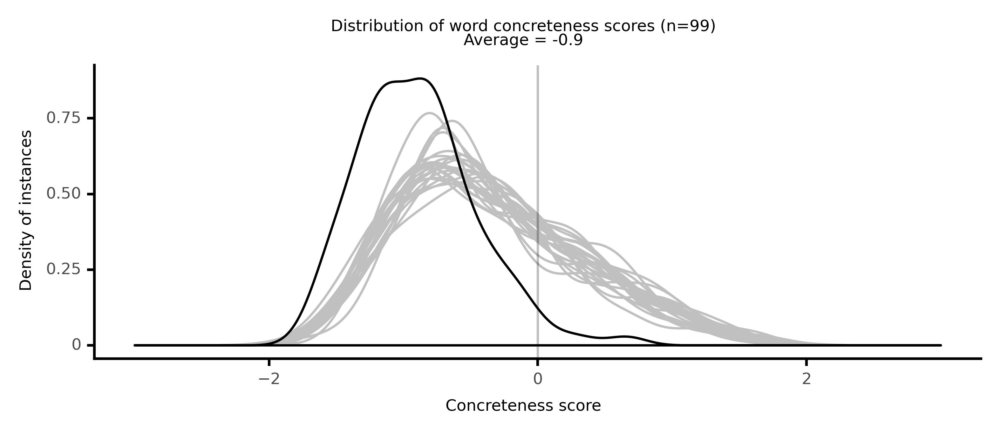

<ggplot: (8764103996981)>

 15%|█▌        | 15/100 [03:03<16:59, 12.00s/it]

#### #16 most abstract passage: Herbert, _The Princess Cloria (1661)_ (1661)

<p>of the Myssians, then a <abs><conc195>common</conc195></abs> <abs><conc032>Government</conc032></abs>, either in Lydia or Myssia; and therefore not <abs><conc089>probable</conc089></abs> they should <neither><conc259>join</conc259></neither> in such a <abs><conc138>strict</conc138></abs> <neither><conc273>amity</conc273></neither> with the <abs><conc224>Senate</conc224></abs>, as <abs><conc010>absolutely</conc010></abs> to <neither><conc266>destroy</conc266></neither> the <abs><conc080>prerogative</conc080></abs>, and <abs><conc137>Kingly</conc137></abs> <abs><conc122>jurisdiction</conc122></abs> of Euarchus, since by that <abs><conc048>conclusion</conc048></abs>, they would neither be able to <abs><conc184>temper</conc184></abs> their own <abs><conc191>factions</conc191></abs> at home, amongst the <neither><conc279>Nobility</conc279></neither> and persons of greatest <neither><conc382>quality</conc382></neither>, nor have any <abs><conc110>hope</conc110></abs> to <abs><conc155>receive</conc155></abs> <abs><conc069>benefit</conc069></abs> from other <abs><conc199>Princes</conc199></abs> abroad in their occasions: And whereas many may be <abs><conc077>persuaded</conc077></abs> to believe, that by <abs><conc153>agreeing</conc153></abs> in those <abs><conc104>designs</conc104></abs>, for the <abs><conc008>absolute</conc008></abs> <abs><conc115>overthrowing</conc115></abs> of <abs><conc181>Monarchy</conc181></abs> in Lydia, they might in time come to be <neither><conc246>equal</conc246></neither> <abs><conc118>sharers</conc118></abs> in the <abs><conc032>Government</conc032></abs> of both <abs><conc167>Kingdoms</conc167></abs>; and so consequently <abs><conc172>participate</conc172></abs> <neither><conc263>alike</conc263></neither> in the <abs><conc129>profit</conc129></abs> and <abs><conc192>gain</conc192></abs>, being the <neither><conc395>chief</conc395></neither>( if not the only) thing their <neither><conc249>covetous</conc249></neither> <abs><conc030>dispositions</conc030></abs> look after, such thoughts are <abs><conc046>mere</conc046></abs> <neither><conc241>fancies</conc241></neither> and chymera's: For certainly the <abs><conc224>Senate</conc224></abs> <abs><conc027>understanding</conc027></abs> well the <abs><conc130>poorness</conc130></abs> of the Country of Myssia, and not being <abs><conc041>ignorant</conc041></abs> of the <abs><conc201>secret</conc201></abs> <abs><conc043>intentions</conc043></abs> of the people, <abs><conc204>withal</conc204></abs> how <neither><conc356>insulting</conc356></neither> and <abs><conc199>encroaching</conc199></abs> they are in their <abs><conc081>nature</conc081></abs>'s; will be sure to take <abs><conc176>order</conc176></abs>, they shall have no more interest in the <abs><conc075>Affairs</conc075></abs> of Lydia, then is entirely necessary for their own <abs><conc130>service</conc130></abs> and <neither><conc537>commodity</conc537></neither>: So that when the Myssians shall find their <abs><conc068>aims</conc068></abs> to <neither><conc277>fail</conc277></neither> in these <abs><conc113>particulars</conc113></abs>, it is to be <abs><conc170>imagined</conc170></abs> that they will not only be <abs><conc077>persuaded</conc077></abs>, upon the least <abs><conc048>endeavour</conc048></abs> of the State of Syria, to <neither><conc518>fall</conc518></neither> off from the Lydian <abs><conc154>faction</conc154></abs>, but even to make a <abs><conc226>War</conc226></abs> with that <abs><conc092>Nation</conc092></abs> it self, for the <abs><conc075>establishing</conc075></abs> again of their King in his <neither><conc253>ancient</conc253></neither> <abs><conc124>glory</conc124></abs> and <abs><conc201>command</conc201></abs>, and to that effect <abs><conc100>adhere</conc100></abs> either to Syria or any other <abs><conc092>Nation</conc092></abs> that may <abs><conc157>assist</conc157></abs> them in those <abs><conc031>proceedings</conc031></abs>: Only this <abs><conc060>doubt</conc060></abs> in some sort may be made, that Argilius and Lycius, who so <abs><conc152>unworthily</conc152></abs> have <neither><conc453>betrayed</conc453></neither> the <neither><conc323>Kings</conc323></neither> person for a <neither><conc336>sum</conc336></neither> of <neither><conc592>money</conc592></neither>, will never by their good <abs><conc007>wills</conc007></abs> <abs><conc103>trust</conc103></abs> themselves any more under his <abs><conc024>power</conc024></abs>, for <abs><conc171>fear</conc171></abs> of <abs><conc198>revenge</conc198></abs> <abs><conc114>answerable</conc114></abs> to their <neither><conc382>deserts</conc382></neither>; and they being the most <abs><conc194>principal</conc194></abs> men of the Country, it is to be <neither><conc299>suspected</conc299></neither>, they will have so great <abs><conc024>power</conc024></abs> and <abs><conc107>influence</conc107></abs>, over the <abs><conc004>actions</conc004></abs> and <abs><conc003>determinations</conc003></abs> of the <neither><conc399>rest</conc399></neither> of the <neither><conc622>Inhabitants</conc622></neither> in the <abs><conc074>general</conc074></abs>, that they can never be brought in any <abs><conc212>kind</conc212></abs> to own the <neither><conc323>Kings</conc323></neither> Interest to <abs><conc173>purpose</conc173></abs>, <abs><conc055>notwithstanding</conc055></abs> all the <abs><conc234>labour</conc234></abs> and <abs><conc183>industry</conc183></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

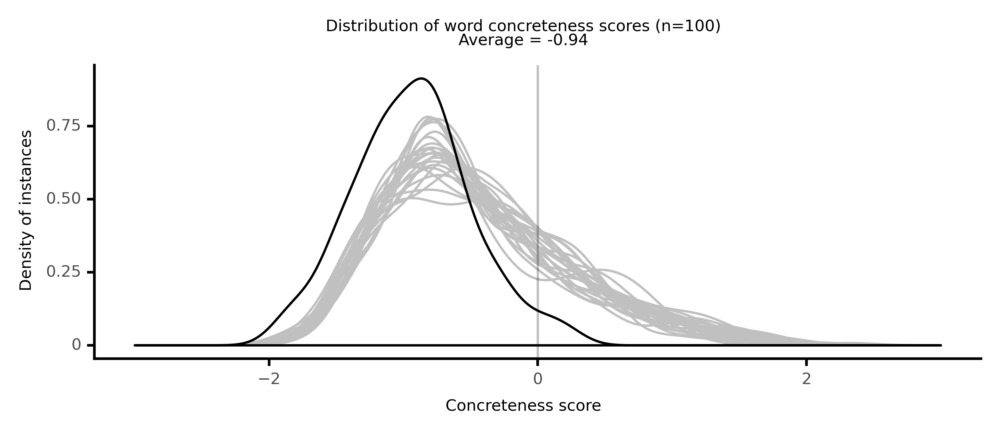

<ggplot: (8764100375273)>

 16%|█▌        | 16/100 [03:19<18:21, 13.11s/it]

#### #17 most abstract passage: Brown, _Ormond; or, The Secret Witness . . . (1799)_ (1799)

<p>. The <abs><conc188>union</conc188></abs> was <abs><conc140>indebted</conc140></abs> for its <conc><conc900>valve</conc900></conc> on the voluntariness with which it was <neither><conc429>formed</conc429></neither>, and the <neither><conc340>entire</conc340></neither> <abs><conc025>acquiescence</conc025></abs> of the <abs><conc016>judgement</conc016></abs> of both <abs><conc167>parties</conc167></abs> in its <abs><conc010>rectitude</conc010></abs>. <abs><conc112>Dissimulation</conc112></abs> and <abs><conc195>artifice</conc195></abs> were <abs><conc140>wholly</conc140></abs> <neither><conc240>foreign</conc240></neither> to the <abs><conc132>success</conc132></abs> of his <neither><conc289>project</conc289></neither>. If the lady thought <abs><conc196>proper</conc196></abs> to <abs><conc062>assent</conc062></abs> to his <abs><conc227>proposal</conc227></abs>, it was well. She did so because <abs><conc062>assent</conc062></abs> was more <abs><conc144>eligible</conc144></abs> than <abs><conc129>refusal</conc129></abs>. She would, no <abs><conc097>doubt</conc097></abs>, <abs><conc219>prefer</conc219></abs> <neither><conc360>marriage</conc360></neither>. She would <abs><conc130>deem</conc130></abs> it more <abs><conc061>conducive</conc061></abs> to <abs><conc063>happiness</conc063></abs>. This was an <abs><conc035>error</conc035></abs>. This was an <abs><conc033>opinion</conc033></abs>, his <abs><conc058>reasons</conc058></abs> for which he was at <abs><conc055>liberty</conc055></abs> to state to her; at least it was <abs><conc001>justifiable</conc001></abs> in <abs><conc185>refusing</conc185></abs> to <abs><conc046>subject</conc046></abs> himself to <neither><conc627>loathsome</conc627></neither> and <abs><conc111>impracticable</conc111></abs> <abs><conc042>obligations</conc042></abs>. Certain <abs><conc145>inconveniences</conc145></abs> <neither><conc322>attended</conc322></neither> women who <neither><conc597>set</conc597></neither> aside, on these occasions, the <abs><conc055>sanction</conc055></abs> of <abs><conc016>law</conc016></abs>, but these were <abs><conc098>imaginary</conc098></abs>. They <abs><conc059>owed</conc059></abs> their <abs><conc176>force</conc176></abs> to the <abs><conc018>errors</conc018></abs> of the <abs><conc160>sufferer</conc160></abs>. To <abs><conc025>annihilate</conc025></abs> them, it was only necessary to <abs><conc031>reason</conc031></abs> <abs><conc026>justly</conc026></abs>, but <abs><conc145>allowing</conc145></abs> these <abs><conc145>inconveniences</conc145></abs> their full <neither><conc495>weight</conc495></neither> and an industructable <abs><conc047>existence</conc047></abs>, it was but a <abs><conc145>choice</conc145></abs> of <abs><conc066>evils</conc066></abs>. Were they worse in this lady's <abs><conc069>apprehension</conc069></abs>, than an <abs><conc102>eternal</conc102></abs> and <abs><conc224>hopeless</conc224></abs> <abs><conc173>separation</conc173></abs>? Perhaps they were. If so, she would make her <abs><conc080>election</conc080></abs> accordingly. He did nothing but lay the <abs><conc066>conditions</conc066></abs> before her. If his <abs><conc131>scheme</conc131></abs> should obtain the <abs><conc025>concurrence</conc025></abs> of her unbiased <abs><conc016>judgement</conc016></abs> he should <abs><conc211>rejoice</conc211></abs>. If not, her <abs><conc010>conduct</conc010></abs> should be <abs><conc000>uninfluenced</conc000></abs> by him. Whatever way she should <abs><conc123>decide</conc123></abs>, he would <abs><conc230>assist</conc230></abs> her in <neither><conc250>adhering</conc250></neither> to her <abs><conc017>decision</conc017></abs>, but would, meanwhile, <neither><conc363>furnish</conc363></neither> her with the <neither><conc554>materials</conc554></neither> of a right <abs><conc017>decision</conc017></abs>. This <abs><conc033>determination</conc033></abs> was <neither><conc301>singular</conc301></neither>. Many will regard it as <neither><conc284>incredible</conc284></neither>. No man, it will be thought can put this <neither><conc260>deception</conc260></neither> on himself, and <abs><conc163>imagine</conc163></abs> that there was <abs><conc184>genuine</conc184></abs> <abs><conc016>beneficence</conc016></abs> in a <abs><conc131>scheme</conc131></abs> Like this. Would the lady more <abs><conc140>consult</conc140></abs> her <abs><conc063>happiness</conc063></abs> by <abs><conc010>adopting</conc010></abs> than by <abs><conc026>rejecting</conc026></abs> it? There can be but one <abs><conc148>answer</conc148></abs>. It can not be <abs><conc230>supposed</conc230></abs> that Ormond, in <abs><conc046>stating</conc046></abs> this <abs><conc227>proposal</conc227></abs>, <abs><conc161>acted</conc161></abs> with all the <abs><conc017>impartiality</conc017></abs> that he <abs><conc082>pretended</conc082></abs>; that he did not <abs><conc235>employ</conc235></abs> <abs><conc063>fallacious</conc063></abs> <abs><conc027>exaggerations</conc027></abs> and <abs><conc093>ambiguous</conc093></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

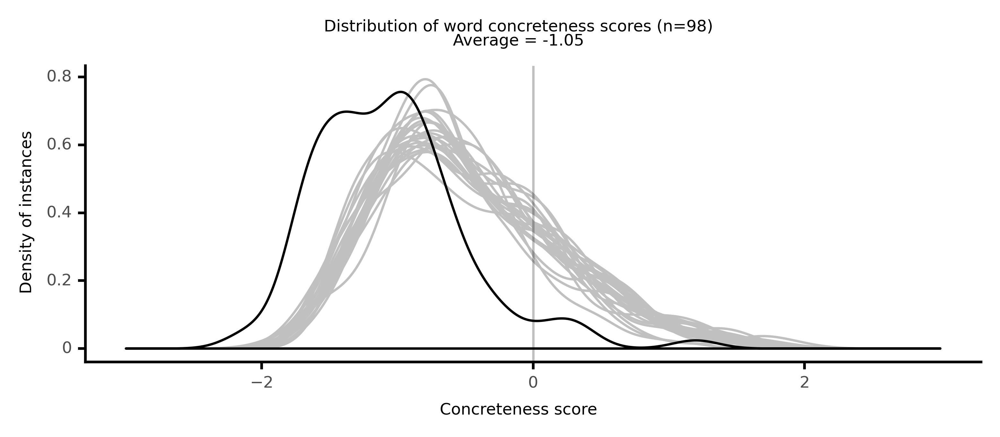

<ggplot: (8764106102741)>

 17%|█▋        | 17/100 [03:30<17:27, 12.62s/it]

#### #18 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>. The <neither><conc283>sacred</conc283></neither> <abs><conc064>writings</conc064></abs> would appear to be what they are-- a system of <abs><conc043>religion</conc043></abs> that <neither><conc245>answers</conc245></neither> to all our <abs><conc157>wishes</conc157></abs> and <abs><conc133>desires</conc133></abs>:-- that <abs><conc131>requires</conc131></abs> of us that <abs><conc022>obedience</conc022></abs> to which as <abs><conc003>rational</conc003></abs> <abs><conc103>beings</conc103></abs> we are <abs><conc001>antecedently</conc001></abs> <neither><conc415>bound</conc415></neither>; and <abs><conc170>offers</conc170></abs> us <abs><conc029>rewards</conc029></abs> for <abs><conc025>obeying</conc025></abs> more than <abs><conc083>nature</conc083></abs> could ever <abs><conc091>claim</conc091></abs>. In the <abs><conc051>gospel</conc051></abs>, we have the <abs><conc043>religion</conc043></abs> of <abs><conc083>nature</conc083></abs> in <neither><conc263>perfection</conc263></neither>, and with it a <abs><conc055>certainty</conc055></abs> of <abs><conc129>mercy</conc129></abs> and <neither><conc274>unutterable</conc274></neither> <abs><conc201>blessings</conc201></abs>: but in <abs><conc077>natural</conc077></abs> <abs><conc043>religion</conc043></abs>, as the <abs><conc031>reason</conc031></abs> and <abs><conc056>understanding</conc056></abs> of men can <neither><conc312>collect</conc312></neither> it, our <abs><conc131>Hope</conc131></abs>'s of <abs><conc130>pardon</conc130></abs> and <abs><conc115>glory</conc115></abs> have but <abs><conc103>uncertain</conc103></abs> <abs><conc139>foundation</conc139></abs>. Without <abs><conc017>revelation</conc017></abs>, our <abs><conc131>Hope</conc131></abs>'s are <abs><conc109>liable</conc109></abs> to be <neither><conc261>disturbed</conc261></neither> and <neither><conc396>shaken</conc396></neither> by <neither><conc338>frequent</conc338></neither> <abs><conc084>doubts</conc084></abs> and <abs><conc091>misgivings</conc091></abs> of mind: but in <abs><conc040>revealed</conc040></abs> <abs><conc043>religion</conc043></abs>, that is, the <abs><conc013>moral</conc013></abs> <abs><conc016>law</conc016></abs> <neither><conc296>republished</conc296></neither> by <abs><conc040>inspired</conc040></abs> men, the <abs><conc095>promises</conc095></abs> of the <abs><conc051>gospel</conc051></abs> take in all the <abs><conc157>wishes</conc157></abs> of <abs><conc083>nature</conc083></abs>, and <abs><conc024>establish</conc024></abs> all her <abs><conc131>Hope</conc131></abs>'s. <neither><conc300>Blessed</conc300></neither> be God then for <neither><conc329>sending</conc329></neither> his <abs><conc199>well-beloved</conc199></abs> <abs><conc201>Son</conc201></abs> into the world. From him we have a <abs><conc016>law</conc016></abs> that is <abs><conc194>holy</conc194></abs>, and the <abs><conc143>commandment</conc143></abs> <abs><conc194>holy</conc194></abs>, and just, and good: and by a <abs><conc181>dutiful</conc181></abs> <abs><conc018>submission</conc018></abs> to this <neither><conc447>plain</conc447></neither> and <abs><conc226>perfect</conc226></abs> <abs><conc016>law</conc016></abs>,( in which there is no <abs><conc229>mystery</conc229></abs>, no <abs><conc019>inconsistency</conc019></abs>, no <abs><conc008>contradiction</conc008></abs>,) we are <abs><conc220>delivered</conc220></abs> from <abs><conc015>condemnation</conc015></abs> by the <neither><conc291>grace</conc291></neither> of God through Christ. Here is <abs><conc031>reason</conc031></abs> for <abs><conc222>adoring</conc222></abs> the <abs><conc054>divine</conc054></abs> <abs><conc093>goodness</conc093></abs>. The <abs><conc051>gospel</conc051></abs> gives a better <abs><conc054>evidence</conc054></abs> for the <abs><conc065>truth</conc065></abs> and <abs><conc055>certainty</conc055></abs> of life and <abs><conc077>immortality</conc077></abs> than <abs><conc083>nature</conc083></abs> before had given, and thereby <neither><conc344>displays</conc344></neither> the love that God has for the children of men. To this Mr. Berrisfort said, that he thought my <abs><conc116>plea</conc116></abs> for <abs><conc110>original</conc110></abs> <abs><conc033>christianity</conc033></abs> was good, and <abs><conc144>allowed</conc144></abs> it was not the <abs><conc051>gospel</conc051></abs> that was <abs><conc088>faulty</conc088></abs> in <abs><conc229>mystery</conc229></abs> and <abs><conc100>obscurity</conc100></abs>, <abs><conc008>contradiction</conc008></abs> and <abs><conc019>inconsistency</conc019></abs>; but, <abs><conc115>human</conc115></abs> <abs><conc032>ignorance</conc032></abs>, and <abs><conc115>human</conc115></abs> <abs><conc139>vanity</conc139></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

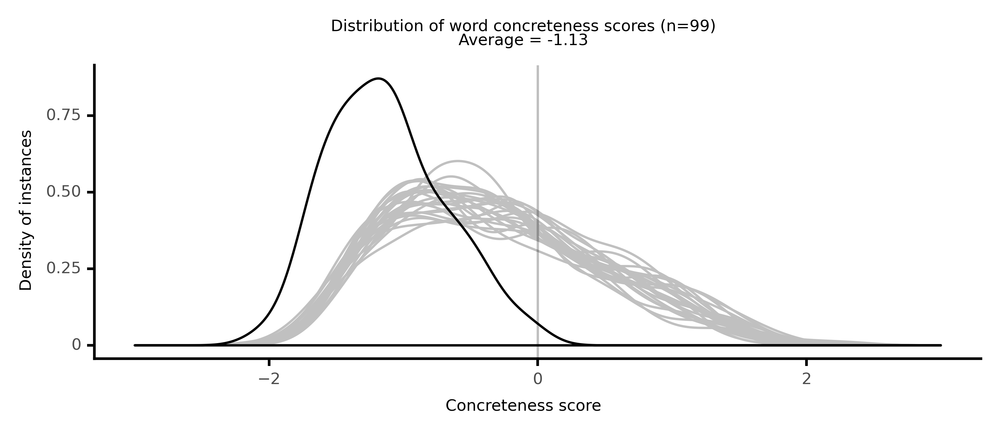

<ggplot: (8764104878861)>

 18%|█▊        | 18/100 [03:45<17:53, 13.09s/it]

#### #19 most abstract passage: Ware, _Probus; or, Rome in the Third Century. In Letters _ (1838)

<p>and <abs><conc086>eternal</conc086></abs>. This <abs><conc008>doctrine</conc008></abs> therefore, which is the <abs><conc205>chief</conc205></abs> of all, being so <abs><conc054>fundamental</conc054></abs> with us, it is not <neither><conc264>easy</conc264></neither>, I say, to see how we can on <abs><conc043>religious</conc043></abs> <abs><conc206>accounts</conc206></abs> be <abs><conc175>dangerous</conc175></abs> to the state. For many things are <abs><conc193>comprehended</conc193></abs> in and <abs><conc177>follow</conc177></abs> from this <abs><conc023>faith</conc023></abs>. It is not a <neither><conc420>barren</conc420></neither>, <abs><conc179>unprofitable</conc179></abs> <abs><conc118>speculation</conc118></abs>, but a <abs><conc040>practical</conc040></abs> and <abs><conc140>restraining</conc140></abs> <abs><conc008>doctrine</conc008></abs> of the greatest <abs><conc005>moral</conc005></abs> <abs><conc041>efficacy</conc041></abs>. If it be not this to us, to all and everyone of us, it is not what it aught to be, and we <abs><conc098>wrongly</conc098></abs> <abs><conc141>understand</conc141></abs> or else <abs><conc145>wilfully</conc145></abs> <abs><conc001>pervert</conc001></abs> it. We believe that we are everywhere <neither><conc560>surrounded</conc560></neither> by the <abs><conc177>presence</conc177></abs> of our God; that he is our <abs><conc178>witness</conc178></abs> every moment, and everywhere <abs><conc129>conscious</conc129></abs>, as we are ourselves, of our words, <abs><conc031>acts</conc031></abs>, and thoughts; and will bring us all to a <abs><conc114>strict</conc114></abs> account at last for whatever he has thus <neither><conc271>witnessed</conc271></neither> that has been <abs><conc072>contrary</conc072></abs> to that <neither><conc295>rigid</conc295></neither> <abs><conc022>law</conc022></abs> of <abs><conc197>holy</conc197></abs> <neither><conc301>living</conc301></neither> which he has <abs><conc172>established</conc172></abs> over us in Christ. Must not this act upon us most <abs><conc033>beneficially</conc033></abs>? We believe that in himself he is <neither><conc275>perfect</conc275></neither> <abs><conc202>purity</conc202></abs>, and that he <abs><conc041>demands</conc041></abs> of us that we be so in our <abs><conc077>degree</conc077></abs> also. We can <abs><conc001>impute</conc001></abs> to him none of the <abs><conc031>acts</conc031></abs>, such as the <abs><conc063>believers</conc063></abs> in the Greek and Roman <abs><conc052>religions</conc052></abs> <neither><conc272>freely</conc272></neither> <abs><conc001>ascribe</conc001></abs> to their Jove, and so have not, as others have, in such <abs><conc020>divine</conc020></abs> example a <abs><conc247>warrant</conc247></abs> and <neither><conc273>excuse</conc273></neither> for the Like <abs><conc028>enormities</conc028></abs>. This one God too we also regard as our <abs><conc137>judge</conc137></abs>, who will in the end <neither><conc652>sit</conc652></neither> upon our <abs><conc010>conduct</conc010></abs> throughout the whole of our <abs><conc253>lives</conc253></abs>, and <abs><conc111>punish</conc111></abs> or <abs><conc133>reward</conc133></abs> according to what we shall have been, just as the <abs><conc211>souls</conc211></abs> of men, according to your <abs><conc004>belief</conc004></abs>, <abs><conc261>receive</conc261></abs> their <abs><conc248>sentence</conc248></abs> at the <neither><conc558>bar</conc558></neither> of Minos and Rhadamanthus. And other similar <abs><conc053>truths</conc053></abs> are <conc><conc883>wrapped</conc883></conc> up with and make a part of this great <abs><conc242>primary</conc242></abs> one. Wherefore it is most <abs><conc116>evident</conc116></abs>, that nothing can be more <abs><conc085>false</conc085></abs> and <abs><conc107>absurd</conc107></abs> than to think and speak of us as <abs><conc009>atheists</conc009></abs>, and for that <abs><conc020>reason</conc020></abs> a <neither><conc301>nuisance</conc301></neither> in the state. But it is not only that we are <abs><conc009>atheists</conc009></abs>, but that through our <abs><conc007>atheism</conc007></abs> we are to be <neither><conc557>looked</conc557></neither> upon as <neither><conc456>disorderly</conc456></neither> <abs><conc246>members</conc246></abs> of <abs><conc147>society</conc147></abs>, <abs><conc164>disturbers</conc164></abs> of the <abs><conc093>peace</conc093></abs>, <abs><conc098>disaffected</conc098></abs> and <abs><conc207>rebellious</conc207></abs> <abs><conc194>citizens</conc194></abs>, that we hear on every side. I do not believe that this <neither><conc303>charge</conc303></neither> has ever been <abs><conc024>true</conc024></abs> of any; much less of all. Or if any <abs><conc057>Christian</conc057></abs> has at any time and for any <abs><conc020>reason</conc020></abs> <abs><conc150>disobeyed</conc150></abs> the <abs><conc048>laws</conc048></abs>, <abs><conc104>withheld</conc104></abs> his <neither><conc271>taxes</conc271></neither> when they have been <abs><conc205>demanded</conc205></abs>, or <neither><conc337>neglected</conc337></neither> any <abs><conc194>duties</conc194></abs> which as a <abs><conc238>citizen</conc238></abs> of Rome he has <abs><conc166>owed</conc166></abs> to the <abs><conc244>Emperor</conc244></abs> or any <abs><conc139>representative</conc139></abs> of him, then so far he has not been a <abs><conc057>Christian</conc057></abs>. Christ's <abs><conc186>kingdom</conc186></abs> is not of this world-- though, because we so often and so much speak of a <abs><conc186>kingdom</conc186></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

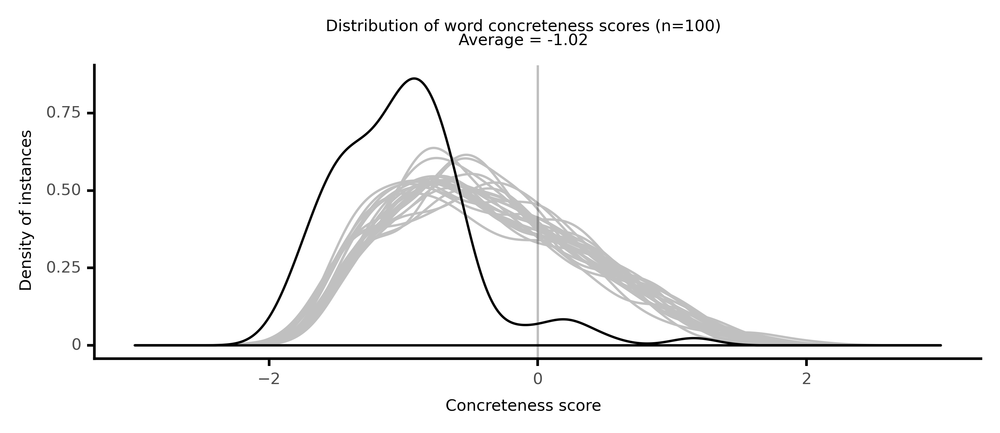

<ggplot: (8764104872001)>

 19%|█▉        | 19/100 [03:54<16:15, 12.04s/it]

#### #20 most abstract passage: Hale, _Liberia; or, Mr. Peyton's Experiments. Edited by S_ (1853)

<p>and <abs><conc101>defending</conc101></abs> life and <abs><conc056>liberty</conc056></abs>, of <abs><conc153>acquiring</conc153></abs>, <abs><conc184>possessing</conc184></abs>, and <neither><conc354>protecting</conc354></neither> <abs><conc213>property</conc213></abs>, and of <abs><conc212>pursuing</conc212></abs> and <abs><conc215>obtaining</conc215></abs> <abs><conc252>safety</conc252></abs> and <abs><conc149>happiness</conc149></abs>. Sec.2. All <abs><conc028>power</conc028></abs> is <abs><conc033>inherent</conc033></abs> in the people; all free <abs><conc097>governments</conc097></abs> are <abs><conc108>instituted</conc108></abs> by their <abs><conc017>authority</conc017></abs> and for their <abs><conc132>benefit</conc132></abs>, and they have a right to <neither><conc690>altar</conc690></neither> and <abs><conc065>reform</conc065></abs> the same when their <abs><conc252>safety</conc252></abs> and <abs><conc149>happiness</conc149></abs> <abs><conc202>require</conc202></abs> it. Sec.3. All men have a <abs><conc072>natural</conc072></abs> and <abs><conc080>inalienable</conc080></abs> right to <abs><conc208>worship</conc208></abs> God according to the <abs><conc031>dictates</conc031></abs> of their own <abs><conc067>consciences</conc067></abs>, without <neither><conc354>obstruction</conc354></neither> or <abs><conc166>molestation</conc166></abs> from others; all persons demeaning themselves <neither><conc338>peaceably</conc338></neither>, and not <neither><conc340>obstructing</conc340></neither> others in their <abs><conc043>religious</conc043></abs> <abs><conc208>worship</conc208></abs>, are <abs><conc138>entitled</conc138></abs> to the <abs><conc244>protection</conc244></abs> of <abs><conc022>law</conc022></abs> in the free <abs><conc097>exercise</conc097></abs> of their own <abs><conc025>religion</conc025></abs>, and no <abs><conc102>sect</conc102></abs> of <abs><conc084>Christians</conc084></abs> shall have <abs><conc202>exclusive</conc202></abs> <abs><conc128>privileges</conc128></abs> or <abs><conc236>preference</conc236></abs> over any other <abs><conc102>sect</conc102></abs>, but all shall be <abs><conc092>alike</conc092></abs> <abs><conc134>tolerated</conc134></abs>; and no <abs><conc043>religious</conc043></abs> <abs><conc138>test</conc138></abs> whatever shall be <abs><conc238>required</conc238></abs> as a <abs><conc060>qualification</conc060></abs> for <abs><conc069>civil</conc069></abs> <abs><conc173>office</conc173></abs>, or the <abs><conc097>exercise</conc097></abs> of any <abs><conc069>civil</conc069></abs> right. Sec.4. There shall be no <abs><conc125>slavery</conc125></abs> within this <abs><conc144>republic</conc144></abs>; nor shall any <abs><conc238>citizen</conc238></abs> of this <abs><conc144>republic</conc144></abs>, or any person <neither><conc379>resident</conc379></neither> therein, deal in <neither><conc318>slaves</conc318></neither>, either within or without this <abs><conc144>republic</conc144></abs>, <neither><conc302>directly</conc302></neither> or <abs><conc131>indirectly</conc131></abs>. Sec.5. The people have a right at all times, in an <neither><conc427>orderly</conc427></neither> and <abs><conc156>peaceable</conc156></abs> manner, to <neither><conc437>assemble</conc437></neither> and <neither><conc268>consult</conc268></neither> upon the <abs><conc256>common</conc256></abs> good, to <abs><conc179>instruct</conc179></abs> their <abs><conc228>representatives</conc228></abs>, and to <abs><conc254>petition</conc254></abs> the <abs><conc050>government</conc050></abs> or any <abs><conc049>public</conc049></abs> <abs><conc141>functionaries</conc141></abs> for the <abs><conc088>redress</conc088></abs> of <abs><conc105>grievances</conc105></abs>. Sec.6. Every person <neither><conc448>injured</conc448></neither> shall have <abs><conc156>remedy</conc156></abs> therefore by due course of <abs><conc022>law</conc022></abs>; <abs><conc027>justice</conc027></abs> shall be done without <abs><conc017>denial</conc017></abs> or <neither><conc288>delay</conc288></neither>; and in all <abs><conc218>cases</conc218></abs> not <abs><conc146>arising</conc146></abs> under <neither><conc313>martial</conc313></neither> <abs><conc022>law</conc022></abs> or upon <abs><conc145>impeachment</conc145></abs>, the <abs><conc193>parties</conc193></abs> shall have a right to a <abs><conc179>trial</conc179></abs> by <neither><conc283>jury</conc283></neither>, and to be <neither><conc427>heard</conc427></neither> in person, or by <abs><conc107>counsel</conc107></abs>, or both. Sec.7. No person shall be <neither><conc305>held</conc305></neither> to <abs><conc207>answer</conc207></abs> for a <abs><conc259>capital</conc259></abs> or <abs><conc175>infamous</conc175></abs> <abs><conc076>crime</conc076></abs>, except in <abs><conc218>cases</conc218></abs> of <abs><conc145>impeachment</conc145></abs>. <abs><conc218>Cases</conc218></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

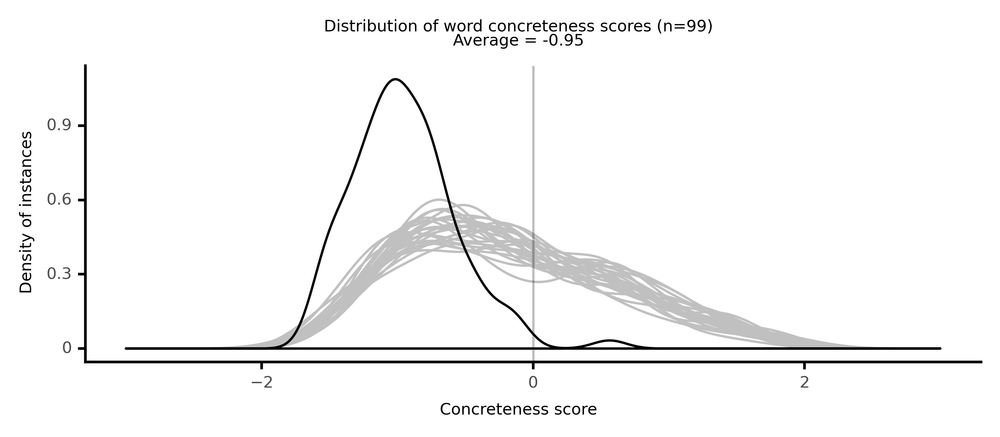

<ggplot: (8764118157761)>

 20%|██        | 20/100 [04:06<16:06, 12.08s/it]

#### #21 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>,( might a <abs><conc003>rational</conc003></abs> <abs><conc054>divine</conc054></abs> say) can be more <neither><conc245>paternal</conc245></neither>, and <abs><conc116>worthy</conc116></abs> of the <abs><conc083>almighty</conc083></abs> <abs><conc042>Creator</conc042></abs>, than to <abs><conc173>reveal</conc173></abs> <abs><conc114>plainly</conc114></abs> the <abs><conc024>motive</conc024></abs> of a <abs><conc016>judgement</conc016></abs> to come, in <neither><conc282>order</conc282></neither> to <abs><conc208>secure</conc208></abs> all <abs><conc022>obedience</conc022></abs> to the <abs><conc043>religion</conc043></abs> of <abs><conc083>nature</conc083></abs>? <abs><conc031>Reason</conc031></abs> may, to be sure, be <abs><conc164>sufficient</conc164></abs> to show men their <abs><conc135>duty</conc135></abs>, and to <abs><conc098>encourage</conc098></abs> their <abs><conc120>performance</conc120></abs> of it with the <abs><conc054>assurance</conc054></abs> of <abs><conc061>obtaining</conc061></abs> a <abs><conc106>reward</conc106></abs>, if they would <abs><conc201>duly</conc201></abs> <neither><conc252>attend</conc252></neither> to its <abs><conc019>dictates</conc019></abs>, and <abs><conc085>suffer</conc085></abs> them to have their due effect upon them: it may <abs><conc216>guide</conc216></abs> <abs><conc017>mankind</conc017></abs> to <abs><conc076>virtue</conc076></abs>, and <abs><conc063>happiness</conc063></abs> <abs><conc040>consequent</conc040></abs> to it, as God must be a <abs><conc001>rewarder</conc001></abs> of all those who <abs><conc130>diligently</conc130></abs> <neither><conc243>seek</conc243></neither> him, and was enough to bring them to the <abs><conc029>knowledge</conc029></abs>, and <abs><conc139>engage</conc139></abs> them in the <abs><conc052>practice</conc052></abs> of <abs><conc073>true</conc073></abs> <abs><conc043>religion</conc043></abs> and <abs><conc104>righteousness</conc104></abs>, if they had not <neither><conc570>shut</conc570></neither> their <neither><conc657>eyes</conc657></neither> to its <neither><conc581>light</conc581></neither>, and <abs><conc094>wilfully</conc094></abs> <abs><conc103>rejected</conc103></abs> the <abs><conc065>rule</conc065></abs> <neither><conc243>written</conc243></neither> in their <neither><conc271>hearts</conc271></neither>. But as this was what <abs><conc017>mankind</conc017></abs> really did, and now do; as <abs><conc018>errors</conc018></abs> and <abs><conc016>impieties</conc016></abs>, owing to an <abs><conc041>undue</conc041></abs> use or <abs><conc057>neglect</conc057></abs> of <abs><conc031>reason</conc031></abs>, became <abs><conc046>universal</conc046></abs>;( just as the case of <abs><conc039>Christians</conc039></abs> is, by <abs><conc005>disregarding</conc005></abs> the New <abs><conc175>Testament</conc175></abs>); and <abs><conc031>reason</conc031></abs>, through men's <abs><conc107>faults</conc107></abs>, was <abs><conc090>rendered</conc090></abs> <abs><conc134>ineffectual</conc134></abs>, though still <abs><conc164>sufficient</conc164></abs>,( which <abs><conc007>justifies</conc007></abs> both the <abs><conc033>wisdom</conc033></abs> and <abs><conc093>goodness</conc093></abs> of God, in <neither><conc476>leaving</conc476></neither> man for so many <abs><conc155>ages</conc155></abs> to his <abs><conc077>natural</conc077></abs> will, and so great a part of the <neither><conc668>globe</conc668></neither> to this day with no other <neither><conc581>light</conc581></neither> than the <abs><conc016>law</conc016></abs> of <abs><conc083>nature</conc083></abs>); and <abs><conc031>reason</conc031></abs>, I say, was <abs><conc090>rendered</conc090></abs> <abs><conc134>ineffectual</conc134></abs>, though' still <abs><conc164>sufficient</conc164></abs> to <abs><conc188>teach</conc188></abs> men to <abs><conc172>worship</conc172></abs> God with <abs><conc179>pious</conc179></abs> <neither><conc271>hearts</conc271></neither> and sincere <abs><conc140>affections</conc140></abs>, and to do his will by the <abs><conc052>practice</conc052></abs> of <abs><conc013>moral</conc013></abs> <abs><conc155>duties</conc155></abs>; to <abs><conc068>expect</conc068></abs> his <abs><conc067>favour</conc067></abs> for their good <abs><conc099>deeds</conc099></abs>, and his <abs><conc015>condemnation</conc015></abs> of their <abs><conc032>evil</conc032></abs> works; then was <abs><conc017>revelation</conc017></abs> a more <abs><conc119>powerful</conc119></abs> means of <abs><conc072>promoting</conc072></abs> <abs><conc073>true</conc073></abs> <abs><conc043>religion</conc043></abs> and <abs><conc052>godliness</conc052></abs>. The <abs><conc051>gospel</conc051></abs> is a more <abs><conc093>effectual</conc093></abs> <neither><conc581>light</conc581></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

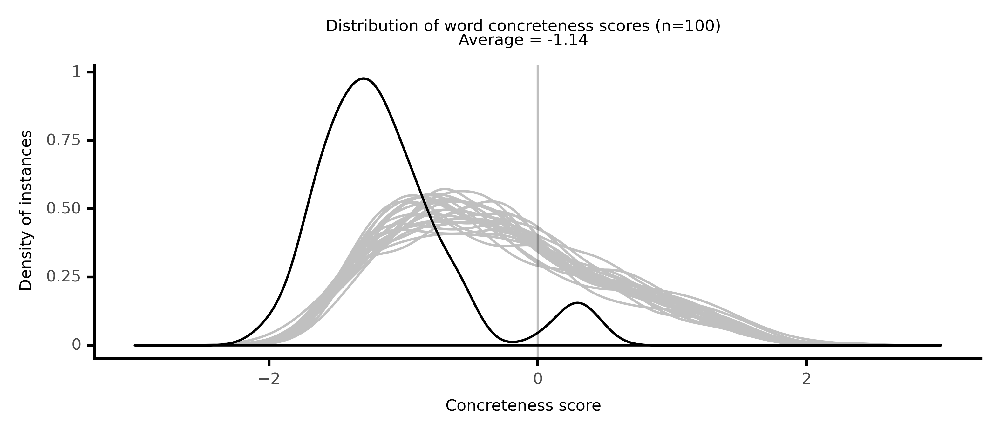

<ggplot: (8764111762089)>

 21%|██        | 21/100 [04:20<16:20, 12.41s/it]

#### #22 most abstract passage: Brooke, _Emily Montague (1769) _ (1769)

<p>the <abs><conc090>Deity</conc090></abs> in the manner which they have been <neither><conc357>early</conc357></neither> <abs><conc204>taught</conc204></abs> to believe the best, and to which they are consequently <abs><conc200>attached</conc200></abs>. It would be <abs><conc004>unjust</conc004></abs> to <abs><conc082>deprive</conc082></abs> them of any of the <abs><conc069>rights</conc069></abs> of <abs><conc170>citizens</conc170></abs> on account of <abs><conc043>religion</conc043></abs>, in America, where every other <abs><conc124>sect</conc124></abs> of <abs><conc175>dissenters</conc175></abs> are <abs><conc084>equally</conc084></abs> <abs><conc107>capable</conc107></abs> of <abs><conc235>employ</conc235></abs> with those of the <abs><conc072>established</conc072></abs> <neither><conc260>church</conc260></neither>; nay where, from whatever cause, the <neither><conc260>church</conc260></neither> of England is on a <neither><conc263>footing</conc263></neither> in many <neither><conc272>colonies</conc272></neither> little better than a <abs><conc037>toleration</conc037></abs>. It is <abs><conc044>undoubtedly</conc044></abs>, in a <abs><conc004>political</conc004></abs> <neither><conc581>light</conc581></neither>, an <abs><conc147>object</conc147></abs> of <abs><conc035>consequence</conc035></abs> every where, that the <abs><conc024>national</conc024></abs> <abs><conc043>religion</conc043></abs>, whatever it is, should be as <abs><conc046>universal</conc046></abs> as possible, <abs><conc167>agreement</conc167></abs> in <abs><conc059>religious</conc059></abs> <abs><conc172>worship</conc172></abs> being the <neither><conc242>strongest</conc242></neither> <neither><conc692>tie</conc692></neither> to <abs><conc062>unity</conc062></abs> and <abs><conc022>obedience</conc022></abs>; had all <abs><conc123>prudent</conc123></abs> means been used to <abs><conc164>lessen</conc164></abs> the <neither><conc378>number</conc378></neither> of <abs><conc175>dissenters</conc175></abs> in our <neither><conc272>colonies</conc272></neither>, I can not <abs><conc146>avoid</conc146></abs> <abs><conc065>believing</conc065></abs>, from what I <abs><conc180>observe</conc180></abs> and hear, that we should have found in them a <abs><conc032>spirit</conc032></abs> of <abs><conc003>rational</conc003></abs> <abs><conc061>loyalty</conc061></abs>, and <abs><conc073>true</conc073></abs> <abs><conc072>freedom</conc072></abs>, instead of that <abs><conc084>factious</conc084></abs> one from which so much is to be <abs><conc141>apprehended</conc141></abs>. It seems <abs><conc047>consonant</conc047></abs> to <abs><conc031>reason</conc031></abs>, that the <abs><conc043>religion</conc043></abs> of every country should have a <abs><conc127>relation</conc127></abs> to, and <abs><conc031>coherence</conc031></abs> with, the <abs><conc032>civil</conc032></abs> <abs><conc098>constitution</conc098></abs>: the Romish <abs><conc043>religion</conc043></abs> is best <neither><conc281>adapted</conc281></neither> to a <abs><conc117>despotic</conc117></abs> <abs><conc027>government</conc027></abs>, the <abs><conc190>presbyterian</conc190></abs> to a <abs><conc064>republican</conc064></abs>, and that of the <neither><conc260>church</conc260></neither> of England to a <abs><conc028>limited</conc028></abs> <abs><conc083>monarchy</conc083></abs> Like ours. As therefore the <abs><conc032>civil</conc032></abs> <abs><conc027>government</conc027></abs> of America is on the same <abs><conc172>plan</conc172></abs> with that of the mother country, it were to be <abs><conc183>wished</conc183></abs> the <abs><conc059>religious</conc059></abs> <abs><conc085>establishment</conc085></abs> was also the same, especially in those <neither><conc272>colonies</conc272></neither> where the people are <neither><conc426>generally</conc426></neither> of the <abs><conc024>national</conc024></abs> <neither><conc260>church</conc260></neither>; though with the <abs><conc064>fullest</conc064></abs> <abs><conc055>liberty</conc055></abs> of <abs><conc064>conscience</conc064></abs> to <abs><conc175>dissenters</conc175></abs> of all <abs><conc223>denominations</conc223></abs>. I would be clearly <abs><conc083>understood</conc083></abs>, my Lord; from all I have <neither><conc372>observed</conc372></neither> here, I am <abs><conc049>convinced</conc049></abs>, nothing would so much <abs><conc180>contribute</conc180></abs> to <abs><conc230>diffuse</conc230></abs> a <abs><conc032>spirit</conc032></abs> of <neither><conc282>order</conc282></neither>, and <abs><conc003>rational</conc003></abs> <abs><conc022>obedience</conc022></abs>, in the <neither><conc272>colonies</conc272></neither>, as the <abs><conc144>appointment</conc144></abs>, under <abs><conc196>proper</conc196></abs> <abs><conc150>restrictions</conc150></abs>, of <abs><conc171>bishops</conc171></abs>: I am <abs><conc084>equally</conc084></abs> <abs><conc049>convinced</conc049></abs> that nothing would so much <abs><conc189>strengthen</conc189></abs> the <neither><conc550>hands</conc550></neither> of <abs><conc027>government</conc027></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

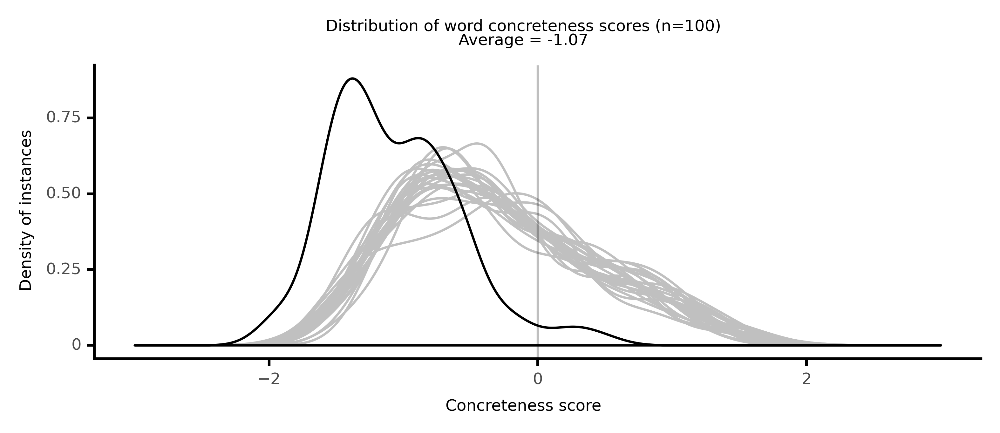

<ggplot: (8764111271317)>

 22%|██▏       | 22/100 [04:31<15:40, 12.06s/it]

#### #23 most abstract passage: Neal, _Rachel Dyer: A North American Story . . . (1828)_ (1828)

<p>. Now it <abs><conc217>appears</conc217></abs> to me that if we are <abs><conc060>prove</conc060></abs> to a <abs><conc004>belief</conc004></abs> in the <neither><conc338>marvellous</conc338></neither>, instead of <abs><conc250>requiring</conc250></abs> more <abs><conc050>proof</conc050></abs> to <abs><conc255>witchcraft</conc255></abs>, we should <abs><conc202>require</conc202></abs> less. For why <abs><conc202>require</conc202></abs> much, if less will do?3. But by another, it has been said that we are not <abs><conc060>prove</conc060></abs> to <abs><conc004>belief</conc004></abs> in the <neither><conc338>marvellous</conc338></neither>; that on the <abs><conc072>contrary</conc072></abs>, so <abs><conc060>prove</conc060></abs> are we to <abs><conc003>disbelieve</conc003></abs> in what may appear <neither><conc338>marvellous</conc338></neither>, that <abs><conc050>proof</conc050></abs>, which we would be <abs><conc180>satisfied</conc180></abs> with in the <abs><conc193>ordinary</conc193></abs> <abs><conc124>affairs</conc124></abs> of life, we should <neither><conc327>pay</conc327></neither> no regard to, if it were <abs><conc031>adduced</conc031></abs> in <abs><conc142>favour</conc142></abs> of what we consider <abs><conc161>preternatural</conc161></abs>; and that therefore in the case you are now to try, you should <abs><conc202>require</conc202></abs> more <abs><conc050>proof</conc050></abs> than you would in <abs><conc148>support</conc148></abs> of a <neither><conc303>charge</conc303></neither> not <neither><conc338>marvellous</conc338></neither>. To which we reply-- that where you have the same <neither><conc413>number</conc413></neither> of <abs><conc244>witnesses</conc244></abs>, of the same <abs><conc025>character</conc025></abs>, in <abs><conc148>support</conc148></abs> of a <neither><conc338>marvellous</conc338></neither> <neither><conc303>charge</conc303></neither>, you actually have more <abs><conc050>proof</conc050></abs>, than you would have in the Like <abs><conc082>testimony</conc082></abs> of the same <abs><conc244>witnesses</conc244></abs>, to a <neither><conc303>charge</conc303></neither> not <neither><conc338>marvellous</conc338></neither>. And why?-- Because by the <abs><conc118>supposition</conc118></abs> of the <neither><conc270>speaker</conc270></neither>, as they are <abs><conc060>prove</conc060></abs> to a <abs><conc000>disbelief</conc000></abs> in the <neither><conc338>marvellous</conc338></neither>, they would have <abs><conc238>required</conc238></abs> much <abs><conc050>proof</conc050></abs>, and would not have been <abs><conc229>persuaded</conc229></abs> to believe what they <abs><conc166>testify</conc166></abs> to, but upon <abs><conc194>irresistible</conc194></abs> <abs><conc050>proof</conc050></abs>-- more <abs><conc050>proof</conc050></abs> than would have <abs><conc180>satisfied</conc180></abs> them in the <abs><conc193>ordinary</conc193></abs> <abs><conc124>affairs</conc124></abs> of life.4. It has been said moreover-- that the <abs><conc195>greater</conc195></abs> the <abs><conc076>crime</conc076></abs> <abs><conc241>charged</conc241></abs>, the more <abs><conc181>incredible</conc181></abs> it is; that great <abs><conc095>crimes</conc095></abs> are <abs><conc186>perpetrated</conc186></abs> less <neither><conc354>frequently</conc354></neither> than <conc><conc817>small</conc817></conc> ones; and that, therefore, more <abs><conc050>proof</conc050></abs> should be <abs><conc238>required</conc238></abs> of <neither><conc332>parricide</conc332></neither> than of <neither><conc318>theft</conc318></neither>. Our reply to which is, that if a <abs><conc178>witness</conc178></abs> <abs><conc102>declare</conc102></abs> to a <neither><conc332>parricide</conc332></neither> on <neither><conc288>oath</conc288></neither>, you have more <abs><conc050>proof</conc050></abs> than you would have to a <neither><conc318>theft</conc318></neither> <neither><conc311>sworn</conc311></neither> to by the very same <abs><conc178>witness</conc178></abs>; that, if the <abs><conc195>greater</conc195></abs> the <abs><conc076>crime</conc076></abs>, the less <abs><conc034>credible</conc034></abs> it is, you are <neither><conc286>bound</conc286></neither> to <abs><conc186>attach</conc186></abs> more <conc><conc772>valve</conc772></conc> to his <abs><conc082>testimony</conc082></abs> where he <abs><conc040>testifies</conc040></abs> to <neither><conc332>parricide</conc332></neither> than where he <abs><conc040>testifies</conc040></abs> to <neither><conc318>theft</conc318></neither>. And why?-- Because, the <abs><conc195>greater</conc195></abs> the <abs><conc076>crime</conc076></abs> <abs><conc241>charged</conc241></abs>, the <abs><conc195>greater</conc195></abs> the <abs><conc076>crime</conc076></abs> of the <abs><conc178>witness</conc178></abs> if he <neither><conc303>charge</conc303></neither> <abs><conc052>falsely</conc052></abs>; and therefore the less likely is it, by the <abs><conc118>supposition</conc118></abs>, that he does <neither><conc303>charge</conc303></neither> <abs><conc052>falsely</conc052></abs>. But here I would have you <abs><conc231>observe</conc231></abs> that <abs><conc050>proof</conc050></abs> is <abs><conc050>proof</conc050></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

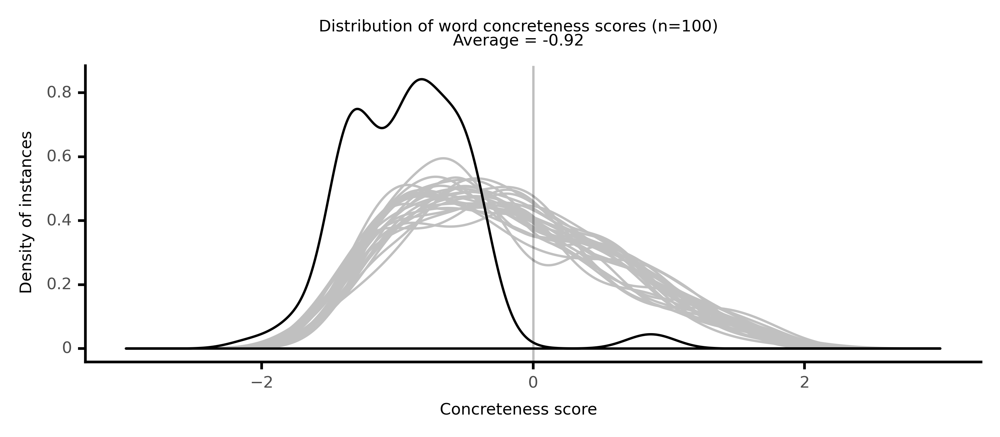

<ggplot: (8764111013981)>

 23%|██▎       | 23/100 [04:41<14:42, 11.46s/it]

#### #24 most abstract passage: Paulding, _The Merry Tales of the Three Wise Men of Gotham (1_ (1826)

<p>is <neither><conc370>strong</conc370></neither> I allow, but where is thy master's <abs><conc089>surety</conc089></abs> that men will not <abs><conc092>adopt</conc092></abs> <neither><conc633>bade</conc633></neither> <abs><conc156>habits</conc156></abs> as well as good?'' The <abs><conc189>absence</conc189></abs> of all <abs><conc200>temptation</conc200></abs> to do <abs><conc031>evil</conc031></abs>,'' replied I. My friend,'' replied Mr. Ashley, where there are <abs><conc108>temptations</conc108></abs> to do good, there will be <abs><conc108>temptations</conc108></abs> to do <abs><conc031>evil</conc031></abs>. They are <abs><conc170>coeval</conc170></abs>, coexistent and <abs><conc120>inseparable</conc120></abs>.'' But we are to have neither <abs><conc200>temptation</conc200></abs> to one or the other-- <abs><conc200>temptation</conc200></abs> is to be <abs><conc189>banished</conc189></abs> entirely.'' Then what becomes of the <abs><conc100>hope</conc100></abs> of <abs><conc133>reward</conc133></abs>-- is not that a <abs><conc200>temptation</conc200></abs> to do good? But be <abs><conc154>assured</conc154></abs> that <abs><conc027>rewards</conc027></abs> will not do alone in this world, without the <abs><conc137>aid</conc137></abs> of <abs><conc020>punishments</conc020></abs>. You may <abs><conc111>punish</conc111></abs> a man for <abs><conc082>committing</conc082></abs> a <abs><conc076>crime</conc076></abs>, but it would be <abs><conc154>impossible</conc154></abs> for <abs><conc147>society</conc147></abs> under any <abs><conc137>view</conc137></abs>, new or old, to <abs><conc133>reward</conc133></abs> all persons for <abs><conc016>abstaining</conc016></abs> from it. But even if <abs><conc147>society</conc147></abs> had the means, how is it to <neither><conc352>arrive</conc352></neither> at a <abs><conc045>knowledge</conc045></abs> of the <abs><conc077>degree</conc077></abs> of <abs><conc200>temptation</conc200></abs> <abs><conc208>resisted</conc208></abs>, of the <abs><conc077>degree</conc077></abs> of <abs><conc147>virtuous</conc147></abs> <abs><conc039>forbearance</conc039></abs> <abs><conc099>exercised</conc099></abs>, so as to <abs><conc261>proportion</conc261></abs> the <abs><conc133>reward</conc133></abs> to the <abs><conc164>resistance</conc164></abs>? It would be <abs><conc018>confounding</conc018></abs> all <neither><conc390>degrees</conc390></neither> of <abs><conc041>virtue</conc041></abs> to <abs><conc133>reward</conc133></abs> all <abs><conc092>alike</conc092></abs>, and it would be arrogating to ourselves the <abs><conc011>Omniscience</conc011></abs> of the <abs><conc098>Supreme</conc098></abs> Being, to <abs><conc160>pretend</conc160></abs> to <abs><conc060>discriminate</conc060></abs> between the <abs><conc108>temptations</conc108></abs> and <abs><conc039>forbearance</conc039></abs> of all those who <abs><conc050>abstain</conc050></abs> from the <abs><conc139>commission</conc139></abs> of <abs><conc076>crime</conc076></abs>. Solon, one of the <abs><conc117>wisest</conc117></abs> of <abs><conc024>lawgivers</conc024></abs>, <neither><conc270>ancient</conc270></neither> or <abs><conc161>modern</conc161></abs>, has said, that in <abs><conc191>order</conc191></abs> to make men <abs><conc147>virtuous</conc147></abs>, you must <neither><conc362>allure</conc362></neither> them by <abs><conc027>rewards</conc027></abs>, and <abs><conc031>deter</conc031></abs> them by <abs><conc020>punishments</conc020></abs>. All <abs><conc026>legislators</conc026></abs> have <neither><conc504>proceeded</conc504></neither> upon these <abs><conc016>principles</conc016></abs>. Is thy master <abs><conc177>wiser</conc177></abs> than the <abs><conc117>wisest</conc117></abs> of all <abs><conc240>ages</conc240></abs>? To me it <abs><conc217>appears</conc217></abs> that his system, so far from <neither><conc468>indicating</conc468></neither> <abs><conc164>superior</conc164></abs> <abs><conc019>wisdom</conc019></abs>, is <abs><conc105>founded</conc105></abs> in a <abs><conc232>total</conc232></abs> <abs><conc040>practical</conc040></abs> <abs><conc021>ignorance</conc021></abs> of man; and a <abs><conc173>complete</conc173></abs> <abs><conc016>misapplication</conc016></abs> of the little <abs><conc032>abstract</conc032></abs> <abs><conc045>knowledge</conc045></abs> he <abs><conc261>possesses</conc261></abs>.'' Then you <abs><conc036>deny</conc036></abs> that the <abs><conc100>hope</conc100></abs> of <abs><conc133>reward</conc133></abs> <abs><conc122>operates</conc122></abs> in <abs><conc142>favour</conc142></abs> of <abs><conc041>virtue</conc041></abs>,'' said I. Indeed, not <neither><conc449>I.</conc449></neither> I only <abs><conc036>deny</conc036></abs> that it is <abs><conc225>sufficient</conc225></abs> in itself to <abs><conc162>restrain</conc162></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

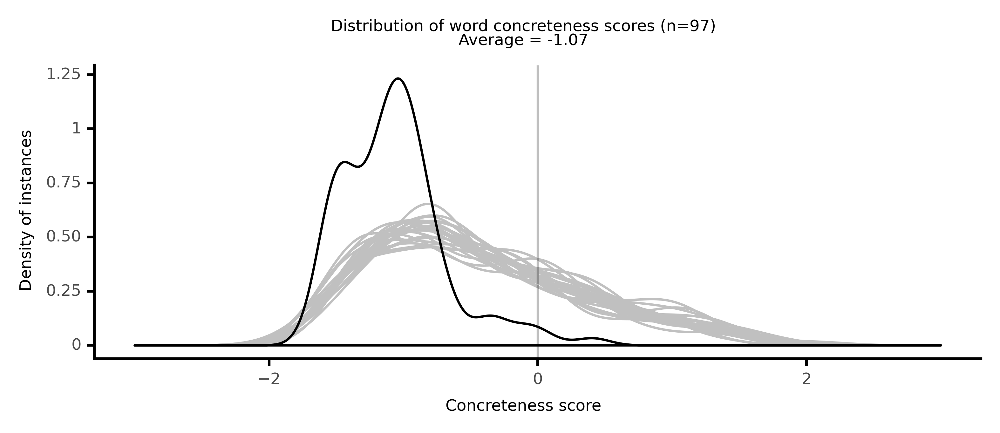

<ggplot: (8764100304213)>

 24%|██▍       | 24/100 [04:52<14:14, 11.25s/it]

#### #25 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>us <abs><conc081>privileges</conc081></abs> and <abs><conc201>blessings</conc201></abs> far <abs><conc139>superior</conc139></abs> to what we could <abs><conc114>attain</conc114></abs> any other way. With regard to the second <abs><conc143>objection</conc143></abs>, that I take away the <neither><conc291>grace</conc291></neither> of God, to <abs><conc227>preserve</conc227></abs> the <abs><conc062>dignity</conc062></abs> of <abs><conc115>human</conc115></abs> <abs><conc083>nature</conc083></abs>, this is far from my <abs><conc076>intention</conc076></abs>. I do indeed think, that as the <abs><conc051>Gospel</conc051></abs> was given for the <abs><conc233>noblest</conc233></abs> <neither><conc295>purpose</conc295></neither>; to <neither><conc246>wit</conc246></neither>, to call in an <abs><conc134>extraordinary</conc134></abs> manner upon <abs><conc017>mankind</conc017></abs>, to <neither><conc285>forsake</conc285></neither> that <abs><conc146>vice</conc146></abs> and <abs><conc125>idolatry</conc125></abs>, the <abs><conc077>corrupt</conc077></abs> <abs><conc165>creed</conc165></abs> of <abs><conc018>polytheism</conc018></abs>, the <conc><conc921>gilded</conc921></conc> of <abs><conc182>superstition</conc182></abs>, their great <abs><conc065>iniquities</conc065></abs>, <neither><conc286>violent</conc286></neither> <abs><conc175>passion</conc175></abs>, and <abs><conc062>worldly</conc062></abs> <abs><conc140>affections</conc140></abs>, which are all <abs><conc057>contrary</conc057></abs> to <abs><conc031>reason</conc031></abs>, and <abs><conc148>disgrace</conc148></abs> <abs><conc115>human</conc115></abs> <abs><conc083>nature</conc083></abs>; and to <abs><conc052>practice</conc052></abs> that whole system of <abs><conc035>morality</conc035></abs>, which they must know to be most useful to them;-- that they might <neither><conc401>turn</conc401></neither> to a <abs><conc043>religion</conc043></abs> which had but One <abs><conc147>object</conc147></abs>, the Great <abs><conc204>Invisible</conc204></abs> Being, allknowing and <abs><conc018>all-sufficient</conc018></abs>, to whom all the <abs><conc064>intelligent</conc064></abs> world are to make their <abs><conc156>devout</conc156></abs> <abs><conc125>applications</conc125></abs>; because he is an <abs><conc124>infinite</conc124></abs>, <abs><conc022>independent</conc022></abs>, <abs><conc102>sovereign</conc102></abs> mind, who has <abs><conc082>created</conc082></abs> all things, and <abs><conc086>absolutely</conc086></abs> <abs><conc112>rules</conc112></abs> and <abs><conc045>governs</conc045></abs> all; <abs><conc212>possesses</conc212></abs> all <abs><conc077>natural</conc077></abs> <abs><conc126>perfections</conc126></abs>, <abs><conc106>exists</conc106></abs> in all <abs><conc071>duration</conc071></abs>, <neither><conc514>fills</conc514></neither> all <neither><conc524>space</conc524></neither> with his <abs><conc176>presence</conc176></abs>, and is the <abs><conc015>omniscient</conc015></abs> <abs><conc174>witness</conc174></abs> of all their <abs><conc046>difficulties</conc046></abs> and wants;-------- and that since they were <neither><conc415>bound</conc415></neither> by all the <neither><conc258>ties</conc258></neither> of <abs><conc013>moral</conc013></abs> <abs><conc135>duty</conc135></abs> to <abs><conc151>obey</conc151></abs> this one God, and <abs><conc180>observe</conc180></abs> the <abs><conc003>rational</conc003></abs> <abs><conc031>institutions</conc031></abs> of <abs><conc043>religion</conc043></abs>, therefore they should make it the <neither><conc250>labour</conc250></neither> of their whole <neither><conc257>lives</conc257></neither> to <neither><conc258>excel</conc258></neither> in <abs><conc052>holiness</conc052></abs> and <abs><conc104>righteousness</conc104></abs>, and by <abs><conc076>virtue</conc076></abs> and <abs><conc099>piety</conc099></abs> <neither><conc285>unite</conc285></neither> themselves to God, and <abs><conc052>entitle</conc052></abs> themselves to <abs><conc115>glory</conc115></abs> at the great day:------ That as this is the <abs><conc083>nature</conc083></abs>, end, and <abs><conc162>design</conc162></abs> of the <abs><conc044>christian</conc044></abs> <abs><conc017>revelation</conc017></abs>, so I do think the <abs><conc051>gospel</conc051></abs> of our <abs><conc072>salvation</conc072></abs>, the word of <abs><conc065>truth</conc065></abs>,( as an <abs><conc052>apostle</conc052></abs> <neither><conc283>calls</conc283></neither> it) is <abs><conc164>sufficient</conc164></abs> for the <neither><conc295>purpose</conc295></neither>, without immediate <abs><conc071>impulses</conc071></abs>. As we have a <abs><conc042>reasonable</conc042></abs>, <abs><conc064>intellectual</conc064></abs> <abs><conc083>nature</conc083></abs>, there is no want of <abs><conc213>mechanical</conc213></abs> <abs><conc054>powers</conc054></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

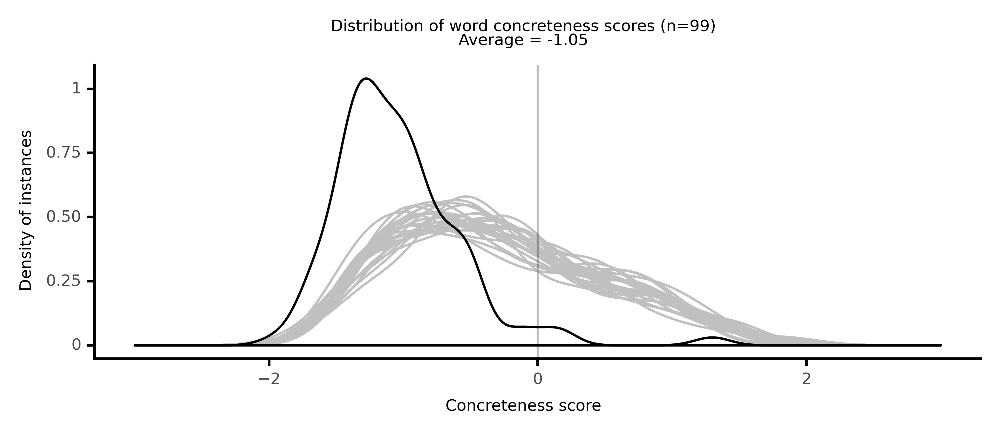

<ggplot: (8764109290873)>

 25%|██▌       | 25/100 [05:06<15:23, 12.31s/it]

#### #26 most abstract passage: Paulding, _The Merry Tales of the Three Wise Men of Gotham (1_ (1826)

<p>it <neither><conc389>perfectly</conc389></neither> from the <abs><conc219>obscurity</conc219></abs> of <abs><conc240>ages</conc240></abs>, yet, as it is, we must take it as we find it <neither><conc573>laid</conc573></neither> down by persons who <abs><conc207>differ</conc207></abs> <abs><conc186>continually</conc186></abs> from each other. The <neither><conc356>mischief</conc356></neither>, <abs><conc156>continue</conc156></abs> they, is, that such is the <abs><conc125>diversity</conc125></abs>, the <abs><conc089>waywardness</conc089></abs>, the <abs><conc185>pride</conc185></abs> and the <abs><conc087>obstinacy</conc087></abs> of <abs><conc115>human</conc115></abs> <abs><conc020>reason</conc020></abs>, that these <abs><conc097>oracles</conc097></abs> <abs><conc207>differ</conc207></abs> one among another, upon almost every <abs><conc033>principle</conc033></abs> of the <abs><conc256>common</conc256></abs> <abs><conc022>law</conc022></abs>. By this means, the <abs><conc256>common</conc256></abs> <abs><conc022>law</conc022></abs>, in effect, <neither><conc332>ceases</conc332></neither> to be a <abs><conc103>rule</conc103></abs> of <abs><conc083>action</conc083></abs>, since it is <abs><conc154>impossible</conc154></abs> to say that a dozen different <abs><conc135>rules</conc135></abs> can make one <abs><conc103>rule</conc103></abs>. In <abs><conc191>order</conc191></abs> to <abs><conc219>decide</conc219></abs> upon these <abs><conc044>contradictory</conc044></abs> <abs><conc044>decisions</conc044></abs>, different <abs><conc112>judges</conc112></abs> <abs><conc256>resort</conc256></abs>, not to their own <abs><conc013>opinions</conc013></abs>, but to the <abs><conc013>opinions</conc013></abs> and <abs><conc044>decisions</conc044></abs> of others. Some are of <abs><conc020>opinion</conc020></abs>, that as the whole <abs><conc166>force</conc166></abs> and <abs><conc017>authority</conc017></abs> of the <abs><conc256>common</conc256></abs> <abs><conc022>law</conc022></abs> is <abs><conc153>derived</conc153></abs> from its <abs><conc226>antiquity</conc226></abs>, it follows, of course, that the people of these <neither><conc273>remote</conc273></neither> <abs><conc240>ages</conc240></abs> were <abs><conc177>wiser</conc177></abs> than those which <neither><conc307>succeeded</conc307></neither> them. As a matter of course, if this <neither><conc268>position</conc268></neither> be <abs><conc082>correct</conc082></abs>, then the <abs><conc044>decisions</conc044></abs> of persons <neither><conc301>living</conc301></neither> the <neither><conc697>nearest</conc697></neither> to the <abs><conc144>sources</conc144></abs> and <abs><conc132>origin</conc132></abs> of the <abs><conc256>common</conc256></abs> <abs><conc022>law</conc022></abs>, must be of the greatest <abs><conc017>authority</conc017></abs> in <neither><conc411>settling</conc411></neither> its <abs><conc016>principles</conc016></abs>. They <abs><conc071>argue</conc071></abs> that if those <abs><conc240>ages</conc240></abs>, and <abs><conc146>sages</conc146></abs>, which <neither><conc361>produced</conc361></neither> and <abs><conc027>expounded</conc027></abs> the <abs><conc017>doctrines</conc017></abs> and <abs><conc086>practice</conc086></abs> of the <abs><conc256>common</conc256></abs> <abs><conc022>law</conc022></abs>, were not <abs><conc177>wiser</conc177></abs>, or at least as <abs><conc042>wise</conc042></abs> as we are at present, it were best to <abs><conc058>discard</conc058></abs> it entirely, or so <abs><conc043>modify</conc043></abs> it as to make it <abs><conc087>comport</conc087></abs> with the <abs><conc019>wisdom</conc019></abs> of the present times. Some, <neither><conc445>gentlemen</conc445></neither> of the <neither><conc283>jury</conc283></neither>, on the other <neither><conc486>hand</conc486></neither>, <abs><conc064>maintain</conc064></abs> a <abs><conc072>contrary</conc072></abs> <abs><conc008>doctrine</conc008></abs>, in <abs><conc044>expounding</conc044></abs> the <abs><conc016>principles</conc016></abs> of the <abs><conc256>common</conc256></abs> <abs><conc022>law</conc022></abs>. They <abs><conc071>argue</conc071></abs> that as it is a <neither><conc263>received</conc263></neither> <abs><conc058>axiom</conc058></abs>, that every <neither><conc276>succeeding</conc276></neither> <abs><conc244>age</conc244></abs> is <abs><conc177>wiser</conc177></abs> than its <abs><conc135>predecessor</conc135></abs>, the <abs><conc100>probability</conc100></abs> is, that it must <neither><conc319>produce</conc319></neither> <abs><conc177>wiser</conc177></abs> men in every <abs><conc067>science</conc067></abs>. Hence, it would seem to <abs><conc177>follow</conc177></abs>, say they, that those <abs><conc044>decisions</conc044></abs> which <neither><conc413>approach</conc413></neither> the <neither><conc697>nearest</conc697></neither> to our time should be most <abs><conc096>relied</conc096></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

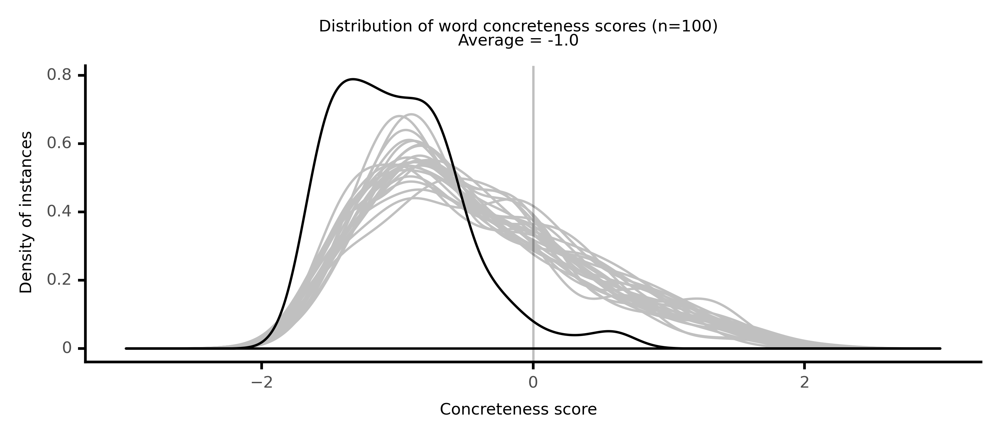

<ggplot: (8764103024529)>

 26%|██▌       | 26/100 [05:17<14:32, 11.80s/it]

#### #27 most abstract passage: Hale, _Liberia; or, Mr. Peyton's Experiments. Edited by S_ (1853)

<p>to which the <abs><conc169>peculiarities</conc169></abs> of our <abs><conc130>condition</conc130></abs> <abs><conc088>entitle</conc088></abs> us, and <abs><conc214>extend</conc214></abs> to us that <abs><conc006>comity</conc006></abs> which <neither><conc423>marks</conc423></neither> the <neither><conc322>friendly</conc322></neither> <abs><conc140>intercourse</conc140></abs> of <abs><conc180>civilized</conc180></abs> and <abs><conc109>independent</conc109></abs> <abs><conc169>communities</conc169></abs>. <abs><conc130>Constitution</conc130></abs>. We give <neither><conc358>Article</conc358></neither> <neither><conc449>I.</conc449></neither> <abs><conc232>entire</conc232></abs>, as it is the <abs><conc021>exponent</conc021></abs> and <abs><conc073>guaranty</conc073></abs> of <abs><conc024>true</conc024></abs> <abs><conc164>republican</conc164></abs> <abs><conc016>principles</conc016></abs>-- <abs><conc080>harmonizing</conc080></abs> with the <abs><conc071>Gospel</conc071></abs> <abs><conc054>precepts</conc054></abs> of <neither><conc417>loving</conc417></neither> our <neither><conc491>neighbour</conc491></neither> as ourselves,'' and doing to others as we would be done by-- which, we <abs><conc075>trust</conc075></abs>, are, by the <neither><conc281>blessing</conc281></neither> of God, to be <neither><conc345>extended</conc345></neither> throughout Africa. <neither><conc358>Article</conc358></neither> I. <abs><conc120>Declaration</conc120></abs> of <abs><conc096>Rights</conc096></abs>. The end of the <abs><conc137>institution</conc137></abs>, <abs><conc159>maintenance</conc159></abs>, and <abs><conc019>administration</conc019></abs> of <abs><conc050>government</conc050></abs>, is to <abs><conc149>secure</conc149></abs> the <abs><conc055>existence</conc055></abs> of the body <abs><conc110>politic</conc110></abs>, to <neither><conc353>protect</conc353></neither> it, and to <abs><conc245>furnish</conc245></abs> the <abs><conc107>individuals</conc107></abs> who <neither><conc421>compose</conc421></neither> it with the <abs><conc028>power</conc028></abs> of <neither><conc411>enjoying</conc411></neither>, in <abs><conc252>safety</conc252></abs> and <abs><conc187>tranquillity</conc187></abs>, their <abs><conc072>natural</conc072></abs> <abs><conc096>rights</conc096></abs>, and the <abs><conc229>blessings</conc229></abs> of life; and whenever these great <abs><conc154>objects</conc154></abs> are not obtained, the people have a right to <neither><conc690>altar</conc690></neither> the <abs><conc050>government</conc050></abs>, and to take <abs><conc079>measures</conc079></abs> necessary for their <abs><conc252>safety</conc252></abs>, <abs><conc128>prosperity</conc128></abs>, and <abs><conc149>happiness</conc149></abs>. Therefore, we the people of the <abs><conc103>Commonwealth</conc103></abs> of Liberia, in Africa, <abs><conc057>acknowledging</conc057></abs> with <abs><conc148>devout</conc148></abs> <abs><conc176>gratitude</conc176></abs> the <abs><conc220>goodness</conc220></abs> of God in <abs><conc060>granting</conc060></abs> to us the <abs><conc229>blessings</conc229></abs> of the <abs><conc057>Christian</conc057></abs> <abs><conc025>religion</conc025></abs>, and <abs><conc009>political</conc009></abs>, <abs><conc043>religious</conc043></abs>, and <abs><conc069>civil</conc069></abs> <abs><conc056>liberty</conc056></abs>, do, in <abs><conc191>order</conc191></abs> to <abs><conc149>secure</conc149></abs> these <abs><conc229>blessings</conc229></abs> for ourselves and our <abs><conc095>posterity</conc095></abs>, and to <abs><conc104>establish</conc104></abs> <abs><conc027>justice</conc027></abs>, <abs><conc212>insure</conc212></abs> <neither><conc341>domestic</conc341></neither> <abs><conc093>peace</conc093></abs>, and <abs><conc098>promote</conc098></abs> the <abs><conc129>general</conc129></abs> <abs><conc094>welfare</conc094></abs>, hereby <neither><conc399>solemnly</conc399></neither> <abs><conc140>associate</conc140></abs> and <abs><conc176>constitute</conc176></abs> ourselves a free, <abs><conc097>sovereign</conc097></abs>, and <abs><conc109>independent</conc109></abs> state, by the name of the <abs><conc144>Republic</conc144></abs> of Liberia, and do <abs><conc104>ordain</conc104></abs> and <abs><conc104>establish</conc104></abs> this <abs><conc130>Constitution</conc130></abs>, for the <abs><conc050>government</conc050></abs> of the same. Sec.1. All men are <neither><conc342>born</conc342></neither> <abs><conc084>equally</conc084></abs> free and <abs><conc109>independent</conc109></abs>, and have certain <abs><conc072>natural</conc072></abs>, <abs><conc033>inherent</conc033></abs>, and <abs><conc080>inalienable</conc080></abs> <abs><conc096>rights</conc096></abs>; among which are the <abs><conc096>rights</conc096></abs> of <neither><conc411>enjoying</conc411></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

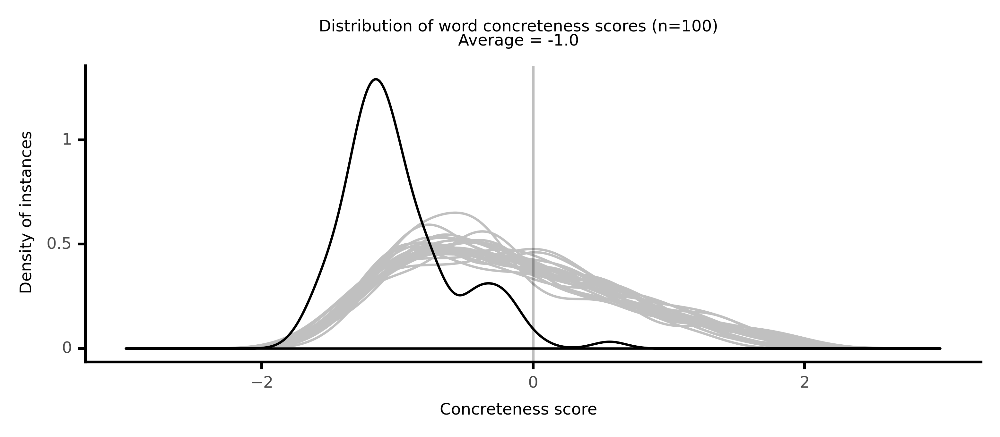

<ggplot: (8764112682001)>

 27%|██▋       | 27/100 [05:27<13:36, 11.18s/it]

#### #28 most abstract passage: Richardson, _Clarissa (3rd ed.) (1751)_ (1751)

<p>that she would make <abs><conc038>partial</conc038></abs> <abs><conc192>constructions</conc192></abs> against me. Neither you nor I can <abs><conc097>doubt</conc097></abs>, but that, had she been left unprepossessedly to herself, she would have shown <abs><conc067>favour</conc067></abs> to me. And so, I <neither><conc264>dare</conc264></neither> say, would my <neither><conc391>Uncle</conc391></neither> Antony. Nay, my dear, I can <neither><conc339>extend</conc339></neither> my <abs><conc139>charity</conc139></abs> still farther: For I am sometime of <abs><conc033>opinion</conc033></abs>, that were my Brother and Sister <abs><conc086>absolutely</conc086></abs> certain, that they had so far <neither><conc302>ruined</conc302></neither> me in the <abs><conc033>opinion</conc033></abs> of both my <neither><conc313>Uncles</conc313></neither>, as that they needs not to be <abs><conc177>apprehensive</conc177></abs> of my <neither><conc326>clashing</conc326></neither> with their <abs><conc036>interests</conc036></abs>; they would not <abs><conc038>oppose</conc038></abs> a <abs><conc130>Pardon</conc130></abs>, although' they might not wish a <abs><conc159>Reconciliation</conc159></abs>; especially if I would make a few <abs><conc199>sacrifices</conc199></abs> to them: Which, I <neither><conc245>assure</conc245></neither> you, I should be <abs><conc159>inclined</conc159></abs> to make, were I <abs><conc140>wholly</conc140></abs> free, and <abs><conc022>independent</conc022></abs> on this man. You know I never <neither><conc425>valued</conc425></neither> myself upon <abs><conc062>worldly</conc062></abs> <abs><conc112>acquisitions</conc112></abs>, but as they <abs><conc169>enlarged</conc169></abs> my <abs><conc020>power</conc020></abs> to do things I <neither><conc253>loved</conc253></neither> to do. And if I were <abs><conc079>denied</conc079></abs> the <abs><conc020>power</conc020></abs>, I must, as I now do, <abs><conc186>curb</conc186></abs> my <abs><conc151>inclination</conc151></abs>. Do not however think me <abs><conc111>guilty</conc111></abs> of an <neither><conc301>affectation</conc301></neither> in what I have said of my Brother and Sister. <abs><conc134>Severe</conc134></abs> enough I am sure it is, in the most <abs><conc088>favourable</conc088></abs> <abs><conc039>sense</conc039></abs>. And an <abs><conc148>indifferent</conc148></abs> person will be of <abs><conc033>opinion</conc033></abs>, that they are much better <abs><conc023>warranted</conc023></abs> than ever, for the <neither><conc253>sake</conc253></neither> of the family-honour, to <neither><conc243>seek</conc243></neither> to <neither><conc297>ruin</conc297></neither> me in the <abs><conc067>favour</conc067></abs> of all my friends. But to the former <abs><conc105>topic</conc105></abs>-- Try, my dear, if your Mother will, upon the <abs><conc148>condition</conc148></abs> above-given, <abs><conc209>permit</conc209></abs> our <abs><conc162>correspondence</conc162></abs>, on seeing all we <neither><conc280>write</conc280></neither>. But if she will not, what a <abs><conc041>Selfishness</conc041></abs> would there be in my Love to you, were I to wish you to <abs><conc212>forego</conc212></abs> your <abs><conc135>duty</conc135></abs> for my <neither><conc253>sake</conc253></neither>? And now, one word, as to the <abs><conc072>freedom</conc072></abs> I have <abs><conc197>treated</conc197></abs> you with in this <neither><conc294>tedious</conc294></neither> <abs><conc093>expostulatory</conc093></abs> <abs><conc176>address</conc176></abs>. I <abs><conc121>presume</conc121></abs> upon your <abs><conc103>forgiveness</conc103></abs> of it, because few <abs><conc164>friendships</conc164></abs> are <abs><conc118>founded</conc118></abs> on such a <neither><conc273>basis</conc273></neither> as ours:-- Which is,'freely to give <abs><conc096>reproof</conc096></abs>, and <abs><conc162>thankfully</conc162></abs> to <neither><conc238>receive</conc238></neither> it, as occasions arise; that so either may have <neither><conc259>opportunity</conc259></neither> to <neither><conc383>clear</conc383></neither> up <abs><conc072>mistakes</conc072></abs>, to <abs><conc010>acknowledge</conc010></abs> and <abs><conc083>amend</conc083></abs> <abs><conc018>errors</conc018></abs>, as well in <abs><conc093>behaviour</conc093></abs>, as in words and <abs><conc099>deeds</conc099></abs>; and to <abs><conc052>rectify</conc052></abs> and <abs><conc069>confirm</conc069></abs> each other in the <abs><conc016>judgement</conc016></abs> each shall from upon persons, things, and circumstances.' And all this upon the following <abs><conc052>consideration</conc052></abs>;'That it is much more <abs><conc144>eligible</conc144></abs>, as well as <abs><conc085>honourable</conc085></abs>, to be <abs><conc144>corrected</conc144></abs> with the <abs><conc184>gentleness</conc184></abs> that may be <abs><conc129>expected</conc129></abs> from an <abs><conc078>undoubted</conc078></abs> friend, than by <abs><conc214>continuing</conc214></abs> either <abs><conc214>blind</conc214></abs> or <abs><conc058>wilful</conc058></abs>, to <abs><conc119>expose</conc119></abs> ourselves to the <abs><conc023>censures</conc023></abs> of an <abs><conc228>envious</conc228></abs>, and perhaps <neither><conc267>malignant</conc267></neither> world.' But it is as <abs><conc184>needless</conc184></abs>, I <neither><conc264>dare</conc264></neither> say, to <abs><conc120>remind</conc120></abs> you of this, as it is to <neither><conc284>repeat</conc284></neither> my <neither><conc266>request</conc266></neither>, so often <neither><conc241>repeated</conc241></neither>, that you will not, in your <neither><conc401>turn</conc401></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

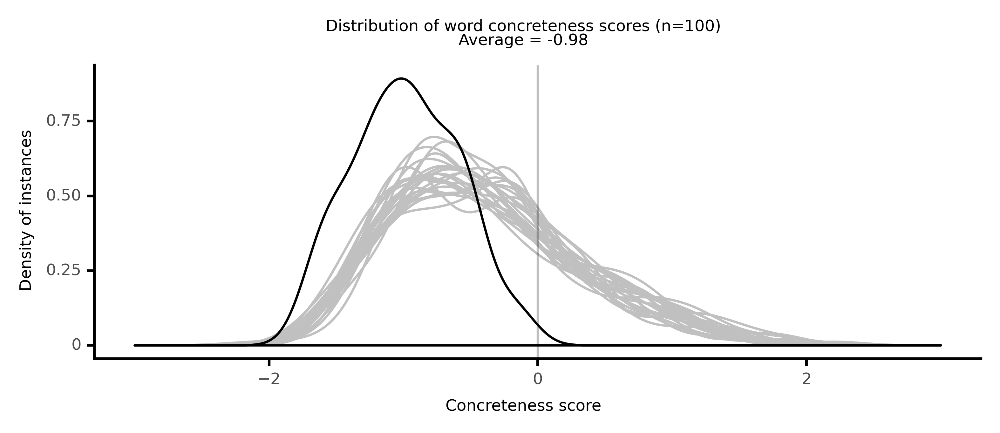

<ggplot: (8764112227413)>

 28%|██▊       | 28/100 [05:53<18:51, 15.72s/it]

#### #29 most abstract passage: Scott, _Sir George Ellison (1766)_ (1766)

<p>. He <abs><conc172>suspected</conc172></abs> that she who in such circumstances <neither><conc336>asked</conc336></neither> <abs><conc127>advice</conc127></abs>, <abs><conc183>wished</conc183></abs> for a <abs><conc055>sanction</conc055></abs> to her <neither><conc360>marriage</conc360></neither>. But Sir George, with all his good <abs><conc083>nature</conc083></abs>, was a little <abs><conc092>perverse</conc092></abs> on this occasion, and <abs><conc185>refusing</conc185></abs> to <abs><conc127>advice</conc127></abs>, <abs><conc136>referred</conc136></abs> her to her own <abs><conc151>inclination</conc151></abs>; only <abs><conc209>observing</conc209></abs>, that if she had any thoughts of a second <neither><conc360>marriage</conc360></neither>, she might not have an <neither><conc259>opportunity</conc259></neither> of <neither><conc358>entering</conc358></neither> into it on such <abs><conc213>advantageous</conc213></abs> terms, Lamont being a man of <abs><conc039>sense</conc039></abs> and <abs><conc050>merit</conc050></abs>, of no <abs><conc168>improper</conc168></abs> <abs><conc229>age</conc229></abs>, and <abs><conc159>possessed</conc159></abs> of a <neither><conc379>considerable</conc379></neither> <neither><conc290>fortune</conc290></neither>, which beside the <abs><conc232>common</conc232></abs> <abs><conc041>recommendations</conc041></abs> of <abs><conc215>wealth</conc215></abs>, had still an <neither><conc285>additional</conc285></neither> <conc><conc900>valve</conc900></conc>, as it was an <abs><conc045>undeniable</conc045></abs> <abs><conc098>proof</conc098></abs> of his sincere regard for her. <abs><conc129>Concluding</conc129></abs> with <neither><conc273>desiring</conc273></neither> her to consider what he had said on his friend's behalf, not as <abs><conc208>intended</conc208></abs> to <abs><conc069>influence</conc069></abs> her in <abs><conc067>favour</conc067></abs> of <neither><conc360>marriage</conc360></neither>, but only if she was <neither><conc350>disposed</conc350></neither> to <abs><conc058>relinquish</conc058></abs> a <neither><conc373>single</conc373></neither> life, to give his <abs><conc033>opinion</conc033></abs> how far Mr. Lamont was an <abs><conc144>eligible</conc144></abs> person. This <abs><conc185>method</conc185></abs> of <abs><conc117>proceeding</conc117></abs> did not quite <abs><conc148>answer</conc148></abs> Mrs. Blackburn's <abs><conc157>wishes</conc157></abs>: She was well <neither><conc350>disposed</conc350></neither> towards Lamont; she thought him <abs><conc225>agreeable</conc225></abs> and <abs><conc097>deserving</conc097></abs>; his <neither><conc290>fortune</conc290></neither> <neither><conc235>afforded</conc235></neither> her some <abs><conc173>temptation</conc173></abs>, and his <abs><conc103>attachment</conc103></abs> to her was too <abs><conc114>flattering</conc114></abs> not to <abs><conc028>prejudice</conc028></abs> her a good deal in his <abs><conc067>favour</conc067></abs>; but her <neither><conc325>heart</conc325></neither> had never been <abs><conc107>susceptible</conc107></abs> of that <abs><conc221>extreme</conc221></abs> <abs><conc220>tenderness</conc220></abs> which <abs><conc045>excludes</conc045></abs> <abs><conc081>prudence</conc081></abs>, and at the <abs><conc229>age</conc229></abs> she then was, would not have <abs><conc174>excused</conc174></abs> in herself a <abs><conc084>prepossession</conc084></abs>, <neither><conc460>strong</conc460></neither> enough to have <abs><conc123>resisted</conc123></abs> the <abs><conc127>advice</conc127></abs> of a friend. Had Sir George <abs><conc231>advised</conc231></abs> her to have <abs><conc201>refused</conc201></abs> this <abs><conc220>offer</conc220></abs>, she would have <neither><conc275>complied</conc275></neither> with a good <neither><conc291>grace</conc291></neither>, as she would then have <abs><conc115>judged</conc115></abs> <abs><conc117>propriety</conc117></abs> <abs><conc090>required</conc090></abs> it; but she rather <abs><conc183>wished</conc183></abs> to have found him in a <abs><conc057>contrary</conc057></abs> <abs><conc033>opinion</conc033></abs>, that she might have given way to her <abs><conc145>choice</conc145></abs> with <abs><conc062>dignity</conc062></abs>. His <abs><conc025>backwardness</conc025></abs> in this <neither><conc317>point</conc317></neither> left her in a <abs><conc177>dilemma</conc177></abs>; and not quite <abs><conc064>satisfied</conc064></abs> with seeming to <neither><conc268>choose</conc268></neither> a second <neither><conc360>marriage</conc360></neither>, and yet <abs><conc128>unwilling</conc128></abs> to <abs><conc201>refuse</conc201></abs> it, she could not bring herself to give an <abs><conc034>explicit</conc034></abs> <abs><conc148>answer</conc148></abs>, but <abs><conc128>expressed</conc128></abs> a <abs><conc060>satisfaction</conc060></abs> in her present <abs><conc228>situation</conc228></abs>, that <abs><conc090>rendered</conc090></abs> her little <abs><conc159>inclined</conc159></abs> to <neither><conc260>change</conc260></neither> it; <conc><conc851>dropping</conc851></conc></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

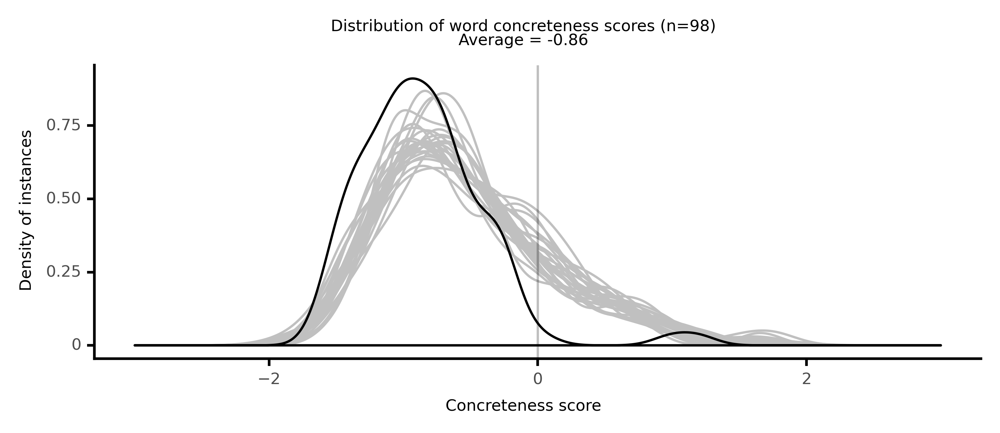

<ggplot: (8764123086453)>

 29%|██▉       | 29/100 [06:06<17:38, 14.90s/it]

#### #30 most abstract passage: Brown, _The Novels . . . (1827): a machine-readable transc_ (1827)

<p>for which he was at <abs><conc056>liberty</conc056></abs> to state to her; at least it was <abs><conc009>justifiable</conc009></abs> in <abs><conc183>refusing</conc183></abs> to <abs><conc047>subject</conc047></abs> himself to <neither><conc528>loathsome</conc528></neither> and <abs><conc110>impracticable</conc110></abs> <abs><conc044>obligations</conc044></abs>. Certain <abs><conc112>inconveniences</conc112></abs> <neither><conc324>attended</conc324></neither> women who <neither><conc564>set</conc564></neither> aside, on these occasions, the <abs><conc012>sanction</conc012></abs> of <abs><conc022>law</conc022></abs>, but these were <neither><conc288>imaginary</conc288></neither>. They <abs><conc166>owed</conc166></abs> their <abs><conc166>force</conc166></abs> to the <abs><conc020>errors</conc020></abs> of the <neither><conc503>sufferer</conc503></neither>. To <abs><conc056>annihilate</conc056></abs> them, it was only necessary to <abs><conc020>reason</conc020></abs> <abs><conc021>justly</conc021></abs>, but <neither><conc364>allowing</conc364></neither> these <abs><conc112>inconveniences</conc112></abs> their full <neither><conc387>weight</conc387></neither> and an indestructable <abs><conc055>existence</conc055></abs>, it was but a <abs><conc224>choice</conc224></abs> of <abs><conc053>evils</conc053></abs>. Were they worse in this lady's <abs><conc050>apprehension</conc050></abs>, than an <abs><conc086>eternal</conc086></abs> and <abs><conc207>hopeless</conc207></abs> <abs><conc218>separation</conc218></abs>? Perhaps they were. If so, she would make her <abs><conc172>election</conc172></abs> accordingly. He did nothing but lay the <abs><conc111>conditions</conc111></abs> before her. If his <abs><conc112>scheme</conc112></abs> should obtain the <abs><conc044>concurrence</conc044></abs> of her <abs><conc000>unbiased</conc000></abs> <abs><conc006>judgement</conc006></abs> he should <abs><conc158>rejoice</conc158></abs>. If not, her <abs><conc010>conduct</conc010></abs> should be <abs><conc000>uninfluenced</conc000></abs> by him. Whatever way she should <abs><conc219>decide</conc219></abs>, he would <neither><conc414>assist</conc414></neither> her in <neither><conc315>adhering</conc315></neither> to her <abs><conc112>decision</conc112></abs>, but would, meanwhile, <abs><conc245>furnish</conc245></abs> her with the <neither><conc459>materials</conc459></neither> of a right <abs><conc112>decision</conc112></abs>. This <abs><conc088>determination</conc088></abs> was <abs><conc219>singular</conc219></abs>. Many will regard it as <abs><conc181>incredible</conc181></abs>. No man, it will be thought, can put this <abs><conc189>deception</conc189></abs> on himself, and <neither><conc304>imagine</conc304></neither> that there was <abs><conc180>genuine</conc180></abs> <abs><conc011>beneficence</conc011></abs> in a <abs><conc112>scheme</conc112></abs> Like this. Would the lady more <neither><conc268>consult</conc268></neither> her <abs><conc149>happiness</conc149></abs> by <abs><conc089>adopting</conc089></abs> than by <abs><conc031>rejecting</conc031></abs> it? There can be but one <abs><conc207>answer</conc207></abs>. It can not be <abs><conc181>supposed</conc181></abs> that Ormond, in <abs><conc144>stating</conc144></abs> this <abs><conc243>proposal</conc243></abs>, <abs><conc210>acted</conc210></abs> with all the <abs><conc018>impartiality</conc018></abs> that he <abs><conc128>pretended</conc128></abs>; that he did not <abs><conc205>employ</conc205></abs> <abs><conc006>fallacious</conc006></abs> <abs><conc078>exaggerations</conc078></abs> and <abs><conc042>ambiguous</conc042></abs> <abs><conc110>expedients</conc110></abs>; that he did not <neither><conc441>seize</conc441></neither> every <abs><conc205>opportunity</conc205></abs> of <abs><conc165>triumphing</conc165></abs> over her <abs><conc077>weakness</conc077></abs>, and <neither><conc660>building</conc660></neither> his <abs><conc077>success</conc077></abs> rather on the <abs><conc113>illusions</conc113></abs> of her <neither><conc275>heart</conc275></neither> than the <abs><conc006>convictions</conc006></abs> of her <abs><conc024>understanding</conc024></abs>. His <abs><conc051>conclusions</conc051></abs> were <abs><conc068>specious</conc068></abs> but <abs><conc072>delusive</conc072></abs>, and were not <abs><conc000>uninfluenced</conc000></abs> by <abs><conc222>improper</conc222></abs> biasses; but of this he himself was <neither><conc372>scarcely</conc372></neither> <abs><conc129>conscious</conc129></abs>, and it must be, at least, <abs><conc161>admitted</conc161></abs> that he <abs><conc210>acted</conc210></abs> with <abs><conc174>scrupulous</conc174></abs> <abs><conc045>sincerity</conc045></abs>. An <neither><conc308>uncommon</conc308></neither> <abs><conc077>degree</conc077></abs> of <abs><conc254>skill</conc254></abs> was <abs><conc238>required</conc238></abs> to <neither><conc309>introduce</conc309></neither> this <abs><conc227>topic</conc227></abs> so as to <abs><conc187>avoid</conc187></abs> the <abs><conc058>imputation</conc058></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

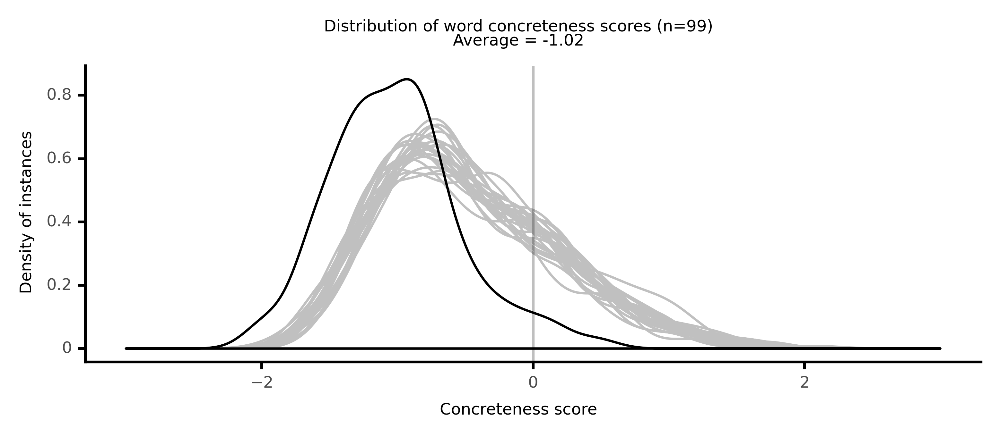

<ggplot: (8764118033469)>

 30%|███       | 30/100 [06:16<15:41, 13.45s/it]

#### #31 most abstract passage: Richardson, _Sir Charles Grandison (1754)_ (1754)

<p>of the <neither><conc388>Chevalier</conc388></neither> Grandison have taken from me the <abs><conc020>power</conc020></abs> of <abs><conc020>opposing</conc020></abs> it. <abs><conc209>Permit</conc209></abs> me to be <neither><conc389>silent</conc389></neither>. Father Marescotti and I, said the <abs><conc218>Bishop</conc218></abs>, are in one <abs><conc228>situation</conc228></abs>, as to <neither><conc250>scruples</conc250></neither> of <abs><conc064>conscience</conc064></abs>. But I will <abs><conc212>forget</conc212></abs> the <abs><conc222>Prelate</conc222></abs> for the Brother. Dear Grandison, will you <abs><conc209>permit</conc209></abs> us to say to <abs><conc026>enquirers</conc026></abs>, that we look upon you as one of our <neither><conc260>church</conc260></neither>; and that <abs><conc016>prudential</conc016></abs> <abs><conc058>reasons</conc058></abs>, with regard to your country, and friends in it, <abs><conc082>deter</conc082></abs> you at present from <abs><conc041>declaring</conc041></abs> yourself? Let not terms be <abs><conc135>proposed</conc135></abs>, my good Lord, that would <abs><conc164>lessen</conc164></abs> your <abs><conc033>opinion</conc033></abs> of me, should I <abs><conc176>comply</conc176></abs> with them. If I am to be <abs><conc215>honoured</conc215></abs> with an <neither><conc289>admission</conc289></neither> into this <neither><conc291>noble</conc291></neither> family, let me not in my own <neither><conc657>eyes</conc657></neither> appear <abs><conc029>unworthy</conc029></abs> of the honour. Were I to find myself <abs><conc107>capable</conc107></abs> of <abs><conc091>prevaricating</conc091></abs> in an <neither><conc280>article</conc280></neither> so important as <abs><conc043>religion</conc043></abs>, no one could <abs><conc219>hate</conc219></abs> me so much as I should <abs><conc219>hate</conc219></abs> myself, were even an <neither><conc401>imperial</conc401></neither> <neither><conc578>diadem</conc578></neither> with your Clementina, the <abs><conc233>noblest</conc233></abs> of women, to be the <abs><conc052>consideration</conc052></abs>. You have the example of great <abs><conc161>princes</conc161></abs>, <neither><conc388>Chevalier</conc388></neither>, said Father Marescotti, Henry the Fourth of France, Augustus of Poland-- <abs><conc073>True</conc073></abs>, Father-- But great <abs><conc161>Princes</conc161></abs> are not always, and in every <abs><conc098>action</conc098></abs> of their <neither><conc257>lives</conc257></neither>, great men. They might make the less <neither><conc262>scruple</conc262></neither> of <neither><conc408>changing</conc408></neither> their <abs><conc043>religion</conc043></abs>, as they were neither of them <abs><conc078>strict</conc078></abs> in the <abs><conc052>practice</conc052></abs> of it. They who can allow themselves in some <abs><conc051>deviations</conc051></abs>, may in others. I <neither><conc269>boast</conc269></neither> not of my own <abs><conc076>virtue</conc076></abs>; but it has been my <abs><conc180>aim</conc180></abs> to be <neither><conc311>uniform</conc311></neither>. I am too well <abs><conc064>satisfied</conc064></abs> with my own <abs><conc043>religion</conc043></abs>, to <abs><conc097>doubt</conc097></abs>: If I were not, it would be <abs><conc133>impossible</conc133></abs> but I must be <abs><conc014>influenced</conc014></abs> by the <abs><conc157>wishes</conc157></abs> of friends so dear to me; whose <abs><conc008>motives</conc008></abs> are the <abs><conc043>result</conc043></abs> of their own <abs><conc099>piety</conc099></abs>, and of the regard they have for my <abs><conc195>everlasting</conc195></abs> <abs><conc041>welfare</conc041></abs>. The <neither><conc388>Chevalier</conc388></neither> and I, <neither><conc319>rejoined</conc319></neither> the <abs><conc218>Bishop</conc218></abs>, have <neither><conc487>carried</conc487></neither> this <abs><conc061>argument</conc061></abs> to its full <neither><conc346>extent</conc346></neither> before. My <abs><conc215>honoured</conc215></abs> Lord's <abs><conc103>question</conc103></abs> <abs><conc111>recurs</conc111></abs>; What <abs><conc109>security</conc109></abs> can we have, that my sister shall not be <abs><conc026>perverted</conc026></abs>? The <neither><conc388>Chevalier</conc388></neither> <abs><conc145>refers</conc145></abs> to Father Marescotti to <abs><conc135>propose</conc135></abs> it. The Father <abs><conc158>excuses</conc158></abs> himself. I, as the brother of Clementina, ask you, <neither><conc388>Chevalier</conc388></neither>, Will you <abs><conc156>promise</conc156></abs> never by yourself, or your English <abs><conc113>divines</conc113></abs>, to <abs><conc141>attempt</conc141></abs> to <abs><conc012>pervert</conc012></abs> her?-- A <neither><conc306>confessor</conc306></neither> you have <abs><conc144>allowed</conc144></abs> her. Shall Father Marescotti be the man? And will Father Marescotti-- I will, for the <neither><conc253>sake</conc253></neither> of <abs><conc207>preserving</conc207></abs> to Lady Clementina her <abs><conc070>faith</conc070></abs>; that <abs><conc070>faith</conc070></abs> by which only she can be <abs><conc233>saved</conc233></abs>; and, perhaps, in <abs><conc131>hope</conc131></abs> of <abs><conc231>converting</conc231></abs> the man who then will be dear to the whole family. I not only <abs><conc176>comply</conc176></abs> with the <abs><conc227>proposal</conc227></abs>, but shall think Father Marescotti will do me a <abs><conc067>favour</conc067></abs>, in <neither><conc443>putting</conc443></neither> it into my <abs><conc020>power</conc020></abs> to show him the regard I have for him. One <neither><conc266>request</conc266></neither> I have only to make; That Father Marescotti will <abs><conc117>prescribe</conc117></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

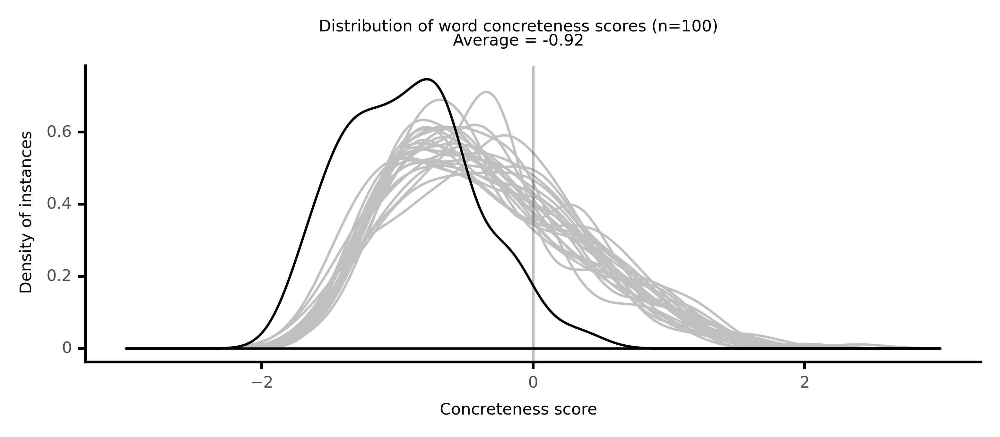

<ggplot: (8764098696141)>

 31%|███       | 31/100 [06:41<19:33, 17.01s/it]

#### #32 most abstract passage: Herbert, _The Princess Cloria (1661)_ (1661)

<p>of the <abs><conc143>safety</conc143></abs> of the <neither><conc323>Kings</conc323></neither> Person, since he can never <abs><conc110>hope</conc110></abs> to be again <abs><conc176>reestablished</conc176></abs> in his <abs><conc075>rightful</conc075></abs> <abs><conc018>Authority</conc018></abs>, but either by the <neither><conc520>humours</conc520></neither> and <abs><conc182>inconstancy</conc182></abs> of the <abs><conc195>common</conc195></abs> people, who when they find the <neither><conc323>Kings</conc323></neither> <abs><conc008>absolute</conc008></abs> <abs><conc177>oppression</conc177></abs> brings no <abs><conc142>prosperity</conc142></abs> to them, will probably become <abs><conc191>exasperated</conc191></abs> against the <abs><conc209>Senates</conc209></abs> <abs><conc031>proceedings</conc031></abs> and <abs><conc024>power</conc024></abs>, or by an <abs><conc042>unreconcilable</conc042></abs> <abs><conc166>difference</conc166></abs> between the <neither><conc362>Senators</conc362></neither> themselves, who may most <abs><conc201>command</conc201></abs>, when they shall find no other <abs><conc122>jurisdiction</conc122></abs> to <abs><conc018>oppose</conc018></abs> them: both which in all <abs><conc192>likelihood</conc192></abs> will <abs><conc074>conduce</conc074></abs> to the <neither><conc323>Kings</conc323></neither> <abs><conc069>benefit</conc069></abs>, if he <neither><conc512>sit</conc512></neither> <abs><conc170>quiet</conc170></abs> sometime under his <abs><conc097>injuries</conc097></abs>, which I <abs><conc030>conceive</conc030></abs> to be the <abs><conc027>reason</conc027></abs>, that he hath in <abs><conc215>outward</conc215></abs> <abs><conc166>appearance</conc166></abs> <neither><conc349>yielded</conc349></neither> so much to their <abs><conc063>demands</conc063></abs>. And for the Myssians perhaps by this <abs><conc038>opposition</conc038></abs>, they would <abs><conc078>persuade</conc078></abs> the world to a <abs><conc016>belief</conc016></abs> of their integrities, as if at the first they <abs><conc222>consented</conc222></abs> not to the <neither><conc323>Kings</conc323></neither> <neither><conc649>hard</conc649></neither> <neither><conc267>usage</conc267></neither>, whereby to obtain a <abs><conc150>greater</conc150></abs> <abs><conc220>party</conc220></abs>, not only in the <abs><conc125>Kingdom</conc125></abs> of Lydia, if they have an <abs><conc026>intention</conc026></abs> to <abs><conc075>dispute</conc075></abs> their own <abs><conc129>profit</conc129></abs>, but in other <neither><conc487>Countries</conc487></neither> if they mean to make <abs><conc226>War</conc226></abs> upon our people, because they can not be <abs><conc118>sharers</conc118></abs> in the <abs><conc032>Government</conc032></abs> as they <abs><conc170>hoped</conc170></abs>, the only cause certainly of the now seeming <abs><conc226>quarrel</conc226></abs>: So that in my <abs><conc026>opinion</conc026></abs>, Euarchus hath done Like a <abs><conc125>wise</conc125></abs> and <abs><conc198>Politick</conc198></abs> Prince, in seeming not to <abs><conc110>contend</conc110></abs>, where he was sure not to <abs><conc179>prevail</conc179></abs>; especially since by the <abs><conc075>dispute</conc075></abs>, he might have <abs><conc228>endangered</conc228></abs> those <abs><conc225>hearts</conc225></abs>, that will now be of his side if the occasion be <abs><conc210>offered</conc210></abs>, either out of <neither><conc325>pity</conc325></neither> to his <abs><conc041>sufferings</conc041></abs>, or out of <abs><conc213>hate</conc213></abs> to the <abs><conc209>Senates</conc209></abs> <abs><conc032>Government</conc032></abs>: And beside, it is to be <abs><conc036>considered</conc036></abs>, that no Act he shall <neither><conc348>pass</conc348></neither> in this <abs><conc128>condition</conc128></abs> of <abs><conc136>constraint</conc136></abs>, can <neither><conc553>bind</conc553></neither> either himself or <abs><conc165>posterity</conc165></abs> by all <abs><conc016>Humane</conc016></abs> and <abs><conc018>Divine</conc018></abs> <abs><conc049>Laws</conc049></abs>, if his <neither><conc549>Sword</conc549></neither> ever become more <abs><conc116>powerful</conc116></abs>. In the mean time, the <abs><conc224>Senate</conc224></abs> will <abs><conc197>seek</conc197></abs> to <neither><conc256>preserve</conc256></neither> the <neither><conc323>Kings</conc323></neither> Life and Person with their best <neither><conc288>care</conc288></neither>, since their own <abs><conc018>authority</conc018></abs> <neither><conc593>falls</conc593></neither> entirely by his <neither><conc267>death</conc267></neither>, which as I lay is the <abs><conc027>reason</conc027></abs>, they <abs><conc076>desire</conc076></abs> more a <neither><conc250>term</conc250></neither> of years in the <abs><conc114>continuation</conc114></abs> of their <abs><conc139>required</conc139></abs> <abs><conc032>Government</conc032></abs>, then the <abs><conc055>determinable</conc055></abs> <neither><conc460>fate</conc460></neither> of the <abs><conc199>Princes</conc199></abs> life, because they may have always the <abs><conc067>liberty</conc067></abs> to <neither><conc402>press</conc402></neither> him to new <abs><conc055>conditions</conc055></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

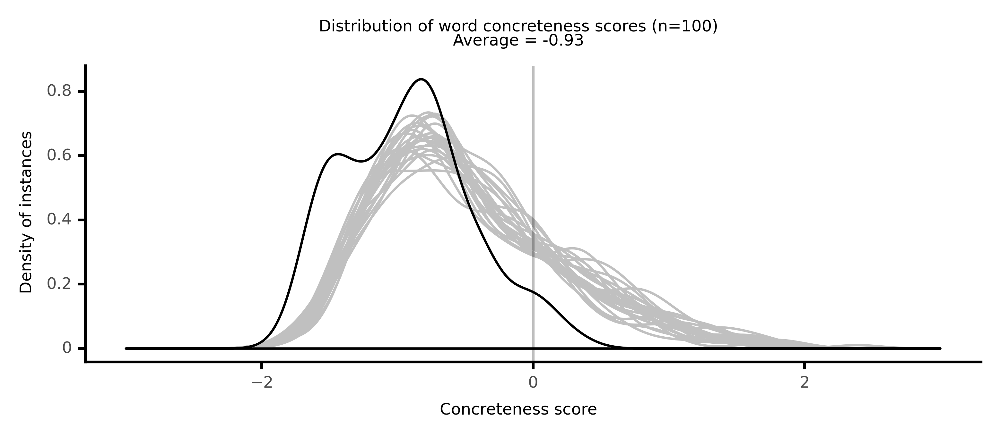

<ggplot: (8764101835177)>

 32%|███▏      | 32/100 [06:58<19:14, 16.98s/it]

#### #33 most abstract passage: Neal, _Randolph: A Novel, Volume 2 . . . (1823)_ (1823)

<p>by it; and he would <abs><conc136>abandon</conc136></abs> the <neither><conc363>point</conc363></neither>. It would be an <neither><conc307>especial</conc307></neither> <abs><conc152>hardship</conc152></abs>, in that particular case; but, as a <abs><conc129>general</conc129></abs> <abs><conc231>regulation</conc231></abs> of <abs><conc147>society</conc147></abs>, the <neither><conc597>quaker</conc597></neither> would have no <abs><conc020>reason</conc020></abs> to <abs><conc144>complain</conc144></abs>. Why should they <abs><conc188>repine</conc188></abs>, that they can not be <neither><conc722>cleared</conc722></neither> by <abs><conc069>evidence</conc069></abs>, which can not <abs><conc018>condemn</conc018></abs> them. The <abs><conc022>law</conc022></abs> is <neither><conc277>foolish</conc277></neither>, to be sure: or rather was-- for, it has been <neither><conc328>altered</conc328></neither>. But, there is no <abs><conc152>hardship</conc152></abs> in the case. Again-- <abs><conc191>suppose</conc191></abs> that the <abs><conc008>doctrine</conc008></abs> of many a <abs><conc119>writer</conc119></abs> on <abs><conc086>criminal</conc086></abs> <abs><conc116>jurisprudence</conc116></abs>; and, particularly, that of Beccaria; which is, that the <abs><conc195>greater</conc195></abs> the <abs><conc076>crime</conc076></abs>, the <abs><conc195>greater</conc195></abs> the <abs><conc050>proof</conc050></abs> to be <abs><conc205>demanded</conc205></abs>,-- <abs><conc191>suppose</conc191></abs> that that <abs><conc008>doctrine</conc008></abs> were <neither><conc278>advanced</conc278></neither> by a <neither><conc345>lawyer</conc345></neither>'s <abs><conc113>colleague</conc113></abs>. I would have him <neither><conc450>search</conc450></neither> into the <abs><conc016>principles</conc016></abs>-- lay them <neither><conc553>bore</conc553></neither>-- and never <abs><conc245>shrink</conc245></abs> from the work, till all was <neither><conc509>disclosed</conc509></neither>, whatever were the <abs><conc025>consequences</conc025></abs>. He would show that the <abs><conc008>doctrine</conc008></abs> was not <abs><conc024>true</conc024></abs>: or the <abs><conc085>application</conc085></abs> <abs><conc085>false</conc085></abs>. I would have him <abs><conc060>prove</conc060></abs> what is <abs><conc024>true</conc024></abs>-- that, in <abs><conc261>proportion</conc261></abs> to the <abs><conc145>magnitude</conc145></abs> of a <neither><conc303>charge</conc303></neither>, is its unfrequency; and, consequently, the <abs><conc014>improbability</conc014></abs> of it; for <abs><conc198>charges</conc198></abs> and <abs><conc095>crimes</conc095></abs> too, become <abs><conc112>probable</conc112></abs> by becoming common.-- <neither><conc318>Theft</conc318></neither> is <abs><conc256>common</conc256></abs>-- <neither><conc332>parricide</conc332></neither> very <neither><conc371>rare</conc371></neither>. Consequently, you would <abs><conc118>demand</conc118></abs> more <abs><conc050>proof</conc050></abs> of <neither><conc332>parricide</conc332></neither> than of <neither><conc318>theft</conc318></neither>. The <abs><conc088>conclusion</conc088></abs> is <abs><conc085>false</conc085></abs>. <abs><conc050>Proof</conc050></abs> is always the same. You are not, to <abs><conc236>convict</conc236></abs> for the <neither><conc315>slightest</conc315></neither> <abs><conc121>offence</conc121></abs>, unless you are <abs><conc180>satisfied</conc180></abs>. You must <abs><conc118>demand</conc118></abs> the same <abs><conc069>evidence</conc069></abs>, of the particular <abs><conc067>fact</conc067></abs>, upon which a <abs><conc086>criminal</conc086></abs> is <abs><conc211>arraigned</conc211></abs>, though he may be the <neither><conc393>lowest</conc393></neither> and <neither><conc288>vilest</conc288></neither> of <abs><conc147>society</conc147></abs>, that you would to <abs><conc236>convict</conc236></abs> the greatest and best. If you do not-- you are <abs><conc031>unwise</conc031></abs> and <neither><conc273>wicked</conc273></neither>. You are not the <abs><conc079>ministers</conc079></abs> of the <abs><conc022>law</conc022></abs>. It is your <abs><conc083>prejudice</conc083></abs>; and not <abs><conc027>justice</conc027></abs> that <abs><conc083>pronounces</conc083></abs> <abs><conc248>sentence</conc248></abs>. Yet no <abs><conc033>principle</conc033></abs> of <abs><conc086>criminal</conc086></abs> <abs><conc069>evidence</conc069></abs> is so little <abs><conc118>understood</conc118></abs>, and so <abs><conc190>eternally</conc190></abs> <abs><conc043>disregarded</conc043></abs>, as this. But it is <abs><conc085>false</conc085></abs> on another account. One <abs><conc178>witness</conc178></abs>, <abs><conc038>unimpeached</conc038></abs>, <abs><conc007>uncontradicted</conc007></abs>, by the English <abs><conc022>law</conc022></abs>, is enough to <abs><conc060>prove</conc060></abs> any <abs><conc067>fact</conc067></abs>. Now, says Beccaria, you shall <abs><conc202>require</conc202></abs> a <abs><conc195>greater</conc195></abs> <abs><conc050>proof</conc050></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

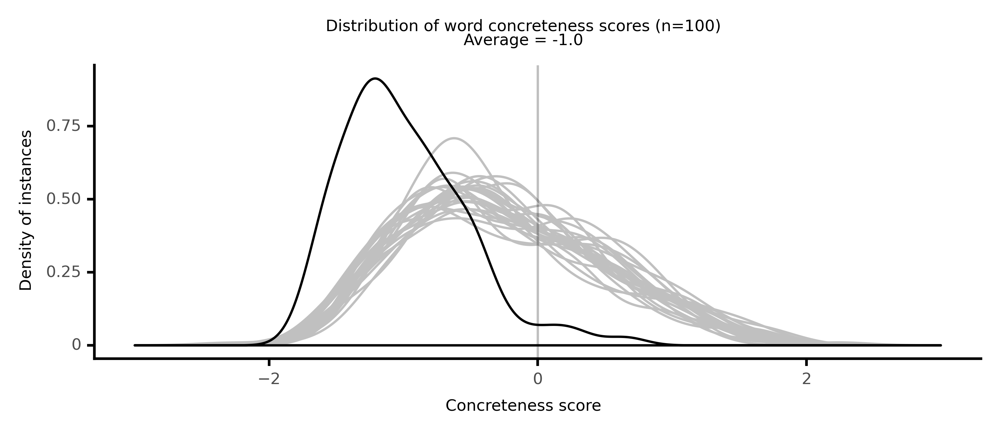

<ggplot: (8764097502761)>

 33%|███▎      | 33/100 [07:10<17:08, 15.35s/it]

#### #34 most abstract passage: Paulding, _The Merry Tales of the Three Wise Men of Gotham (1_ (1826)

<p>, that are <abs><conc081>essential</conc081></abs> to its <abs><conc055>existence</conc055></abs>, and which only the <abs><conc091>habitual</conc091></abs> <abs><conc195>enjoyment</conc195></abs> of it can thoroughly <abs><conc013>implant</conc013></abs> in the mind. When the <abs><conc015>rational</conc015></abs> <neither><conc366>inhabitants</conc366></neither> of the new world, speak of <abs><conc032>freedom</conc032></abs> and <abs><conc129>equality</conc129></abs>, they mean nothing more than the <abs><conc209>privilege</conc209></abs> of making their own <abs><conc048>laws</conc048></abs>, and an <abs><conc129>equality</conc129></abs> of <abs><conc069>civil</conc069></abs> and <abs><conc043>religious</conc043></abs> <abs><conc096>rights</conc096></abs>. The first right of a people,'' said Mr. Ashley to me, in one of our <abs><conc078>discussions</conc078></abs>-- the first right of a people is that of making their own <abs><conc048>laws</conc048></abs>-- their first <abs><conc127>duty</conc127></abs> is to <abs><conc197>obey</conc197></abs> them. They and the <abs><conc138>magistrates</conc138></abs> who <abs><conc204>administer</conc204></abs> them, are the only <abs><conc244>sovereigns</conc244></abs>.'' This is a <abs><conc050>sentiment</conc050></abs>, I may say a <neither><conc263>habit</conc263></neither>, with the Americans; and I often have had occasion to <abs><conc231>observe</conc231></abs> that one of the last things they think of, is <abs><conc119>resisting</conc119></abs> <abs><conc048>laws</conc048></abs> <neither><conc407>assented</conc407></neither> to by their own <abs><conc190>peculiar</conc190></abs> <abs><conc204>legislature</conc204></abs>. My friend and I had <neither><conc561>long</conc561></neither> and <abs><conc215>frequent</conc215></abs> <abs><conc045>arguments</conc045></abs>, upon the <abs><conc135>advantages</conc135></abs> of the old and new system, for though he was my <abs><conc176>benefactor</conc176></abs>, I was <abs><conc141>determined</conc141></abs> not to give up to him on that account. Your master, as you call him,'' said Mr. Ashley to me, one day that I had <neither><conc278>advanced</conc278></neither> the <abs><conc008>doctrine</conc008></abs> of <abs><conc043>perfectibility</conc043></abs>-- your master <abs><conc217>appears</conc217></abs> to consider all the <abs><conc090>vices</conc090></abs> and <abs><conc095>crimes</conc095></abs> of <abs><conc013>mankind</conc013></abs> as <abs><conc230>proceeding</conc230></abs> from <abs><conc021>ignorance</conc021></abs>.'' Certainly,'' said I, they are the necessary and <abs><conc072>inevitable</conc072></abs> <abs><conc025>consequences</conc025></abs> of <abs><conc021>ignorance</conc021></abs>, as my master <abs><conc052>affirms</conc052></abs>.'' As an <abs><conc032>abstract</conc032></abs> <abs><conc120>proposition</conc120></abs> and taken in its <abs><conc242>broadest</conc242></abs> <abs><conc020>sense</conc020></abs> it is probably <abs><conc024>true</conc024></abs>. Could we <abs><conc089>conceive</conc089></abs> the <abs><conc104>idea</conc104></abs> of any being, but <abs><conc033>Omnipotence</conc033></abs> alone, <abs><conc213>gifted</conc213></abs> with <neither><conc275>perfect</conc275></neither> <abs><conc045>knowledge</conc045></abs>, that being would probably be free from all <abs><conc141>vice</conc141></abs>. <neither><conc275>Perfect</conc275></neither> <abs><conc045>knowledge</conc045></abs> <abs><conc003>presupposes</conc003></abs> a <neither><conc275>perfect</conc275></neither> <abs><conc004>conviction</conc004></abs> of the <abs><conc005>futility</conc005></abs> of <abs><conc255>indulging</conc255></abs> the <abs><conc169>passion</conc169></abs>, except to the <abs><conc136>extent</conc136></abs> in which they are <abs><conc081>essential</conc081></abs> to the <abs><conc055>existence</conc055></abs> of the <neither><conc356>grand</conc356></neither> system of the <abs><conc155>universe</conc155></abs>. <neither><conc275>Perfect</conc275></neither> <abs><conc045>knowledge</conc045></abs>, or <abs><conc019>wisdom</conc019></abs>, would know that <abs><conc066>inordinate</conc066></abs> <abs><conc227>lust</conc227></abs>, <abs><conc146>avarice</conc146></abs>, <abs><conc077>ambition</conc077></abs>, <abs><conc201>gluttony</conc201></abs>, <abs><conc068>selfishness</conc068></abs>, <neither><conc315>envy</conc315></neither>, <abs><conc193>malice</conc193></abs>, <abs><conc234>revenge</conc234></abs>, and all those <abs><conc169>passion</conc169></abs> which <abs><conc201>led</conc201></abs> to the <abs><conc139>commission</conc139></abs> of <abs><conc076>crime</conc076></abs>, were in <abs><conc067>fact</conc067></abs> <abs><conc144>sources</conc144></abs> of <abs><conc249>misery</conc249></abs>, <abs><conc088>repentance</conc088></abs> and <neither><conc268>despair</conc268></neither>. It would therefore, having this <neither><conc275>perfect</conc275></neither> <abs><conc004>conviction</conc004></abs>, <abs><conc050>abstain</conc050></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

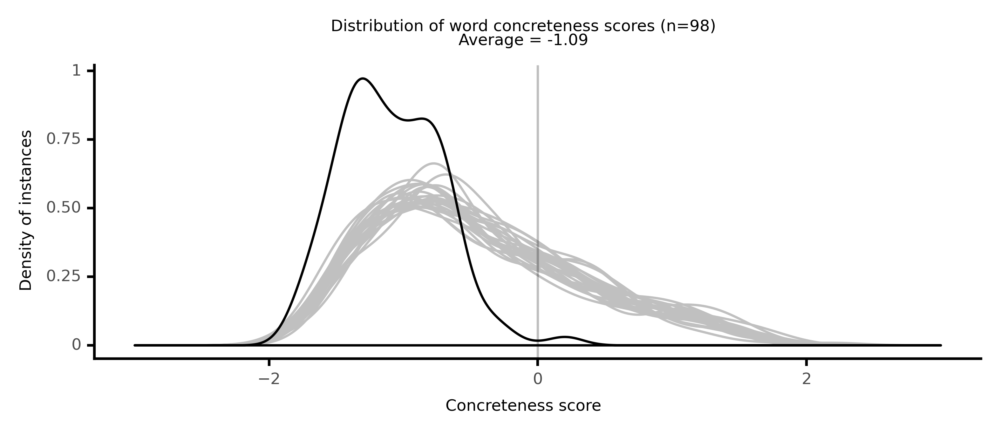

<ggplot: (8764101777677)>

 34%|███▍      | 34/100 [07:20<15:03, 13.69s/it]

#### #35 most abstract passage: Brown, _Ormond; or, The Secret Witness . . . (1799)_ (1799)

<p>his love and described, without <neither><conc262>scruple</conc262></neither>, the <abs><conc074>scope</conc074></abs> of his <abs><conc157>wishes</conc157></abs>. He <abs><conc148>challenged</conc148></abs> her to <abs><conc025>confute</conc025></abs> his <abs><conc010>principles</conc010></abs>, and <abs><conc172>promised</conc172></abs> a <abs><conc159>candid</conc159></abs> <neither><conc248>audience</conc248></neither> and <abs><conc224>profound</conc224></abs> <abs><conc052>consideration</conc052></abs> to her <abs><conc068>arguments</conc068></abs>. Her present <abs><conc009>opinions</conc009></abs> he knew to be <abs><conc145>adverse</conc145></abs> to his own, but he <abs><conc104>hoped</conc104></abs> to <neither><conc260>change</conc260></neither> them, by <abs><conc077>subtlety</conc077></abs> and <abs><conc054>perseverance</conc054></abs>. His further <abs><conc131>Hope</conc131></abs>'s and <abs><conc095>designs</conc095></abs>, he <neither><conc475>concealed</conc475></neither> from her. She was <abs><conc198>unaware</conc198></abs>, that if he were <abs><conc200>unable</conc200></abs> to effect a <neither><conc260>change</conc260></neither> in her <abs><conc165>creed</conc165></abs>, he was <abs><conc097>determined</conc097></abs> to <abs><conc044>adopt</conc044></abs> a system of <abs><conc121>imposture</conc121></abs>. To <abs><conc225>assume</conc225></abs> the <neither><conc389>guise</conc389></neither> of a <neither><conc263>convert</conc263></neither> to her <abs><conc030>doctrines</conc030></abs>, and appear as <abs><conc156>devout</conc156></abs> as herself in his <abs><conc053>notions</conc053></abs> of the <abs><conc174>sanctity</conc174></abs> of <neither><conc360>marriage</conc360></neither>. Perhaps it was not <abs><conc174>difficult</conc174></abs>, to have <abs><conc071>foreseen</conc071></abs> the <abs><conc035>consequence</conc035></abs> of these <abs><conc189>projects</conc189></abs>. <neither><conc470>Constantia</conc470></neither>'s <abs><conc182>peril</conc182></abs> was <abs><conc150>imminent</conc150></abs>. This <neither><conc283>arose</conc283></neither> not only from the <abs><conc079>talents</conc079></abs> and <abs><conc176>address</conc176></abs> of Ormond, but from the <abs><conc115>community</conc115></abs> of <abs><conc069>sentiment</conc069></abs>, which already <abs><conc177>existed</conc177></abs> between them. She was <neither><conc321>unguarded</conc321></neither> in a <neither><conc317>point</conc317></neither>, where, if not her whole, yet, <abs><conc068>doubtless</conc068></abs>, her <neither><conc279>principal</conc279></neither> <abs><conc109>security</conc109></abs> and <neither><conc242>strongest</conc242></neither> <neither><conc283>bulwark</conc283></neither> would have <abs><conc177>existed</conc177></abs>. She was <abs><conc159>unacquainted</conc159></abs> with <abs><conc043>religion</conc043></abs>. She was unhabituated to <abs><conc072>conform</conc072></abs> herself to any <abs><conc167>standard</conc167></abs>, but that <abs><conc183>connected</conc183></abs> with the present life. <neither><conc344>Matrimonial</conc344></neither>, as well as every other <abs><conc115>human</conc115></abs> <abs><conc135>duty</conc135></abs>, was <abs><conc083>disconnected</conc083></abs> in her mind, with any <neither><conc245>awful</conc245></neither> or <abs><conc054>divine</conc054></abs> <abs><conc055>sanction</conc055></abs>. She <neither><conc429>formed</conc429></neither> her <abs><conc143>estimate</conc143></abs> of good and <abs><conc032>evil</conc032></abs>, on nothing but <neither><conc429>terrestrial</conc429></neither> and <abs><conc210>visible</conc210></abs> <abs><conc049>consequences</conc049></abs>. This <abs><conc105>defect</conc105></abs> in her <abs><conc182>character</conc182></abs>, she <abs><conc059>owed</conc059></abs> to her father's system of <abs><conc160>education</conc160></abs>. Mr. Dudley was an <abs><conc208>adherent</conc208></abs> to what he <abs><conc112>conceived</conc112></abs> to be <abs><conc073>true</conc073></abs> <abs><conc043>religion</conc043></abs>. No man was more <abs><conc195>passionate</conc195></abs> in his culogy of his own from of <abs><conc212>devotion</conc212></abs> and <abs><conc012>belief</conc012></abs>, or in his <abs><conc124>invectives</conc124></abs> against <abs><conc010>Atheistical</conc010></abs> <abs><conc005>dogmas</conc005></abs>; but he <neither><conc368>reflected</conc368></neither> that <abs><conc043>religion</conc043></abs> <abs><conc215>assumed</conc215></abs> many <neither><conc514>forms</conc514></neither>, one only of which is <abs><conc098>salutary</conc098></abs> or <abs><conc073>true</conc073></abs>, and that <abs><conc065>truth</conc065></abs> in this <abs><conc047>respect</conc047></abs>, is <abs><conc010>incompatible</conc010></abs> with <abs><conc204>infantile</conc204></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

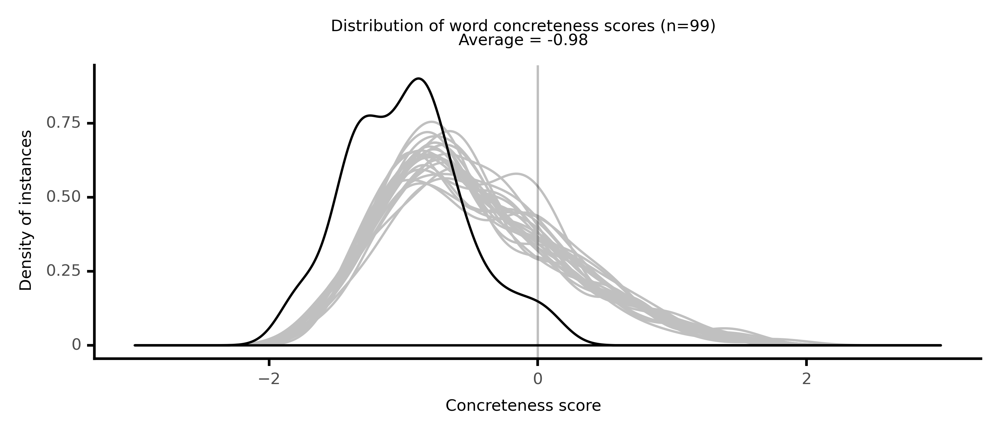

<ggplot: (8764111229413)>

 35%|███▌      | 35/100 [07:31<14:00, 12.94s/it]

#### #36 most abstract passage: Stowe, _Dred: A Tale of the Great Dismal Swamp (1856) [Vol_ (1856)

<p>. <neither><conc297>Moderate</conc297></neither> <abs><conc166>force</conc166></abs> is <abs><conc029>superadded</conc029></abs> only to make the others <abs><conc172>effectual</conc172></abs>. If that <abs><conc084>fail</conc084></abs>, it is better to leave the <abs><conc215>party</conc215></abs> to his own <abs><conc170>headstrong</conc170></abs> <abs><conc169>passion</conc169></abs>, and the <abs><conc028>ultimate</conc028></abs> <abs><conc145>correction</conc145></abs> of the <abs><conc022>law</conc022></abs>, than to allow it to be <neither><conc630>immoderately</conc630></neither> <abs><conc183>inflicted</conc183></abs> by a <abs><conc152>private</conc152></abs> person. With <abs><conc125>slavery</conc125></abs> it is far otherwise. The end is the <abs><conc200>profit</conc200></abs> of the master, his <abs><conc145>security</conc145></abs>, and the <abs><conc049>public</conc049></abs> <abs><conc252>safety</conc252></abs>; the <abs><conc047>subject</conc047></abs>, one <neither><conc263>doomed</conc263></neither>, in his own person and his <abs><conc095>posterity</conc095></abs>, to live without <abs><conc045>knowledge</conc045></abs>, and without the <abs><conc078>capacity</conc078></abs> to make anything his own, and to <neither><conc309>toil</conc309></neither> that another may <abs><conc260>reap</conc260></abs> the <neither><conc464>fruits</conc464></neither>. What <abs><conc005>moral</conc005></abs> <abs><conc051>considerations</conc051></abs> shall be <neither><conc300>addressed</conc300></neither> to such a being, to <abs><conc064>convince</conc064></abs> him what it is <abs><conc154>impossible</conc154></abs> but that the most <neither><conc367>stupid</conc367></neither> must feel and know can never be <abs><conc024>true</conc024></abs>,-- that he is thus to <neither><conc308>labour</conc308></neither> upon a <abs><conc033>principle</conc033></abs> of <abs><conc072>natural</conc072></abs> <abs><conc127>duty</conc127></abs>, or for the <abs><conc219>sake</conc219></abs> of his own <abs><conc015>personal</conc015></abs> <abs><conc149>happiness</conc149></abs>? Such <abs><conc159>services</conc159></abs> can only be <abs><conc195>expected</conc195></abs> from one who has no will of his own; who <abs><conc237>surrenders</conc237></abs> his will in <abs><conc021>implicit</conc021></abs> <abs><conc063>obedience</conc063></abs> to that of another. Such <abs><conc063>obedience</conc063></abs> is the <abs><conc068>consequence</conc068></abs> only of <abs><conc076>uncontrolled</conc076></abs> <abs><conc017>authority</conc017></abs> over the body. There is nothing else which can <abs><conc151>operate</conc151></abs> to <neither><conc319>produce</conc319></neither> the effect. The <abs><conc028>power</conc028></abs> of the master must be <abs><conc017>absolute</conc017></abs>, to <abs><conc106>render</conc106></abs> the <abs><conc048>submission</conc048></abs> of the <neither><conc323>slave</conc323></neither> <neither><conc275>perfect</conc275></neither>. I most <neither><conc272>freely</conc272></neither> <abs><conc149>confess</conc149></abs> my <abs><conc020>sense</conc020></abs> of the <abs><conc091>harshness</conc091></abs> of this <abs><conc120>proposition</conc120></abs>. I feel it as <neither><conc275>deeply</conc275></neither> as any man can. And, as a <abs><conc033>principle</conc033></abs> of <abs><conc005>moral</conc005></abs> right, every person in his <abs><conc168>retirement</conc168></abs> must <abs><conc007>repudiate</conc007></abs> it. But, in the <abs><conc033>actual</conc033></abs> <abs><conc130>condition</conc130></abs> of things, it must be so. There is no <abs><conc156>remedy</conc156></abs>. This <abs><conc085>discipline</conc085></abs> <neither><conc273>belongs</conc273></neither> to the state of <abs><conc125>slavery</conc125></abs>. They can not be <abs><conc121>disunited</conc121></abs> without <abs><conc097>abrogating</conc097></abs> at once the <abs><conc096>rights</conc096></abs> of the master, and absolving the <neither><conc323>slave</conc323></neither> from his <abs><conc085>subjection</conc085></abs>. It <abs><conc188>constitutes</conc188></abs> the <neither><conc300>curse</conc300></neither> of <abs><conc125>slavery</conc125></abs> to both the <neither><conc286>bound</conc286></neither> and the free <neither><conc384>portions</conc384></neither> of our <neither><conc390>population</conc390></neither>. But it is <abs><conc033>inherent</conc033></abs> in the <abs><conc086>relation</conc086></abs> of master and <neither><conc323>slave</conc323></neither>. That there may be particular <abs><conc168>instances</conc168></abs> of <abs><conc140>cruelty</conc140></abs> and <abs><conc095>deliberate</conc095></abs> <abs><conc114>barbarity</conc114></abs>, where in <abs><conc026>conscience</conc026></abs> the <abs><conc022>law</conc022></abs> might <neither><conc318>properly</conc318></neither> <abs><conc240>interfere</conc240></abs>, is most <abs><conc112>probable</conc112></abs>. The <abs><conc217>difficulty</conc217></abs> is to <abs><conc148>determine</conc148></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

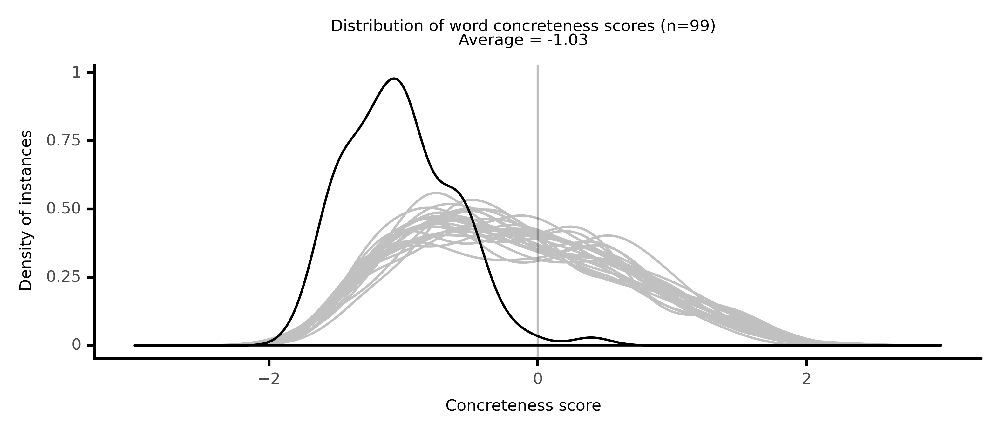

<ggplot: (8764118267773)>

 36%|███▌      | 36/100 [07:42<13:18, 12.48s/it]

#### #37 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>, it is <abs><conc071>rebellion</conc071></abs> to <abs><conc201>refuse</conc201></abs> <abs><conc081>subjection</conc081></abs> to right <abs><conc031>reason</conc031></abs>, and a <abs><conc052>violation</conc052></abs> of the great and <abs><conc031>fundamental</conc031></abs> <abs><conc016>law</conc016></abs> of <abs><conc233>heaven</conc233></abs> and <neither><conc562>earth</conc562></neither>. To this best, and <abs><conc208>fittest</conc208></abs>, and <abs><conc233>noblest</conc233></abs> <abs><conc065>rule</conc065></abs>; the <abs><conc065>rule</conc065></abs> of <abs><conc065>truth</conc065></abs>, we aught to <abs><conc033>submit</conc033></abs>, and in <abs><conc022>obedience</conc022></abs> to the <neither><conc283>sacred</conc283></neither> <neither><conc348>voice</conc348></neither> of <abs><conc031>reason</conc031></abs>, <abs><conc176>resist</conc176></abs> the <abs><conc160>importunities</conc160></abs> of <abs><conc039>sense</conc039></abs>, and the <abs><conc024>usurpations</conc024></abs> of <neither><conc296>appetite</conc296></neither>. Since the will of that Being, who is <abs><conc108>infinitely</conc108></abs> <neither><conc437>pure</conc437></neither> and <abs><conc226>perfect</conc226></abs>, <abs><conc003>rational</conc003></abs> and <abs><conc053>righteous</conc053></abs>, is <abs><conc231>obliged</conc231></abs> and <abs><conc097>governed</conc097></abs> by his <abs><conc151>unerring</conc151></abs> <abs><conc056>understanding</conc056></abs>; our <abs><conc080>wills</conc080></abs> should be <abs><conc105>guided</conc105></abs> and <abs><conc201>directed</conc201></abs> by our <abs><conc031>reason</conc031></abs>. In <abs><conc204>imitation</conc204></abs> of the <abs><conc096>wisest</conc096></abs> and best of <abs><conc103>Beings</conc103></abs>, we must <abs><conc168>perpetually</conc168></abs> <abs><conc207>adhere</conc207></abs> to <abs><conc065>truth</conc065></abs>, and ever act <abs><conc002>righteously</conc002></abs> for <abs><conc104>righteousness</conc104></abs> <neither><conc253>sake</conc253></neither>. By <abs><conc064>acting</conc064></abs> in <abs><conc043>conformity</conc043></abs> to <abs><conc013>moral</conc013></abs> <abs><conc048>truths</conc048></abs>, which are really and <abs><conc065>strictly</conc065></abs> <abs><conc054>divine</conc054></abs>, we act in <abs><conc043>conformity</conc043></abs> to ourselves, and it is not possible to <abs><conc130>conceive</conc130></abs> any thing so <abs><conc153>glorious</conc153></abs>, or <abs><conc157>godlike</conc157></abs>. We are thereby <abs><conc204>taught</conc204></abs> the <abs><conc155>duties</conc155></abs> of <abs><conc099>piety</conc099></abs>, our <abs><conc155>duties</conc155></abs> towards our <neither><conc564>fellows</conc564></neither>, and that self-culture which is <abs><conc071>subservient</conc071></abs> to <abs><conc099>piety</conc099></abs> and <abs><conc032>humanity</conc032></abs>.[ Side note:1Kb] <abs><conc189>Discourse</conc189></abs> on the <abs><conc065>rule</conc065></abs> of <abs><conc031>reason</conc031></abs>. <abs><conc031>Reason</conc031></abs> <neither><conc244>informs</conc244></neither> us there is a <abs><conc139>superior</conc139></abs> Mind, <abs><conc174>endued</conc174></abs> with <abs><conc029>knowledge</conc029></abs> and great <abs><conc020>power</conc020></abs>, <neither><conc276>presiding</conc276></neither> over <abs><conc115>human</conc115></abs> <abs><conc067>affairs</conc067></abs>; some <abs><conc110>original</conc110></abs>, <abs><conc022>independent</conc022></abs> Being, <neither><conc260>complete</conc260></neither> in all possible <neither><conc263>perfection</conc263></neither>, of <abs><conc183>boundless</conc183></abs> <abs><conc020>power</conc020></abs>, <abs><conc033>wisdom</conc033></abs> and <abs><conc093>goodness</conc093></abs>, the <abs><conc163>Contriver</conc163></abs>, <abs><conc042>Creator</conc042></abs>, and Governor of this world, and the <abs><conc231>inexhaustible</conc231></abs> <abs><conc121>source</conc121></abs> of all good. A <neither><conc637>vast</conc637></neither> <neither><conc441>collection</conc441></neither> of <abs><conc054>evidence</conc054></abs> <abs><conc033>demonstrates</conc033></abs> this. <abs><conc162>Design</conc162></abs>, <abs><conc076>intention</conc076></abs>, <neither><conc319>art</conc319></neither>, and <abs><conc020>power</conc020></abs>, as great as our <abs><conc213>imagination</conc213></abs> can <abs><conc130>conceive</conc130></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

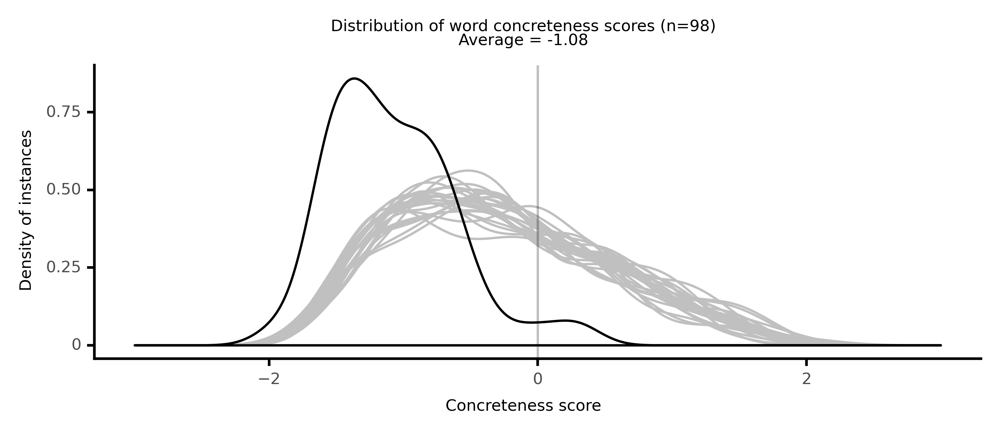

<ggplot: (8764109298949)>

 37%|███▋      | 37/100 [07:57<13:44, 13.09s/it]

#### #38 most abstract passage: Orrery, _Parthenissa, Part 2 (1655)_ (1655)

<p>to <abs><conc081>Nature</conc081></abs> as to Carthage; <abs><conc031>punish</conc031></abs> him for <neither><conc354>intending</conc354></neither> your <abs><conc225>destruction</conc225></abs>, in a place where not to have <neither><conc501>sacrificed</conc501></neither> himself for you, had been as great a <neither><conc383>Sinn</conc383></neither>. Yes( Sir) Punnish him for <abs><conc217>designing</conc217></abs> your <neither><conc267>death</conc267></neither>, and <abs><conc031>punish</conc031></abs> me in him not only for <abs><conc209>concealing</conc209></abs> but <neither><conc374>likewise</conc374></neither> for not <abs><conc196>revenging</conc196></abs> it, and let one <abs><conc187>execution</conc187></abs> <neither><conc594>repair</conc594></neither> both our Crymes; you see <abs><conc156>generous</conc156></abs> Hannibal, how I <abs><conc051>contemn</conc051></abs> my own interest when yours comes in <abs><conc114>competition</conc114></abs> with it, which I <abs><conc216>embrace</conc216></abs> with such a <abs><conc034>concern</conc034></abs> that I had rather <abs><conc232>extinguish</conc232></abs> my family, than <abs><conc168>continue</conc168></abs> it by <neither><conc632>leaving</conc632></neither> so great a <neither><conc556>stain</conc556></neither> upon your <abs><conc052>justice</conc052></abs>,& <abs><conc194>danger</conc194></abs> to your Person, as the <abs><conc082>saving</conc082></abs> of Perolla will amount unto. Besides Sir shall that <abs><conc199>Courage</conc199></abs>, which hitherto found nothing so <neither><conc242>easy</conc242></neither> as to <neither><conc286>conquer</conc286></neither>, leave the <neither><conc351>blemish</conc351></neither> behind it of having been <neither><conc405>vanquished</conc405></neither> by the <neither><conc674>Eyes</conc674></neither> only of one of your <neither><conc463>Enemyes</conc463></neither>? shall the Romans <abs><conc146>derive</conc146></abs> their <neither><conc420>Triumph</conc420></neither> from a <neither><conc619>Sex</conc619></neither> which never <abs><conc034>merited</conc034></abs> <abs><conc177>higher</conc177></abs> than your <neither><conc325>pity</conc325></neither>? shall such a <abs><conc216>pleasing</conc216></abs> <abs><conc076>desire</conc076></abs> as <abs><conc198>Revenge</conc198></abs>, and such a <abs><conc181>virtue</conc181></abs> as <abs><conc052>Justice</conc052></abs> be <abs><conc213>suppressed</conc213></abs> by an <abs><conc038>unworthy</conc038></abs> <abs><conc118>Passion</conc118></abs>, which Like <abs><conc177>madness</conc177></abs>, none believe they ever were <neither><conc276>possessed</conc276></neither> with when th're <neither><conc742>cured</conc742></neither> of it? let not( Sir) I <abs><conc150>beseech</conc150></abs> you the cause of your <abs><conc108>disorders</conc108></abs> be worse than the <abs><conc054>effects</conc054></abs>, but by a <abs><conc156>generous</conc156></abs> <neither><conc277>conquest</conc277></neither> over your self, show you are <abs><conc026>capable</conc026></abs> to <abs><conc206>vanquish</conc206></abs> all <abs><conc114>obstacles</conc114></abs>, and let your <neither><conc463>Enemyes</conc463></neither> in that very <abs><conc062>action</conc062></abs> which they <abs><conc192>esteemed</conc192></abs> would <abs><conc092>prove</conc092></abs> your <neither><conc291>shame</conc291></neither> find an <abs><conc038>Argument</conc038></abs> that you are <abs><conc113>invincible</conc113></abs>, for he that can <abs><conc214>overcome</conc214></abs> Hannibal, can not but be thought to do the Like to Rome, and all the World. The Carthaginian who knew no other cause of Pacuvius's <abs><conc066>hatred</conc066></abs> to his <neither><conc305>Son</conc305></neither> then what he had <abs><conc100>alleged</conc100></abs>, not only upon that account <abs><conc091>excused</conc091></abs> his <abs><conc118>Passion</conc118></abs>, and <abs><conc075>expressions</conc075></abs>, but replied, Had I not already given Perolla's life to the <conc><conc868>fair</conc868></conc> Izadora's <abs><conc047>commands</conc047></abs>, I now had <neither><conc305>bestowed</conc305></neither> it on Pacuvius's <abs><conc123>generosity</conc123></abs>,& find in what he <abs><conc090>alleges</conc090></abs> more cause to <abs><conc075>suppress</conc075></abs> than to <abs><conc116>create</conc116></abs> my <abs><conc198>Revenge</conc198></abs>; He that could <neither><conc244>sacrifice</conc244></neither> the <abs><conc110>Hope</conc110></abs>'s of his <abs><conc165>Posterity</conc165></abs> for my Interest, had too much <abs><conc199>misplaced</conc199></abs> his <abs><conc218>friendship</conc218></abs> if for a return to it I would not <abs><conc217>silence</conc217></abs> a <abs><conc198>Revenge</conc198></abs>, especially when the <abs><conc016>acting</conc016></abs> it will <abs><conc092>prove</conc092></abs> the <abs><conc225>destruction</conc225></abs> of so <abs><conc156>generous</conc156></abs> a Family, in which my <neither><conc386>misfortune</conc386></neither> is the only <abs><conc148>fault</conc148></abs> of any one of it; For Perolla wants not <abs><conc181>virtue</conc181></abs>, but I the <abs><conc080>felicity</conc080></abs> to <abs><conc030>merit</conc030></abs> it,& though( he <neither><conc297>continued</conc297></neither> with a <neither><conc698>smile</conc698></neither>) you <abs><conc131>upbraid</conc131></abs> me with being <neither><conc405>vanquished</conc405></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

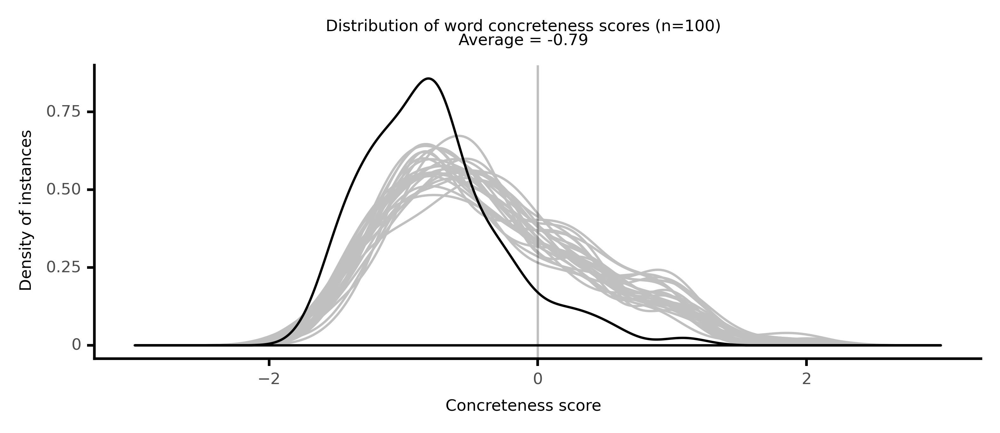

<ggplot: (8764097235369)>

 38%|███▊      | 38/100 [08:08<13:00, 12.59s/it]

#### #39 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>and <abs><conc077>immortality</conc077></abs>, if we have <abs><conc141>obeyed</conc141></abs> the <neither><conc283>calls</conc283></neither> of <neither><conc291>grace</conc291></neither> to <abs><conc076>virtue</conc076></abs> and <abs><conc052>holiness</conc052></abs>;-- or, be <abs><conc166>doomed</conc166></abs> to the most <neither><conc293>dreadful</conc293></neither> <abs><conc126>Misery</conc126></abs>'s, if we <abs><conc038>reject</conc038></abs> the <abs><conc071>counsel</conc071></abs> of God, and live quite <neither><conc297>thoughtless</conc297></neither> of the great <abs><conc087>concerns</conc087></abs> of <abs><conc134>eternity</conc134></abs>. These <abs><conc038>considerations</conc038></abs> made me <abs><conc219>prefer</conc219></abs> <abs><conc040>revealed</conc040></abs> <abs><conc043>religion</conc043></abs>, in the beginning of my <abs><conc003>rational</conc003></abs> life. The <abs><conc035>morality</conc035></abs> of the <neither><conc286>ancient</conc286></neither> <abs><conc123>philosophers</conc123></abs> I <neither><conc356>admired</conc356></neither>. With <neither><conc315>delight</conc315></neither> I <abs><conc217>studied</conc217></abs> their <abs><conc064>writings</conc064></abs>, and <neither><conc235>received</conc235></neither>, I <abs><conc221>gratefully</conc221></abs> <abs><conc116>confess</conc116></abs>, much <abs><conc138>improvement</conc138></abs> from them. But the <abs><conc043>religion</conc043></abs> of our <neither><conc300>blessed</conc300></neither> Lord I <abs><conc054>declared</conc054></abs> for, and look on the <abs><conc172>promised</conc172></abs> <abs><conc074>Messiah</conc074></abs> as the most <abs><conc092>consummate</conc092></abs> <abs><conc187>blessing</conc187></abs> God could <neither><conc238>bestow</conc238></neither>, or man <neither><conc238>receive</conc238></neither>. God having <neither><conc352>raised</conc352></neither> up his <abs><conc201>Son</conc201></abs> Jesus, sent him to <neither><conc325>bless</conc325></neither> you, in <neither><conc651>turning</conc651></neither> every one of you from your <abs><conc065>iniquities</conc065></abs>. And would men but hear and <abs><conc151>obey</conc151></abs> this life-giving <abs><conc136>Redeemer</conc136></abs>, his <abs><conc051>Gospel</conc051></abs> would <abs><conc191>restore</conc191></abs> <abs><conc031>reason</conc031></abs> and <abs><conc043>religion</conc043></abs> to their <abs><conc149>rightful</conc149></abs> <abs><conc008>authority</conc008></abs> over <abs><conc017>mankind</conc017></abs>; and make all <abs><conc076>virtue</conc076></abs>, and <abs><conc073>true</conc073></abs> <abs><conc093>goodness</conc093></abs>, <neither><conc398>flourish</conc398></neither> in the <neither><conc562>earth</conc562></neither>.[ Side note:1Kb] Of <abs><conc156>false</conc156></abs> <abs><conc043>religion</conc043></abs>. But I must <abs><conc180>observe</conc180></abs> that, by the <abs><conc043>religion</conc043></abs> of the New <abs><conc175>Testament</conc175></abs>, I do not mean any of those <neither><conc296>modern</conc296></neither> <abs><conc113>schemes</conc113></abs> of <abs><conc043>religion</conc043></abs>, which <neither><conc248>discover</conc248></neither> the <abs><conc043>evident</conc043></abs> <neither><conc357>marks</conc357></neither> and <abs><conc169>signatures</conc169></abs> of <abs><conc182>superstition</conc182></abs> and <abs><conc103>enthusiasm</conc103></abs>, or of <abs><conc158>knavery</conc158></abs> and <abs><conc121>imposture</conc121></abs>; those <abs><conc096>systems</conc096></abs> which even <abs><conc099>miracles</conc099></abs> can not <abs><conc087>prove</conc087></abs> to be <abs><conc073>true</conc073></abs>, because the pieties are <abs><conc036>absurd</conc036></abs>, <abs><conc009>inconsistent</conc009></abs> and <abs><conc004>contradictory</conc004></abs>. The <abs><conc053>notions</conc053></abs> that are not <abs><conc126>characterized</conc126></abs> by the <abs><conc031>reason</conc031></abs> of things, and the <abs><conc013>moral</conc013></abs> <abs><conc041>fitness</conc041></abs> of <abs><conc007>actions</conc007></abs>, I <abs><conc083>considered</conc083></abs> as <abs><conc002>repugnant</conc002></abs> to the <abs><conc063>veracity</conc063></abs>, <abs><conc033>wisdom</conc033></abs>, and <abs><conc093>goodness</conc093></abs> of the <abs><conc083>Almighty</conc083></abs>, and <neither><conc251>concluded</conc251></neither>, that that only could be <abs><conc044>christian</conc044></abs> <abs><conc043>religion</conc043></abs>, which beared the <abs><conc210>visible</conc210></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

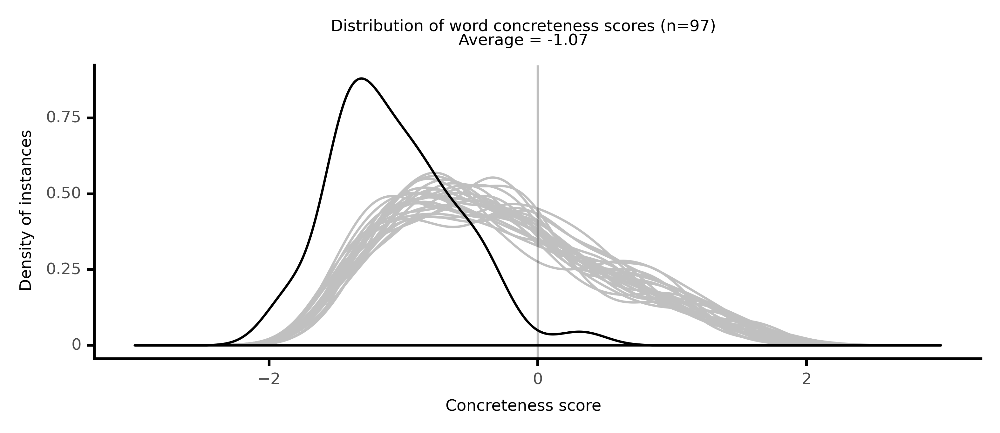

<ggplot: (8764098603705)>

 39%|███▉      | 39/100 [08:24<13:47, 13.56s/it]

#### #40 most abstract passage: Holcroft, _The Adventures of Hugh Trevor_ (1794)

<p>, he had <neither><conc372>eagerly</conc372></neither> <abs><conc165>cherished</conc165></abs> that <neither><conc421>quality</conc421></neither>; and, having given <abs><conc007>incontestable</conc007></abs> <abs><conc038>proofs</conc038></abs> that he <abs><conc159>possessed</conc159></abs> it in an <abs><conc132>eminent</conc132></abs> <abs><conc135>degree</conc135></abs>, to be afterwards <abs><conc154>overlooked</conc154></abs> was, in his <abs><conc016>judgement</conc016></abs>, too <abs><conc060>flagrant</conc060></abs> an <abs><conc130>instance</conc130></abs> of <abs><conc077>public</conc077></abs> as well as <abs><conc079>private</conc079></abs> <abs><conc098>ingratitude</conc098></abs> to be ever <abs><conc098>pardoned</conc098></abs>. It was the <neither><conc237>daily</conc237></neither> <abs><conc046>subject</conc046></abs> of his thoughts, and <neither><conc282>theme</conc282></neither> of his <abs><conc189>discourse</conc189></abs>; and I have great <abs><conc031>reason</conc031></abs> to <abs><conc219>conjecture</conc219></abs> that the <abs><conc023>habitual</conc023></abs> <abs><conc091>discontent</conc091></abs> that <neither><conc337>preyed</conc337></neither> upon his mind, and <abs><conc067>embittered</conc067></abs> his life, especially the latter part of it, <neither><conc242>communicated</conc242></neither> itself to me. I was <neither><conc324>educated</conc324></neither> in the <abs><conc012>belief</conc012></abs> that the world is <abs><conc214>blind</conc214></abs> to <abs><conc050>merit</conc050></abs>, <neither><conc284>continually</conc284></neither> <abs><conc167>suffers</conc167></abs> <abs><conc139>superior</conc139></abs> <abs><conc076>virtue</conc076></abs> to <neither><conc384>linger</conc384></neither> in <abs><conc164>indigence</conc164></abs> and <abs><conc057>neglect</conc057></abs>, and is therefore an <abs><conc106>odious</conc106></abs>, <abs><conc004>unjust</conc004></abs>, and <abs><conc140>despicable</conc140></abs> world.' I own I have at some few <neither><conc465>intervals</conc465></neither> <abs><conc111>doubted</conc111></abs> of this <abs><conc012>doctrine</conc012></abs>; and <abs><conc230>supposed</conc230></abs> in <abs><conc043>conformity</conc043></abs> to your <abs><conc033>opinion</conc033></abs>, Mr. <abs><conc081>Turl</conc081></abs>, that <abs><conc063>failure</conc063></abs> is rather the <abs><conc035>consequence</conc035></abs> of our own <abs><conc072>mistakes</conc072></abs>, <abs><conc210>impatience</conc210></abs>, and <abs><conc135>efforts</conc135></abs> <abs><conc214>ill</conc214></abs> <abs><conc201>directed</conc201></abs>, than of <abs><conc079>society</conc079></abs>: but the <abs><conc214>ill</conc214></abs> <abs><conc132>success</conc132></abs> of my own <abs><conc135>efforts</conc135></abs>, <abs><conc222>aided</conc222></abs> perhaps by the <abs><conc044>prejudices</conc044></abs> which I <neither><conc235>received</conc235></neither> from my father, have <abs><conc065>preponderated</conc065></abs>; and made me it may be too <neither><conc361>frequently</conc361></neither> <abs><conc145>incline</conc145></abs> to <neither><conc357>melancholy</conc357></neither>, and <neither><conc255>misanthropy</conc255></neither>. What can be said? Are not the <conc><conc770>rich</conc770></conc> and <abs><conc119>powerful</conc119></abs> <neither><conc284>continually</conc284></neither> <abs><conc066>oppressing</conc066></abs> <abs><conc079>talents</conc079></abs>, <abs><conc073>genius</conc073></abs>, and <abs><conc076>virtue</conc076></abs>? Is the <abs><conc090>general</conc090></abs> <abs><conc039>sense</conc039></abs> of <abs><conc017>mankind</conc017></abs> just in its <abs><conc004>decisions</conc004></abs>?'Beside, an <abs><conc016>appeal</conc016></abs> to the <abs><conc090>general</conc090></abs> <abs><conc039>sense</conc039></abs> of <abs><conc017>mankind</conc017></abs> is not always in our <abs><conc020>power</conc020></abs>; and that the <abs><conc036>proceedings</conc036></abs> of <abs><conc051>individuals</conc051></abs> are often <abs><conc004>flagrantly</conc004></abs> <abs><conc004>unjust</conc004></abs> can not be <abs><conc079>denied</conc079></abs>. In the <neither><conc408>school</conc408></neither> where I was <neither><conc324>educated</conc324></neither> I was a <neither><conc338>frequent</conc338></neither> and <abs><conc182>painful</conc182></abs> <abs><conc174>witness</conc174></abs> of <abs><conc197>honours</conc197></abs> <abs><conc149>partially</conc149></abs> <neither><conc243>bestowed</conc243></neither>; and <neither><conc456>prizes</conc456></neither> and <abs><conc119>applause</conc119></abs> <abs><conc109>awarded</conc109></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

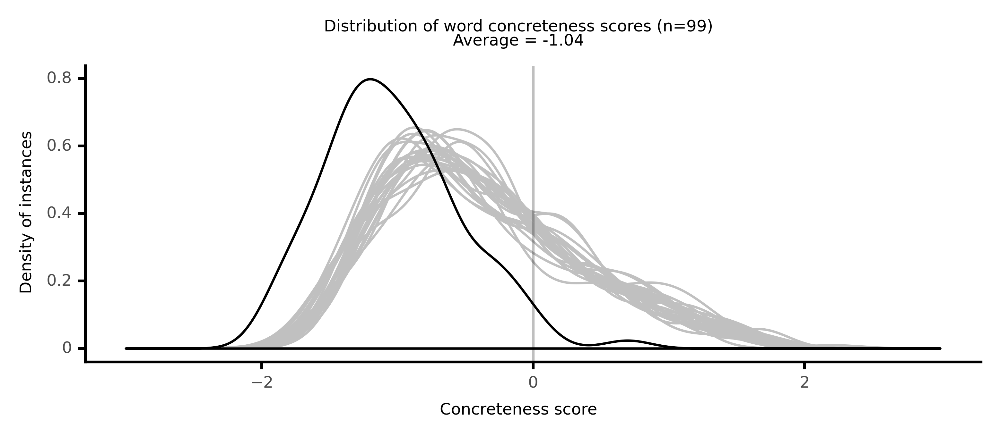

<ggplot: (8764108133809)>

 40%|████      | 40/100 [08:39<13:52, 13.88s/it]

#### #41 most abstract passage: Calprenede, _Cassandra_ (1642)

<p>. How <neither><conc410>cruel</conc410></neither> you are( said she) to <abs><conc048>persist</conc048></abs> in the <abs><conc143>design</conc143></abs> of <abs><conc166>afflicting</conc166></abs> me! and what an <abs><conc012>unjust</conc012></abs> <abs><conc196>violence</conc196></abs> you use upon me, in <abs><conc060>constraining</conc060></abs> me to <abs><conc177>complain</conc177></abs> of a Prince whose person I <abs><conc025>infinitely</conc025></abs> <abs><conc072>esteem</conc072></abs>, and whose <neither><conc251>compassion</conc251></neither> was most <abs><conc108>obliging</conc108></abs> to me, while it <neither><conc505>appeared</conc505></neither> to be without interest; that <abs><conc096>gift</conc096></abs> you make me of your self, would be a very <neither><conc259>considerable</conc259></neither> one to me, if I were in a <abs><conc128>condition</conc128></abs> to <abs><conc155>receive</conc155></abs> it, and you aught not to <abs><conc152>demand</conc152></abs> that of me by the <abs><conc019>consideration</conc019></abs> of your <abs><conc220>party</conc220></abs>, which your own alone might make you <abs><conc119>worthily</conc119></abs> to <abs><conc110>hope</conc110></abs> for from a <neither><conc389>heart</conc389></neither> less <abs><conc087>prepossessed</conc087></abs> then mine. <neither><conc288>Content</conc288></neither> your self, my Lord Demetrius, with this <abs><conc066>Declaration</conc066></abs>, and that I only <neither><conc250>style</conc250></neither> that in you an <abs><conc012>unjust</conc012></abs> <abs><conc045>perseverance</conc045></abs>, which from any other man but your self, I should <abs><conc155>receive</conc155></abs> as a <neither><conc410>cruel</conc410></neither> <abs><conc177>persecution</conc177></abs>; you have no needs of my <abs><conc073>favour</conc073></abs> to <abs><conc214>overcome</conc214></abs> your <neither><conc241>enemies</conc241></neither>, it would be <neither><conc447>fatal</conc447></neither> to you in the <neither><conc352>Combat</conc352></neither>, and <neither><conc334>Fortune</conc334></neither> my <neither><conc410>cruel</conc410></neither> <neither><conc372>enemy</conc372></neither> would <abs><conc019>undoubtedly</conc019></abs> make you <abs><conc221>perish</conc221></abs>, if you were <abs><conc088>owned</conc088></abs> by Deidamia. That <abs><conc124>glory</conc124></abs>( replied Demetrius) would be more <abs><conc180>advantageous</conc180></abs> to me then <neither><conc327>victory</conc327></neither>, and I account <neither><conc571>Agis</conc571></neither> more <abs><conc217>glorious</conc217></abs>, and more <neither><conc407>fortunate</conc407></neither> in his <neither><conc267>death</conc267></neither>, then he was in the whole course of his life; Alas!( <neither><conc297>continued</conc297></neither> he with a <neither><conc647>sighs</conc647></neither>) how much <abs><conc027>reason</conc027></abs> he ha to be <abs><conc135>pleased</conc135></abs> in the <neither><conc710>lower</conc710></neither> <conc><conc811>shades</conc811></conc> with that <abs><conc045>perseverance</conc045></abs> which <neither><conc360>perchance</conc360></neither> with more <abs><conc052>justice</conc052></abs> then you, I might call more <abs><conc012>unjust</conc012></abs> then mine, if I were not <abs><conc179>withheld</conc179></abs> by my <abs><conc015>respect</conc015></abs>, and by my <abs><conc011>submission</conc011></abs> to to all your thoughts,'this by that <neither><conc320>strange</conc320></neither> <abs><conc018>prepossession</conc018></abs> that my <neither><conc334>fortune</conc334></neither> is the more <abs><conc168>deplorable</conc168></abs>, and my <neither><conc458>destiny</conc458></neither> would be much more <abs><conc131>supportable</conc131></abs>; if that <abs><conc077>affection</conc077></abs> you <abs><conc018>oppose</conc018></abs> me with had a <abs><conc029>reasonable</conc029></abs> <neither><conc235>foundation</conc235></neither>, if it had a <abs><conc089>true</conc089></abs> and real <abs><conc040>Object</conc040></abs>, an <abs><conc040>Object</conc040></abs> that could take it up, and an <abs><conc040>Object</conc040></abs> that could make use of the <abs><conc055>advantages</conc055></abs> which are <neither><conc358>refused</conc358></neither> me. You <abs><conc177>complain</conc177></abs> <abs><conc115>unjustly</conc115></abs>, answered Deidamia, of a thing wherein you aught to find your <abs><conc218>consolation</conc218></abs>, and your <neither><conc334>fortune</conc334></neither>( if you <abs><conc182>confine</conc182></abs> it to the thoughts I have of you) would be a great deal worse then it is, if that <abs><conc121>precedency</conc121></abs> which I only give to what is now no more, were <abs><conc098>granted</conc098></abs> to <neither><conc306>living</conc306></neither> persons; you have at least this <abs><conc020>satisfaction</conc020></abs>, that there is no man in the World more <neither><conc274>favoured</conc274></neither>, nor more <abs><conc192>esteemed</conc192></abs> by me then Prince Demetrius; and you will yet have a more <abs><conc103>perfect</conc103></abs> one, when I shall tell you that there is none before whom I would not <abs><conc142>prefer</conc142></abs> you, if the Gods had left me in a <abs><conc128>condition</conc128></abs> to have still the <abs><conc067>liberty</conc067></abs> of making a <neither><conc312>choice</conc312></neither>, and of giving a <abs><conc147>precedence</conc147></abs>; the little <abs><conc024>power</conc024></abs> I have to deal more <abs><conc100>favourably</conc100></abs> with you, <abs><conc030>obliges</conc030></abs> me to make you this <abs><conc127>confession</conc127></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

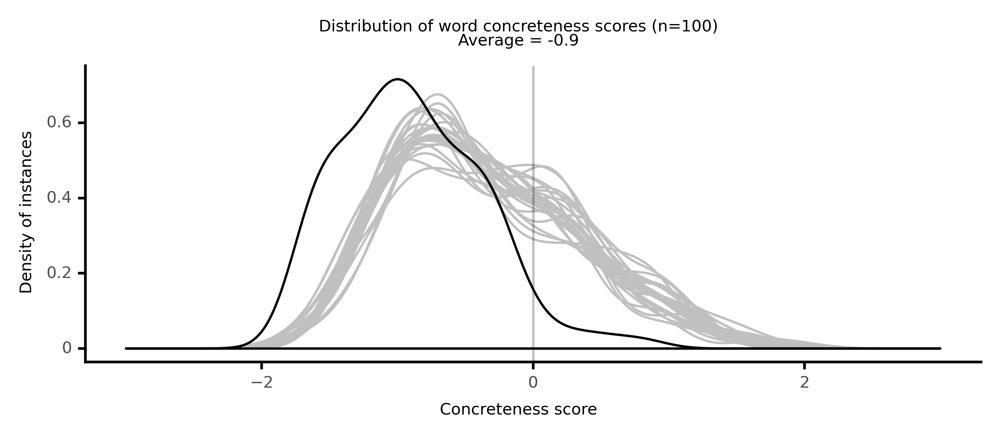

<ggplot: (8764095891257)>

 41%|████      | 41/100 [08:59<15:25, 15.69s/it]

#### #42 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>with the body: for, as <abs><conc097>perception</conc097></abs> and <abs><conc206>retention</conc206></abs> <abs><conc087>prove</conc087></abs> the <abs><conc115>human</conc115></abs> mind to be a <abs><conc211>distinct</conc211></abs> being, and that it has <abs><conc156>qualities</conc156></abs> which can not <abs><conc119>proceed</conc119></abs> from body, therefore it must still <abs><conc206>continue</conc206></abs> a <abs><conc032>Spirit</conc032></abs>, unless <abs><conc105>annihilated</conc105></abs> by its <abs><conc042>Creator</conc042></abs>, and must, after its <abs><conc173>separation</conc173></abs>, be <abs><conc174>endued</conc174></abs> with the <abs><conc156>qualities</conc156></abs> which are the <abs><conc061>faculties</conc061></abs> of <abs><conc194>soul</conc194></abs> only. The <abs><conc031>reason</conc031></abs> is <neither><conc447>plain</conc447></neither>. These <abs><conc156>qualities</conc156></abs> can not be <neither><conc338>destroyed</conc338></neither> without a cause, but <abs><conc173>separation</conc173></abs> is no cause, as the <neither><conc421>quality</conc421></neither> or <abs><conc156>qualities</conc156></abs> did not <abs><conc119>proceed</conc119></abs> from, or <abs><conc157>depend</conc157></abs> on <abs><conc188>union</conc188></abs>, therefore the <abs><conc194>soul</conc194></abs> is <abs><conc234>immortal</conc234></abs>, unless we <neither><conc251>suppose</conc251></neither> what can not be <abs><conc230>supposed</conc230></abs>, that its <abs><conc042>Creator</conc042></abs> <neither><conc448>puts</conc448></neither> an end to its being. We must know, after <abs><conc199>death</conc199></abs>, that we <abs><conc107>exist</conc107></abs>. We must <neither><conc299>remember</conc299></neither> a <neither><conc366>passed</conc366></neither> <abs><conc047>existence</conc047></abs>, and call to mind every <abs><conc117>idea</conc117></abs> we had <neither><conc429>formed</conc429></neither> in this life by <abs><conc083>reflection</conc083></abs>.[ Side note:1Kb] <abs><conc219>Continuation</conc219></abs> of Azora's <abs><conc189>discourse</conc189></abs>. As to our being <abs><conc007>accountable</conc007></abs> hereafter for the <abs><conc099>deeds</conc099></abs> we have done in this first state of <abs><conc047>existence</conc047></abs>, this can <abs><conc122>admit</conc122></abs> of no <abs><conc060>speculation</conc060></abs>; for as we have <neither><conc235>received</conc235></neither> from our <abs><conc042>Creator</conc042></abs> the <abs><conc102>eternal</conc102></abs> <abs><conc016>law</conc016></abs> of <abs><conc031>reason</conc031></abs>, which <abs><conc217>enables</conc217></abs> us to <abs><conc221>distinguish</conc221></abs> right and <abs><conc085>wrong</conc085></abs>, and to <abs><conc037>govern</conc037></abs> the <neither><conc243>inferior</conc243></neither> <abs><conc054>powers</conc054></abs> and <abs><conc175>passion</conc175></abs>, <abs><conc186>appetites</conc186></abs> and <neither><conc246>senses</conc246></neither>, if we please;-- as we are <abs><conc174>endued</conc174></abs> with an <abs><conc056>understanding</conc056></abs> which can <abs><conc158>acquire</conc158></abs> <conc><conc893>large</conc893></conc> <abs><conc013>moral</conc013></abs> <abs><conc107>dominion</conc107></abs>, and may, if we <abs><conc038>oppose</conc038></abs> not, <neither><conc593>sit</conc593></neither> as queen upon the <neither><conc280>throne</conc280></neither> over the whole <abs><conc091>corporeal</conc091></abs> system; since the <neither><conc291>noble</conc291></neither> <abs><conc085>faculty</conc085></abs> of <abs><conc031>reason</conc031></abs> was given to <abs><conc052>rectify</conc052></abs> the <abs><conc194>soul</conc194></abs>, and <abs><conc180>purify</conc180></abs> it from <abs><conc207>earthly</conc207></abs> <abs><conc140>affections</conc140></abs>; to <abs><conc185>elevate</conc185></abs> it above the <abs><conc163>objects</conc163></abs> of <abs><conc039>sense</conc039></abs>, to <neither><conc349>purge</conc349></neither> it from <neither><conc248>pride</conc248></neither> and <abs><conc139>vanity</conc139></abs>, <abs><conc041>selfishness</conc041></abs> and <abs><conc133>hypocrisy</conc133></abs>, and <abs><conc081>render</conc081></abs> it just, <abs><conc179>pious</conc179></abs> and good;-- of <abs><conc035>consequence</conc035></abs>, God has a right to call us to account for our <abs><conc010>conduct</conc010></abs> in this first state, and will <abs><conc106>reward</conc106></abs> or <abs><conc062>punish</conc062></abs>, in a most <abs><conc134>extraordinary</conc134></abs> manner; as the <abs><conc010>principles</conc010></abs> and <abs><conc007>actions</conc007></abs> of man have been <abs><conc053>righteous</conc053></abs>; or, his life and <abs><conc182>character</conc182></abs> <neither><conc598>stained</conc598></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

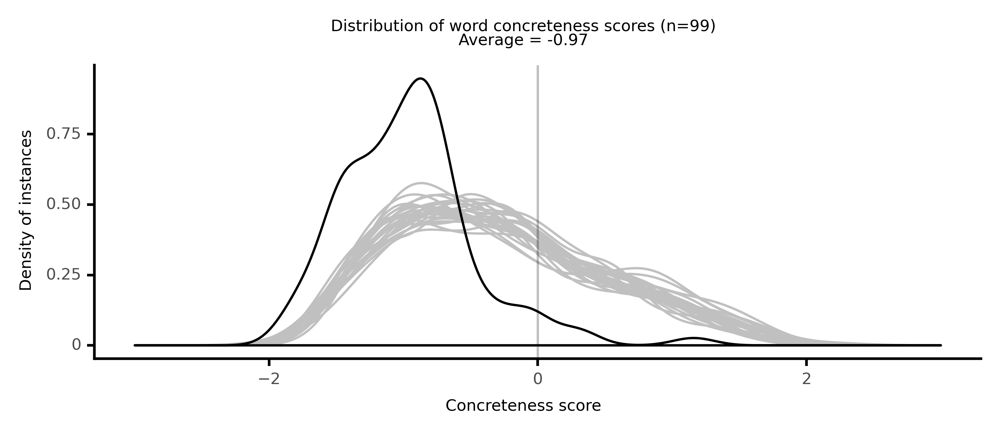

<ggplot: (8764179526797)>

 42%|████▏     | 42/100 [09:13<14:46, 15.28s/it]

#### #43 most abstract passage: Radcliffe, _The Italian, or the Confessional of the Black Peni_ (1797)

<p><abs><conc032>retaliation</conc032></abs>. In <abs><conc010>adopting</conc010></abs> a <abs><conc162>mode</conc162></abs> of <abs><conc040>punishment</conc040></abs> so <abs><conc134>extraordinary</conc134></abs> as that of <abs><conc168>imprisonment</conc168></abs> in the <neither><conc341>Inquisition</conc341></neither>, it <neither><conc283>appears</conc283></neither>, therefore, that Schedoni was <abs><conc014>influenced</conc014></abs>, <neither><conc373>partly</conc373></neither> by the <neither><conc244>difficulty</conc244></neither> of otherwise <abs><conc099>confining</conc099></abs> Vivaldi, during the perjod for which <neither><conc331>confinement</conc331></neither> was <abs><conc086>absolutely</conc086></abs> necessary to the <abs><conc132>success</conc132></abs> of his own <abs><conc113>schemes</conc113></abs>, and <neither><conc373>partly</conc373></neither> by a <abs><conc119>desire</conc119></abs> of <abs><conc033>inflicting</conc033></abs> the <neither><conc243>tortures</conc243></neither> of <abs><conc208>terror</conc208></abs>. He had also been <abs><conc067>encouraged</conc067></abs> by his <neither><conc274>discovery</conc274></neither> of this <neither><conc259>opportunity</conc259></neither> for <abs><conc073>conferring</conc073></abs> new <abs><conc042>obligations</conc042></abs> on the <abs><conc133>Marchesa</conc133></abs>. The very <abs><conc010>conduct</conc010></abs>, that must have <neither><conc340>appeared</conc340></neither> to the first <neither><conc509>glance</conc509></neither> of an <abs><conc184>honest</conc184></abs> mind <neither><conc299>fatal</conc299></neither> to his <abs><conc036>interests</conc036></abs>, he thought might be <abs><conc090>rendered</conc090></abs> <abs><conc091>beneficial</conc091></abs> to them, and that his <neither><conc351>dexterity</conc351></neither> could so <abs><conc178>command</conc178></abs> the <abs><conc224>business</conc224></abs>, as that the <abs><conc133>Marchesa</conc133></abs> should <abs><conc016>eventually</conc016></abs> thank him as the <abs><conc149>deliverer</conc149></abs> of her <abs><conc201>son</conc201></abs>, instead of <abs><conc231>discovering</conc231></abs> and <abs><conc200>execrating</conc200></abs> him as his <abs><conc148>Accuser</conc148></abs>; a <abs><conc131>scheme</conc131></abs> <abs><conc167>favoured</conc167></abs> by the <abs><conc004>unjust</conc004></abs> and <abs><conc202>cruel</conc202></abs> <abs><conc065>rule</conc065></abs> <neither><conc238>enacted</conc238></neither> by the <abs><conc156>tribunal</conc156></abs> he <neither><conc535>approached</conc535></neither>, which <abs><conc210>permitted</conc210></abs> <neither><conc260>anonymous</conc260></neither> <abs><conc133>Informers</conc133></abs>. To <neither><conc290>procure</conc290></neither> the <abs><conc158>arrestation</conc158></abs> of Vivaldi, it had been only necessary to <neither><conc501>send</conc501></neither> a <neither><conc243>written</conc243></neither> <abs><conc095>accusation</conc095></abs>, without a name, to the <abs><conc194>Holy</conc194></abs> <abs><conc107>Office</conc107></abs>, with a <neither><conc256>mention</conc256></neither> of the place where the <abs><conc126>accused</conc126></abs> person might be <neither><conc472>seized</conc472></neither>; but the <abs><conc092>suffering</conc092></abs> in <abs><conc035>consequence</conc035></abs> of this did not always <abs><conc119>proceed</conc119></abs> further than the <abs><conc103>question</conc103></abs>; since, if the <neither><conc324>Informer</conc324></neither> <abs><conc225>failed</conc225></abs> to <neither><conc248>discover</conc248></neither> himself to the <abs><conc102>Inquisitors</conc102></abs>, the <neither><conc321>prisoner</conc321></neither>, after many <abs><conc147>examinations</conc147></abs>, was <neither><conc292>released</conc292></neither>, unless he <neither><conc365>happened</conc365></neither> <abs><conc116>unwarily</conc116></abs> to <abs><conc007>criminate</conc007></abs> himself. Schedoni, as he did not <neither><conc353>intend</conc353></neither> to <abs><conc032>prosecute</conc032></abs>, <abs><conc143>believed</conc143></abs>, therefore, that Vivaldi would of course be <neither><conc352>discharged</conc352></neither> after a certain perjod, and supposing it also <abs><conc058>utterly</conc058></abs> <abs><conc133>impossible</conc133></abs> that he could ever <neither><conc248>discover</conc248></neither> his <abs><conc148>Accuser</conc148></abs>, the <neither><conc306>Confessor</conc306></neither> <abs><conc097>determined</conc097></abs> to appear <abs><conc190>anxious</conc190></abs> and <abs><conc124>active</conc124></abs> in <abs><conc135>effecting</conc135></abs> his <neither><conc256>release</conc256></neither>. This <abs><conc182>character</conc182></abs> of a <abs><conc149>deliverer</conc149></abs>, he knew he should be the better <abs><conc116>enabled</conc116></abs> to <abs><conc132>support</conc132></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

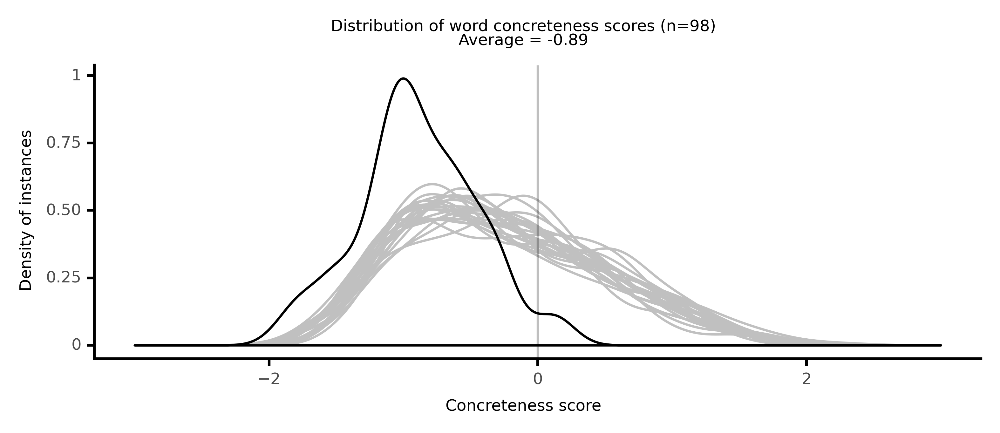

<ggplot: (8764171721805)>

 43%|████▎     | 43/100 [09:25<13:39, 14.38s/it]

#### #44 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>of God unto <abs><conc072>salvation</conc072></abs>, to every one that <abs><conc114>believeth</conc114></abs>, to the <neither><conc381>Jew</conc381></neither> first, and also to the Greek, for therein is the <abs><conc104>righteousness</conc104></abs> of God <abs><conc040>revealed</conc040></abs> from <abs><conc070>faith</conc070></abs> to <abs><conc070>faith</conc070></abs>. And that the <abs><conc156>promise</conc156></abs> of the <abs><conc194>Holy</conc194></abs> <neither><conc350>Ghost</conc350></neither> had <abs><conc063>reference</conc063></abs> not only to the great <neither><conc235>effusion</conc235></neither> of the <abs><conc032>Spirit</conc032></abs> at Pentecost, which was a <neither><conc311>solemn</conc311></neither> <abs><conc131>confirmation</conc131></abs> of the new and <abs><conc023>spiritual</conc023></abs> <abs><conc060>dispensation</conc060></abs> of the <abs><conc051>gospel</conc051></abs>; but also to that <abs><conc104>instruction</conc104></abs> which <abs><conc039>Christians</conc039></abs> of every <abs><conc229>age</conc229></abs> were to <neither><conc238>receive</conc238></neither> from it <neither><conc284>continually</conc284></neither>, if they <neither><conc322>attended</conc322></neither> to it, is <abs><conc043>evident</conc043></abs> from the <abs><conc156>promise</conc156></abs> of Christ,-- I will <neither><conc608>prey</conc608></neither> the Father, and he shall give you another <abs><conc156>comforter</conc156></abs>,( the <abs><conc032>spirit</conc032></abs> of <abs><conc065>truth</conc065></abs>) that he may <abs><conc232>abide</conc232></abs> with you for ever. This <abs><conc032>spirit</conc032></abs> was to <neither><conc370>supply</conc370></neither> the place of his <abs><conc003>personal</conc003></abs> <abs><conc176>presence</conc176></abs>. It was to become a <abs><conc087>teacher</conc087></abs> and <abs><conc156>comforter</conc156></abs> to his <abs><conc080>disciples</conc080></abs> and <abs><conc026>followers</conc026></abs> to the end of time------ to <abs><conc077>enlighten</conc077></abs> and <abs><conc145>incline</conc145></abs> their <abs><conc062>minds</conc062></abs> to <abs><conc099>piety</conc099></abs> and <abs><conc076>virtue</conc076></abs>------ to <abs><conc152>enable</conc152></abs> them to do all things <neither><conc343>appertaining</conc343></neither> to life and <abs><conc052>godliness</conc052></abs>, and to have a <abs><conc070>faith</conc070></abs> in God's <abs><conc020>power</conc020></abs> and all-sufficiency. This is the <abs><conc153>glorious</conc153></abs> <neither><conc525>specific</conc525></neither> <abs><conc204>difference</conc204></abs> of <abs><conc033>Christianity</conc033></abs> from all other <abs><conc125>religions</conc125></abs>. We have an inward <abs><conc113>instructor</conc113></abs> and <abs><conc219>supporter</conc219></abs> always <abs><conc019>abiding</conc019></abs> with us. And what can be a <neither><conc348>higher</conc348></neither> honour to <abs><conc017>mankind</conc017></abs>, or an act of <abs><conc211>greater</conc211></abs> love in God, than for him to <abs><conc025>interpose</conc025></abs> <neither><conc284>continually</conc284></neither>, and by his <abs><conc194>holy</conc194></abs> <abs><conc032>Spirit</conc032></abs> <abs><conc191>restore</conc191></abs> the <abs><conc073>teachable</conc073></abs> and <abs><conc225>attentive</conc225></abs> to that <abs><conc155>purity</conc155></abs> and <abs><conc001>uprightness</conc001></abs> in which he at first <abs><conc082>created</conc082></abs> man? <abs><conc153>Glorious</conc153></abs> <abs><conc060>dispensation</conc060></abs>! Here is a <neither><conc260>complete</conc260></neither> <neither><conc254>reparation</conc254></neither> of the <neither><conc241>loss</conc241></neither> <abs><conc221>sustained</conc221></abs> by <abs><conc024>transgression</conc024></abs>. We are <abs><conc082>created</conc082></abs> <neither><conc281>anew</conc281></neither> in Christ Jesus, and are made <abs><conc117>partakers</conc117></abs> of the <abs><conc054>divine</conc054></abs> <abs><conc083>nature</conc083></abs>. Surely this is the utmost that can be <abs><conc129>expected</conc129></abs> from <abs><conc043>religion</conc043></abs>. In <neither><conc410>short</conc410></neither>,( <neither><conc270>continued</conc270></neither> Mrs. <neither><conc428>Price</conc428></neither>) it is to me a most <neither><conc359>amazing</conc359></neither> thing, to see men of <abs><conc039>sense</conc039></abs> <abs><conc021>disclaim</conc021></abs> this help, <abs><conc033>argue</conc033></abs> for <abs><conc057>self-sufficiency</conc057></abs> and <abs><conc051>independency</conc051></abs>, and <neither><conc238>receive</conc238></neither> only the <neither><conc423>outward</conc423></neither> <neither><conc430>appearance</conc430></neither> of the <abs><conc201>Son</conc201></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

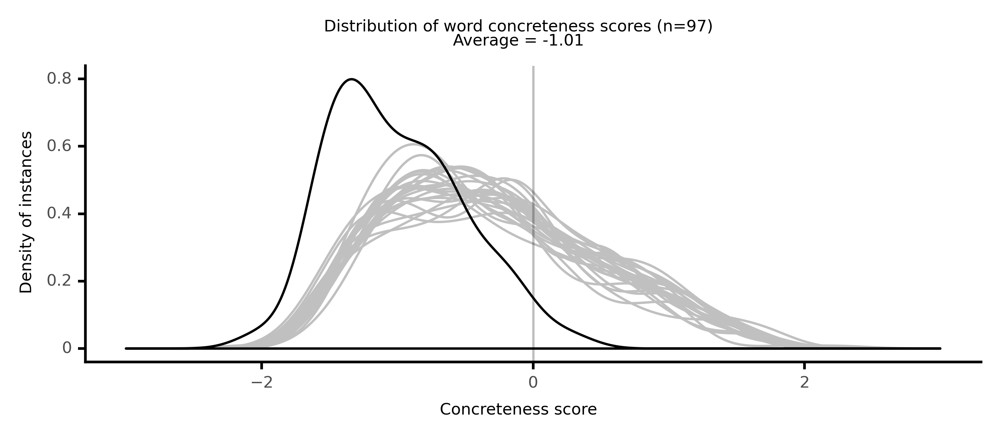

<ggplot: (8764111997369)>

 44%|████▍     | 44/100 [09:39<13:16, 14.22s/it]

#### #45 most abstract passage: Hall, _Something for Every Body: Gleaned in the Old Purch_ (1846)

<p>that shall <abs><conc182>tend</conc182></abs> to make one <abs><conc206>phase</conc206></abs> of <abs><conc036>morality</conc036></abs> <abs><conc164>superior</conc164></abs> to the whole of <abs><conc036>morality</conc036></abs>, much less to the <abs><conc071>gospel</conc071></abs>. He will not, he <neither><conc316>dares</conc316></neither> not, allow that all <abs><conc251>sacred</conc251></abs> and <abs><conc229>time-honored</conc229></abs> <abs><conc112>usages</conc112></abs> shall become merely <abs><conc020>subservient</conc020></abs> to this <abs><conc082>incidental</conc082></abs> and <abs><conc180>temporary</conc180></abs> <abs><conc137>institution</conc137></abs>. For this is a <abs><conc180>temporary</conc180></abs> <abs><conc137>institution</conc137></abs> that must of <abs><conc025>necessity</conc025></abs> end with the <abs><conc061>attainment</conc061></abs> of its <abs><conc162>object</conc162></abs>: but the others are <abs><conc261>designed</conc261></abs> to be <abs><conc170>coeval</conc170></abs> with the life of man, and will <neither><conc321>remain</conc321></neither> till the <abs><conc133>dissolution</conc133></abs> of the world. A good man must regard the cause of <neither><conc322>temperance</conc322></neither> as one of <neither><conc264>solemnity</conc264></neither>; hence he can but <abs><conc081>oppose</conc081></abs> all <abs><conc178>frivolity</conc178></abs> and <abs><conc117>levity</conc117></abs> in all that <abs><conc146>aim</conc146></abs> to <abs><conc098>promote</conc098></abs> it, as <abs><conc011>inconsistent</conc011></abs>, and, indeed, as <abs><conc000>subversive</conc000></abs> of the cause. But, Robert, is there no <neither><conc322>temperance</conc322></neither>, <abs><conc256>save</conc256></abs> in a <neither><conc322>temperance</conc322></neither> <abs><conc147>society</conc147></abs>? May a good man never be <abs><conc123>exemplary</conc123></abs> in the <abs><conc114>strict</conc114></abs> <abs><conc145>abstinence</conc145></abs> <abs><conc238>required</conc238></abs> by a <abs><conc216>pledge</conc216></abs>, and yet for <abs><conc100>reasons</conc100></abs> <abs><conc041>withhold</conc041></abs> or even <neither><conc277>withdraw</conc277></neither> his name from a <abs><conc147>society</conc147></abs>? And are there no good <abs><conc100>reasons</conc100></abs> for this course? but must a man of <abs><conc025>necessity</conc025></abs> be a winebibber,-- according to the <neither><conc481>silly</conc481></neither> and <neither><conc280>malicious</conc280></neither> <abs><conc123>insinuations</conc123></abs> <abs><conc080>ultra</conc080></abs> <abs><conc050>advocates</conc050></abs> for <abs><conc242>societies</conc242></abs> make respecting him? <abs><conc124>Granted</conc124></abs>, all other things being <neither><conc285>equal</conc285></neither>, that it may be <abs><conc051>obligatory</conc051></abs> or <neither><conc321>advisable</conc321></neither> to <abs><conc199>increase</conc199></abs> <abs><conc181>strength</conc181></abs> by <abs><conc197>union</conc197></abs>; yet when other things are not <neither><conc285>equal</conc285></neither>, we may <neither><conc366>fight</conc366></neither> in this <abs><conc135>war</conc135></abs> at our own <abs><conc198>charges</conc198></abs>-- and certainly we may do good <abs><conc170>service</conc170></abs> as <abs><conc099>partisans</conc099></abs>. Now, Robert, at Somewhersburg, is a state of <abs><conc124>affairs</conc124></abs> <abs><conc172>rendering</conc172></abs> it <abs><conc232>proper</conc232></abs> and necessary for the <abs><conc118>clergy</conc118></abs> to <neither><conc277>withdraw</conc277></neither>-- not from <neither><conc322>temperance</conc322></neither>, but from our <abs><conc142>local</conc142></abs> <neither><conc322>temperance</conc322></neither> <abs><conc147>society</conc147></abs>. And, first, Robert, the <abs><conc243>tone</conc243></abs> <abs><conc120>assumed</conc120></abs> by our <abs><conc147>society</conc147></abs> in their <abs><conc049>public</conc049></abs> <neither><conc304>lectures</conc304></neither>, and <neither><conc448>papers</conc448></neither>, and even <neither><conc314>daily</conc314></neither> <neither><conc391>conversation</conc391></neither>, is <abs><conc163>vituperative</conc163></abs> and <abs><conc177>offensive</conc177></abs>. This we <neither><conc407>decidedly</conc407></neither> <abs><conc162>object</conc162></abs> to; because it is <abs><conc217>vulgar</conc217></abs> and <neither><conc286>canting</conc286></neither>; shows <abs><conc073>profound</conc073></abs> <abs><conc021>ignorance</conc021></abs> of all <neither><conc322>courtesy</conc322></neither>; is <abs><conc057>vindictive</conc057></abs> and <neither><conc343>provoking</conc343></neither>; and <abs><conc085>wholly</conc085></abs> different from the <neither><conc373>style</conc373></neither> of <abs><conc069>rebuke</conc069></abs> <abs><conc147>authorized</conc147></abs> by the <neither><conc312>Bible</conc312></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

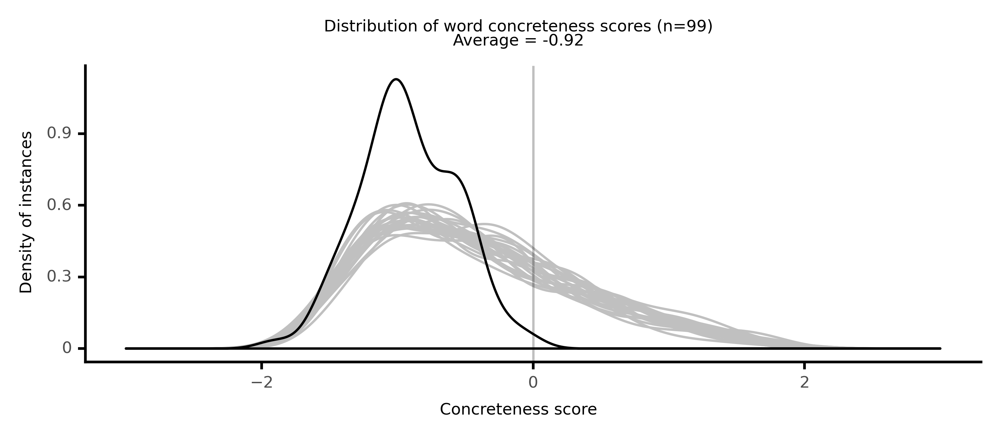

<ggplot: (8764120652333)>

 45%|████▌     | 45/100 [09:49<11:56, 13.03s/it]

#### #46 most abstract passage: Stowe, _Dred: A Tale of the Great Dismal Swamp (1856) [Vol_ (1856)

<p>of the church.2. That it is the <abs><conc127>duty</conc127></abs> of every one, and especially of every <abs><conc057>Christian</conc057></abs>, who may be <abs><conc028>involved</conc028></abs> in this <abs><conc081>sin</conc081></abs>, to free himself from its <neither><conc407>entanglement</conc407></neither> without delay.3. That it is the <abs><conc127>duty</conc127></abs> of every one, especially of every <abs><conc057>Christian</conc057></abs>, in the <abs><conc162>meekness</conc162></abs> and <abs><conc141>firmness</conc141></abs> of the <abs><conc071>Gospel</conc071></abs>, to <abs><conc146>plead</conc146></abs> the cause of the <neither><conc439>poor</conc439></neither> and <neither><conc314>needy</conc314></neither>, by <abs><conc054>testifying</conc054></abs> against the <abs><conc033>principle</conc033></abs> and <abs><conc086>practice</conc086></abs> of <abs><conc096>slaveholding</conc096></abs>, and to use his best <abs><conc094>endeavors</conc094></abs> to <neither><conc310>deliver</conc310></neither> the <neither><conc309>church</conc309></neither> of God from the <abs><conc031>evil</conc031></abs>, and to bring about the <abs><conc084>emancipation</conc084></abs> of the <neither><conc318>slaves</conc318></neither> in these <abs><conc219>United</conc219></abs> <abs><conc233>States</conc233></abs>, and throughout the world.'' The <abs><conc096>slaveholding</conc096></abs> <neither><conc380>delegates</conc380></neither>, to the <neither><conc413>number</conc413></neither> of forty-eight, <neither><conc367>met</conc367></neither> apart, and <abs><conc236>Resolved</conc236></abs>, That if the <abs><conc129>General</conc129></abs> <abs><conc203>Assembly</conc203></abs> shall <abs><conc140>undertake</conc140></abs> to <abs><conc097>exercise</conc097></abs> <abs><conc017>authority</conc017></abs> on the <abs><conc047>subject</conc047></abs> of <abs><conc125>slavery</conc125></abs>, so as to make it an <abs><conc019>immorality</conc019></abs>, or shall in any way <abs><conc102>declare</conc102></abs> that <abs><conc084>Christians</conc084></abs> are <abs><conc086>criminal</conc086></abs> in <neither><conc550>holding</conc550></neither> <neither><conc318>slaves</conc318></neither>, that a <abs><conc120>declaration</conc120></abs> shall be <neither><conc275>presented</conc275></neither> by the <neither><conc360>Southern</conc360></neither> <neither><conc368>delegation</conc368></neither> <neither><conc298>declining</conc298></neither> their <abs><conc233>jurisdiction</conc233></abs> in the case, and our <abs><conc088>determination</conc088></abs> not to <abs><conc062>submit</conc062></abs> to such <abs><conc112>decision</conc112></abs>.'' In <abs><conc137>view</conc137></abs> of these <abs><conc092>conflicting</conc092></abs> <abs><conc212>reports</conc212></abs>, the <abs><conc203>Assembly</conc203></abs> <abs><conc236>resolved</conc236></abs> as follows: Inasmuch as the <abs><conc130>constitution</conc130></abs> of the <neither><conc352>Presbyterian</conc352></neither> <neither><conc309>church</conc309></neither>, in its <neither><conc274>preliminary</conc274></neither> and <abs><conc054>fundamental</conc054></abs> <abs><conc016>principles</conc016></abs>, <abs><conc095>declares</conc095></abs> that no <neither><conc309>church</conc309></neither> <abs><conc034>judicatories</conc034></abs> aught to <abs><conc160>pretend</conc160></abs> to make <abs><conc048>laws</conc048></abs> to <neither><conc398>bind</conc398></neither> the <abs><conc026>conscience</conc026></abs> in <abs><conc041>virtue</conc041></abs> of their own <abs><conc017>authority</conc017></abs>; and as the <abs><conc041>urgency</conc041></abs> of the <abs><conc206>business</conc206></abs> of the <abs><conc203>Assembly</conc203></abs>, and the <neither><conc331>shortness</conc331></neither> of the time during which they can <abs><conc156>continue</conc156></abs> in <neither><conc312>session</conc312></neither>, <abs><conc106>render</conc106></abs> it <abs><conc154>impossible</conc154></abs> to <abs><conc095>deliberate</conc095></abs> and <abs><conc219>decide</conc219></abs> <neither><conc334>judiciously</conc334></neither> on the <abs><conc047>subject</conc047></abs> of <abs><conc125>slavery</conc125></abs> in its <abs><conc086>relation</conc086></abs> to the <neither><conc309>church</conc309></neither>, therefore, <abs><conc236>Resolved</conc236></abs>, that this whole <abs><conc047>subject</conc047></abs> be <abs><conc191>indefinitely</conc191></abs> <abs><conc230>postponed</conc230></abs>.'' The amount of the <abs><conc150>slave-trade</conc150></abs> at the time when the <abs><conc129>General</conc129></abs> <abs><conc203>Assembly</conc203></abs> <neither><conc285>refused</conc285></neither> to act upon the <abs><conc047>subject</conc047></abs> of <abs><conc125>slavery</conc125></abs> at all may be <abs><conc189>inferred</conc189></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

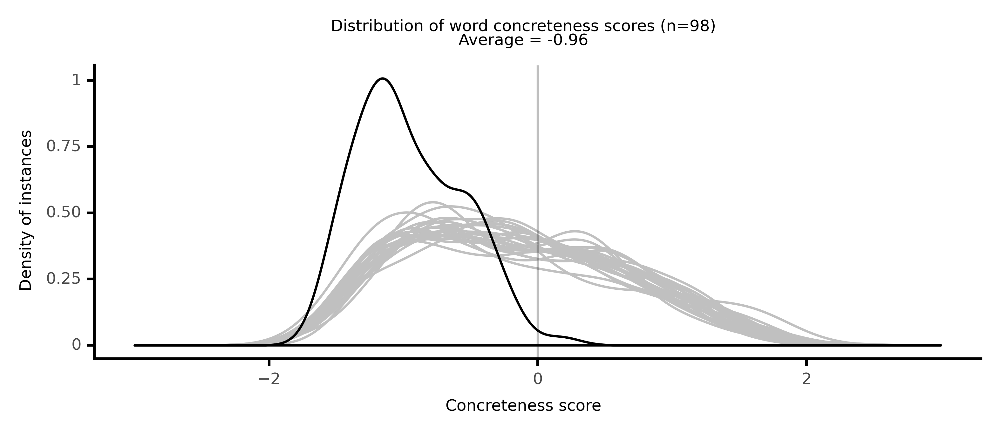

<ggplot: (8764120646569)>

 46%|████▌     | 46/100 [10:01<11:15, 12.51s/it]

#### #47 most abstract passage: Tolstoy, _War and Peace_ (1867)

<p>it may be, it is so, for without this <abs><conc072>conception</conc072></abs> of <abs><conc032>freedom</conc032></abs> not only would he be <abs><conc242>unable</conc242></abs> to <abs><conc141>understand</conc141></abs> life, but he would be <abs><conc242>unable</conc242></abs> to live for a <neither><conc448>single</conc448></neither> moment. He could not live, because all man's <abs><conc092>efforts</conc092></abs>, all his <abs><conc103>impulses</conc103></abs> to life, are only <abs><conc092>efforts</conc092></abs> to <abs><conc199>increase</conc199></abs> <abs><conc032>freedom</conc032></abs>. <abs><conc225>Wealth</conc225></abs> and <abs><conc204>poverty</conc204></abs>, <abs><conc179>fame</conc179></abs> and <abs><conc219>obscurity</conc219></abs>, <abs><conc028>power</conc028></abs> and <abs><conc044>subordination</conc044></abs>, <abs><conc181>strength</conc181></abs> and <abs><conc077>weakness</conc077></abs>, <neither><conc321>health</conc321></neither> and <neither><conc276>disease</conc276></neither>, <neither><conc268>culture</conc268></neither> and <abs><conc021>ignorance</conc021></abs>, work and <neither><conc328>leisure</conc328></neither>, <neither><conc559>repletion</conc559></neither> and <neither><conc404>hunger</conc404></neither>, <abs><conc041>virtue</conc041></abs> and <abs><conc141>vice</conc141></abs>, are only <abs><conc195>greater</conc195></abs> or <neither><conc302>lesser</conc302></neither> <neither><conc390>degrees</conc390></neither> of <abs><conc032>freedom</conc032></abs>. A man having no <abs><conc032>freedom</conc032></abs> can not be <abs><conc138>conceived</conc138></abs> of except as <abs><conc169>deprived</conc169></abs> of life. If the <abs><conc072>conception</conc072></abs> of <abs><conc032>freedom</conc032></abs> <abs><conc217>appears</conc217></abs> to <abs><conc020>reason</conc020></abs> to be a <neither><conc456>senseless</conc456></neither> <abs><conc010>contradiction</conc010></abs> Like the <abs><conc103>possibility</conc103></abs> of <neither><conc339>performing</conc339></neither> two <abs><conc010>actions</conc010></abs> at one and the same <neither><conc557>instant</conc557></neither> of time, or of an effect without a cause, that only <abs><conc080>proves</conc080></abs> that <abs><conc093>consciousness</conc093></abs> is not <abs><conc047>subject</conc047></abs> to <abs><conc020>reason</conc020></abs>. This <abs><conc063>unshakable</conc063></abs>, <abs><conc016>irrefutable</conc016></abs> <abs><conc093>consciousness</conc093></abs> of <abs><conc032>freedom</conc032></abs>, <abs><conc076>uncontrolled</conc076></abs> by <neither><conc309>experiment</conc309></neither> or <abs><conc047>argument</conc047></abs>, <abs><conc213>recognized</conc213></abs> by all <abs><conc057>thinkers</conc057></abs> and felt by everyone without <neither><conc336>exception</conc336></neither>, this <abs><conc093>consciousness</conc093></abs> without which no <abs><conc072>conception</conc072></abs> of man is possible <abs><conc188>constitutes</conc188></abs> the other side of the <abs><conc153>question</conc153></abs>. Man is the <abs><conc114>creation</conc114></abs> of an <abs><conc020>all-powerful</conc020></abs>, allgood, and <abs><conc161>all-seeing</conc161></abs> God. What is <abs><conc081>sin</conc081></abs>, the <abs><conc072>conception</conc072></abs> of which <abs><conc172>arises</conc172></abs> from the <abs><conc093>consciousness</conc093></abs> of man's <abs><conc032>freedom</conc032></abs>? That is a <abs><conc153>question</conc153></abs> for <abs><conc088>theology</conc088></abs>. The <abs><conc010>actions</conc010></abs> of men are <abs><conc047>subject</conc047></abs> to <abs><conc129>general</conc129></abs> <abs><conc024>immutable</conc024></abs> <abs><conc048>laws</conc048></abs> <abs><conc076>expressed</conc076></abs> in <neither><conc271>statistics</conc271></neither>. What is man's <abs><conc059>responsibility</conc059></abs> to <abs><conc147>society</conc147></abs>, the <abs><conc072>conception</conc072></abs> of which results from the <abs><conc072>conception</conc072></abs> of <abs><conc032>freedom</conc032></abs>? That is a <abs><conc153>question</conc153></abs> for <abs><conc116>jurisprudence</conc116></abs>. Man's <abs><conc010>actions</conc010></abs> <abs><conc207>proceed</conc207></abs> from his <abs><conc035>innate</conc035></abs> <abs><conc025>character</conc025></abs> and the <abs><conc014>motives</conc014></abs> <abs><conc168>acting</conc168></abs> upon him. What is <abs><conc026>conscience</conc026></abs> and the <abs><conc123>perception</conc123></abs> of right and <abs><conc094>wrong</conc094></abs> in <abs><conc010>actions</conc010></abs> that follows from the <abs><conc093>consciousness</conc093></abs> of <abs><conc032>freedom</conc032></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

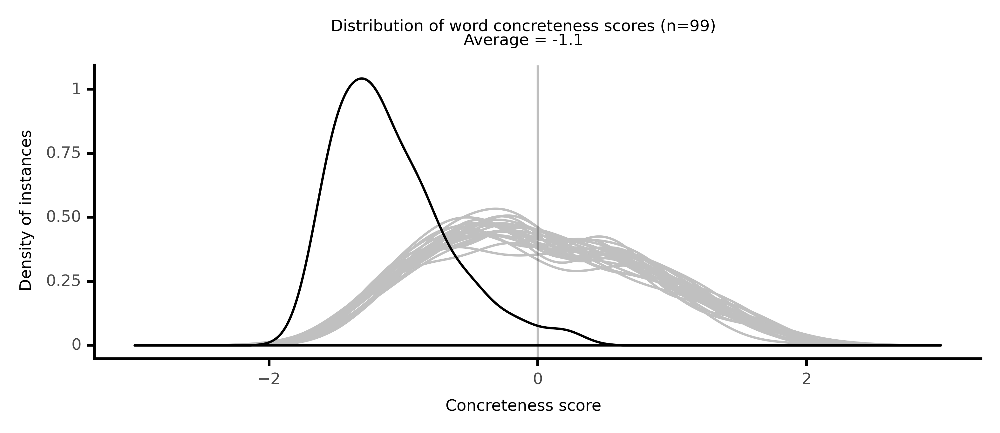

<ggplot: (8764117459097)>

 47%|████▋     | 47/100 [10:20<12:57, 14.66s/it]

#### #48 most abstract passage: Stowe, _Dred: A Tale of the Great Dismal Swamp (1856) [Vol_ (1856)

<p>being <abs><conc181>supposed</conc181></abs> to be <neither><conc272>imperfectly</conc272></neither> <neither><conc273>developed</conc273></neither>, his good will, on the whole, be better <neither><conc262>consulted</conc262></neither> by <neither><conc364>allowing</conc364></neither> to his <abs><conc190>lawful</conc190></abs> guardian this <abs><conc028>power</conc028></abs>.'' The good of the <abs><conc047>subject</conc047></abs>,'' he said, is <abs><conc118>understood</conc118></abs> to be the <abs><conc250>foundation</conc250></abs> of the right; but, when <abs><conc084>chastisement</conc084></abs> is <abs><conc183>inflicted</conc183></abs> without just cause, and in a manner so <abs><conc054>inconsiderate</conc054></abs> and <abs><conc231>brutal</conc231></abs> as to <abs><conc095>endanger</conc095></abs> the <abs><conc252>safety</conc252></abs> and <abs><conc084>well-being</conc084></abs> of the <abs><conc047>subject</conc047></abs>, the great <abs><conc250>foundation</conc250></abs> <abs><conc033>principle</conc033></abs> of the <abs><conc022>law</conc022></abs> is <abs><conc089>violated</conc089></abs>. The act becomes <neither><conc389>perfectly</conc389></neither> <abs><conc122>lawless</conc122></abs>, and as <abs><conc056>incapable</conc056></abs> of <abs><conc107>legal</conc107></abs> <abs><conc167>defence</conc167></abs> as it is <abs><conc038>abhorrent</conc038></abs> to every <abs><conc050>sentiment</conc050></abs> of <abs><conc042>humanity</conc042></abs> and <abs><conc027>justice</conc027></abs>.'' He should <abs><conc157>endeavour</conc157></abs> to show,'' he said, by full <abs><conc082>testimony</conc082></abs>, that the case in <abs><conc153>question</conc153></abs> was one of this sort.'' In <neither><conc589>examining</conc589></neither> <abs><conc244>witnesses</conc244></abs> Clayton showed great <abs><conc163>dignity</conc163></abs> and <abs><conc034>acuteness</conc034></abs>, and as the <abs><conc062>feeling</conc062></abs> of the <neither><conc279>court</conc279></neither> was already <abs><conc062>prepossessed</conc062></abs> in his <abs><conc142>favour</conc142></abs>, the cause <neither><conc338>evidently</conc338></neither> <neither><conc629>gathered</conc629></neither> <abs><conc181>strength</conc181></abs> as it went on. The <abs><conc082>testimony</conc082></abs> showed, in the most <abs><conc062>conclusive</conc062></abs> manner, the <abs><conc129>general</conc129></abs> <abs><conc148>excellence</conc148></abs> of Milly's <abs><conc025>character</conc025></abs>, and the <abs><conc080>utter</conc080></abs> <abs><conc121>brutality</conc121></abs> of the <abs><conc162>outrage</conc162></abs> which had been <abs><conc138>committed</conc138></abs> upon her. In his <abs><conc225>concluding</conc225></abs> <abs><conc216>remarks</conc216></abs>, Clayton <neither><conc300>addressed</conc300></neither> the <neither><conc283>jury</conc283></neither> in a <abs><conc243>tone</conc243></abs> of great <abs><conc258>elevation</conc258></abs> and <neither><conc264>solemnity</conc264></neither>, on the <abs><conc127>duty</conc127></abs> of those to whom is <abs><conc244>entrusted</conc244></abs> the <neither><conc270>guardianship</conc270></neither> of the <neither><conc517>helpless</conc517></neither>. No <abs><conc064>obligation</conc064></abs>,'' he said, can be <neither><conc269>stronger</conc269></neither> to an <abs><conc129>honourable</conc129></abs> mind, than the <abs><conc064>obligation</conc064></abs> of <abs><conc232>entire</conc232></abs> <abs><conc126>dependence</conc126></abs>. The <abs><conc067>fact</conc067></abs> that a <abs><conc115>human</conc115></abs> being has no <neither><conc412>refuge</conc412></neither> from our <abs><conc028>power</conc028></abs>, no <abs><conc069>appeal</conc069></abs> from our <abs><conc044>decisions</conc044></abs>, so far from <neither><conc299>leading</conc299></neither> to <neither><conc374>careless</conc374></neither> <abs><conc145>security</conc145></abs>, is one of the <abs><conc191>strongest</conc191></abs> possible <abs><conc014>motives</conc014></abs> to <abs><conc212>caution</conc212></abs>, and to most <abs><conc226>exact</conc226></abs> <neither><conc398>care</conc398></neither>. The African <neither><conc405>raze</conc405></neither>,'' he said, had been <abs><conc231>bitter</conc231></abs> <neither><conc302>sufferers</conc302></neither>. Their <abs><conc108>history</conc108></abs> had been one of <abs><conc094>wrong</conc094></abs> and <abs><conc140>cruelty</conc140></abs>, <abs><conc205>painful</conc205></abs> to every <abs><conc129>honourable</conc129></abs> mind. We of the present day, who <abs><conc111>sustain</conc111></abs> the <abs><conc086>relation</conc086></abs> of <abs><conc078>slaveholder</conc078></abs>,'' he said, <abs><conc261>receive</conc261></abs> from the <neither><conc473>hands</conc473></neither> of our father's an <neither><conc358>awful</conc358></neither> <abs><conc075>trust</conc075></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

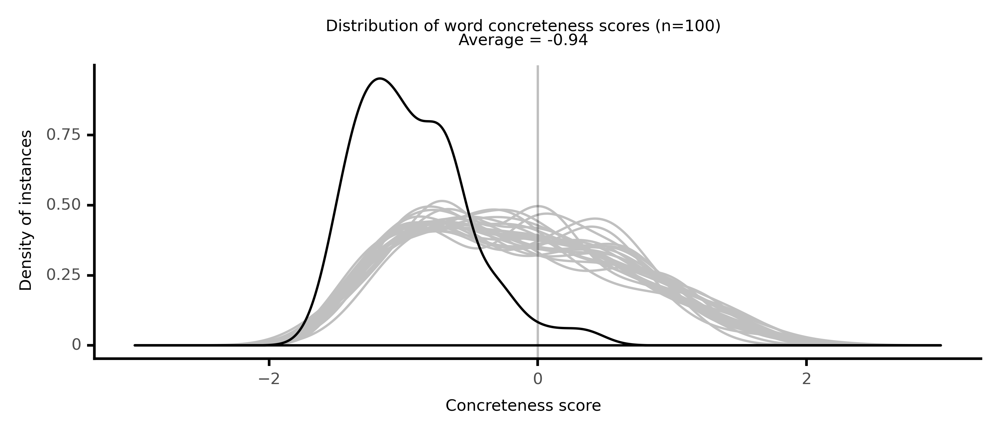

<ggplot: (8764118202525)>

 48%|████▊     | 48/100 [10:31<11:39, 13.44s/it]

#### #49 most abstract passage: Brown, _Ormond; or, The Secret Witness . . . (1799)_ (1799)

<p>, and he was <abs><conc190>anxious</conc190></abs> only for a <neither><conc448>partner</conc448></neither> that would <abs><conc204>aid</conc204></abs> him in <abs><conc207>preserving</conc207></abs>, rather than in <neither><conc258>enlarging</conc258></neither> his <abs><conc174>property</conc174></abs>. He <neither><conc253>esteemed</conc253></neither> himself <abs><conc067>eminently</conc067></abs> <abs><conc174>fortunate</conc174></abs> in <neither><conc302>meeting</conc302></neither> with one in whom every <neither><conc344>matrimonial</conc344></neither> <abs><conc061>qualification</conc061></abs> <neither><conc262>concentred</conc262></neither>. He was not <abs><conc100>deficient</conc100></abs> in <neither><conc267>modesty</conc267></neither>, but he <neither><conc343>fancied</conc343></neither> that, on this occasion, there was no <abs><conc079>possibility</conc079></abs> of <abs><conc127>miscarriage</conc127></abs>. He <neither><conc377>held</conc377></neither> her <abs><conc007>capacity</conc007></abs> in <neither><conc752>deep</conc752></neither> <abs><conc119>veneration</conc119></abs>, but this circumstance <abs><conc090>rendered</conc090></abs> him more <abs><conc208>secure</conc208></abs> of <abs><conc132>success</conc132></abs>. He <abs><conc112>conceived</conc112></abs> this <abs><conc188>union</conc188></abs> to be even more <abs><conc144>eligible</conc144></abs> with regard to her than to himself; and <abs><conc077>confided</conc077></abs> in the <abs><conc010>rectitude</conc010></abs> of her <abs><conc056>understanding</conc056></abs>, for a <abs><conc017>decision</conc017></abs> <abs><conc088>favourable</conc088></abs> to his <abs><conc157>wishes</conc157></abs>. Before any <abs><conc106>express</conc106></abs> <abs><conc052>declaration</conc052></abs> was made, <neither><conc470>Constantia</conc470></neither> <neither><conc286>easily</conc286></neither> <abs><conc048>predicted</conc048></abs> the <abs><conc075>event</conc075></abs> from the <abs><conc072>frequency</conc072></abs> of his <neither><conc429>visits</conc429></neither>, and the attentiveness of his <abs><conc130>manners</conc130></abs>. It was no <abs><conc174>difficult</conc174></abs> <abs><conc207>task</conc207></abs> to <abs><conc188>ascertain</conc188></abs> this man's <abs><conc182>character</conc182></abs>. Her <abs><conc107>modes</conc107></abs> of <abs><conc086>thinking</conc086></abs> were, in few <abs><conc210>respects</conc210></abs>, similar to those of her <neither><conc576>lover</conc576></neither>. She was <neither><conc364>eager</conc364></neither> to <abs><conc035>investigate</conc035></abs>, in the first place, the atrributes of his mind. His <abs><conc016>professional</conc016></abs> and <neither><conc493>household</conc493></neither> <abs><conc026>maxims</conc026></abs> were not of <abs><conc186>inconsiderable</conc186></abs> importance, but they were <abs><conc035>subordinate</conc035></abs> <abs><conc038>considerations</conc038></abs>. In the <abs><conc163>poverty</conc163></abs> of his <abs><conc189>discourse</conc189></abs> and <abs><conc063>ideas</conc063></abs>, she quickly found <abs><conc058>reasons</conc058></abs> for <abs><conc056>determining</conc056></abs> her <abs><conc010>conduct</conc010></abs>. <neither><conc360>Marriage</conc360></neither> she had but little <abs><conc083>considered</conc083></abs>, as it is in itself. What are the <abs><conc184>genuine</conc184></abs> <abs><conc010>principles</conc010></abs> of that <abs><conc127>relation</conc127></abs>, and what <abs><conc010>conduct</conc010></abs> with <abs><conc047>respect</conc047></abs> to it, is <abs><conc203>prescribed</conc203></abs> to <abs><conc003>rational</conc003></abs> <abs><conc103>beings</conc103></abs>, by their <abs><conc135>duty</conc135></abs>, she had not hitherto <abs><conc027>investigated</conc027></abs>: But she was not <neither><conc453>backward</conc453></neither> to <abs><conc199>inquire</conc199></abs> what are the <abs><conc041>precepts</conc041></abs> of <abs><conc135>duty</conc135></abs>, in her own particular case. She knew herself to be <neither><conc718>young</conc718></neither>; she was sensible of the <neither><conc237>daily</conc237></neither> <abs><conc095>enlargement</conc095></abs> of her <abs><conc029>knowledge</conc029></abs>; every day <abs><conc153>contributed</conc153></abs> to <abs><conc052>rectify</conc052></abs> some <abs><conc035>error</conc035></abs> or <abs><conc069>confirm</conc069></abs> some <abs><conc065>truth</conc065></abs>. These <abs><conc019>benefits</conc019></abs> she <abs><conc059>owed</conc059></abs> to her <abs><conc228>situation</conc228></abs>, which, whatever were its <abs><conc066>evils</conc066></abs>, gave her as much <abs><conc072>freedom</conc072></abs> from <abs><conc090>restraint</conc090></abs> as is <abs><conc019>consistent</conc019></abs> with the state of <abs><conc115>human</conc115></abs> <abs><conc067>affairs</conc067></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

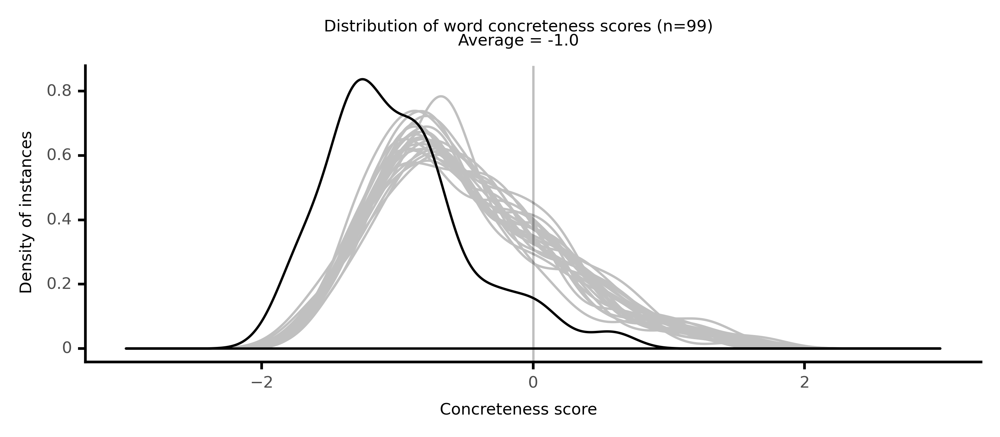

<ggplot: (8764115567441)>

 49%|████▉     | 49/100 [10:42<10:56, 12.87s/it]

#### #50 most abstract passage: Brown, _The Novels . . . (1827): a machine-readable transc_ (1827)

<p>. For this end, he <abs><conc193>prescribed</conc193></abs> to himself a <neither><conc500>path</conc500></neither> <neither><conc363>suited</conc363></neither> to the <abs><conc025>character</conc025></abs> of this lady. He made no <abs><conc218>secret</conc218></abs> of his <abs><conc034>sentiments</conc034></abs> and <abs><conc017>views</conc017></abs>. He <abs><conc058>avowed</conc058></abs> his love, and described, without <abs><conc118>scruple</conc118></abs>, the <abs><conc049>scope</conc049></abs> of his <abs><conc164>wishes</conc164></abs>. He <abs><conc250>challenged</conc250></abs> her to <abs><conc005>confute</conc005></abs> his <abs><conc016>principles</conc016></abs>, and <neither><conc373>promised</conc373></neither> a <abs><conc079>candid</conc079></abs> <neither><conc379>audience</conc379></neither> and <abs><conc073>profound</conc073></abs> <abs><conc090>consideration</conc090></abs> to her <abs><conc045>arguments</conc045></abs>. Her present <abs><conc013>opinions</conc013></abs> he knew to be <abs><conc044>adverse</conc044></abs> to his own, but he <abs><conc253>hoped</conc253></abs> to <abs><conc200>change</conc200></abs> them, by <abs><conc060>subtlety</conc060></abs> and <abs><conc101>perseverance</conc101></abs>. His further <abs><conc100>Hope</conc100></abs>'s and <neither><conc269>designs</conc269></neither>, he <neither><conc609>concealed</conc609></neither> from her. She was <neither><conc368>unaware</conc368></neither>, that if he were <abs><conc242>unable</conc242></abs> to effect a <abs><conc200>change</conc200></abs> in her <abs><conc062>creed</conc062></abs>, he was <abs><conc141>determined</conc141></abs> to <abs><conc092>adopt</conc092></abs> a system of <abs><conc012>imposture</conc012></abs>. To <abs><conc134>assume</conc134></abs> the <neither><conc353>guise</conc353></neither> of a <abs><conc212>convert</conc212></abs> to her <abs><conc017>doctrines</conc017></abs>, and appear as <abs><conc148>devout</conc148></abs> as herself in his <abs><conc169>notions</conc169></abs> of the <abs><conc147>sanctity</conc147></abs> of <neither><conc373>marriage</conc373></neither>. Perhaps it was not <abs><conc219>difficult</conc219></abs>, to have <abs><conc096>foreseen</conc096></abs> the <abs><conc068>consequence</conc068></abs> of these <abs><conc206>projects</conc206></abs>. <abs><conc203>Constantia</conc203></abs>'s <abs><conc157>peril</conc157></abs> was <abs><conc260>imminent</conc260></abs>. This <neither><conc404>arose</conc404></neither> not only from the <abs><conc100>talents</conc100></abs> and <abs><conc243>address</conc243></abs> of Ormond, but from the <abs><conc103>community</conc103></abs> of <abs><conc050>sentiment</conc050></abs>, which already <abs><conc160>existed</conc160></abs> between them. She was <abs><conc255>unguarded</conc255></abs> in a <neither><conc363>point</conc363></neither>, where, if not her whole, yet, <abs><conc078>doubtless</conc078></abs>, her <neither><conc331>principal</conc331></neither> <abs><conc145>security</conc145></abs> and <abs><conc191>strongest</conc191></abs> <neither><conc355>bulwark</conc355></neither> would have <abs><conc160>existed</conc160></abs>. She was <abs><conc139>unacquainted</conc139></abs> with <abs><conc025>religion</conc025></abs>. She was unhabituated to <abs><conc090>conform</conc090></abs> herself to any <abs><conc180>standard</conc180></abs>, but that <neither><conc280>connected</conc280></neither> with the present life. <neither><conc281>Matrimonial</conc281></neither>, as well as every other <abs><conc115>human</conc115></abs> <abs><conc127>duty</conc127></abs>, was <abs><conc251>disconnected</conc251></abs> in her mind, with any <neither><conc358>awful</conc358></neither> or <abs><conc020>divine</conc020></abs> <abs><conc012>sanction</conc012></abs>. She <neither><conc509>formed</conc509></neither> her <abs><conc121>estimate</conc121></abs> of good and <abs><conc031>evil</conc031></abs>, on nothing but <neither><conc378>terrestrial</conc378></neither> and <neither><conc409>visible</conc409></neither> <abs><conc025>consequences</conc025></abs>. This <abs><conc129>defect</conc129></abs> in her <abs><conc025>character</conc025></abs>, she <abs><conc166>owed</conc166></abs> to her father's system of <abs><conc162>education</conc162></abs>. Mr. Dudley was an <abs><conc138>adherent</conc138></abs> to what he <abs><conc138>conceived</conc138></abs> to be <abs><conc024>true</conc024></abs> <abs><conc025>religion</conc025></abs>. No man was more <neither><conc313>passionate</conc313></neither> in his <abs><conc149>eulogy</conc149></abs> of his own from of <abs><conc099>devotion</conc099></abs> and <abs><conc004>belief</conc004></abs>, or in his <abs><conc113>invectives</conc113></abs> against <abs><conc035>atheistical</conc035></abs> <abs><conc049>dogmas</conc049></abs>; but he <neither><conc479>reflected</conc479></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

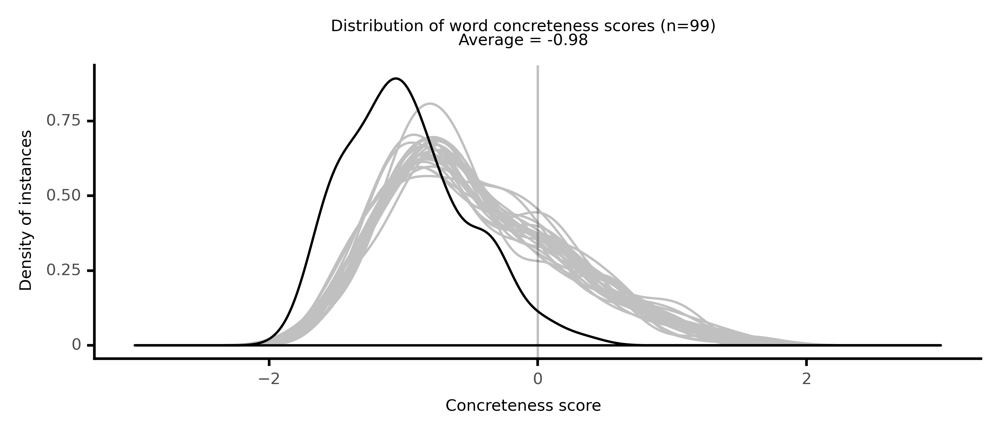

<ggplot: (8764112145285)>

 50%|█████     | 50/100 [10:54<10:17, 12.35s/it]

#### #51 most abstract passage: Brown, _The Novels . . . (1827): a machine-readable transc_ (1827)

<p>of both our <neither><conc335>parents</conc335></neither> to make me <abs><conc113>rely</conc113></abs> on the <abs><conc082>influence</conc082></abs> of time and <abs><conc181>reflection</conc181></abs> in our <abs><conc142>favour</conc142></abs>. Your mother could not <abs><conc154>cease</conc154></abs> to love you. I could not by any <neither><conc447>accident</conc447></neither> be <abs><conc085>wholly</conc085></abs> <neither><conc437>bereft</conc437></neither> of my father's <abs><conc235>affection</conc235></abs>. No <abs><conc010>conduct</conc010></abs> of theirs had <neither><conc465>robbed</conc465></neither> them of my <abs><conc135>esteem</conc135></abs>. Why then did I <abs><conc196>persist</conc196></abs> in <abs><conc010>thwarting</conc010></abs> their <abs><conc164>wishes</conc164></abs>? Why <abs><conc138>encourage</conc138></abs> you in your <abs><conc019>opposition</conc019></abs>? because I <neither><conc284>imagined</conc284></neither> that, in <abs><conc010>thwarting</conc010></abs> their present <abs><conc017>views</conc017></abs>, which were <abs><conc105>founded</conc105></abs> in <abs><conc014>error</conc014></abs>, I <neither><conc262>consulted</conc262></neither> their <abs><conc158>lasting</conc158></abs> <abs><conc149>happiness</conc149></abs>, and made myself a <abs><conc234>title</conc234></abs> to their <abs><conc066>future</conc066></abs> <abs><conc176>gratitude</conc176></abs>, by <abs><conc216>challenging</conc216></abs> their present <abs><conc034>rebukes</conc034></abs>. I told you not of my father's <neither><conc313>passionate</conc313></neither> <abs><conc010>violences</conc010></abs>, <abs><conc106>disgraceful</conc106></abs> to himself and <abs><conc199>productive</conc199></abs> of <neither><conc289>unspeakable</conc289></neither> <neither><conc360>anguish</conc360></neither> to me. Why should I <abs><conc239>revive</conc239></abs> the <neither><conc513>scene</conc513></neither>? why be the <abs><conc054>historian</conc054></abs> of my father's <abs><conc098>dishonour</conc098></abs>? why <abs><conc125>needlessly</conc125></abs> <neither><conc429>add</conc429></neither> to my own and to your <neither><conc274>affliction</conc274></neither>? My <abs><conc046>concealments</conc046></abs> <neither><conc404>arose</conc404></neither> not from the <abs><conc069>fear</conc069></abs> that the <abs><conc088>disclosure</conc088></abs> would <abs><conc124>estrange</conc124></abs> you from me. I <abs><conc181>supposed</conc181></abs> you willing to <abs><conc140>grant</conc140></abs> me the same <abs><conc099>independence</conc099></abs> of a <neither><conc339>parent</conc339></neither>'s <abs><conc124>control</conc124></abs> which you <abs><conc162>claimed</conc162></abs> for yourself. I saw no <neither><conc269>difference</conc269></neither> between <abs><conc045>forbearing</conc045></abs> to <neither><conc268>consult</conc268></neither> a <neither><conc339>parent</conc339></neither>, in a case where we know that his <abs><conc207>answer</conc207></abs> will <abs><conc018>condemn</conc018></abs> us, and <abs><conc039>slighting</conc039></abs> his <abs><conc116>express</conc116></abs> <neither><conc285>forbidding</conc285></neither>. I say thus much to account for, and, if possible, <neither><conc273>excuse</conc273></neither> that <neither><conc374>concealment</conc374></neither> with which you <abs><conc086>reproach</conc086></abs> me. <neither><conc498>Tender</conc498></neither> and <abs><conc261>reluctant</conc261></abs>, indeed, are these <abs><conc157>reproaches</conc157></abs>, but as I <abs><conc102>deem</conc102></abs> it a <abs><conc251>sacred</conc251></abs> <abs><conc127>duty</conc127></abs> to <abs><conc199>reveal</conc199></abs> to you the utmost of my <abs><conc113>follies</conc113></abs>, what but in <abs><conc027>justice</conc027></abs> to you would be the <abs><conc041>tacit</conc041></abs> <abs><conc204>admission</conc204></abs> of <abs><conc155>injurious</conc155></abs> but <abs><conc010>groundless</conc010></abs> <abs><conc198>charges</conc198></abs>. My <abs><conc033>actual</conc033></abs> <abs><conc101>faults</conc101></abs> are of too <neither><conc586>deep</conc586></neither> a <neither><conc363>die</conc363></neither> to allow me to <neither><conc462>sport</conc462></neither> with your good <abs><conc020>opinion</conc020></abs>, or <abs><conc229>permit</conc229></abs> me to be worse thought of by you than I <abs><conc153>deserve</conc153></abs>. You <abs><conc072>exhort</conc072></abs> me to <abs><conc097>seek</conc097></abs> <abs><conc014>reconcilement</conc014></abs> with my father. What mean you? I have not been the injurer. Not an <neither><conc401>angry</conc401></neither> word, <abs><conc197>accusing</conc197></abs> look, or <neither><conc364>vengeful</conc364></neither> thought has come from me. I have <abs><conc099>exercised</conc099></abs> the <abs><conc209>privilege</conc209></abs> of a <abs><conc015>rational</conc015></abs> and <abs><conc005>moral</conc005></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

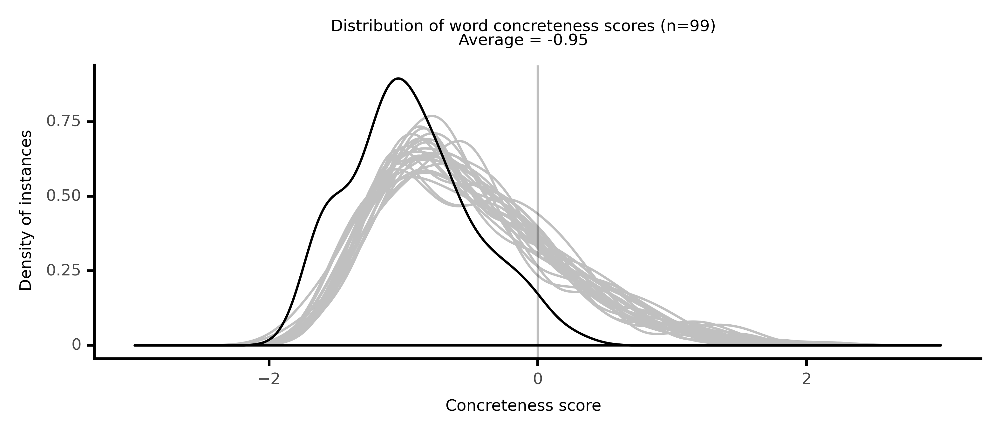

<ggplot: (8764120865229)>

 51%|█████     | 51/100 [11:04<09:30, 11.64s/it]

#### #52 most abstract passage: Holland, _The Bay-Path: A Tale of New England Colonial Life._ (1857)

<p>MY Friend and <abs><conc140>Associate</conc140></abs>. <abs><conc185>Fiction</conc185></abs>, though much <abs><conc221>abused</conc221></abs> by those who <neither><conc365>write</conc365></neither> it, and <abs><conc190>persistently</conc190></abs> <abs><conc078>traduced</conc078></abs> by those who do not <abs><conc138>comprehend</conc138></abs> its <abs><conc024>true</conc024></abs> <neither><conc279>mission</conc279></neither>, has always been a <neither><conc556>favourite</conc556></neither> <abs><conc179>mode</conc179></abs> of <neither><conc372>communicating</conc372></neither> <abs><conc013>truth</conc013></abs>, and has, for its <abs><conc148>support</conc148></abs>, the <abs><conc137>highest</conc137></abs> <abs><conc009>sanctions</conc009></abs> of <abs><conc049>Christianity</conc049></abs>. The <abs><conc072>Author</conc072></abs> of the <abs><conc057>Christian</conc057></abs> system spoke <neither><conc382>evermore</conc382></neither> in <abs><conc095>parables</conc095></abs> in the <neither><conc617>illustration</conc617></neither> of important <abs><conc040>practical</conc040></abs> <abs><conc013>truth</conc013></abs>. In <abs><conc067>fact</conc067></abs>( let it be <neither><conc512>reverently</conc512></neither> <neither><conc314>uttered</conc314></neither>), the great <abs><conc033>principle</conc033></abs> in <abs><conc115>human</conc115></abs> <abs><conc041>nature</conc041></abs> which <neither><conc463>called</conc463></neither> Him into the world, is <neither><conc364>identical</conc364></neither> with that on which the <abs><conc051>claims</conc051></abs> and <abs><conc028>power</conc028></abs> of <abs><conc026>legitimate</conc026></abs> <abs><conc185>fiction</conc185></abs> <neither><conc348>rest</conc348></neither>. He came to <abs><conc044>embody</conc044></abs> <abs><conc032>abstract</conc032></abs> <abs><conc013>truth</conc013></abs> in <abs><conc115>human</conc115></abs> <abs><conc113>relations</conc113></abs>, and the <neither><conc698>naked</conc698></neither>, <abs><conc091>incomprehensible</conc091></abs> <abs><conc104>idea</conc104></abs> of God, in the <abs><conc115>human</conc115></abs> from. He came to <abs><conc181>exhibit</conc181></abs> in <abs><conc115>human</conc115></abs> <abs><conc193>development</conc193></abs> the <abs><conc024>true</conc024></abs> <abs><conc041>nature</conc041></abs> of the <abs><conc020>divine</conc020></abs> life, and to <abs><conc015>demonstrate</conc015></abs>, in <abs><conc115>human</conc115></abs> <abs><conc032>experience</conc032></abs>, under the <abs><conc082>influence</conc082></abs> of <abs><conc026>legitimate</conc026></abs> <abs><conc115>human</conc115></abs> <abs><conc014>motives</conc014></abs>, the <neither><conc435>beauty</conc435></neither> of <abs><conc065>holiness</conc065></abs>. It was upon this <abs><conc033>principle</conc033></abs> that his <neither><conc483>wondered</conc483></neither> <abs><conc095>parables</conc095></abs> were <abs><conc099>based</conc099></abs>. The <abs><conc025>necessity</conc025></abs> was to <abs><conc181>exhibit</conc181></abs> <abs><conc013>truth</conc013></abs> in its <abs><conc113>relations</conc113></abs> to the <abs><conc062>feeling</conc062></abs>, <abs><conc217>thinking</conc217></abs>, <abs><conc168>acting</conc168></abs> <abs><conc163>soul</conc163></abs>; and, in <abs><conc191>order</conc191></abs> to <abs><conc256>meet</conc256></abs> that <abs><conc025>necessity</conc025></abs> at that day, it was <abs><conc208>requisite</conc208></abs> that the case should be <neither><conc284>imagined</conc284></neither> and the <abs><conc113>relations</conc113></abs> <abs><conc087>created</conc087></abs>. In the <abs><conc260>birth</conc260></abs> of new <abs><conc154>questions</conc154></abs>, in the <abs><conc137>revolution</conc137></abs> of <abs><conc013>opinions</conc013></abs>, and in the <neither><conc467>shifting</conc467></neither> <neither><conc289>aspect</conc289></neither> of <abs><conc124>affairs</conc124></abs>, this great <abs><conc025>necessity</conc025></abs> becomes <abs><conc170>perpetual</conc170></abs>, and the <abs><conc206>requisites</conc206></abs> for its <abs><conc161>satisfaction</conc161></abs> <neither><conc321>remain</conc321></neither> the same. With this <abs><conc137>view</conc137></abs> of the <abs><conc026>legitimate</conc026></abs> <abs><conc146>aim</conc146></abs> and <neither><conc461>high</conc461></neither> <abs><conc173>office</conc173></abs> of <abs><conc185>fiction</conc185></abs>, the following pages were <abs><conc233>written</conc233></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

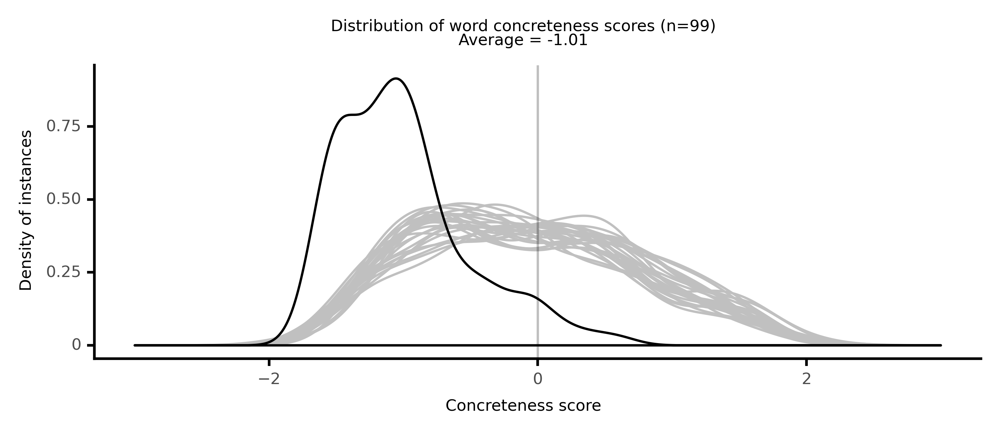

<ggplot: (8764117383493)>

 52%|█████▏    | 52/100 [11:15<09:14, 11.55s/it]

#### #53 most abstract passage: Smollett, _Peregrine Pickle (1751)_ (1751)

<p>of his <abs><conc201>son</conc201></abs>, with <neither><conc355>raptures</conc355></neither> of <abs><conc119>applause</conc119></abs>, <abs><conc101>inveighed</conc101></abs> with great <neither><conc260>acrimony</conc260></neither> against the <abs><conc157>kingly</conc157></abs> name; and in <neither><conc282>order</conc282></neither> to <abs><conc055>sanction</conc055></abs> his <abs><conc033>opinion</conc033></abs>, <neither><conc241>repeated</conc241></neither> forty or fifty <neither><conc719>lines</conc719></neither> from one of the Philippicks of Demosthenes. Jolter <neither><conc257>hearing</conc257></neither> him speak so <abs><conc084>disrespectfully</conc084></abs> of the <neither><conc348>higher</conc348></neither> <abs><conc054>powers</conc054></abs>, <neither><conc508>glowed</conc508></neither> with <abs><conc117>indignation</conc117></abs>. He said his <abs><conc030>doctrines</conc030></abs> were <abs><conc093>detestable</conc093></abs> and <abs><conc185>destructive</conc185></abs> of all right, <neither><conc282>order</conc282></neither> and <abs><conc079>society</conc079></abs>; that <abs><conc083>monarchy</conc083></abs> was of <abs><conc054>divine</conc054></abs> <abs><conc068>institution</conc068></abs>, therefore <abs><conc022>indefeasible</conc022></abs> by any <abs><conc115>human</conc115></abs> <abs><conc020>power</conc020></abs>; and of <abs><conc035>consequence</conc035></abs> those <abs><conc037>events</conc037></abs> in the English <abs><conc144>history</conc144></abs>, which he had so <abs><conc128>liberally</conc128></abs> <abs><conc186>commended</conc186></abs>, were no other than <abs><conc060>flagrant</conc060></abs> <abs><conc061>instances</conc061></abs> of <neither><conc241>sacrilege</conc241></neither>, <abs><conc136>perfidy</conc136></abs>, and <abs><conc111>sedition</conc111></abs>; that the <abs><conc080>democracy</conc080></abs> of Athens was a most <abs><conc036>absurd</conc036></abs> <abs><conc098>constitution</conc098></abs>, <abs><conc146>productive</conc146></abs> of <abs><conc121>anarchy</conc121></abs> and <neither><conc280>mischief</conc280></neither>, which must always <neither><conc262>happen</conc262></neither> when the <abs><conc027>government</conc027></abs> of a <abs><conc073>nation</conc073></abs> <abs><conc174>depends</conc174></abs> upon the <abs><conc104>caprice</conc104></abs> of the <abs><conc041>ignorant</conc041></abs> hair-brained <abs><conc204>vulgar</conc204></abs>: that it was in the <abs><conc020>power</conc020></abs> of the most <abs><conc147>profligate</conc147></abs> <abs><conc176>member</conc176></abs> of the <abs><conc062>commonwealth</conc062></abs>, <neither><conc329>provided</conc329></neither> he was <neither><conc236>endowed</conc236></neither> with <abs><conc120>eloquence</conc120></abs>, to <neither><conc297>ruin</conc297></neither> the most <abs><conc097>deserving</conc097></abs>, by a <abs><conc176>desperate</conc176></abs> <abs><conc039>exertion</conc039></abs> of his <abs><conc079>talents</conc079></abs> upon the <abs><conc223>populace</conc223></abs>, who had been often <abs><conc062>persuaded</conc062></abs> to act in the most <abs><conc191>ungrateful</conc191></abs> and <abs><conc091>imprudent</conc091></abs> manner, against the greatest <abs><conc206>patriots</conc206></abs> that their country had <neither><conc292>produced</conc292></neither>: and finally, he <abs><conc090>averred</conc090></abs>, that the <abs><conc093>liberal</conc093></abs> <neither><conc254>arts</conc254></neither> and <abs><conc222>sciences</conc222></abs> had never <neither><conc365>flourished</conc365></neither> so much in a <abs><conc082>republic</conc082></abs>, as under the <abs><conc098>encouragement</conc098></abs> and <abs><conc169>protection</conc169></abs> of <abs><conc013>absolute</conc013></abs> <abs><conc020>power</conc020></abs>; <abs><conc174>witness</conc174></abs> the <abs><conc126>Augustan</conc126></abs> <abs><conc229>age</conc229></abs>, and the <neither><conc242>reign</conc242></neither> of Lewis the fourteenth: nor was it to be <abs><conc230>supposed</conc230></abs> that <abs><conc073>genius</conc073></abs> and <abs><conc050>merit</conc050></abs> could ever be so <abs><conc179>amply</conc179></abs> <abs><conc109>recompensed</conc109></abs> by the <abs><conc051>individuals</conc051></abs>, or <abs><conc228>distracted</conc228></abs> <abs><conc047>councils</conc047></abs> of a <abs><conc062>commonwealth</conc062></abs>, as by the <abs><conc084>generosity</conc084></abs> and <neither><conc388>magnificence</conc388></neither> of one, who had the whole <neither><conc418>treasures</conc418></neither> at his own <abs><conc178>command</conc178></abs>. <conc><conc854>Peregrine</conc854></conc>, who was <abs><conc169>pleased</conc169></abs> to find the <abs><conc147>contest</conc147></abs> <neither><conc569>grow</conc569></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

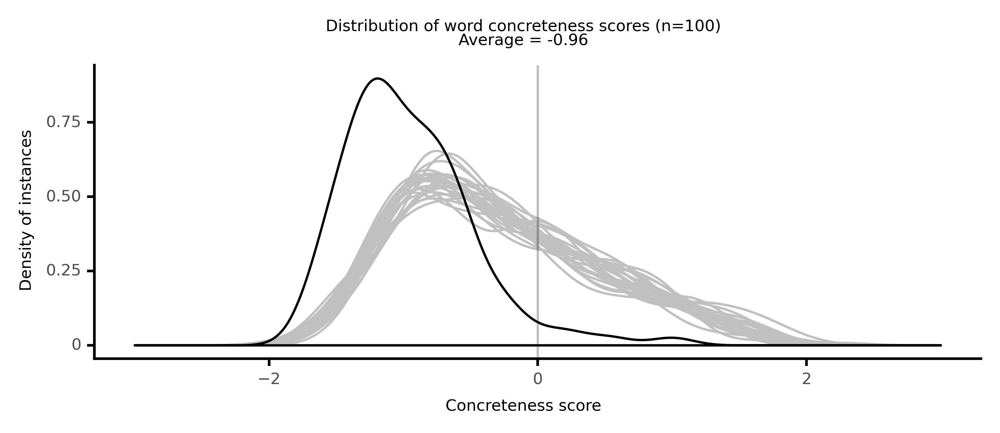

<ggplot: (8764114789089)>

 53%|█████▎    | 53/100 [11:31<10:11, 13.01s/it]

#### #54 most abstract passage: Paulding, _The Merry Tales of the Three Wise Men of Gotham (1_ (1826)

<p>there would be little of <abs><conc036>morality</conc036></abs> in this world.'' Then,'' said I, after a <neither><conc505>pause</conc505></neither>, you do not believe in the <abs><conc082>influence</conc082></abs> of <abs><conc045>knowledge</conc045></abs> at all?'' <neither><conc274>Pardon</conc274></neither> me,'' said he, I believe it has great <abs><conc082>influence</conc082></abs>, and that to know our <abs><conc194>duties</conc194></abs>, is <abs><conc076>essentially</conc076></abs> necessary to the <abs><conc086>practice</conc086></abs> of them. They are, to a certain <abs><conc136>extent</conc136></abs>, <abs><conc204>indispensable</conc204></abs> to the <abs><conc159>maintenance</conc159></abs> and <abs><conc195>enjoyment</conc195></abs> of that <abs><conc032>freedom</conc032></abs> which is the <abs><conc157>basis</conc157></abs> of <abs><conc098>national</conc098></abs> <abs><conc128>prosperity</conc128></abs> and <abs><conc149>happiness</conc149></abs>. If to know what is right is <abs><conc081>essential</conc081></abs> to <abs><conc086>practice</conc086></abs>, it is still more <abs><conc081>essential</conc081></abs> to the <abs><conc195>enjoyment</conc195></abs> of our <abs><conc096>rights</conc096></abs>, that we should know in what they <neither><conc345>consist</conc345></neither>. This can not be known without <abs><conc162>education</conc162></abs>. All I <abs><conc036>deny</conc036></abs> is, that <abs><conc115>human</conc115></abs> <abs><conc045>knowledge</conc045></abs> will <neither><conc266>suffice</conc266></neither> to the <abs><conc232>total</conc232></abs> <abs><conc158>prevention</conc158></abs> of <abs><conc095>crimes</conc095></abs>, or <abs><conc099>obviate</conc099></abs> the <abs><conc025>necessity</conc025></abs> of <abs><conc118>penal</conc118></abs> <abs><conc137>statutes</conc137></abs> and <abs><conc020>punishments</conc020></abs>.'' <abs><conc020>Punishments</conc020></abs>!'' said I, my master allows of nothing of this <neither><conc265>kind</conc265></neither>. He has <abs><conc155>proved</conc155></abs> that <abs><conc043>punishment</conc043></abs> is not only <abs><conc249>cruel</conc249></abs>, but entirely <neither><conc305>ineffectual</conc305></neither> in the <abs><conc158>prevention</conc158></abs> of <abs><conc076>crime</conc076></abs>.'' As how?'' Why because, <abs><conc082>notwithstanding</conc082></abs> these <abs><conc020>punishments</conc020></abs>, <abs><conc095>crimes</conc095></abs> are <abs><conc138>committed</conc138></abs> every day,'' said <neither><conc449>I.</conc449></neither> Ah! that is your master's <neither><conc453>usual</conc453></neither> <abs><conc179>mode</conc179></abs> of <neither><conc605>drawing</conc605></neither> <abs><conc051>conclusions</conc051></abs>. Because <abs><conc020>punishments</conc020></abs> do not <neither><conc280>prevent</conc280></neither> <abs><conc076>crime</conc076></abs> entirely, he <abs><conc108>concludes</conc108></abs> that they are of no effect whatever. Because they do n't do every thing, it follows in his system that they do nothing. He <neither><conc449>sees</conc449></neither> that <abs><conc095>crimes</conc095></abs> are <abs><conc138>committed</conc138></abs> in spite of the <abs><conc043>punishment</conc043></abs>; but only <abs><conc011>Omniscience</conc011></abs> can see how many others are <abs><conc207>refrained</conc207></abs> from, in the <abs><conc050>apprehension</conc050></abs> of the <abs><conc043>punishment</conc043></abs> that <neither><conc312>awaits</conc312></neither> them. In good <abs><conc013>truth</conc013></abs>, my friend, of all thy master's <abs><conc065>absurdities</conc065></abs>, and truly they are <abs><conc097>manifold</conc097></abs>, the <abs><conc068>absurdity</conc068></abs> of <neither><conc274>dispensing</conc274></neither> with <abs><conc020>punishments</conc020></abs> <abs><conc167>altogether</conc167></abs>, because those already <abs><conc042>denounced</conc042></abs> are <abs><conc194>insufficient</conc194></abs> for the <abs><conc232>total</conc232></abs> <abs><conc158>prevention</conc158></abs> of <abs><conc076>crime</conc076></abs>, is the greatest. It is as if a <neither><conc339>parent</conc339></neither> should say to a <neither><conc269>wayward</conc269></neither> and <abs><conc212>obstinate</conc212></abs> child, Go thy ways, and do as thou pleasest; I find ten <neither><conc656>stripes</conc656></neither> will not <neither><conc280>prevent</conc280></neither> thee from transgressing, therefore I will not <abs><conc199>increase</conc199></abs> them to twenty, but let thee off in <abs><conc066>future</conc066></abs>, without any <abs><conc043>punishment</conc043></abs> at all.''' But my master <abs><conc063>relies</conc063></abs> upon the <abs><conc166>force</conc166></abs> of <neither><conc263>habit</conc263></neither>, the <abs><conc189>absence</conc189></abs> of <abs><conc200>temptation</conc200></abs>, and the <abs><conc100>hope</conc100></abs> of <abs><conc133>reward</conc133></abs>,'' said I. My good friend, thy master <abs><conc063>relies</conc063></abs> upon <abs><conc194>insufficient</conc194></abs> <neither><conc317>securities</conc317></neither>. The <abs><conc166>force</conc166></abs> of <neither><conc263>habit</conc263></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

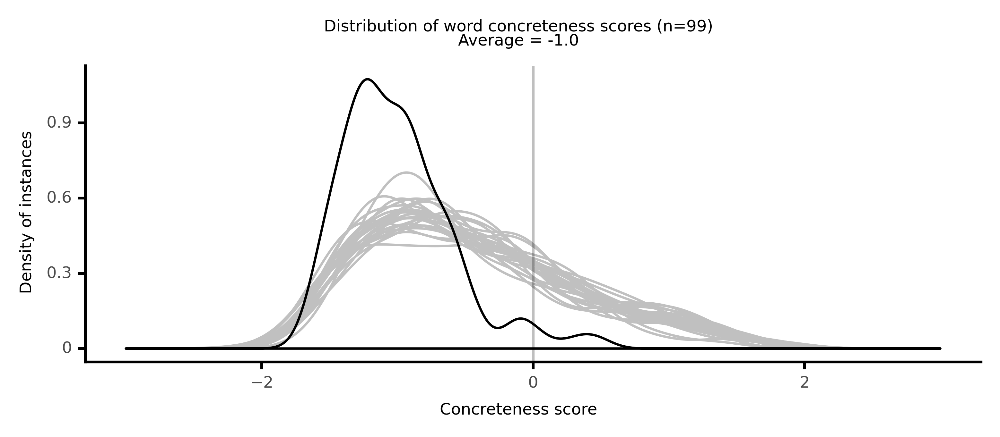

<ggplot: (8764171729641)>

 54%|█████▍    | 54/100 [11:42<09:22, 12.24s/it]

#### #55 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>to <abs><conc115>human</conc115></abs> <abs><conc032>ignorance</conc032></abs> and <abs><conc055>wickedness</conc055></abs>, <neither><conc269>contracted</conc269></neither> by men's own <abs><conc129>fault</conc129></abs>, gives them an <abs><conc106>express</conc106></abs> <abs><conc017>revelation</conc017></abs> of his will, and re-establishes the <abs><conc065>rule</conc065></abs> of <neither><conc437>pure</conc437></neither> <abs><conc020>uncorrupt</conc020></abs> <abs><conc043>religion</conc043></abs> and <abs><conc035>morality</conc035></abs>. He <abs><conc032>declares</conc032></abs> those terms of <abs><conc076>sinful</conc076></abs> man's <abs><conc063>reconcilement</conc063></abs> to him which he was <abs><conc169>pleased</conc169></abs> to <abs><conc182>accept</conc182></abs>. <neither><conc291>Grace</conc291></neither> is <abs><conc008>manifested</conc008></abs> in the <abs><conc051>gospel</conc051></abs> to <neither><conc401>turn</conc401></neither> men from their <abs><conc186>vanities</conc186></abs>, or <neither><conc453>idol</conc453></neither> <abs><conc185>service</conc185></abs>, unto the <neither><conc364>living</conc364></neither> God, who made <abs><conc233>heaven</conc233></abs> and <neither><conc562>earth</conc562></neither>, and by the <abs><conc012>doctrine</conc012></abs> and <abs><conc196>sacrifice</conc196></abs> of Jesus Christ, to <abs><conc151>redeem</conc151></abs> us from all <abs><conc082>iniquity</conc082></abs>, and <abs><conc180>purify</conc180></abs> to himself a <abs><conc194>peculiar</conc194></abs> people, <abs><conc044>zealous</conc044></abs> of good works:-- That <abs><conc028>denying</conc028></abs> all <abs><conc025>ungodliness</conc025></abs> and <abs><conc062>worldly</conc062></abs> lustest, we should live <abs><conc109>soberly</conc109></abs>, <abs><conc002>righteously</conc002></abs>, and <abs><conc139>godly</conc139></abs> in this present world, looking for that <neither><conc300>blessed</conc300></neither> <abs><conc131>hope</conc131></abs>, and the <abs><conc153>glorious</conc153></abs> <neither><conc430>appearance</conc430></neither> of the great God; who will <abs><conc033>judge</conc033></abs> the world by that <abs><conc054>divine</conc054></abs> person, and great <abs><conc153>temporary</conc153></abs> <abs><conc092>minister</conc092></abs>, whom he sent before to <abs><conc231>destroy</conc231></abs> <abs><conc130>sin</conc130></abs>, and the <abs><conc112>kingdom</conc112></abs> of Satan; and to bring <abs><conc017>mankind</conc017></abs> into a <abs><conc226>perfect</conc226></abs> <abs><conc022>obedience</conc022></abs> to the will of the <abs><conc022>supreme</conc022></abs> Being. This <abs><conc173>renders</conc173></abs> <abs><conc033>christianity</conc033></abs> a <neither><conc252>heavenly</conc252></neither> thing. <abs><conc017>Revelation</conc017></abs> thus <abs><conc099>explained</conc099></abs> is <conc><conc881>beautiful</conc881></conc> and useful to an <abs><conc221>extreme</conc221></abs> <abs><conc135>degree</conc135></abs>. It does not <abs><conc032>contradict</conc032></abs>, but <abs><conc204>strengthens</conc204></abs> the <abs><conc042>obligations</conc042></abs> of <abs><conc077>natural</conc077></abs> <abs><conc043>religion</conc043></abs>. Your account, Sir,( Mrs. <neither><conc428>Price</conc428></neither> answered) of man and <abs><conc043>religion</conc043></abs> is different indeed from mine, and I must allow your <abs><conc027>explications</conc027></abs> have <abs><conc031>reason</conc031></abs> in them: but still they do not <abs><conc096>satisfy</conc096></abs> me, nor can I part with my own <abs><conc033>opinion</conc033></abs>. Two things in particular to me appear very <abs><conc227>strange</conc227></abs> in your <abs><conc131>scheme</conc131></abs>. It seems to take away the <abs><conc029>necessity</conc029></abs> of the <abs><conc044>Christian</conc044></abs> <abs><conc017>revelation</conc017></abs>, if <abs><conc077>natural</conc077></abs> <abs><conc043>religion</conc043></abs>, <abs><conc201>duly</conc201></abs> <neither><conc322>attended</conc322></neither> to, was <abs><conc226>perfect</conc226></abs>, and <abs><conc164>sufficient</conc164></abs> for <abs><conc076>virtue</conc076></abs> and <abs><conc052>holiness</conc052></abs>, and thereby to <abs><conc202>gain</conc202></abs> the <abs><conc067>favour</conc067></abs> of God. If <abs><conc031>reason</conc031></abs> alone can do the work, if men please, then what needs of the <abs><conc051>gospel</conc051></abs>?-- If men will consider,( and without <abs><conc052>consideration</conc052></abs> no <abs><conc131>scheme</conc131></abs> can be of <abs><conc185>service</conc185></abs>), they may as well <neither><conc401>turn</conc401></neither> their thoughts to the <abs><conc016>law</conc016></abs> of <abs><conc083>nature</conc083></abs> as to the <abs><conc016>law</conc016></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

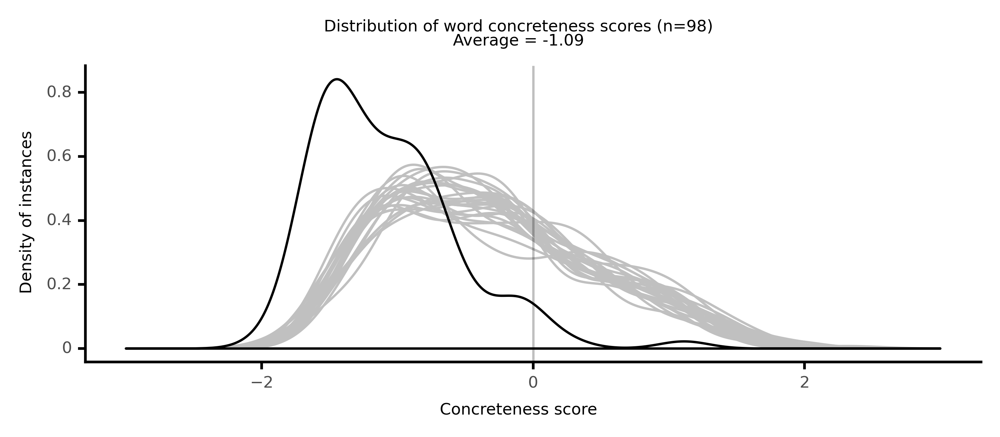

<ggplot: (8764098988045)>

 55%|█████▌    | 55/100 [11:57<09:49, 13.09s/it]

#### #56 most abstract passage: Brown, _Wieland (1798)_ (1798)

<p><abs><conc219>conjecture</conc219></abs> that the <neither><conc260>interview</conc260></neither> spoken of had taken place with Carwin, yet two <abs><conc063>ideas</conc063></abs> <abs><conc204>occurred</conc204></abs> to <abs><conc059>involve</conc059></abs> me in the most <abs><conc182>painful</conc182></abs> <abs><conc084>doubts</conc084></abs>. This man's <abs><conc029>reasonings</conc029></abs> might be so <abs><conc187>specious</conc187></abs>, and his <abs><conc193>artifices</conc193></abs> so <abs><conc224>profound</conc224></abs>, that, <abs><conc222>aided</conc222></abs> by the <abs><conc175>passion</conc175></abs> which you had <abs><conc112>conceived</conc112></abs> for him, he had finally <abs><conc167>succeeded</conc167></abs>; or his <abs><conc228>situation</conc228></abs> might be such as to <abs><conc002>justify</conc002></abs> the <neither><conc241>secrecy</conc241></neither> which you <abs><conc097>maintained</conc097></abs>. In neither case did my <neither><conc376>wildest</conc376></neither> <abs><conc231>reveries</conc231></abs> suggest to me, that your honour had been <abs><conc136>forfeited</conc136></abs>. I could not talk with you on this <abs><conc046>subject</conc046></abs>. If the <abs><conc074>imputation</conc074></abs> was <abs><conc156>false</conc156></abs>, its <abs><conc043>atrociousness</conc043></abs> would have <abs><conc026>justly</conc026></abs> <neither><conc463>drawn</conc463></neither> upon me your <abs><conc076>resentment</conc076></abs>, and I must have <abs><conc099>explained</conc099></abs> by what <abs><conc068>facts</conc068></abs> it had been <abs><conc059>suggested</conc059></abs>. If it were <abs><conc073>true</conc073></abs>, no <abs><conc095>benefit</conc095></abs> would <abs><conc221>follow</conc221></abs> from the <neither><conc256>mention</conc256></neither> of it. You had <abs><conc184>chosen</conc184></abs> to <neither><conc357>conceal</conc357></neither> it for some <abs><conc058>reasons</conc058></abs>, and whither these <abs><conc058>reasons</conc058></abs> were <abs><conc073>true</conc073></abs> or <abs><conc156>false</conc156></abs>, it was <abs><conc196>proper</conc196></abs> to <neither><conc248>discover</conc248></neither> and <neither><conc274>remove</conc274></neither> them in the first place. Finally, I <abs><conc030>acquiesced</conc030></abs> in the least <abs><conc182>painful</conc182></abs> <abs><conc078>supposition</conc078></abs>, trammeled as it was with <abs><conc085>perplexities</conc085></abs>, that Carwin was <neither><conc556>upright</conc556></neither>, and that, if the <abs><conc058>reasons</conc058></abs> of your <neither><conc244>silence</conc244></neither> were known they would be found to be just. Three days have <abs><conc233>elapsed</conc233></abs> since this <abs><conc210>occurrence</conc210></abs>. I have been <neither><conc494>haunted</conc494></neither> by <abs><conc130>perpetual</conc130></abs> <abs><conc183>inquietude</conc183></abs>. To bring myself to regard Carwin without <abs><conc208>terror</conc208></abs>, and to <abs><conc003>acquiesce</conc003></abs> in the <abs><conc012>belief</conc012></abs> of your <abs><conc117>safety</conc117></abs>, was <abs><conc133>impossible</conc133></abs>. Yet to put an end to my <abs><conc084>doubts</conc084></abs>, seemed to be <abs><conc111>impracticable</conc111></abs>. If some <neither><conc581>light</conc581></neither> could be <neither><conc368>reflected</conc368></neither> on the <abs><conc015>actual</conc015></abs> <abs><conc228>situation</conc228></abs> of this man, a <abs><conc069>direct</conc069></abs> <neither><conc416>path</conc416></neither> would present itself. If he were, <abs><conc057>contrary</conc057></abs> to the <abs><conc100>tenor</conc100></abs> of his <abs><conc187>conversation</conc187></abs>, <neither><conc337>cunning</conc337></neither> and <neither><conc267>malignant</conc267></neither>, to <abs><conc086>apprise</conc086></abs> you of this, would be to place you in <abs><conc109>security</conc109></abs>. If he were merely <abs><conc228>unfortunate</conc228></abs> and <abs><conc198>innocent</conc198></abs>, most readily would I <abs><conc151>espouse</conc151></abs> his cause; and if his <abs><conc049>intentions</conc049></abs> were <neither><conc556>upright</conc556></neither> with regard to you, most <neither><conc372>eagerly</conc372></neither> would I <abs><conc082>sanctify</conc082></abs> your <abs><conc145>choice</conc145></abs> by my <abs><conc033>approbation</conc033></abs>. It would be <neither><conc247>vain</conc247></neither> to call upon Carwin for an <abs><conc055>avowal</conc055></abs> of his <abs><conc099>deeds</conc099></abs>. It was better to know nothing, than to be <abs><conc163>deceived</conc163></abs> by an <neither><conc335>artful</conc335></neither> <neither><conc519>tale</conc519></neither>. What he was <abs><conc128>unwilling</conc128></abs> to <abs><conc169>communicate</conc169></abs>, and this <abs><conc046>unwillingness</conc046></abs> had been <abs><conc212>repeatedly</conc212></abs> <abs><conc008>manifested</conc008></abs>, could never be <abs><conc071>extorted</conc071></abs> from him. <abs><conc214>Importunity</conc214></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

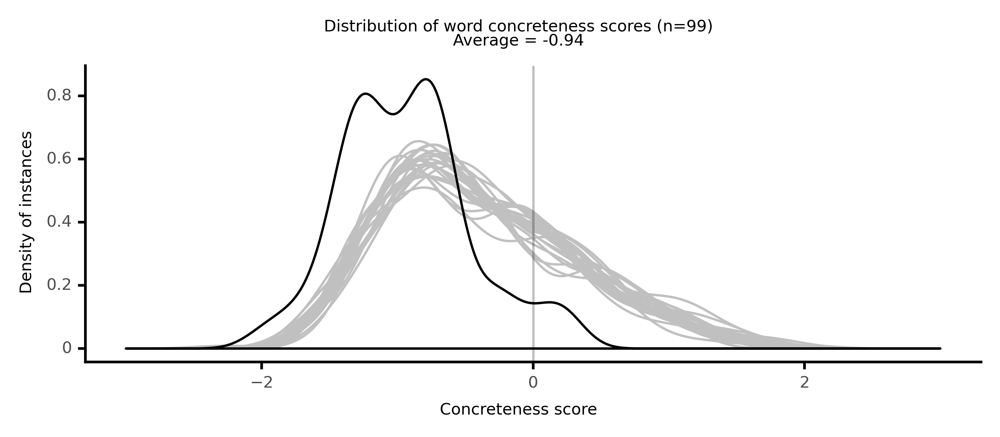

<ggplot: (8764116748457)>

 56%|█████▌    | 56/100 [12:07<09:02, 12.32s/it]

#### #57 most abstract passage: Holcroft, _The Adventures of Hugh Trevor_ (1794)

<p>with the most <abs><conc006>unqualified</conc006></abs> <abs><conc002>disregard</conc002></abs> to all that <abs><conc010>rectitude</conc010></abs> <abs><conc072>demands</conc072></abs>, would be to act the <abs><conc189>cowardly</conc189></abs> <abs><conc008>disingenuous</conc008></abs> <neither><conc273>hypocrite</conc273></neither>; and entirely to <abs><conc212>forget</conc212></abs> the first and best <abs><conc155>duties</conc155></abs> of <abs><conc161>friendship</conc161></abs>. Should you ask--'What <neither><conc416>path</conc416></neither> then am I to <abs><conc196>pursue</conc196></abs>?' I own I am <abs><conc135>totally</conc135></abs> at a <neither><conc241>loss</conc241></neither> for an <abs><conc148>answer</conc148></abs>. The <abs><conc145>choice</conc145></abs> must be left to yourself. You are not <abs><conc041>ignorant</conc041></abs> that it is <abs><conc108>infinitely</conc108></abs> more <neither><conc269>easy</conc269></neither> to <neither><conc317>point</conc317></neither> out <abs><conc072>mistakes</conc072></abs>, which have been and still <abs><conc206>continue</conc206></abs> to be <abs><conc134>committed</conc134></abs> <neither><conc237>daily</conc237></neither>, than to <abs><conc188>teach</conc188></abs> how they may be entirely <abs><conc175>avoided</conc175></abs>. Of this I am well <abs><conc146>assured</conc146></abs>, if you will <abs><conc101>confide</conc101></abs> in and <abs><conc071>exert</conc071></abs> those <abs><conc054>powers</conc054></abs> of mind that you <abs><conc161>possess</conc161></abs>; they must <neither><conc312>led</conc312></neither> you to a <abs><conc135>degree</conc135></abs> of <abs><conc063>happiness</conc063></abs> of the <abs><conc088>enjoyment</conc088></abs> of which, I am sorry to say, but few are <abs><conc107>capable</conc107></abs>. From my own <abs><conc033>experience</conc033></abs> and from that of all the <neither><conc718>young</conc718></neither> men I <neither><conc336>meet</conc336></neither>, who are <neither><conc697>thrown</conc697></neither> upon the world, I find that the perjod which is most <abs><conc102>critical</conc102></abs> and full of <abs><conc124>danger</conc124></abs>, is the one during which they are <abs><conc231>obliged</conc231></abs> <abs><conc048>unsupported</conc048></abs> to <neither><conc243>seek</conc243></neither> a <neither><conc280>grateful</conc280></neither> and <abs><conc116>worthy</conc116></abs> way of <abs><conc110>employing</conc110></abs> their <abs><conc079>talents</conc079></abs>. My own <abs><conc187>resource</conc187></abs> has been that of <abs><conc094>cheerfully</conc094></abs> <abs><conc003>submitting</conc003></abs> to what are <neither><conc481>called</conc481></neither> the <abs><conc152>hardships</conc152></abs> of <abs><conc182>obscure</conc182></abs> <abs><conc163>poverty</conc163></abs>; and of <abs><conc136>consoling</conc136></abs> myself, not only with a <neither><conc300>firm</conc300></neither> <abs><conc067>persuasion</conc067></abs> that by this course in time I shall <abs><conc151>infallibly</conc151></abs> <neither><conc260>change</conc260></neither> the <neither><conc407>scene</conc407></neither>, but that, till this time shall come, I am <abs><conc110>employing</conc110></abs> myself on the <abs><conc046>Subject</conc046></abs>'s which can best <neither><conc266>afford</conc266></neither> me present <abs><conc060>satisfaction</conc060></abs>. That is, in <abs><conc078>endeavours</conc078></abs>, however <neither><conc528>narrow</conc528></neither> and <abs><conc210>feeble</conc210></abs>, to <abs><conc138>enlarge</conc138></abs> the <neither><conc242>boundaries</conc242></neither> of <abs><conc115>human</conc115></abs> <abs><conc063>happiness</conc063></abs>; and by means Like these to find a <abs><conc220>sufficiency</conc220></abs> for my own <abs><conc132>support</conc132></abs>. I know not that I aught to <abs><conc127>advice</conc127></abs> you to <abs><conc196>pursue</conc196></abs> a similar <abs><conc172>plan</conc172></abs>: though I can truly say I am <abs><conc159>unacquainted</conc159></abs> with any other, which is <abs><conc084>equally</conc084></abs> <neither><conc250>promising</conc250></neither>. How to <abs><conc148>answer</conc148></abs> or <abs><conc154>appease</conc154></abs> the <abs><conc171>imperious</conc171></abs> <abs><conc072>demands</conc072></abs> of your present <abs><conc019>ruling</conc019></abs> <abs><conc175>passion</conc175></abs> I can not <neither><conc244>devise</conc244></neither>. Neither can I say that I am <abs><conc049>convinced</conc049></abs> it is <abs><conc006>blameable</conc006></abs> except in its <abs><conc198>excess</conc198></abs>. That you should <abs><conc119>desire</conc119></abs> to obtain so so <neither><conc539>rare</conc539></neither> and <neither><conc257>inestimable</conc257></neither> a <neither><conc393>treasure</conc393></neither> as that of a woman who, not to <abs><conc155>insist</conc155></abs> upon her <abs><conc194>peculiar</conc194></abs> <neither><conc572>beauty</conc572></neither>, is <abs><conc159>possessed</conc159></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

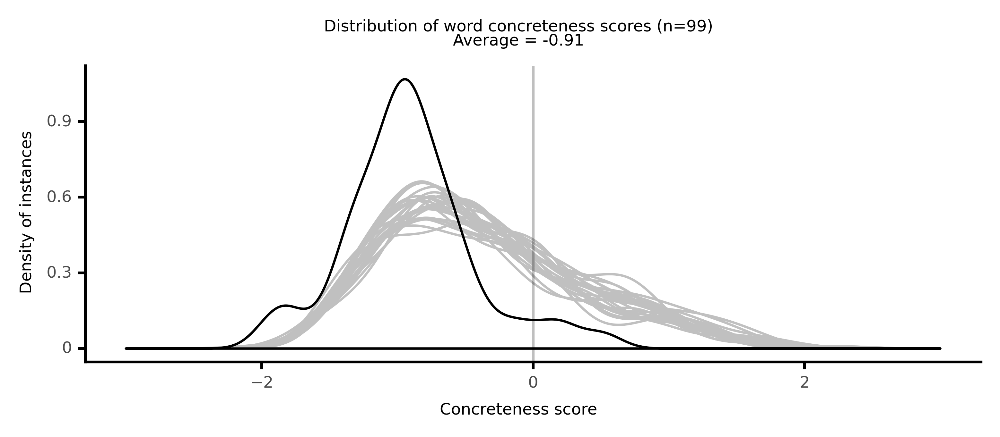

<ggplot: (8764118620917)>

 57%|█████▋    | 57/100 [12:21<09:02, 12.63s/it]

#### #58 most abstract passage: Orrery, _Parthenissa, Part 2 (1655)_ (1655)

<p>'s to make <abs><conc038>unworthy</conc038></abs> your <abs><conc077>affection</conc077></abs>, by <abs><conc070>conferring</conc070></abs> hers on you? No Sir, I <abs><conc150>beseech</conc150></abs> you let me <abs><conc116>follow</conc116></abs> my <abs><conc094>resolution</conc094></abs>, which is, to <neither><conc556>die</conc556></neither> Perolla's, since I could not live his: for my <neither><conc389>heart</conc389></neither>( after such a <neither><conc455>lose</conc455></neither>) is not <abs><conc026>capable</conc026></abs> of any <abs><conc118>Passion</conc118></abs>, but <neither><conc410>grief</conc410></neither>, or if it be, that <abs><conc118>passion</conc118></abs> I had for his <neither><conc283>virtues</conc283></neither>, I must now <abs><conc168>continue</conc168></abs> to his <neither><conc242>memory</conc242></neither>. To which Hannibal answered, Will you then <abs><conc125>confer</conc125></abs> a <abs><conc211>blessing</conc211></abs> upon one which is not <abs><conc026>capable</conc026></abs> of it, to <abs><conc011>deny</conc011></abs> it to another who is, and perhaps <abs><conc135>deserves</conc135></abs> it too: Ah Madam, if it is your <abs><conc077>affection</conc077></abs> for Perolla,& not your <abs><conc066>hatred</conc066></abs> for Hannibal which <neither><conc328>produces</conc328></neither> this <abs><conc091>resolve</conc091></abs>, you will <abs><conc010>evince</conc010></abs> that <abs><conc040>truth</conc040></abs> <neither><conc603>sooner</conc603></neither> by <abs><conc021>granting</conc021></abs> than <neither><conc423>declining</conc423></neither> my <neither><conc258>request</conc258></neither>, for if in the other Life we are not <abs><conc041>ignorant</conc041></abs> of what is done in this; Perolla will be more <abs><conc117>satisfied</conc117></abs> to know by your giving your self now to me, that he only <abs><conc221>hindered</conc221></abs> it hitherto, than by your <abs><conc208>refusing</conc208></abs> me <abs><conc010>absolutely</conc010></abs> that <abs><conc080>felicity</conc080></abs>; since that may appear rather an effect of your <abs><conc059>aversion</conc059></abs> for me, than your <abs><conc015>respect</conc015></abs> to him. I am Sir( I replied) of a <abs><conc061>contrary</conc061></abs> <abs><conc026>opinion</conc026></abs>, for my <abs><conc118>passion</conc118></abs> and my <abs><conc055>resentments</conc055></abs> for his <neither><conc455>lose</conc455></neither> will much more <neither><conc256>legible</conc256></neither> in their taking from me the <abs><conc171>ambition</conc171></abs> of being the <abs><conc040>object</conc040></abs> of great so a C& obar; querors Love; and in <abs><conc068>abandoning</conc068></abs> not only the <abs><conc183>pleasure</conc183></abs> of Life, but the <abs><conc076>desire</conc076></abs> of it too: I <neither><conc459>conjure</conc459></neither> you therefore by the <abs><conc170>quiet</conc170></abs> of Perolla, which you <abs><conc048>endeavour</conc048></abs> to <abs><conc211>disturb</conc211></abs>, <neither><conc329>torment</conc329></neither> me not by so <neither><conc297>fruitless</conc297></neither> a <abs><conc177>persecution</conc177></abs>, which if you <abs><conc047>persevere</conc047></abs> in, <neither><conc600>twill</conc600></neither> <abs><conc044>induce</conc044></abs> me rather to <abs><conc075>suppress</conc075></abs> the <abs><conc015>respect</conc015></abs> I <neither><conc398>pay</conc398></neither> you, than to <abs><conc116>create</conc116></abs> that <abs><conc077>affection</conc077></abs> you <abs><conc144>solicit</conc144></abs>, and <abs><conc189>force</conc189></abs> me to believe that Hannibal(& not the Gods) have taken away his Ryvall. It may be( <neither><conc297>continued</conc297></neither> Izadora) you will believe so great a Prince <abs><conc034>merited</conc034></abs> a <abs><conc120>proportionate</conc120></abs> <abs><conc015>respect</conc015></abs>, but I must <abs><conc003>acknowledge</conc003></abs>, I was not in an <neither><conc500>humour</conc500></neither> to <neither><conc255>afford</conc255></neither> it him, neither do I believe I could give him a worse <abs><conc026>opinion</conc026></abs> of me by my replies, than he seemed to have of me by his <abs><conc043>desires</conc043></abs>; but after by his looks he had <abs><conc123>expressed</conc123></abs> what his <abs><conc088>answer</conc088></abs> would be, he told me; You think Madam to <abs><conc217>silence</conc217></abs> my <abs><conc118>Passion</conc118></abs> with <abs><conc201>reproaches</conc201></abs>, to <abs><conc173>avoid</conc173></abs> <abs><conc090>ingratitude</conc090></abs> by becoming <abs><conc012>unjust</conc012></abs>,& by <abs><conc135>accusing</conc135></abs> my <abs><conc201>innocency</conc201></abs> to <abs><conc108>decline</conc108></abs> being a <neither><conc243>debtor</conc243></neither> to my <neither><conc729>Flame</conc729></neither>; but know, that your <neither><conc295>cruelty</conc295></neither> may <abs><conc044>induce</conc044></abs> me to <abs><conc198>revenge</conc198></abs> what I can not obtain, and though you have <abs><conc151>avoided</conc151></abs> any <abs><conc150>impressions</conc150></abs> of my Love, some that you are <abs><conc070>concerned</conc070></abs> in may not those of my <abs><conc055>resentments</conc055></abs>. <neither><conc274>Tyrant</conc274></neither>( I replied) while Perolla was <neither><conc628>alive</conc628></neither> I <abs><conc036>considered</conc036></abs> thy <abs><conc099>threatenings</conc099></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

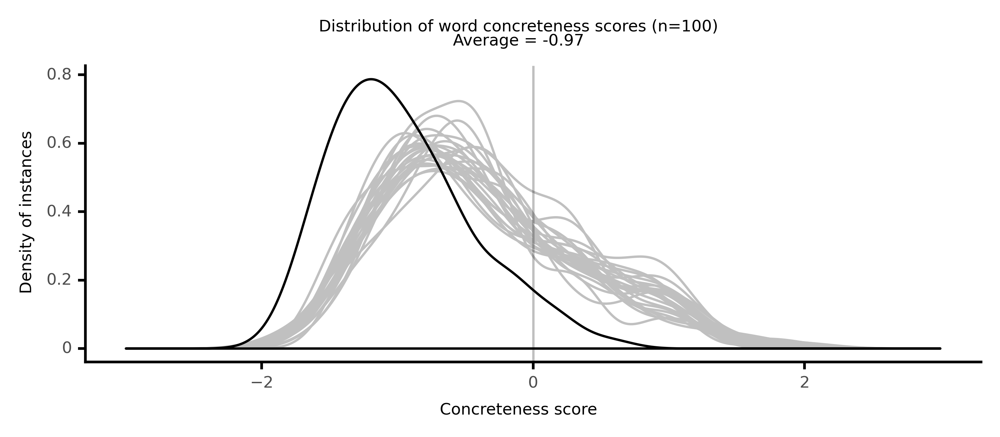

<ggplot: (8764106973193)>

 58%|█████▊    | 58/100 [12:31<08:17, 11.85s/it]

#### #59 most abstract passage: Brackenridge, _Modern Chivalry: Containing the Adventures of a Ca_ (1804)

<p><abs><conc022>law</conc022></abs>, whose <abs><conc098>maxim</conc098></abs> it was, no one is <neither><conc286>bound</conc286></neither> to <abs><conc139>accuse</conc139></abs> himself.'' It is a <abs><conc143>special</conc143></abs> case out of the <abs><conc129>general</conc129></abs> <abs><conc033>principle</conc033></abs>: and there is good <abs><conc020>reason</conc020></abs> for the <neither><conc336>exception</conc336></neither>. But whither <abs><conc020>reason</conc020></abs>, or not, the <neither><conc336>exception</conc336></neither> is as old as the <abs><conc033>principle</conc033></abs>. For this <abs><conc230>proceeding</conc230></abs>, and such <neither><conc323>interrogation</conc323></neither> is of <neither><conc364>immemorial</conc364></neither> <abs><conc174>usage</conc174></abs>; it is as old as the <abs><conc130>constitution</conc130></abs> of the <abs><conc196>courts</conc196></abs> themselves. If our <abs><conc130>constitution</conc130></abs> had <abs><conc223>meant</conc223></abs> to do away this <neither><conc336>exception</conc336></neither>, it would have <neither><conc284>voted</conc284></neither> it in <abs><conc116>express</conc116></abs> terms; more especially as it had been <abs><conc099>exercised</conc099></abs> by the <abs><conc196>courts</conc196></abs> before the <neither><conc327>formation</conc327></neither> of the <abs><conc130>constitution</conc130></abs>; and by <abs><conc045>implication</conc045></abs> <abs><conc213>recognized</conc213></abs> by the <abs><conc204>legislature</conc204></abs> itself, in the case of Oswald, taken up by the <neither><conc597>house</conc597></neither>. But the <abs><conc130>constitution</conc130></abs> gives the <abs><conc196>courts</conc196></abs>, the <abs><conc035>powers</conc035></abs> usually <abs><conc099>exercised</conc099></abs>.'' This <abs><conc028>power</conc028></abs> was usually <abs><conc099>exercised</conc099></abs>, and therefore it is given. But there is <abs><conc020>reason</conc020></abs> for it, <abs><conc109>independent</conc109></abs> of <abs><conc022>law</conc022></abs>, and <abs><conc130>constitution</conc130></abs>. The <abs><conc019>administration</conc019></abs> of <abs><conc027>justice</conc027></abs> <abs><conc186>requires</conc186></abs> it. How can I fix a <abs><conc136>libel</conc136></abs> on the <abs><conc072>author</conc072></abs>? The <abs><conc035>presumption</conc035></abs> is, that my <abs><conc224>adversary</conc224></abs> in the cause depending, is the <abs><conc072>author</conc072></abs> of the <neither><conc303>writing</conc303></neither> that affects the <abs><conc076>merits</conc076></abs> of it. On this <abs><conc035>presumption</conc035></abs> the <abs><conc022>law</conc022></abs> gives me a right to call upon him. Who else can be <abs><conc181>supposed</conc181></abs> to <abs><conc240>interfere</conc240></abs> but my <abs><conc224>adversary</conc224></abs>; or some one with his <abs><conc081>privity</conc081></abs>? The <abs><conc025>necessity</conc025></abs> of the case <abs><conc001>justifies</conc001></abs> this <neither><conc336>exception</conc336></neither> to the <abs><conc129>general</conc129></abs> <abs><conc103>rule</conc103></abs>. He may go on behind the <neither><conc513>scene</conc513></neither> and <abs><conc083>prejudice</conc083></abs> the <abs><conc049>public</conc049></abs> mind against me and my cause, and leave me to my <abs><conc088>redress</conc088></abs> afterwards. The <abs><conc022>law</conc022></abs> will not allow this. If it is not a <abs><conc033>principle</conc033></abs> of the <abs><conc022>law</conc022></abs>, it aught to be a <abs><conc033>principle</conc033></abs>. But it is a <abs><conc033>principle</conc033></abs> as old as our Saxon <neither><conc267>ancestry</conc267></neither>, from whom the <abs><conc179>trial</conc179></abs> by <neither><conc283>jury</conc283></neither> is <abs><conc153>derived</conc153></abs>. It is <abs><conc170>coeval</conc170></abs> with the <abs><conc179>trial</conc179></abs> by <neither><conc283>jury</conc283></neither>, and necessary to its <abs><conc252>preservation</conc252></abs>. It is a <abs><conc098>safeguard</conc098></abs> of the <abs><conc179>trial</conc179></abs> in which the <neither><conc448>bulk</conc448></neither> of the people are especially <abs><conc249>interested</conc249></abs>. Before they give it up let them think. Leave it to the suitors in <neither><conc279>court</conc279></neither>, and at least one side will always <abs><conc162>object</conc162></abs> to it; probably both. All that wish a <neither><conc381>fair</conc381></neither> and <abs><conc006>unprejudiced</conc006></abs> <abs><conc112>decision</conc112></abs> will <abs><conc162>object</conc162></abs> to it. They will not be <abs><conc180>satisfied</conc180></abs> with being <neither><conc548>turned</conc548></neither> <conc><conc952>round</conc952></conc> to an <neither><conc272>indictment</conc272></neither>, and the <neither><conc379>slow</conc379></neither> <neither><conc311>process</conc311></neither> of a <neither><conc283>jury</conc283></neither> <abs><conc179>trial</conc179></abs> to <abs><conc104>establish</conc104></abs> the <abs><conc067>fact</conc067></abs> of the <abs><conc136>libel</conc136></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

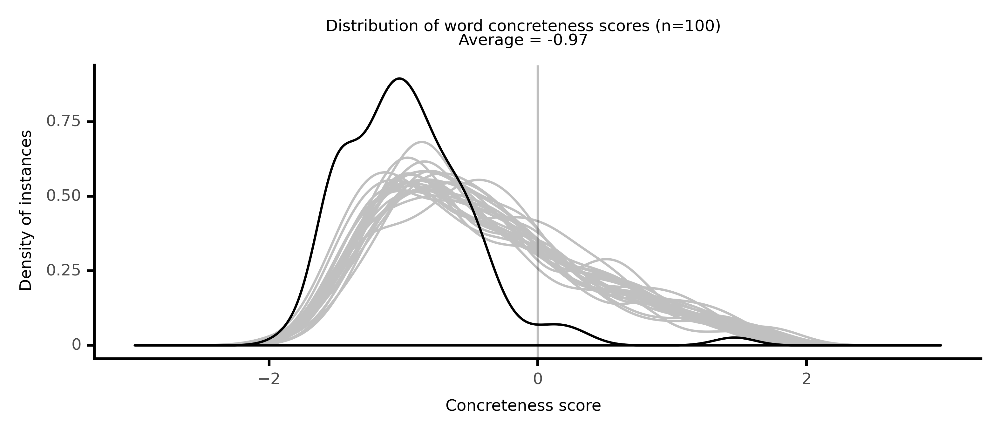

<ggplot: (8764105171585)>

 59%|█████▉    | 59/100 [12:40<07:39, 11.22s/it]

#### #60 most abstract passage: Orrery, _Parthenissa, Part 3 (1655)_ (1655)

<p>, <neither><conc407>invite</conc407></neither> them to <neither><conc246>dullness</conc246></neither> and <abs><conc145>vice</conc145></abs>; We by making <neither><conc316>desert</conc316></neither> the way unto it; <abs><conc009>necessitate</conc009></abs> them to <abs><conc181>virtue</conc181></abs>, and <abs><conc030>Merit</conc030></abs>; you by <abs><conc135>trusting</conc135></abs> the <abs><conc024>Power</conc024></abs> to one run a <abs><conc156>hazard</conc156></abs> which we <abs><conc173>avoid</conc173></abs>, for there needs but <abs><conc101>imbecility</conc101></abs>, or <abs><conc151>corruption</conc151></abs> in One, to <abs><conc203>ruin</conc203></abs> All, but we <abs><conc135>trusting</conc135></abs> to <neither><conc377>diverse</conc377></neither>, many a One must be <neither><conc260>weak</conc260></neither>,& <neither><conc239>perfidious</conc239></neither>, to <abs><conc116>create</conc116></abs> our <abs><conc229>misfortunes</conc229></abs>; and none being <abs><conc008>absolute</conc008></abs>,'this <abs><conc027>Reason</conc027></abs>,& not <abs><conc024>Power</conc024></abs>, which <abs><conc171>forms</conc171></abs> our results and <abs><conc004>actions</conc004></abs>. To <abs><conc103>omit</conc103></abs> many other <abs><conc106>preeminencies</conc106></abs>, C& obar; mon-wealths are not <abs><conc027>subject</conc027></abs> to <abs><conc001>personal</conc001></abs> <abs><conc149>vices</conc149></abs>, as <neither><conc442>Lust</conc442></neither>, <neither><conc289>Avarice</conc289></neither>, <neither><conc338>Luxury</conc338></neither>, <abs><conc182>Inconstancy</conc182></abs> and <neither><conc295>Cruelty</conc295></neither>. That there is( I replied) a <abs><conc020>necessity</conc020></abs> of a <abs><conc022>Supreme</conc022></abs> <abs><conc024>power</conc024></abs> in all <abs><conc086>Governments</conc086></abs> to whom <abs><conc040>final</conc040></abs> <abs><conc025>appeals</conc025></abs> and <abs><conc029>resolutions</conc029></abs> are to be left( to <abs><conc173>avoid</conc173></abs> <abs><conc161>perpetual</conc161></abs> <abs><conc043>disputes</conc043></abs> and <abs><conc076>uncertainties</conc076></abs>) is not more <abs><conc089>true</conc089></abs>, than that <abs><conc024>Power</conc024></abs> is <abs><conc010>absolutely</conc010></abs> best <abs><conc212>invested</conc212></abs> in a <neither><conc239>Monarch</conc239></neither>; which to <abs><conc010>evince</conc010></abs>, I shall <abs><conc076>desire</conc076></abs> you but to <abs><conc077>reflect</conc077></abs> on the greatest <abs><conc137>States</conc137></abs>& <neither><conc319>Empires</conc319></neither> that were, or are, and you shall find,'it from the <abs><conc181>virtue</conc181></abs> of one Man they had their Beginning or <abs><conc049>Laws</conc049></abs>. Moses made those of the Jews; Lycurgus those of Sparta; Solon those of Athens( though indeed of <neither><conc342>short</conc342></neither> <abs><conc079>duration</conc079></abs>) Nimrod the <neither><conc346>Empire</conc346></neither> of Babylon, Arsaces that of the Parthians; Alexander that of the Grecians; Cyrus that of the Persians; and to <abs><conc103>omit</conc103></abs> many others, Romulus that of Rome;&'this a <abs><conc072>Maxime</conc072></abs> as <abs><conc074>general</conc074></abs> as <abs><conc089>true</conc089></abs>, That what <abs><conc160>creates</conc160></abs>, is the best to <abs><conc103>perfect</conc103></abs>& <neither><conc256>preserve</conc256></neither>. Neither when <abs><conc181>Monarchy</conc181></abs> was <neither><conc346>banished</conc346></neither> from Rome, was there any <abs><conc111>mutation</conc111></abs> in the <abs><conc057>monarchical</conc057></abs> <abs><conc049>Laws</conc049></abs>, but the <abs><conc216>change</conc216></abs> of <abs><conc161>Perpetual</conc161></abs> <neither><conc323>Kings</conc323></neither> into <neither><conc442>annual</conc442></neither> Consulls:'T is too, no <conc><conc797>small</conc797></conc> <abs><conc022>manifestation</conc022></abs> that <abs><conc181>Monarchy</conc181></abs> is the best <abs><conc227>form</conc227></abs>, seeing'this the <abs><conc032>Government</conc032></abs> of <neither><conc337>Heaven</conc337></neither>: Besides, that which is the most <abs><conc126>desirable</conc126></abs> and the <neither><conc642>seldomest</conc642></neither> found in <abs><conc136>Aristocracies</conc136></abs>, Oligarchies, and Democracyes, is almost <abs><conc067>inseparable</conc067></abs> from <abs><conc181>Monarchy</conc181></abs>, which is, an <abs><conc216>internal</conc216></abs> <abs><conc170>quiet</conc170></abs> that <abs><conc072>proceeds</conc072></abs> from a <abs><conc074>general</conc074></abs> <abs><conc011>submission</conc011></abs> to one <abs><conc018>Authority</conc018></abs>, which is that, which gives a <abs><conc024>Power</conc024></abs> and <abs><conc024>ability</conc024></abs> to <abs><conc198>defend</conc198></abs> or <abs><conc196>enlarge</conc196></abs> a State; Whereas in <abs><conc170>Republiques</conc170></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

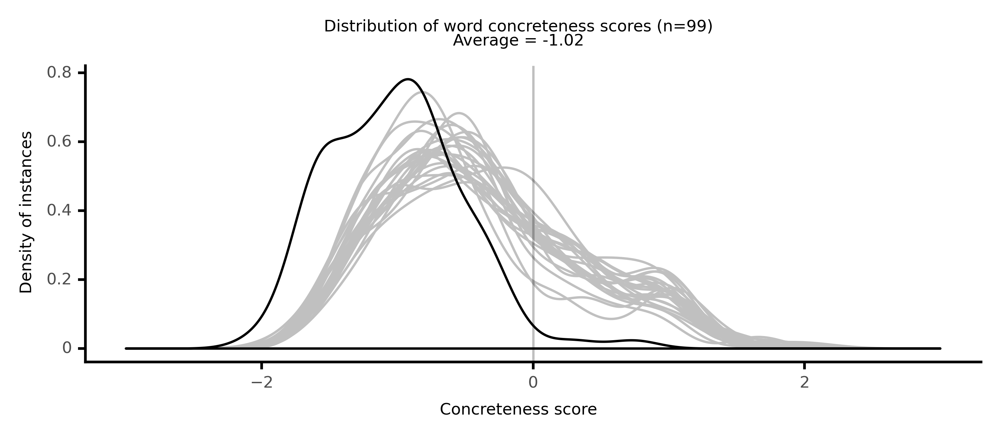

<ggplot: (8764102083969)>

 60%|██████    | 60/100 [12:51<07:21, 11.03s/it]

#### #61 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p><neither><conc430>examined</conc430></neither>; must appear with <abs><conc176>force</conc176></abs> to a <neither><conc368>modest</conc368></neither>, <abs><conc159>candid</conc159></abs>, <abs><conc030>impartial</conc030></abs> <abs><conc084>inquirer</conc084></abs>; and as the <neither><conc266>internal</conc266></neither> <abs><conc054>evidence</conc054></abs> for the <neither><conc283>sacred</conc283></neither> <neither><conc277>letters</conc277></neither>, their usefulness and <abs><conc150>excellence</conc150></abs>, must be <abs><conc066>obvious</conc066></abs> to every <abs><conc225>attentive</conc225></abs> <abs><conc007>capacity</conc007></abs>, that <neither><conc326>delights</conc326></neither> in the <abs><conc166>pursuit</conc166></abs> of <abs><conc043>religion</conc043></abs> and <abs><conc076>virtue</conc076></abs>. <abs><conc065>Truth</conc065></abs> and <abs><conc081>candor</conc081></abs>, then, those <abs><conc068>infidels</conc068></abs> are <neither><conc235>strangers</conc235></neither> to. They are not <conc><conc766>fair</conc766></conc> <abs><conc015>reasoners</conc015></abs>. They are <abs><conc225>haughty</conc225></abs>, <abs><conc055>overbearing</conc055></abs> <abs><conc061>declaimers</conc061></abs>.[ Side note:1Kb] Azora's <abs><conc082>notion</conc082></abs> of the <abs><conc041>incomprehensible</conc041></abs>, and the <abs><conc016>law</conc016></abs> of <abs><conc031>reason</conc031></abs>. Nor can I think much better( Azora said) of those great and <neither><conc315>reverend</conc315></neither> men, who <abs><conc169>preach</conc169></abs> and <neither><conc280>write</conc280></neither> to <abs><conc087>prove</conc087></abs> the <abs><conc061>weakness</conc061></abs> of <abs><conc115>human</conc115></abs> <abs><conc031>reason</conc031></abs>, and that the <neither><conc370>prime</conc370></neither> <abs><conc016>law</conc016></abs> of our <abs><conc197>creation</conc197></abs>, the <abs><conc016>law</conc016></abs> of <abs><conc083>nature</conc083></abs>, is <abs><conc102>imperfect</conc102></abs>, <abs><conc079>insufficient</conc079></abs>, and <abs><conc182>obscure</conc182></abs>; and therefore, <abs><conc044>supernatural</conc044></abs> <neither><conc273>communication</conc273></neither> was <abs><conc086>absolutely</conc086></abs> necessary; who <neither><conc380>add</conc380></neither> to this, things <neither><conc249>inconceivable</conc249></neither> and <abs><conc004>contradictory</conc004></abs>, and <abs><conc155>insist</conc155></abs> upon our <abs><conc065>believing</conc065></abs> <neither><conc310>articles</conc310></neither> too <neither><conc588>hard</conc588></neither> for <abs><conc003>rational</conc003></abs> <abs><conc103>beings</conc103></abs>. This is <abs><conc002>misrepresenting</conc002></abs> <abs><conc081>rationals</conc081></abs>, if we believe the <abs><conc070>scriptures</conc070></abs>, and is so far from being of <abs><conc185>service</conc185></abs> to the cause of <abs><conc033>christianity</conc033></abs>,( as in <abs><conc139>charity</conc139></abs> we must <neither><conc251>suppose</conc251></neither> those great men by such <abs><conc206>writing</conc206></abs> and <abs><conc097>preaching</conc097></abs> do <neither><conc353>intend</conc353></neither>) that it does, on the <abs><conc057>contrary</conc057></abs>, very <neither><conc316>greatly</conc316></neither> <neither><conc274>hurt</conc274></neither> <abs><conc040>revealed</conc040></abs> <abs><conc043>religion</conc043></abs>. It is to such <abs><conc085>wrong</conc085></abs> <abs><conc135>defences</conc135></abs> of <abs><conc017>revelation</conc017></abs> that <abs><conc036>antichristian</conc036></abs> <abs><conc021>deism</conc021></abs> <abs><conc218>owes</conc218></abs> its <abs><conc218>chief</conc218></abs> <neither><conc256>strength</conc256></neither>. Our <abs><conc194>holy</conc194></abs> <abs><conc043>religion</conc043></abs> wants not any real <abs><conc054>evidence</conc054></abs> that can be <neither><conc309>desired</conc309></neither> by the <neither><conc368>modest</conc368></neither>, <abs><conc159>candid</conc159></abs>, and <abs><conc030>impartial</conc030></abs>; but if great and <abs><conc101>learned</conc101></abs> men will <abs><conc057>deny</conc057></abs> the <neither><conc263>perfection</conc263></neither> of the <abs><conc080>primary</conc080></abs> <abs><conc016>law</conc016></abs> of God, and <neither><conc279>substitute</conc279></neither> in the place of recommunicated <abs><conc083>nature</conc083></abs>, an <neither><conc306>invented</conc306></neither> <abs><conc051>gospel</conc051></abs>, that <neither><conc709>swells</conc709></neither> with <neither><conc238>useless</conc238></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

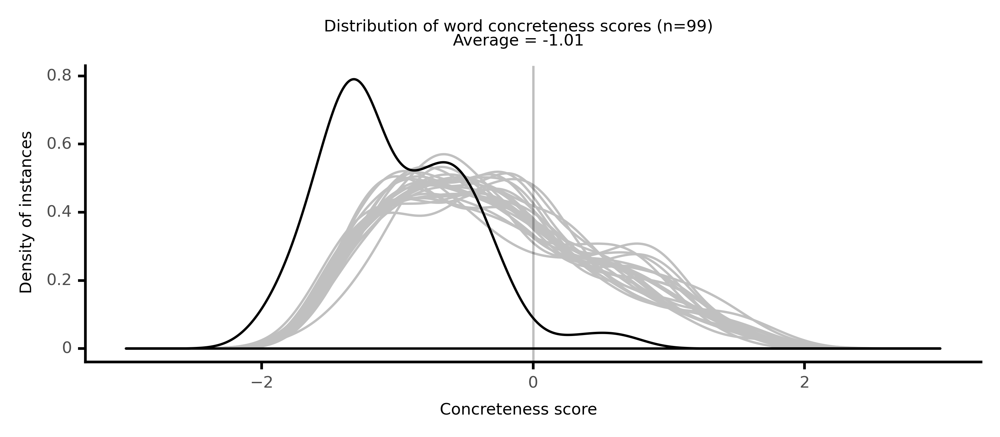

<ggplot: (8764110278761)>

 61%|██████    | 61/100 [13:06<08:00, 12.33s/it]

#### #62 most abstract passage: Holcroft, _The Adventures of Hugh Trevor_ (1794)

<p>you will <neither><conc287>read</conc287></neither> the <abs><conc110>defence</conc110></abs> of the <neither><conc310>articles</conc310></neither> and my <abs><conc148>answer</conc148></abs> again, with <neither><conc375>care</conc375></neither>. Either I am <abs><conc088>mistaken</conc088></abs> or you will find every thing you have said already <abs><conc101>confuted</conc101></abs>.' I <abs><conc171>endeavoured</conc171></abs> to <neither><conc302>divert</conc302></neither> him from this <abs><conc110>defence</conc110></abs> by <abs><conc063>reference</conc063></abs>, but he <neither><conc270>continued</conc270></neither> to <abs><conc084>urge</conc084></abs> that he should only <abs><conc073>weaken</conc073></abs> his cause by <abs><conc221>answering</conc221></abs> <abs><conc097>desultory</conc097></abs> <abs><conc068>arguments</conc068></abs> in a <abs><conc097>desultory</conc097></abs> way; which in the present case would be <abs><conc119>folly</conc119></abs>, because his <abs><conc148>answer</conc148></abs> was already given in a <neither><conc383>clear</conc383></neither> and as he <abs><conc143>believed</conc143></abs> <abs><conc060>conclusive</conc060></abs> manner. <abs><conc216>Finding</conc216></abs> his <neither><conc295>purpose</conc295></neither> not to be <neither><conc396>shaken</conc396></neither>, I <neither><conc336>asked</conc336></neither> him if he were <abs><conc099>aware</conc099></abs> that I was the <abs><conc077>author</conc077></abs> of the <abs><conc110>defence</conc110></abs> of the <neither><conc310>articles</conc310></neither>? He answered that, seeing the <abs><conc218>bishop</conc218></abs>'s name to the <abs><conc169>publication</conc169></abs>, he could not but <neither><conc251>suppose</conc251></neither> the <abs><conc218>bishop</conc218></abs> himself had been <abs><conc167>intimately</conc167></abs> <abs><conc062>concerned</conc062></abs> in the <abs><conc206>writing</conc206></abs> of the work: but, from what I had formerly told him, he had <abs><conc172>suspected</conc172></abs> me to be a <abs><conc110>fellow-labourer</conc110></abs>.'If so,' said I,'Mr. <abs><conc081>Turl</conc081></abs>, how did it <neither><conc262>happen</conc262></neither> that you felt no <abs><conc112>aversion</conc112></abs> to the <abs><conc048>confutation</conc048></abs>, as you <neither><conc251>suppose</conc251></neither>, of a man for whom you had <abs><conc045>professed</conc045></abs> a regard?' He replied,'you, Mr. Trevor, are well <neither><conc259>acquainted</conc259></neither> with my <abs><conc148>answer</conc148></abs>: Socrates is my friend, Plato is my friend, but <abs><conc065>truth</conc065></abs> is more my friend.'' If I myself had <neither><conc243>written</conc243></neither> <abs><conc120>falsehood</conc120></abs> <neither><conc511>yesterday</conc511></neither>, and now knew it to be such, I would <abs><conc148>answer</conc148></abs> it to day. Would not you?' It was a home <abs><conc103>question</conc103></abs>, and I was <neither><conc389>silent</conc389></neither>. This <abs><conc046>subject</conc046></abs> <neither><conc313>ended</conc313></neither>, he made some <neither><conc392>kind</conc392></neither> and <neither><conc417>cordial</conc417></neither> <abs><conc084>inquiries</conc084></abs> concerning my present <abs><conc036>pursuits</conc036></abs>, and these <neither><conc581>furnished</conc581></neither> the <neither><conc259>opportunity</conc259></neither> of unburdening my <neither><conc325>heart</conc325></neither>. I related to him, with all the <abs><conc117>indignation</conc117></abs> which <abs><conc076>resentment</conc076></abs> <abs><conc040>inspired</conc040></abs>, my whole <abs><conc144>history</conc144></abs>; and <neither><conc313>ended</conc313></neither> with <abs><conc147>informing</conc147></abs> him of my <abs><conc033>determination</conc033></abs> to <abs><conc155>publish</conc155></abs> the <abs><conc146>vice</conc146></abs> and <abs><conc188>infamy</conc188></abs> of all the <abs><conc167>parties</conc167></abs> to the world. On this a <neither><conc307>dialogue</conc307></neither> <neither><conc357>began</conc357></neither>.'Which way will you <abs><conc155>publish</conc155></abs> them?''In a <abs><conc170>narrative</conc170></abs>, that I am now <abs><conc206>writing</conc206></abs>.'' A <abs><conc039>sense</conc039></abs> of <abs><conc135>duty</conc135></abs> has <abs><conc231>obliged</conc231></abs> me to tell you that, in my <abs><conc033>opinion</conc033></abs>, you have been <abs><conc111>guilty</conc111></abs> of several <abs><conc072>mistakes</conc072></abs> already: you are now <neither><conc278>intent</conc278></neither> upon another.''How so?' The <abs><conc198>excess</conc198></abs> of your <abs><conc186>anger</conc186></abs> <abs><conc006>perverts</conc006></abs> your <abs><conc016>judgement</conc016></abs>, and you can not <neither><conc280>write</conc280></neither> such a <abs><conc170>narrative</conc170></abs> without <neither><conc436>keeping</conc436></neither> your <abs><conc175>passion</conc175></abs> in a <abs><conc166>vitiated</conc166></abs> state. Owing to the <abs><conc044>prejudices</conc044></abs> of <abs><conc017>mankind</conc017></abs>, you will <abs><conc050>impeach</conc050></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

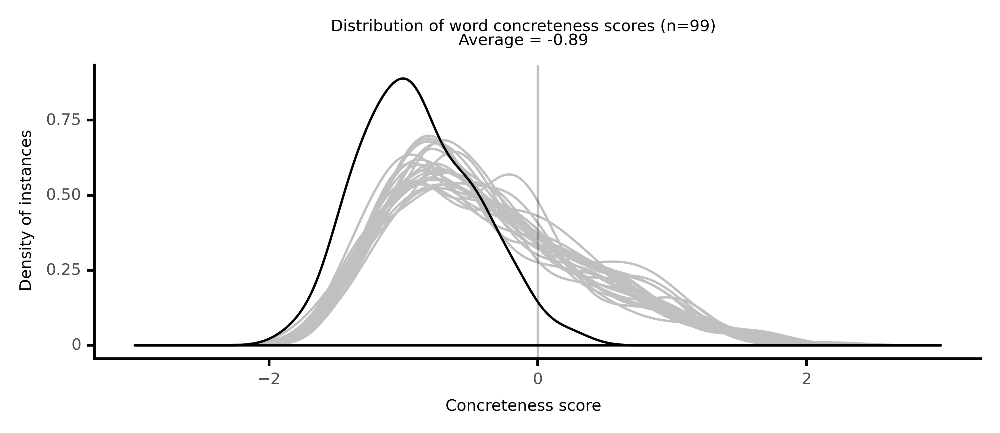

<ggplot: (8764109921485)>

 62%|██████▏   | 62/100 [13:19<07:54, 12.49s/it]

#### #63 most abstract passage: Cooper, _The Sea Lions; or, The Lost Sealers Volume 1 (1849_ (1849)

<p>and most <abs><conc072>natural</conc072></abs>, as well as the most just <abs><conc179>mode</conc179></abs> of <neither><conc419>disposing</conc419></neither> of them. Such a <abs><conc050>government</conc050></abs>, well <neither><conc263>administered</conc263></neither>, and with an <abs><conc196>accurate</conc196></abs> <abs><conc121>observance</conc121></abs> of its <abs><conc048>governing</conc048></abs> <abs><conc016>principles</conc016></abs>, would probably be the best that <abs><conc115>human</conc115></abs> <abs><conc037>infirmity</conc037></abs> will allow men to <abs><conc204>administer</conc204></abs>; but when the <abs><conc259>capital</conc259></abs> <abs><conc229>mistake</conc229></abs> is made of supposing that <abs><conc066>mere</conc066></abs> <neither><conc287>numbers</conc287></neither> are to <abs><conc124>control</conc124></abs> all things, regardless of those great <abs><conc054>fundamental</conc054></abs> <abs><conc048>laws</conc048></abs> that the state has <abs><conc204>adopted</conc204></abs> for its own <abs><conc127>restraint</conc127></abs>, it may be <abs><conc239>questioned</conc239></abs> if so <abs><conc249>lose</conc249></abs>, and <abs><conc257>capricious</conc257></abs>, and <abs><conc111>selfish</conc111></abs> a system, is not in great <abs><conc122>danger</conc122></abs> of becoming the very worst <abs><conc112>scheme</conc112></abs> of <abs><conc068>polity</conc068></abs> that <abs><conc124>cupidity</conc124></abs> ever <neither><conc564>set</conc564></neither> in <neither><conc399>motion</conc399></neither>. The <abs><conc060>tendency</conc060></abs>-- not the <abs><conc008>spirit</conc008></abs> of the <abs><conc089>institutions</conc089></abs>, the two things being the very <abs><conc159>antipodes</conc159></abs> of each other, though <abs><conc256>common</conc256></abs> <abs><conc040>minds</conc040></abs> are so <abs><conc194>apt</conc194></abs> to <abs><conc216>confound</conc216></abs> them-- the <abs><conc060>tendency</conc060></abs> of the <abs><conc089>institutions</conc089></abs> of this country, in <abs><conc020>flagrant</conc020></abs> <abs><conc019>opposition</conc019></abs> to their <abs><conc008>spirit</conc008></abs> or <abs><conc112>intentions</conc112></abs>, which were <abs><conc219>devised</conc219></abs> <abs><conc262>expressly</conc262></abs> to <abs><conc162>restrain</conc162></abs> the <abs><conc069>disposition</conc069></abs> of men to innovate, is out of all <abs><conc153>question</conc153></abs> to <neither><conc296>foster</conc296></neither> this great <abs><conc050>abuse</conc050></abs>, and to place <neither><conc287>numbers</conc287></neither> above <abs><conc016>principles</conc016></abs>, even when the <abs><conc016>principles</conc016></abs> were <neither><conc399>solemnly</conc399></neither> <abs><conc204>adopted</conc204></abs> <abs><conc262>expressly</conc262></abs> to bring <neither><conc287>numbers</conc287></neither> under the <abs><conc124>control</conc124></abs> of a found <abs><conc054>fundamental</conc054></abs> <abs><conc022>law</conc022></abs>. This <abs><conc082>influence</conc082></abs> of <neither><conc287>numbers</conc287></neither>, this <neither><conc297>dire</conc297></neither> <abs><conc229>mistake</conc229></abs> of the very <abs><conc041>nature</conc041></abs> of <abs><conc056>liberty</conc056></abs>, by <neither><conc659>placing</conc659></neither> men and their <abs><conc169>passion</conc169></abs> above those great <abs><conc048>laws</conc048></abs> of right which come <abs><conc044>direct</conc044></abs> from God himself, is <abs><conc249>increasing</conc249></abs> in <abs><conc166>force</conc166></abs>, and <abs><conc259>threatens</conc259></abs> <abs><conc025>consequences</conc025></abs> which may <neither><conc564>set</conc564></neither> at nought all the well-devised <abs><conc106>schemes</conc106></abs> of the last <abs><conc191>generation</conc191></abs> for the <abs><conc145>security</conc145></abs> of the state, and the <abs><conc149>happiness</conc149></abs> of that very people, who can never know either <abs><conc145>security</conc145></abs> or even <abs><conc093>peace</conc093></abs>, until they <abs><conc234>learn</conc234></abs> to <abs><conc062>submit</conc062></abs> themselves, without a thought of <abs><conc164>resistance</conc164></abs>, to those great <abs><conc135>rules</conc135></abs> of right which in <abs><conc013>truth</conc013></abs> from the <abs><conc008>spirit</conc008></abs> of their <abs><conc089>institutions</conc089></abs>, and which are only too often in <abs><conc019>opposition</conc019></abs> to their own <abs><conc103>impulses</conc103></abs> and <abs><conc014>motives</conc014></abs>. We <abs><conc160>pretend</conc160></abs> to no <abs><conc045>knowledge</conc045></abs> on the <abs><conc047>subject</conc047></abs> of the <neither><conc400>dates</conc400></neither> of <abs><conc178>discoveries</conc178></abs> in the <neither><conc273>arts</conc273></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

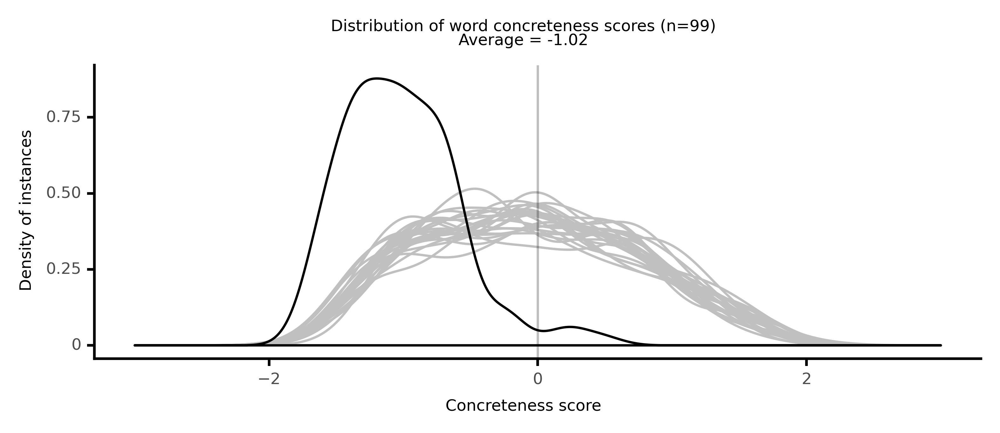

<ggplot: (8764096873345)>

 63%|██████▎   | 63/100 [13:30<07:17, 11.81s/it]

#### #64 most abstract passage: Orrery, _Parthenissa, Part 3 (1655)_ (1655)

<p>you to keep, and which if you do <abs><conc084>deprive</conc084></abs> your self of, I will not live to <neither><conc385>lament</conc385></neither>. Oh Gods!( I cried out) I <abs><conc192>esteemed</conc192></abs> You hitherto the greatest <neither><conc295>Cruelty</conc295></neither>, but now( alas) I find Altezeera is: Those that gave me the <abs><conc020>necessity</conc020></abs> of <neither><conc267>Death</conc267></neither>, are less <abs><conc062>Tyrannical</conc062></abs>, than she that after <abs><conc223>hinders</conc223></abs> it; for they but <abs><conc087>impose</conc087></abs> on me a <neither><conc329>torment</conc329></neither>, yet allow me the <neither><conc535>cure</conc535></neither>; but she <abs><conc038>inflicts</conc038></abs> on me the former, and <abs><conc204>refuses</conc204></abs> me too the latter: you can not Madam( I <neither><conc297>continued</conc297></neither>) <abs><conc015>condemn</conc015></abs> this <neither><conc333>exclamation</conc333></neither>, for you are not <neither><conc323>reduced</conc323></neither> to the <abs><conc020>necessity</conc020></abs> of bannishing me, but <neither><conc238>reduce</conc238></neither> your self to it. Alas!'this not much Artavasdes <neither><conc350>implores</conc350></neither>;'this but your <abs><conc115>permission</conc115></abs> to <neither><conc596>languish</conc596></neither> away in your <neither><conc495>sight</conc495></neither>, an <neither><conc346>unfortunate</conc346></neither> Life, and a life which you have <abs><conc111>rendered</conc111></abs> so; my <abs><conc041>sufferings</conc041></abs> will <abs><conc010>evince</conc010></abs> your <neither><conc305>Innocence</conc305></neither>,& Pacorus can no more <abs><conc060>doubt</conc060></abs> I <abs><conc138>injure</conc138></abs> him, than I <abs><conc076>desire</conc076></abs> to do it, or you to <abs><conc124>permit</conc124></abs> it: will you then my Princess having <abs><conc174>denuded</conc174></abs> your self of all <abs><conc024>power</conc024></abs> to <abs><conc116>create</conc116></abs> my <abs><conc080>felicity</conc080></abs>, <neither><conc256>preserve</conc256></neither> enough to make me <abs><conc148>miserable</conc148></abs>? so <abs><conc148>miserable</conc148></abs> too, that'this as <abs><conc047>impossible</conc047></abs> for the Gods to make any so much as to make me more? Shall the <neither><conc326>unknown</conc326></neither> Pharasmanes have <abs><conc207>enjoyed</conc207></abs> a <abs><conc211>blessing</conc211></abs>, which is <abs><conc069>denied</conc069></abs> the <neither><conc278>innocent</conc278></neither> Artavasdes; and the <abs><conc204>discovery</conc204></abs> of his being so, must that <neither><conc407>invite</conc407></neither> you to <abs><conc031>punish</conc031></abs>, what you should <abs><conc128>reward</conc128></abs>? the Gods <abs><conc129>forbid</conc129></abs>. These words <neither><conc341>delivered</conc341></neither> with a <neither><conc624>tone</conc624></neither> and <abs><conc062>action</conc062></abs> not ill-suted to them, had so <neither><conc286>violent</conc286></neither> an <abs><conc107>influence</conc107></abs> on his to whom they were <neither><conc281>addressed</conc281></neither>, that for a good while she <neither><conc297>continued</conc297></neither> in <abs><conc217>silence</conc217></abs>, and I <neither><conc283>flattered</conc283></neither> my self with a <abs><conc110>hope</conc110></abs> that it was a <abs><conc103>consent</conc103></abs> to my <abs><conc196>Petition</conc196></abs>; but alas it <abs><conc109>proceeded</conc109></abs> from his not being <abs><conc026>capable</conc026></abs> of <abs><conc021>granting</conc021></abs> it; and I kept that <abs><conc110>hope</conc110></abs> no <neither><conc412>longer</conc412></neither> than she did his <abs><conc217>silence</conc217></abs>. Since( she replied) that I have <abs><conc122>divested</conc122></abs> my self of all <abs><conc024>power</conc024></abs> to make you <abs><conc181>happy</conc181></abs>, whither it were my <abs><conc148>fault</conc148></abs> or my <neither><conc386>misfortune</conc386></neither>, I am <abs><conc210>resolved</conc210></abs> to <abs><conc031>punish</conc031></abs> it, and it may be your <neither><conc237>Banishment</conc237></neither> is as upon that account, as on that of my honour; if you have not hitherto <abs><conc072>judged</conc072></abs> of my <abs><conc113>resentment</conc113></abs> by my <neither><conc455>lose</conc455></neither>, you can not now but do it by my <neither><conc379>penance</conc379></neither>, and you can not <abs><conc060>doubt</conc060></abs> I <abs><conc003>acknowledge</conc003></abs> my self <abs><conc020>culpable</conc020></abs>, when I vol& ubar; tarily <abs><conc039>submit</conc039></abs> to such a <abs><conc045>punishment</conc045></abs>; should you <neither><conc642>kill</conc642></neither> your self, you <neither><conc523>rob</conc523></neither> me of the <neither><conc356>noblest</conc356></neither> part of my <neither><conc390>Pennance</conc390></neither>,& would <abs><conc029>render</conc029></abs> the <abs><conc114>continuation</conc114></abs> of it as <abs><conc047>impossible</conc047></abs>, as just; If what I have told you formerly does not <abs><conc005>convince</conc005></abs> you how <neither><conc596>precious</conc596></neither> I <abs><conc072>esteem</conc072></abs> your Life, this that I have now, will certainly effect it; for I <abs><conc070>plead</conc070></abs> for yours, though in doing so, I <abs><conc070>plead</conc070></abs> against my own; neither( Artavasdes) can you <abs><conc015>justly</conc015></abs> appropriate to your self what you now did of <abs><conc127>misery</conc127></abs>,'this I only that can; for who makes a <neither><conc522>Freind</conc522></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

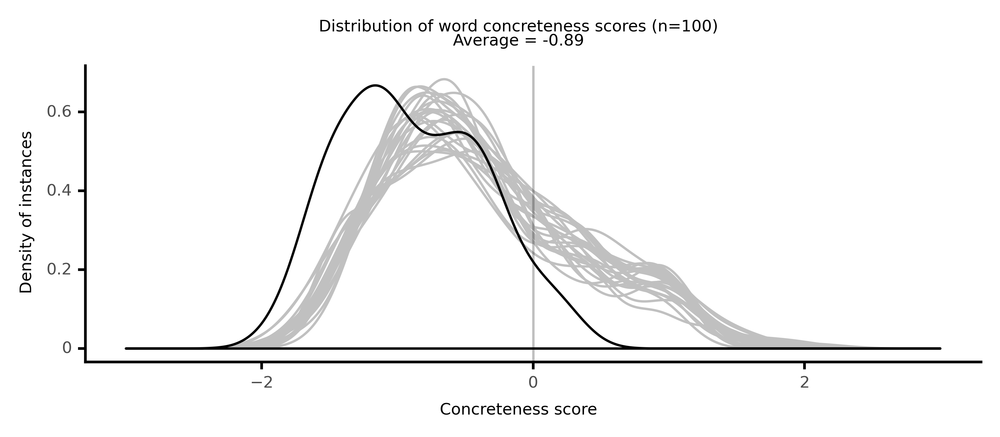

<ggplot: (8764102447833)>

 64%|██████▍   | 64/100 [13:41<06:56, 11.57s/it]

#### #65 most abstract passage: Opie, _Adeline Mowbray, Or The Mother And Daughter ..._ (1805)

<p>to which she <abs><conc223>meant</conc223></abs> to bequeathe her; and on these <abs><conc111>conditions</conc111></abs> she left him her <neither><conc281>blessing</conc281></neither>, and her <neither><conc274>pardon</conc274></neither>. The <neither><conc343>letter</conc343></neither> to <neither><conc536>colonel</conc536></neither> Mordaunt was <neither><conc561>long</conc561></neither>, and perhaps <abs><conc192>diffuse</conc192></abs>: but Adeline was <neither><conc285>jealous</conc285></neither> of his <abs><conc135>esteem</conc135></abs>, though regardless of his love; and as he had known her while <abs><conc168>acting</conc168></abs> under the <abs><conc082>influence</conc082></abs> of a <abs><conc176>fatal</conc176></abs> <abs><conc014>error</conc014></abs> of <abs><conc020>opinion</conc020></abs>, she <neither><conc354>wished</conc354></neither> to show him that on <abs><conc004>conviction</conc004></abs> she had <abs><conc248>abandoned</conc248></abs> her former way of <abs><conc217>thinking</conc217></abs>, and was <abs><conc079>candid</conc079></abs> enough to own that she had been <abs><conc094>wrong</conc094></abs>. You, no <abs><conc082>doubt</conc082></abs>,'' she said, are well <neither><conc291>acquainted</conc291></neither> with the <abs><conc045>arguments</conc045></abs> <abs><conc123>urged</conc123></abs> by different <abs><conc096>writers</conc096></abs> in <abs><conc142>favour</conc142></abs> of <neither><conc373>marriage</conc373></neither>. I shall therefore only <neither><conc321>mention</conc321></neither> the <abs><conc047>argument</conc047></abs> which <neither><conc495>carried</conc495></neither> at <neither><conc532>length</conc532></neither> full <abs><conc004>conviction</conc004></abs> to my mind, and <abs><conc199>conquered</conc199></abs> even my <neither><conc586>deep</conc586></neither> and <abs><conc131>heartfelt</conc131></abs> <abs><conc127>reverence</conc127></abs> for the <abs><conc013>opinions</conc013></abs> of one who <neither><conc561>long</conc561></neither> was, and ever will be, the <neither><conc454>dearest</conc454></neither> <abs><conc162>object</conc162></abs> of my love and <abs><conc125>regret</conc125></abs>. But he, had he <neither><conc460>lived</conc460></neither>, would I am sure have <neither><conc328>altered</conc328></neither> his <abs><conc034>sentiments</conc034></abs>; and had he been a <neither><conc339>parent</conc339></neither>, the <abs><conc047>argument</conc047></abs> I <abs><conc201>allude</conc201></abs> to, as it is <abs><conc105>founded</conc105></abs> on a <abs><conc090>consideration</conc090></abs> of the interest of children, would have found its way to his <abs><conc020>reason</conc020></abs>, through his <abs><conc228>affections</conc228></abs>. It is <abs><conc116>evident</conc116></abs> that on the <abs><conc162>education</conc162></abs> given to children must <abs><conc251>depend</conc251></abs> the <abs><conc094>welfare</conc094></abs> of the <abs><conc103>community</conc103></abs>; and, consequently, that whatever is likely to <abs><conc171>induce</conc171></abs> <neither><conc335>parents</conc335></neither> to <abs><conc085>neglect</conc085></abs> the <abs><conc162>education</conc162></abs> of their children must be <abs><conc091>hurtful</conc091></abs> to the <abs><conc094>welfare</conc094></abs> of the <abs><conc103>community</conc103></abs>. It is also certain, that though the <abs><conc124>agency</conc124></abs> of the <abs><conc169>passion</conc169></abs> be necessary to the <abs><conc055>existence</conc055></abs> of all <abs><conc147>society</conc147></abs>, it is on the <neither><conc364>cultivation</conc364></neither> and <abs><conc082>influence</conc082></abs> of the <abs><conc228>affections</conc228></abs> that the <abs><conc149>happiness</conc149></abs> and <abs><conc181>improvement</conc181></abs> of <abs><conc137>social</conc137></abs> life <abs><conc251>depend</conc251></abs>. Hence it follows that <neither><conc373>marriage</conc373></neither> must be more <abs><conc113>beneficial</conc113></abs> to <abs><conc147>society</conc147></abs> in its <abs><conc025>consequences</conc025></abs>, than <abs><conc099>connexions</conc099></abs> <abs><conc174>capable</conc174></abs> of being <neither><conc501>dissolved</conc501></neither> at <abs><conc219>pleasure</conc219></abs>; because it has a <abs><conc060>tendency</conc060></abs> to call forth and <abs><conc097>exercise</conc097></abs> the <abs><conc228>affections</conc228></abs>, and <abs><conc124>control</conc124></abs> the passion.-- It has been said, that, were we free to <neither><conc391>dissolve</conc391></neither> at will a <abs><conc098>connexion</conc098></abs> <neither><conc509>formed</conc509></neither> by love, we should not wish to do it, as <abs><conc154>constancy</conc154></abs> is <abs><conc072>natural</conc072></abs> to us, and there is in all of us a <abs><conc060>tendency</conc060></abs> to from an <abs><conc202>exclusive</conc202></abs> <abs><conc161>attachment</conc161></abs>. But though I believe, from my own <abs><conc032>experience</conc032></abs>, that the few are <abs><conc174>capable</conc174></abs> of <abs><conc157>unforced</conc157></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

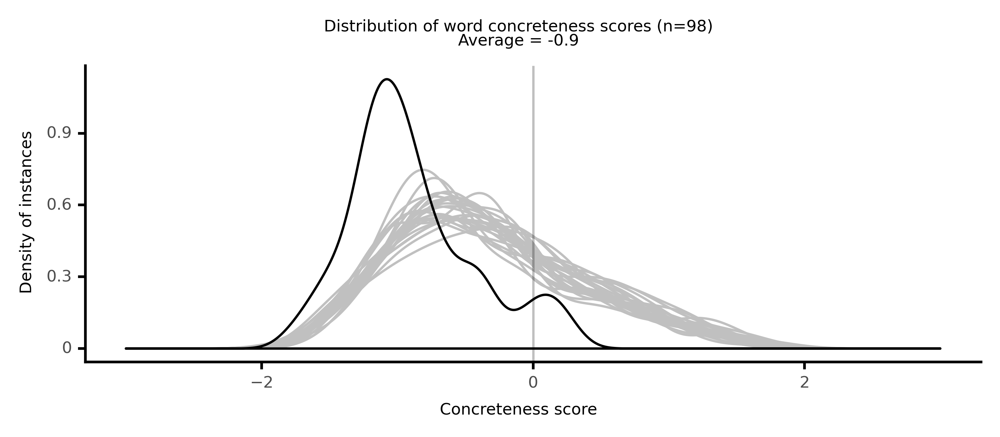

<ggplot: (8764102094025)>

 65%|██████▌   | 65/100 [13:52<06:45, 11.57s/it]

#### #66 most abstract passage: Richardson, _Familiar Letters (1750)_ (1750)

<p>, and <abs><conc146>Employment</conc146></abs> in the Country. You can not be <abs><conc197>insensible</conc197></abs> how much you are <neither><conc275>beloved</conc275></neither> by us all; <abs><conc033>judge</conc033></abs> then if you do right to <neither><conc263>omit</conc263></neither> giving us the only <abs><conc060>Satisfaction</conc060></abs> <abs><conc198>Absence</conc198></abs> <neither><conc277>affords</conc277></neither> to <abs><conc073>true</conc073></abs> Friends, which is, often to hear from one another. My Mother is <abs><conc178>highly</conc178></abs> <abs><conc084>disobliged</conc084></abs> with you, and says you are a very <neither><conc244>idle</conc244></neither> Girl; my <neither><conc644>Aunt</conc644></neither> is of the same <abs><conc033>Opinion</conc033></abs>; and I would <neither><conc351>fain</conc351></neither>, Like a <neither><conc303>loving</conc303></neither> Brother, <abs><conc140>excuse</conc140></abs> you, if I could. <neither><conc365>Pray</conc365></neither>, for the <abs><conc039>future</conc039></abs>, take <neither><conc375>care</conc375></neither> to <abs><conc088>deserve</conc088></abs> a better <abs><conc182>Character</conc182></abs>, and by <abs><conc206>writing</conc206></abs> soon, and often, put it in my <abs><conc020>Power</conc020></abs> to say what a good Sister I have: For you shall always find me Your most <neither><conc275>affectionate</conc275></neither> Brother. Due <abs><conc210>Respects</conc210></abs> of every one here to my <neither><conc644>Aunt</conc644></neither>, and all Friends in the Country. Dear Brother, Most <neither><conc398>kindly</conc398></neither>, and too <abs><conc026>justly</conc026></abs>, do you <abs><conc159>upbraid</conc159></abs> me. I own my <abs><conc129>Fault</conc129></abs>, and never will be <abs><conc111>guilty</conc111></abs> of the Like again. I <neither><conc280>write</conc280></neither> to <neither><conc288>beg</conc288></neither> my Mother's <abs><conc130>Pardon</conc130></abs>, and that she will <neither><conc290>procure</conc290></neither> for me that of my good <neither><conc644>Aunt</conc644></neither>, on <abs><conc156>Promise</conc156></abs> of <abs><conc087>Amendment</conc087></abs>. <abs><conc206>Continue</conc206></abs>, my dear Brother, to be an <abs><conc109>Advocate</conc109></abs> for me in all my <abs><conc036>unintended</conc036></abs> <abs><conc060>Imperfections</conc060></abs>, and I will never <abs><conc058>err</conc058></abs> <abs><conc067>voluntarily</conc067></abs> for the <abs><conc039>future</conc039></abs>; that so I may be as <abs><conc116>worthy</conc116></abs> as possible of your <neither><conc392>kind</conc392></neither> <abs><conc192>Constructions</conc192></abs>, and show myself, what I truly am, and ever will be, Your most <neither><conc275>affectionate</conc275></neither> and <abs><conc231>obliged</conc231></abs> Sister. <abs><conc215>Honoured</conc215></abs> Madam, I am <abs><conc137>ashamed</conc137></abs> I <neither><conc631>stayed</conc631></neither> to be <abs><conc111>reminded</conc111></abs> of my <abs><conc135>Duty</conc135></abs> by my Brother's <neither><conc392>kind</conc392></neither> <neither><conc356>Letter</conc356></neither>. I will <abs><conc220>offer</conc220></abs> no <abs><conc140>Excuse</conc140></abs> for myself, for not <abs><conc206>writing</conc206></abs> <neither><conc345>oftener</conc345></neither>, though' I have been <neither><conc340>strangely</conc340></neither> taken up by the <abs><conc164>Kindness</conc164></abs> and <abs><conc067>Favour</conc067></abs> of your good Friends here, particularly my <neither><conc644>Aunt</conc644></neither> Windus: For well do I know, that my <abs><conc135>Duty</conc135></abs> to my <abs><conc215>honoured</conc215></abs> Mother aught to take place of all other <abs><conc038>Considerations</conc038></abs>. All I <neither><conc288>beg</conc288></neither> therefore is, that you will be so good to <abs><conc142>forgive</conc142></abs> me, on <abs><conc156>Promise</conc156></abs> of <abs><conc087>Amendment</conc087></abs>, and to <neither><conc290>procure</conc290></neither> <abs><conc103>Forgiveness</conc103></abs> also of my <neither><conc644>Aunt</conc644></neither> Talbot, and all Friends. Believe me, Madam, when I say, that no <neither><conc376>Diversions</conc376></neither>, here or elsewhere, shall make me <abs><conc212>forget</conc212></abs> the <abs><conc135>Duty</conc135></abs> I <abs><conc129>owe</conc129></abs> to so good a Mother, and such <neither><conc392>kind</conc392></neither> <abs><conc165>Relations</conc165></abs>; and that I shall ever be Your <abs><conc221>gratefully</conc221></abs> <abs><conc181>dutiful</conc181></abs> <neither><conc608>Daughter</conc608></neither>. My <neither><conc644>Aunt</conc644></neither> and Cousin's <abs><conc119>desire</conc119></abs> their <neither><conc392>kind</conc392></neither> Love to you, and due <abs><conc210>Respects</conc210></abs> to all Friends. Brother John has great <abs><conc132>Reputation</conc132></abs> with every one for his <neither><conc392>kind</conc392></neither> <neither><conc356>Letter</conc356></neither> to me. <abs><conc215>Honoured</conc215></abs> Sir, I am sorry to <neither><conc280>acquaint</conc280></neither> you with the <neither><conc309>Indisposition</conc309></neither> of your dear <neither><conc608>Daughter</conc608></neither>. She was taken <abs><conc214>ill</conc214></abs> last Monday of a <neither><conc557>Fever</conc557></neither>, and has all the <abs><conc173>Assistance</conc173></abs> that we can <neither><conc290>procure</conc290></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

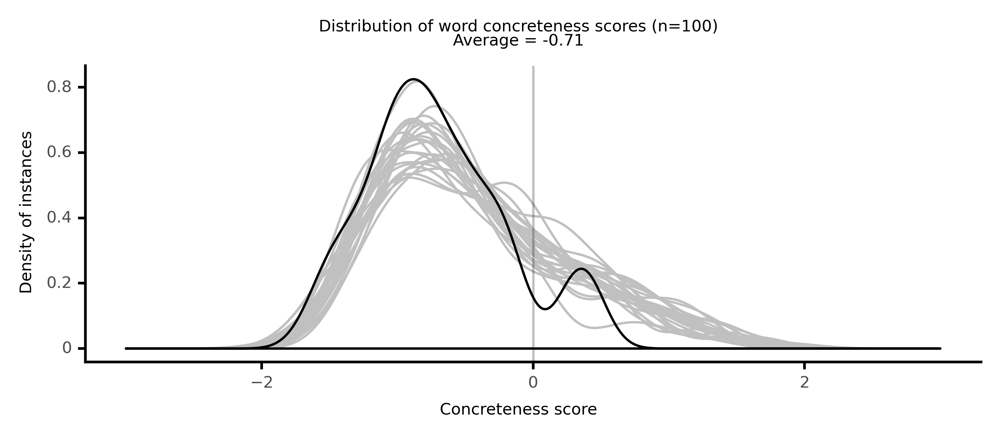

<ggplot: (8764106720957)>

 66%|██████▌   | 66/100 [14:02<06:17, 11.10s/it]

#### #67 most abstract passage: Boethius, _Consolation of Philosophy_ (524)

<p>. For if <abs><conc126>wickedness</conc126></abs> makes men <neither><conc337>wretched</conc337></neither>, he is necessarily more <neither><conc337>wretched</conc337></neither> who is <abs><conc073>wicked</conc073></abs> for a <neither><conc429>longer</conc429></neither> time; and were it not that <abs><conc213>death</conc213></abs>, at all <abs><conc068>events</conc068></abs>, <neither><conc762>puts</conc762></neither> an end to the <abs><conc136>evil</conc136></abs> <abs><conc014>doings</conc014></abs> of the <abs><conc073>wicked</conc073></abs>, I should account them <neither><conc337>wretched</conc337></neither> to the last <neither><conc444>degree</conc444></neither>. Indeed, if we have <neither><conc576>formed</conc576></neither> <abs><conc034>true</conc034></abs> <abs><conc189>conclusions</conc189></abs> about the <neither><conc377>ill</conc377></neither> <neither><conc385>fortune</conc385></neither> of <abs><conc126>wickedness</conc126></abs>, that <abs><conc201>wretchedness</conc201></abs> is <abs><conc061>plainly</conc061></abs> <abs><conc032>infinite</conc032></abs> which is <neither><conc603>doomed</conc603></neither> to be <abs><conc034>eternal</conc034></abs>.' Then said I:' A <neither><conc336>wondered</conc336></neither> <abs><conc011>inference</conc011></abs>, and <abs><conc140>difficult</conc140></abs> to <abs><conc032>grant</conc032></abs>; but I see that it <neither><conc352>agrees</conc352></neither> entirely with our previous <abs><conc189>conclusions</conc189></abs>.''Thou <neither><conc344>art</conc344></neither> right,' said she;'but if anyone <neither><conc297>finds</conc297></neither> it <neither><conc768>hard</conc768></neither> to <abs><conc059>admit</conc059></abs> the <abs><conc063>conclusion</conc063></abs>, he aught in <neither><conc762>fairness</conc762></neither> either to <abs><conc100>prove</conc100></abs> some <abs><conc044>falsity</conc044></abs> in the <abs><conc069>premises</conc069></abs>, or to show that the <neither><conc243>combination</conc243></neither> of <abs><conc070>propositions</conc070></abs> does not adequately <abs><conc133>enforce</conc133></abs> the <abs><conc024>necessity</conc024></abs> of the <abs><conc063>conclusion</conc063></abs>; otherwise, if the <abs><conc069>premises</conc069></abs> be <abs><conc085>granted</conc085></abs>, nothing whatever can be said against the <abs><conc011>inference</conc011></abs> of the <abs><conc063>conclusion</conc063></abs>. And here is another statement which seems not less <neither><conc336>wondered</conc336></neither>, but on the <abs><conc069>premises</conc069></abs> <abs><conc139>assumed</conc139></abs> is <neither><conc497>equally</conc497></neither> necessary.''What is that?''The <abs><conc073>wicked</conc073></abs> are <neither><conc365>happier</conc365></neither> in undergoing <abs><conc031>punishment</conc031></abs> than if no <abs><conc224>penalty</conc224></abs> of <abs><conc009>justice</conc009></abs> <abs><conc173>chasten</conc173></abs> them. And I am not now <abs><conc077>meaning</conc077></abs> what might <abs><conc017>occur</conc017></abs> to anyone-- that <neither><conc629>bade</conc629></neither> <neither><conc403>character</conc403></neither> is <abs><conc147>amended</conc147></abs> by <abs><conc003>retribution</conc003></abs>, and is brought into the right <neither><conc536>path</conc536></neither> by the <abs><conc201>terror</conc201></abs> of <abs><conc031>punishment</conc031></abs>, or that it <neither><conc558>serves</conc558></neither> as an example to <neither><conc309>warn</conc309></neither> others to <abs><conc121>avoid</conc121></abs> <abs><conc102>transgression</conc102></abs>; but I believe that in another way the <abs><conc073>wicked</conc073></abs> are more <neither><conc444>unfortunate</conc444></neither> when they go <abs><conc099>unpunished</conc099></abs>, even though no account be taken of <abs><conc034>amendment</conc034></abs>, and no regard be <neither><conc496>paid</conc496></neither> to example.''Why, what other way is there beside these?' said I. Then said she:'Have we not <neither><conc294>agreed</conc294></neither> that the good are <neither><conc327>happy</conc327></neither>, and the <abs><conc136>evil</conc136></abs> <neither><conc337>wretched</conc337></neither>?''Yes,' said I.'Now, if,' said she,'to one in <abs><conc161>affliction</conc161></abs> there be given along with his <abs><conc170>misery</conc170></abs> some good thing, is he not <neither><conc365>happier</conc365></neither> than one whose <abs><conc170>misery</conc170></abs> is <abs><conc170>misery</conc170></abs> <neither><conc589>pure</conc589></neither> and <neither><conc303>simple</conc303></neither> without admixture of any good?''It would seem so.''But if to one thus <neither><conc337>wretched</conc337></neither>, one <abs><conc092>destitute</conc092></abs> of all good, some further <abs><conc136>evil</conc136></abs> be added beside those which make him <neither><conc337>wretched</conc337></neither>, is he not to be <abs><conc048>judged</conc048></abs> far more <neither><conc466>unhappy</conc466></neither> than he whose <neither><conc377>ill</conc377></neither> <neither><conc385>fortune</conc385></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

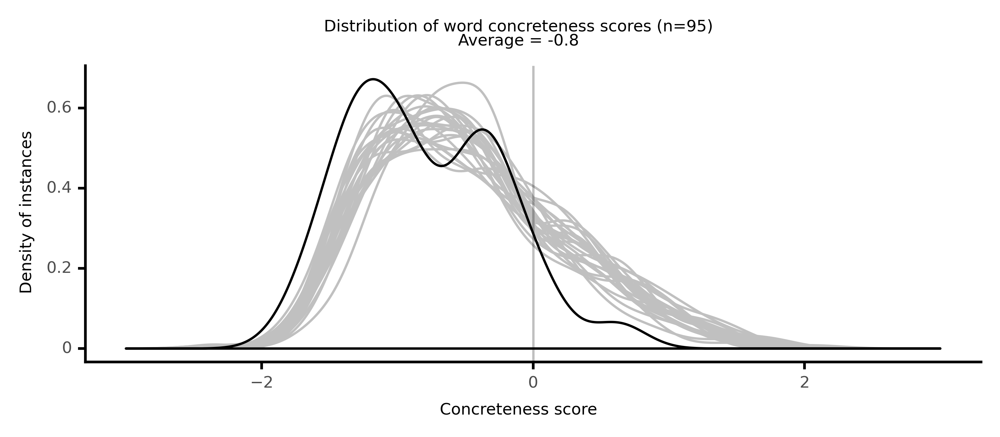

<ggplot: (8764171388249)>

 67%|██████▋   | 67/100 [14:13<06:03, 11.00s/it]

#### #68 most abstract passage: Scott, _Millenium Hall (1762)_ (1762)

<p>, she would think no <abs><conc196>sacrifice</conc196></abs> too great to obtain. Miss Mancel <abs><conc171>endeavoured</conc171></abs> as much as possible to <abs><conc146>avoid</conc146></abs> giving Sir Edward any <neither><conc259>opportunity</conc259></neither> of <abs><conc192>renewing</conc192></abs> his <abs><conc195>addresses</conc195></abs>; but his <abs><conc110>vigilance</conc110></abs> found the means of seeing her alone more than once, when he <abs><conc205>warmly</conc205></abs> <abs><conc033>urged</conc033></abs> the <abs><conc047>partiality</conc047></abs> of her <abs><conc093>behaviour</conc093></abs>, representing'how much more his <abs><conc063>happiness</conc063></abs> was <abs><conc062>concerned</conc062></abs> in the <abs><conc132>success</conc132></abs> of a <abs><conc175>passion</conc175></abs> which <abs><conc159>possessed</conc159></abs> his whole <abs><conc194>soul</conc194></abs>, than his grandmother's could be in <abs><conc007>disappointing</conc007></abs> it. She, he <neither><conc372>observed</conc372></neither>, was <abs><conc022>actuated</conc022></abs> only by <neither><conc248>pride</conc248></neither>, he by the <abs><conc108>sincerest</conc108></abs> love that ever took place in a <abs><conc115>human</conc115></abs> <neither><conc325>heart</conc325></neither>. In <abs><conc123>accepting</conc123></abs> his <abs><conc195>addresses</conc195></abs> Louisa could only <abs><conc186>mortify</conc186></abs> Lady Lambton; in <abs><conc026>rejecting</conc026></abs> them, she must <abs><conc081>render</conc081></abs> him <abs><conc227>miserable</conc227></abs>. Which, he <neither><conc336>asked</conc336></neither>, had the best <abs><conc140>title</conc140></abs> to her regard, the woman who could <abs><conc024>ungenerously</conc024></abs> and <neither><conc350>injudiciously</conc350></neither> <neither><conc597>set</conc597></neither> a <neither><conc348>higher</conc348></neither> <conc><conc900>valve</conc900></conc> on <abs><conc165>riches</conc165></abs> and <abs><conc235>birth</conc235></abs> than on her very <abs><conc139>superior</conc139></abs> <abs><conc113>excellencies</conc113></abs>, or the man who would <abs><conc233>gladly</conc233></abs> <abs><conc196>sacrifice</conc196></abs> <neither><conc290>fortune</conc290></neither>, and every other <abs><conc088>enjoyment</conc088></abs> the world could <neither><conc266>afford</conc266></neither>, to the <neither><conc305>possession</conc305></neither> of her; of her who alone could <abs><conc081>render</conc081></abs> life <abs><conc174>desirable</conc174></abs> to him?' By these, and many other <abs><conc068>arguments</conc068></abs>, and what was more <abs><conc129>prevalent</conc129></abs> than all the <abs><conc068>arguments</conc068></abs> that could be <abs><conc065>deduced</conc065></abs> from <abs><conc031>reason</conc031></abs>, by the <neither><conc378>tenderest</conc378></neither> <neither><conc271>entreaties</conc271></neither> that the most <abs><conc223>ardent</conc223></abs> <abs><conc175>passion</conc175></abs> could <abs><conc025>dictate</conc025></abs>, Sir Edward <abs><conc171>endeavoured</conc171></abs> to <abs><conc107>persuade</conc107></abs> Louisa to <abs><conc161>consent</conc161></abs> to <neither><conc441>marry</conc441></neither> him, but all <abs><conc139>proved</conc139></abs> <abs><conc231>unavailing</conc231></abs>. She sometime thought what he said was just, but <abs><conc099>aware</conc099></abs> of her <abs><conc047>partiality</conc047></abs>, she could not believe herself an <abs><conc012>unprejudiced</conc012></abs> <abs><conc033>judge</conc033></abs>, and <abs><conc108>feared</conc108></abs> that she might <abs><conc168>mistake</conc168></abs> the <abs><conc135>sophistry</conc135></abs> of love, for the <neither><conc348>voice</conc348></neither> of <abs><conc031>reason</conc031></abs>. She was sure, while honour, <abs><conc065>truth</conc065></abs>, and <abs><conc108>gratitude</conc108></abs>, <abs><conc096>pleaded</conc096></abs> against <abs><conc151>inclination</conc151></abs> they must be in the right, though their <abs><conc117>remonstrances</conc117></abs> were <neither><conc419>hushed</conc419></neither> into a <neither><conc625>whisper</conc625></neither> by the <neither><conc511>louder</conc511></neither> <abs><conc172>solicitations</conc172></abs> of <abs><conc175>passion</conc175></abs>. <abs><conc049>Convinced</conc049></abs> that she could not be to <abs><conc084>blame</conc084></abs>, while she <abs><conc161>acted</conc161></abs> in <abs><conc008>contradiction</conc008></abs> to her <neither><conc248>secret</conc248></neither> <abs><conc145>choice</conc145></abs>, since the <abs><conc068>sincerity</conc068></abs> of her <abs><conc049>intentions</conc049></abs> were thereby <abs><conc114>plainly</conc114></abs>, though <abs><conc140>painfully</conc140></abs> <abs><conc134>evinced</conc134></abs>, she <abs><conc130>persisted</conc130></abs> in <abs><conc185>refusing</conc185></abs> to become Sir Edward's <neither><conc538>wife</conc538></neither>, and told him, that'if he did not <abs><conc135>discontinue</conc135></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

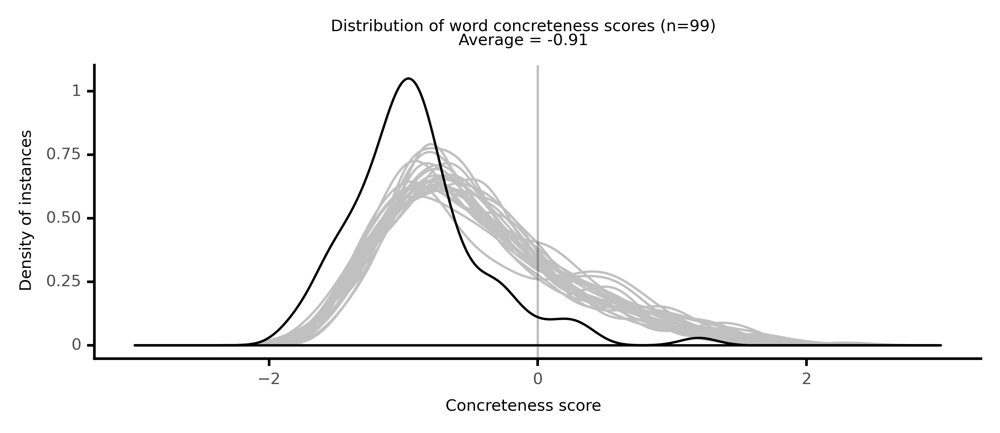

<ggplot: (8764106547549)>

 68%|██████▊   | 68/100 [14:26<06:11, 11.61s/it]

#### #69 most abstract passage: Brown, _The Novels . . . (1827): a machine-readable transc_ (1827)

<p><neither><conc361>produced</conc361></neither>! In what <abs><conc042>ambiguous</conc042></abs> terms had he <neither><conc421>couched</conc421></neither> his <abs><conc099>prognostics</conc099></abs>, of some <neither><conc377>mighty</conc377></neither> <abs><conc031>evil</conc031></abs> that <neither><conc438>awaited</conc438></neither> her! He had given a <neither><conc274>terrible</conc274></neither>, but <abs><conc044>contradictory</conc044></abs> <neither><conc356>description</conc356></neither>, of her <abs><conc153>destiny</conc153></abs>. An <abs><conc161>event</conc161></abs> was to <neither><conc363>happen</conc363></neither>, <abs><conc186>akin</conc186></abs> to no <abs><conc150>calamity</conc150></abs> which she had already <abs><conc184>endured</conc184></abs>, <abs><conc251>disconnected</conc251></abs> with all which the <abs><conc198>imagination</conc198></abs> of man is <neither><conc282>accustomed</conc282></neither> to <abs><conc001>deprecate</conc001></abs>, <abs><conc174>capable</conc174></abs> of <abs><conc235>urging</conc235></abs> her to <abs><conc261>suicide</conc261></abs>, and yet of a <neither><conc265>kind</conc265></neither>, which left it <neither><conc359>undecided</conc359></neither>, whither she would regard it with <abs><conc079>indifference</conc079></abs>. What <abs><conc080>reliance</conc080></abs> should she place upon <abs><conc094>prophetic</conc094></abs> incoherences, thus <neither><conc593>wild</conc593></neither>? What <neither><conc277>precautions</conc277></neither> should she take, against a <abs><conc122>danger</conc122></abs> thus <abs><conc168>inscrutable</conc168></abs> and <abs><conc260>imminent</conc260></abs>? These <neither><conc277>incidents</conc277></neither> and <abs><conc239>reflections</conc239></abs> were <neither><conc382>speedily</conc382></neither> <abs><conc202>transmitted</conc202></abs> to me. I had always <abs><conc119>believed</conc119></abs> the <abs><conc025>character</conc025></abs> and <abs><conc072>machinations</conc072></abs> of Ormond, to be <abs><conc118>worthy</conc118></abs> of <abs><conc212>caution</conc212></abs> and <abs><conc069>fear</conc069></abs>. His means of information I did not <abs><conc160>pretend</conc160></abs>, and thought it <abs><conc244>useless</conc244></abs> to <abs><conc109>investigate</conc109></abs>. We can not <neither><conc698>hide</conc698></neither> our <abs><conc010>actions</conc010></abs> and thoughts, from one of <abs><conc184>powerful</conc184></abs> <abs><conc049>sagacity</conc049></abs>, whom the <abs><conc177>detection</conc177></abs> sufficiently <abs><conc081>interests</conc081></abs>, to make him use all the <abs><conc090>methods</conc090></abs> of <abs><conc177>detection</conc177></abs> in his <abs><conc028>power</conc028></abs>. The <abs><conc185>study</conc185></abs> of <neither><conc374>concealment</conc374></neither> is, in all <abs><conc218>cases</conc218></abs>, <abs><conc208>fruitless</conc208></abs> or <abs><conc091>hurtful</conc091></abs>. All that <abs><conc127>duty</conc127></abs> <abs><conc019>enjoins</conc019></abs>, is to <abs><conc185>design</conc185></abs> and to <abs><conc219>execute</conc219></abs> nothing, which may not be <abs><conc233>approved</conc233></abs> by a <abs><conc020>divine</conc020></abs> and <abs><conc027>omniscient</conc027></abs> <abs><conc194>observer</conc194></abs>. <abs><conc115>Human</conc115></abs> <neither><conc296>scrutiny</conc296></neither> is neither to be <abs><conc225>solicited</conc225></abs>, nor <abs><conc207>shunned</conc207></abs>. <abs><conc115>Human</conc115></abs> <abs><conc048>approbation</conc048></abs> or <abs><conc015>censure</conc015></abs>, can never be <abs><conc070>exempt</conc070></abs> from <abs><conc019>injustice</conc019></abs>, because our <abs><conc118>limited</conc118></abs> <abs><conc128>perceptions</conc128></abs> <abs><conc051>debar</conc051></abs> us from a through <abs><conc045>knowledge</conc045></abs> of any <abs><conc010>actions</conc010></abs> and <abs><conc014>motives</conc014></abs> but our own. On <abs><conc145>reviewing</conc145></abs> what had <neither><conc422>passed</conc422></neither>, between <abs><conc203>Constantia</conc203></abs> and me, I <neither><conc434>recollected</conc434></neither> nothing <abs><conc021>incompatible</conc021></abs> with <abs><conc202>purity</conc202></abs> and <abs><conc009>rectitude</conc009></abs>. That Ormond was <abs><conc156>apprized</conc156></abs> of all that had <neither><conc422>passed</conc422></neither>, I by no means <abs><conc189>inferred</conc189></abs> from the <abs><conc254>tenor</conc254></abs> of his <neither><conc391>conversation</conc391></neither> with <abs><conc203>Constantia</conc203></abs>, nor, if this had been <abs><conc028>incontestably</conc028></abs> <abs><conc155>proved</conc155></abs>, should I have <abs><conc182>experienced</conc182></abs> any <neither><conc520>trepidation</conc520></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

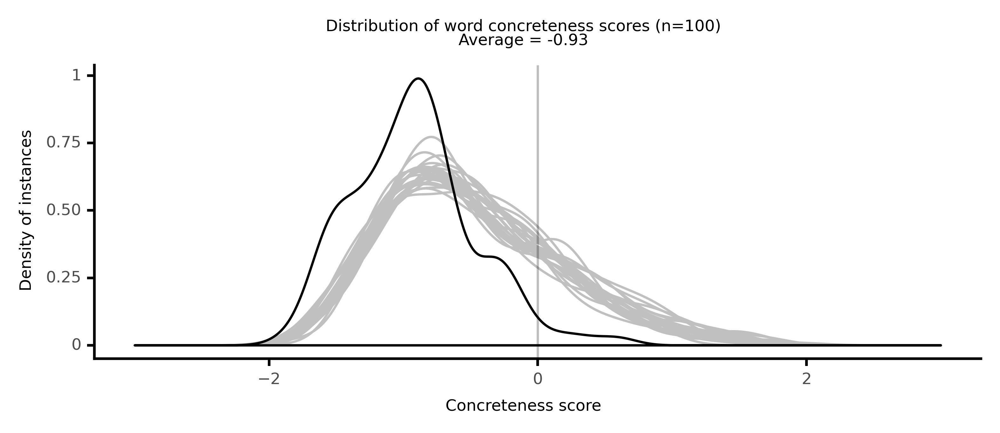

<ggplot: (8764118547385)>

 69%|██████▉   | 69/100 [14:38<06:03, 11.72s/it]

#### #70 most abstract passage: Scott, _Millenium Hall (1762)_ (1762)

<p>; he did not <abs><conc051>apprehend</conc051></abs> that <abs><conc000>disbelief</conc000></abs> was a <abs><conc098>proof</conc098></abs> of <abs><conc033>wisdom</conc033></abs>, nor <abs><conc183>wished</conc183></abs> to <abs><conc164>lessen</conc164></abs> the <abs><conc070>faith</conc070></abs> of others, but was in himself <abs><conc009>sceptical</conc009></abs>; he <abs><conc111>doubted</conc111></abs> of what he could not entirely <abs><conc079>comprehend</conc079></abs>, and seemed to think those things at least <abs><conc144>improbable</conc144></abs> which were not <neither><conc591>level</conc591></neither> to his <abs><conc056>understanding</conc056></abs>. He <abs><conc175>avoided</conc175></abs> the <abs><conc046>subject</conc046></abs> with Miss Selvyn, he could not <abs><conc188>teach</conc188></abs> her what he did not believe; but <abs><conc184>chosen</conc184></abs> to leave her free to from that <abs><conc016>judgement</conc016></abs>, which should in time seem most <abs><conc003>rational</conc003></abs> to her. I could not <abs><conc207>forbear</conc207></abs> <abs><conc225>interrupting</conc225></abs> Mrs. Maynard, to <neither><conc264>signify</conc264></neither> my <abs><conc033>approbation</conc033></abs> of Mr. Selvyn's <abs><conc010>conduct</conc010></abs> in this particular, as the only <abs><conc130>instance</conc130></abs> I had ever <neither><conc443>met</conc443></neither> with of a <abs><conc159>candid</conc159></abs> mind, in one who had a <abs><conc044>tendency</conc044></abs> towards <abs><conc080>infidelity</conc080></abs>; for' I never knew any who were not <neither><conc295>angry</conc295></neither> with those that <abs><conc143>believed</conc143></abs> more than themselves, and who were not more <neither><conc364>eager</conc364></neither> to bring others over to their <abs><conc009>opinions</conc009></abs> than most <neither><conc240>foreign</conc240></neither> <abs><conc227>missionaries</conc227></abs>; yet surely nothing can be more <abs><conc036>absurd</conc036></abs>, for these men will not <neither><conc264>dare</conc264></neither> to say that the <abs><conc126>virtues</conc126></abs> which <abs><conc033>christianity</conc033></abs> <abs><conc131>requires</conc131></abs> are not <abs><conc034>indispensible</conc034></abs> <abs><conc155>duties</conc155></abs>; on the <abs><conc057>contrary</conc057></abs>, they would have us <abs><conc163>imagine</conc163></abs> they are most <abs><conc078>sincerely</conc078></abs> <abs><conc200>attached</conc200></abs> to them; what <abs><conc139>advantage</conc139></abs> then can <abs><conc053>accrue</conc053></abs> to any one, from being <abs><conc159>deprived</conc159></abs> of the <abs><conc055>certainty</conc055></abs> of a <abs><conc106>reward</conc106></abs> for his <abs><conc022>obedience</conc022></abs>? If we <abs><conc057>deny</conc057></abs> <abs><conc017>revelation</conc017></abs>, we must <abs><conc010>acknowledge</conc010></abs> this <neither><conc317>point</conc317></neither> to be very <abs><conc103>uncertain</conc103></abs>; it was the <abs><conc046>subject</conc046></abs> of <abs><conc102>dispute</conc102></abs> and <abs><conc097>doubt</conc097></abs> among all the <abs><conc123>philosophers</conc123></abs> of <neither><conc291>antiquity</conc291></neither>; and we have but a <neither><conc451>poor</conc451></neither> <abs><conc023>dependence</conc023></abs> for so great a <abs><conc187>blessing</conc187></abs>, if we <neither><conc427>rest</conc427></neither> our <abs><conc178>expectation</conc178></abs> where they did theirs. Can a man therefore be <abs><conc090>rendered</conc090></abs> <neither><conc249>happier</conc249></neither> by being <abs><conc159>deprived</conc159></abs> of this <abs><conc055>certainty</conc055></abs>? Or can we <neither><conc251>suppose</conc251></neither> he will be more <abs><conc077>virtuous</conc077></abs>, because we have <neither><conc393>removed</conc393></neither> all the <abs><conc008>motives</conc008></abs> that arise from <abs><conc131>hope</conc131></abs> and <abs><conc111>fear</conc111></abs>? And yet, what else can <abs><conc140>excuse</conc140></abs> an <abs><conc083>infidel</conc083></abs>'s <abs><conc119>desire</conc119></abs> to make <abs><conc169>converts</conc169></abs>? Nothing. Nor can any thing occasion it but a <neither><conc248>secret</conc248></neither> <abs><conc028>consciousness</conc028></abs> that he is in the <abs><conc085>wrong</conc085></abs>, which <neither><conc518>temps</conc518></neither> him to wish for the <neither><conc337>countenance</conc337></neither> of more <abs><conc095>associates</conc095></abs> in his <abs><conc035>error</conc035></abs>; this <neither><conc347>likewise</conc347></neither> can alone give <neither><conc439>rise</conc439></neither> to his <abs><conc131>rancour</conc131></abs> against those who believe more than himself; he feels them a <abs><conc093>tacit</conc093></abs> <abs><conc054>reproach</conc054></abs> to him, which to his <neither><conc248>pride</conc248></neither> is <abs><conc202>insupportable</conc202></abs>.''But, said Lamont, do you <abs><conc163>imagine</conc163></abs> that a <abs><conc226>freethinker</conc226></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

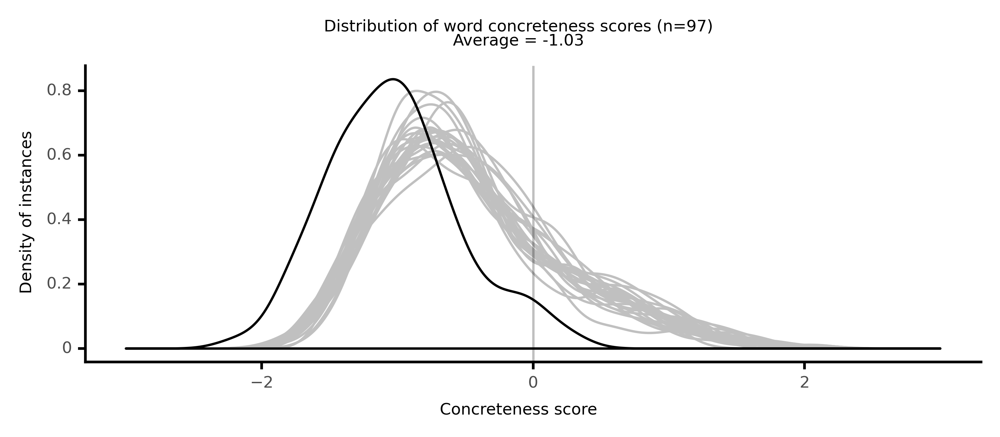

<ggplot: (8764118429173)>

 70%|███████   | 70/100 [14:48<05:41, 11.37s/it]

#### #71 most abstract passage: Foster, _The Boarding School; or, Lessons of a Preceptress _ (1798)

<p>persons of our <neither><conc409>sex</conc409></neither>. Yet some there are, <neither><conc265>sordid</conc265></neither> enough to consider <abs><conc215>wealth</conc215></abs> as the <abs><conc218>chief</conc218></abs> good, and to <abs><conc196>sacrifice</conc196></abs> every other <abs><conc147>object</conc147></abs> to a <neither><conc435>splendid</conc435></neither> <neither><conc430>appearance</conc430></neither>. It often happens, that these are <neither><conc248>miserably</conc248></neither> <abs><conc205>disappointed</conc205></abs> in their <abs><conc110>expectations</conc110></abs> of <abs><conc063>happiness</conc063></abs>. They find, by <abs><conc205>dear-bought</conc205></abs> <abs><conc033>experience</conc033></abs>, that <neither><conc281>external</conc281></neither> <neither><conc379>pomp</conc379></neither> is but a <neither><conc297>wretched</conc297></neither> <neither><conc279>substitute</conc279></neither> for <neither><conc266>internal</conc266></neither> <abs><conc060>satisfaction</conc060></abs>. But I would not have <neither><conc423>outward</conc423></neither> circumstances entirely <abs><conc154>overlooked</conc154></abs>. A <abs><conc196>proper</conc196></abs> regard should always be had to a <neither><conc411>comfortable</conc411></neither> <neither><conc241>subsistence</conc241></neither> in life. Nor can you be <abs><conc001>justified</conc001></abs> in <abs><conc092>suffering</conc092></abs> a <abs><conc214>blind</conc214></abs> <abs><conc175>passion</conc175></abs>, under whatever <abs><conc126>pretext</conc126></abs>, to <abs><conc059>involve</conc059></abs> you in those <abs><conc059>embarrassing</conc059></abs> <abs><conc108>distresses</conc108></abs> of want, which will <abs><conc187>elude</conc187></abs> the <neither><conc291>remedies</conc291></neither> of love itself, and <abs><conc087>prove</conc087></abs> <neither><conc299>fatal</conc299></neither> to the <abs><conc120>peace</conc120></abs> and <abs><conc063>happiness</conc063></abs> at which you <abs><conc180>aim</conc180></abs>. In this <abs><conc015>momentous</conc015></abs> <neither><conc264>affair</conc264></neither>, let the <abs><conc127>advice</conc127></abs> and <abs><conc033>opinion</conc033></abs> of <abs><conc084>judicious</conc084></abs> friends have their just <neither><conc495>weight</conc495></neither> in your <abs><conc062>minds</conc062></abs>. <neither><conc248>Discover</conc248></neither>, with <abs><conc081>candor</conc081></abs> and <abs><conc170>frankness</conc170></abs>, the <abs><conc124>progress</conc124></abs> of your <neither><conc492>amour</conc492></neither>, so far as is necessary to <abs><conc152>enable</conc152></abs> them to <abs><conc033>judge</conc033></abs> <abs><conc095>aright</conc095></abs> in the cause; but never <abs><conc128>relate</conc128></abs> the love-tales of your suitor, merely for your own, or any other person's <neither><conc303>amusement</conc303></neither>. The <neither><conc541>tender</conc541></neither> <neither><conc238>themes</conc238></neither>, <abs><conc040>inspired</conc040></abs> by love, may be <neither><conc337>pleasing</conc337></neither> to you; but, to an <abs><conc044>uninterested</conc044></abs> person, must be <neither><conc387>insipid</conc387></neither> and <neither><conc329>disgusting</conc329></neither>, in the <abs><conc221>extreme</conc221></abs>. Never <neither><conc269>boast</conc269></neither> of the <neither><conc378>number</conc378></neither>, nor of the <abs><conc039>professions</conc039></abs> of your <neither><conc285>admirers</conc285></neither>. That <abs><conc180>betrays</conc180></abs> an <abs><conc134>unsufferable</conc134></abs> <abs><conc139>vanity</conc139></abs>, and will <abs><conc081>render</conc081></abs> you <neither><conc306>perfectly</conc306></neither> <abs><conc171>ridiculous</conc171></abs> in the <neither><conc336>estimation</conc336></neither> of <abs><conc112>observers</conc112></abs>. Besides, it is a most <abs><conc086>ungenerous</conc086></abs> <abs><conc179>treatment</conc179></abs> of those who may have <abs><conc175>entertained</conc175></abs>, and <abs><conc128>expressed</conc128></abs> a regard for you. Whatever they have said upon this <abs><conc046>subject</conc046></abs>, was <abs><conc068>doubtless</conc068></abs> in <abs><conc039>confidence</conc039></abs>, and you aught to keep it <neither><conc283>sacred</conc283></neither>, as a <neither><conc248>secret</conc248></neither> you have no right to <abs><conc170>divulge</conc170></abs>. If you <abs><conc014>disapprove</conc014></abs> the person, and <abs><conc038>reject</conc038></abs> his <neither><conc475>suit</conc475></neither>, that will be sufficiently <abs><conc089>mortifying</conc089></abs>, without <abs><conc234>adding</conc234></abs> the <abs><conc171>insult</conc171></abs> of <abs><conc233>exposing</conc233></abs> his <abs><conc226>overtures</conc226></abs>. Be very <neither><conc285>careful</conc285></neither> to <abs><conc221>distinguish</conc221></abs> real <neither><conc475>lovers</conc475></neither> from <abs><conc119>mere</conc119></abs> <neither><conc681>gallants</conc681></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

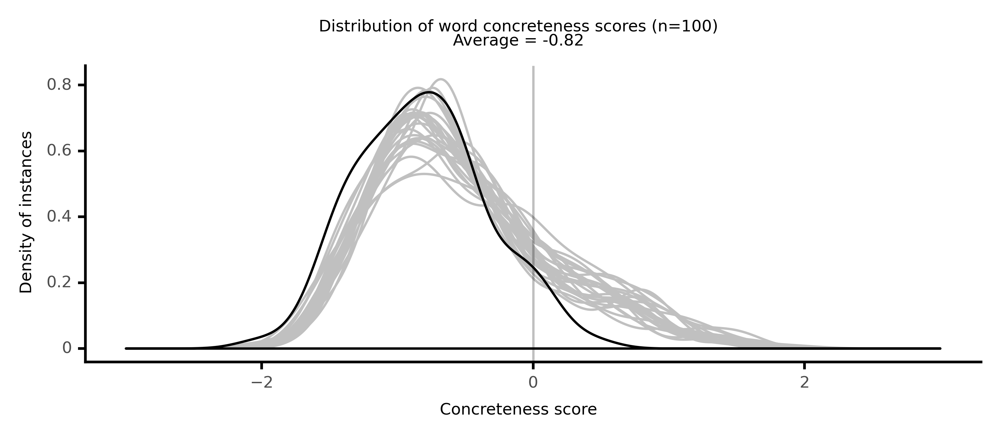

<ggplot: (8764114334393)>

 71%|███████   | 71/100 [14:58<05:16, 10.91s/it]

#### #72 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>of <abs><conc077>natural</conc077></abs> <abs><conc043>religion</conc043></abs> <abs><conc153>arises</conc153></abs> from the <abs><conc083>nature</conc083></abs> and <abs><conc031>reason</conc031></abs> of things, as being <abs><conc163>objects</conc163></abs> of our <abs><conc003>rational</conc003></abs> <abs><conc013>moral</conc013></abs> <abs><conc061>faculties</conc061></abs>, <neither><conc238>agreeably</conc238></neither> to which we can not but be <abs><conc231>obliged</conc231></abs> to act; and this <abs><conc041>obligation</conc041></abs> is <abs><conc225>strengthened</conc225></abs> by the <abs><conc044>tendency</conc044></abs> of <abs><conc077>natural</conc077></abs> <abs><conc043>religion</conc043></abs> to the <abs><conc060>final</conc060></abs> <abs><conc063>happiness</conc063></abs> of every <abs><conc003>rational</conc003></abs> <abs><conc126>agent</conc126></abs>: but the <neither><conc383>clear</conc383></neither> <abs><conc029>knowledge</conc029></abs>, and <abs><conc106>express</conc106></abs> <abs><conc095>promises</conc095></abs> which we have in the <abs><conc051>gospel</conc051></abs>, of the <abs><conc083>nature</conc083></abs> and <abs><conc051>greatness</conc051></abs> of this <abs><conc060>final</conc060></abs> <abs><conc063>happiness</conc063></abs>, being added to the <abs><conc041>obligation</conc041></abs> from, and the <abs><conc044>tendency</conc044></abs> of <abs><conc031>reason</conc031></abs> or <abs><conc077>natural</conc077></abs> <abs><conc043>religion</conc043></abs> to the <abs><conc060>final</conc060></abs> <abs><conc063>happiness</conc063></abs> of <abs><conc115>human</conc115></abs> <abs><conc083>nature</conc083></abs>, the <abs><conc041>obligation</conc041></abs> of it is thereby still more <abs><conc225>strengthened</conc225></abs>. In this <neither><conc688>lies</conc688></neither> the <abs><conc095>benefit</conc095></abs> of <abs><conc033>christianity</conc033></abs>. It is the old, <abs><conc020>uncorrupt</conc020></abs> <abs><conc043>religion</conc043></abs> of <abs><conc083>nature</conc083></abs> and <abs><conc031>reason</conc031></abs>, entirely free from <abs><conc182>superstition</conc182></abs> and <abs><conc049>immorality</conc049></abs>; <abs><conc220>delivered</conc220></abs> and <abs><conc204>taught</conc204></abs> in the most <abs><conc003>rational</conc003></abs> and <neither><conc269>easy</conc269></neither> way, and <abs><conc013>inforced</conc013></abs> by the most <abs><conc147>gracious</conc147></abs> and <abs><conc119>powerful</conc119></abs> <abs><conc008>motives</conc008></abs>.[ Side note:1Kb] Of the <abs><conc199>Mysteries</conc199></abs>, <neither><conc308>Trinity</conc308></neither>, and <abs><conc196>Sacrifice</conc196></abs> of the <conc><conc822>Cross</conc822></conc>. But if this be the case, it may be <neither><conc336>asked</conc336></neither>, Where are our <abs><conc194>holy</conc194></abs> <abs><conc199>mysteries</conc199></abs>-- and what do you think of our <abs><conc059>Redemption</conc059></abs>? If <abs><conc077>natural</conc077></abs> <abs><conc031>reason</conc031></abs> and <abs><conc064>conscience</conc064></abs> can do so much, and to the <abs><conc051>gospel</conc051></abs> we are <abs><conc231>obliged</conc231></abs> only for a little more <neither><conc581>light</conc581></neither> and <abs><conc069>influence</conc069></abs>, then <neither><conc308>Trinity</conc308></neither> in <abs><conc062>Unity</conc062></abs>, and the <abs><conc196>Sacrifice</conc196></abs> of the <conc><conc822>Cross</conc822></conc> are nothing. What are your <abs><conc016>sentiments</conc016></abs> on these <abs><conc046>Subject</conc046></abs>'s? As to the <neither><conc308>Trinity</conc308></neither>, it is a word <neither><conc306>invented</conc306></neither> by the <neither><conc331>doctors</conc331></neither>, and so far as I can find, was never once thought of by Jesus Christ and his <abs><conc111>apostles</conc111></abs>; unless it was to <neither><conc447>guard</conc447></neither> against the <conc><conc782>spread</conc782></conc> of tritheism, by taking the greatest <neither><conc375>care</conc375></neither> to <abs><conc004>inculcate</conc004></abs> the <abs><conc022>supreme</conc022></abs> <abs><conc112>divinity</conc112></abs> of God the Father: but let it be a <neither><conc308>trinity</conc308></neither>, since the <neither><conc260>church</conc260></neither> will have it so, and by it I <abs><conc147>understand</conc147></abs> one <abs><conc218>Uncreated</conc218></abs>, and one <abs><conc082>Created</conc082></abs>, and a certain <abs><conc054>divine</conc054></abs> <abs><conc076>virtue</conc076></abs> of <neither><conc421>quality</conc421></neither>. These I find in the <neither><conc392>Bible</conc392></neither>, God, Jesus the Word, and a <abs><conc054>Divine</conc054></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

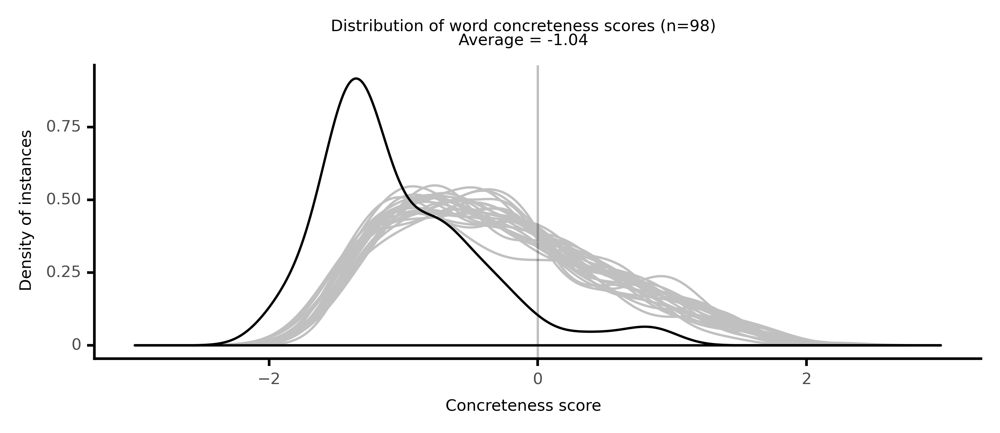

<ggplot: (8764100227525)>

 72%|███████▏  | 72/100 [15:13<05:38, 12.08s/it]

#### #73 most abstract passage: Brown, _Edgar Huntly, volume 1 (1799)_ (1799)

<p>of her <abs><conc201>son</conc201></abs> the <neither><conc279>principal</conc279></neither> <neither><conc282>theme</conc282></neither> of my <neither><conc277>letters</conc277></neither>. I <abs><conc115>deemed</conc115></abs> it my <abs><conc099>privilege</conc099></abs>, as well as <abs><conc135>duty</conc135></abs>, to <neither><conc593>sit</conc593></neither> in <abs><conc016>judgement</conc016></abs> on his <abs><conc007>actions</conc007></abs>, to from my <abs><conc009>opinions</conc009></abs> without regard to <abs><conc034>selfish</conc034></abs> <abs><conc038>considerations</conc038></abs>, and to <abs><conc076>avow</conc076></abs> them whenever the <abs><conc055>avowal</conc055></abs> <abs><conc080>tended</conc080></abs> to <abs><conc095>benefit</conc095></abs>. Every <neither><conc356>letter</conc356></neither> which I <neither><conc248>wrote</conc248></neither>, particularly those in which his <abs><conc093>behaviour</conc093></abs> was <abs><conc167>freely</conc167></abs> <abs><conc104>criticised</conc104></abs>, I <abs><conc144>allowed</conc144></abs> him to <abs><conc220>peruse</conc220></abs>. I would, on no account, <abs><conc089>connive</conc089></abs> at, or <abs><conc046>participate</conc046></abs> in the <abs><conc234>slightest</conc234></abs> <abs><conc173>irregularity</conc173></abs>. I knew the <abs><conc135>duty</conc135></abs> of my <abs><conc166>station</conc166></abs>, and <abs><conc215>assumed</conc215></abs> no other <abs><conc063>control</conc063></abs> than that which resulted from the <abs><conc103>avoiding</conc103></abs> of <neither><conc261>deceit</conc261></neither>, and the <neither><conc511>open</conc511></neither> <abs><conc222>expression</conc222></abs> of my <abs><conc016>sentiments</conc016></abs>. The <neither><conc335>youth</conc335></neither> was of a <neither><conc291>noble</conc291></neither> <abs><conc032>spirit</conc032></abs>, but his <abs><conc107>firmness</conc107></abs> was <abs><conc109>wavering</conc109></abs>. He <neither><conc329>yielded</conc329></neither> to <abs><conc105>temptations</conc105></abs> which a <abs><conc184>censor</conc184></abs> less <abs><conc095>rigorous</conc095></abs> than I would have <abs><conc065>regarded</conc065></abs> as <abs><conc096>venial</conc096></abs>, or, perhaps <abs><conc056>laudable</conc056></abs>. My <abs><conc135>duty</conc135></abs> <abs><conc090>required</conc090></abs> me to <neither><conc597>set</conc597></neither> before him the <abs><conc049>consequences</conc049></abs> of his <abs><conc007>actions</conc007></abs>, and to give <abs><conc030>impartial</conc030></abs> and <abs><conc216>timely</conc216></abs> information to his mother. He could not <conc><conc790>brook</conc790></conc> a <abs><conc162>monitor</conc162></abs>. The more he <abs><conc158>needed</conc158></abs> <abs><conc096>reproof</conc096></abs>, the less <abs><conc185>supportable</conc185></abs> it became. My <neither><conc455>company</conc455></neither> became every day less <abs><conc225>agreeable</conc225></abs>, till at <neither><conc638>length</conc638></neither>, there <neither><conc340>appeared</conc340></neither> a <abs><conc029>necessity</conc029></abs> of <neither><conc489>parting</conc489></neither>. A <abs><conc173>separation</conc173></abs> took place, but not as <abs><conc057>enemies</conc057></abs>. I never <neither><conc303>lost</conc303></neither> his <abs><conc047>respect</conc047></abs>. In his <abs><conc105>representations</conc105></abs> to his mother, he was just to my <abs><conc182>character</conc182></abs> and <abs><conc102>services</conc102></abs>. My <abs><conc102>dismission</conc102></abs> was not <abs><conc144>allowed</conc144></abs> to <abs><conc204>injure</conc204></abs> my <neither><conc290>fortune</conc290></neither>, and his mother <abs><conc083>considered</conc083></abs> this <abs><conc075>event</conc075></abs> merely as a new <abs><conc098>proof</conc098></abs> of the <abs><conc053>inflexible</conc053></abs> <abs><conc174>consistency</conc174></abs> of my <abs><conc010>principles</conc010></abs>. On this <neither><conc260>change</conc260></neither> in my <abs><conc228>situation</conc228></abs>, she <abs><conc135>proposed</conc135></abs> to me to become a <abs><conc176>member</conc176></abs> of her own family. No <abs><conc227>proposal</conc227></abs> could be more <abs><conc168>acceptable</conc168></abs>. I was <abs><conc072>fully</conc072></abs> <neither><conc259>acquainted</conc259></neither> with the <abs><conc182>character</conc182></abs> of this lady, and had nothing to <abs><conc111>fear</conc111></abs> from <abs><conc007>injustice</conc007></abs> and <abs><conc104>caprice</conc104></abs>. I did not regard her with <abs><conc209>filial</conc209></abs> <neither><conc239>familiarity</conc239></neither>, but my <abs><conc103>attachment</conc103></abs> and <abs><conc158>reverence</conc158></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

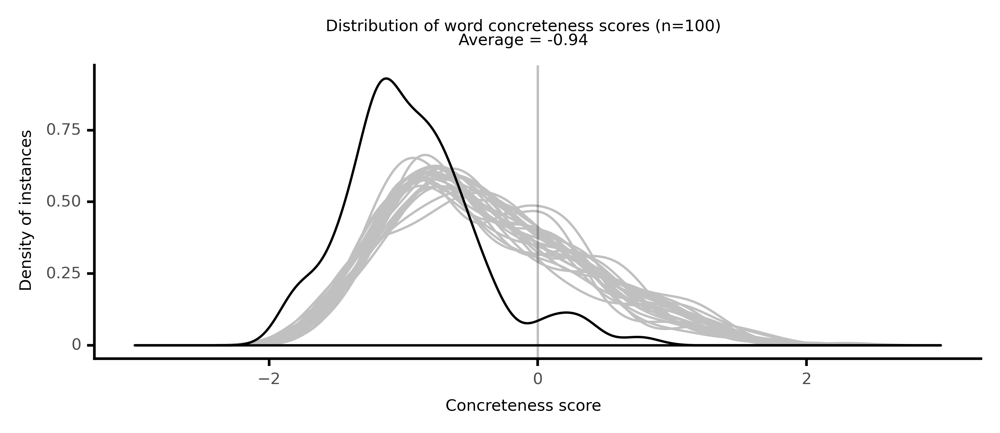

<ggplot: (8764106872441)>

 73%|███████▎  | 73/100 [15:23<05:05, 11.32s/it]

#### #74 most abstract passage: Sales, _Theophania (1655)_ (1655)

<p><neither><conc410>cruel</conc410></neither> and <abs><conc166>ambitious</conc166></abs>, she thought <abs><conc051>severity</conc051></abs> the most certain means to <neither><conc584>compass</conc584></neither> her <abs><conc104>designs</conc104></abs>: Nevertheless <neither><conc248>surpassing</conc248></neither> even all her <neither><conc619>sex</conc619></neither> in the <neither><conc364>art</conc364></neither> of <neither><conc401>dissembling</conc401></neither>, she so <neither><conc613>veiled</conc613></neither> it over with a <neither><conc717>mask</conc717></neither> of <abs><conc206>affability</conc206></abs>, that though she were <abs><conc210>resolved</conc210></abs> to make her will a <abs><conc106>law</conc106></abs>, yet she <neither><conc505>appeared</conc505></neither> to the <abs><conc221>vulgar</conc221></abs> the most <neither><conc239>submiss</conc239></neither> of women, and was <abs><conc158>believed</conc158></abs> to have neither <abs><conc065>affections</conc065></abs> nor <abs><conc043>desires</conc043></abs>, but what <abs><conc127>tended</conc127></abs> only to the <abs><conc195>common</conc195></abs> good: <neither><conc372>Insomuch</conc372></neither> that her most <neither><conc286>violent</conc286></neither> <abs><conc031>proceedings</conc031></abs> were thought <neither><conc486>forced</conc486></neither> by a <abs><conc026>public</conc026></abs> <abs><conc020>necessity</conc020></abs>; her <abs><conc012>unjust</conc012></abs> <neither><conc253>wars</conc253></neither> abroad in <neither><conc363>fostering</conc363></neither> <abs><conc120>rebellions</conc120></abs> amongst the <abs><conc027>Subject</conc027></abs>'s of <neither><conc769>neighbouring</conc769></neither> <abs><conc199>Princes</conc199></abs>, <abs><conc080>pious</conc080></abs> <abs><conc026>undertakings</conc026></abs> for the <neither><conc347>relief</conc347></neither> of the <neither><conc425>distressed</conc425></neither>; her <abs><conc119>frequent</conc119></abs> <abs><conc147>oppressions</conc147></abs> at home, <abs><conc182>studied</conc182></abs> <abs><conc151>policies</conc151></abs> for the <abs><conc093>preservation</conc093></abs> of her <neither><conc487>Countries</conc487></neither> <abs><conc067>liberty</conc067></abs>; her <abs><conc014>violation</conc014></abs> of the <abs><conc049>laws</conc049></abs>, a <neither><conc357>watchful</conc357></neither> <abs><conc061>providence</conc061></abs> for the <abs><conc192>protection</conc192></abs> of <abs><conc052>justice</conc052></abs>; and which was most <neither><conc276>admirable</conc276></neither>, her <abs><conc180>profound</conc180></abs> <abs><conc228>dissimulations</conc228></abs> real <neither><conc283>virtues</conc283></neither>, and an <abs><conc081>innate</conc081></abs> <abs><conc167>tenderness</conc167></abs> of <abs><conc077>affection</conc077></abs> to the people; by which she so <neither><conc571>wone</conc571></neither> their <abs><conc225>hearts</conc225></abs>, who <abs><conc045>judge</conc045></abs> only by <abs><conc215>outward</conc215></abs> <abs><conc144>appearances</conc144></abs>, that the great ones, who <abs><conc221>chiefly</conc221></abs> <neither><conc440>groaned</conc440></neither> under her <abs><conc149>tyranny</conc149></abs>, though they <neither><conc659>perceived</conc659></neither> her <neither><conc250>artifices</conc250></neither>, <neither><conc401>durst</conc401></neither> not <abs><conc197>seek</conc197></abs> to <abs><conc126>undeceive</conc126></abs> them; but while she <neither><conc453>lived</conc453></neither>, they <abs><conc187>reverenced</conc187></abs> her as their <abs><conc195>common</conc195></abs> mother and Protectrix, after her <neither><conc267>death</conc267></neither> <neither><conc238>deified</conc238></neither> her, and have ever since <abs><conc210>offered</conc210></abs> <neither><conc442>annual</conc442></neither> <neither><conc266>sacrifices</conc266></neither> to her <neither><conc242>memory</conc242></neither>. Amongst other <abs><conc180>subtleties</conc180></abs> by which she <abs><conc218>deluded</conc218></abs> the world, it was her <neither><conc333>chiefest</conc333></neither> <abs><conc124>glory</conc124></abs> to <abs><conc088>maintain</conc088></abs> the name and <abs><conc160>reputation</conc160></abs> of the Virgin-Queen, <abs><conc217>pretending</conc217></abs> that having <neither><conc423>wedded</conc423></neither> the <abs><conc027>Subject</conc027></abs>'s <abs><conc026>Interests</conc026></abs>, she could not <abs><conc182>confine</conc182></abs> her love to any particular <abs><conc040>object</conc040></abs>: But indeed neither her <neither><conc287>pride</conc287></neither> would <abs><conc143>suffer</conc143></abs> her to <abs><conc080>admit</conc080></abs> a <neither><conc528>Companion</conc528></neither> in the <neither><conc346>Empire</conc346></neither>, nor her <neither><conc246>variable</conc246></neither> <abs><conc043>desires</conc043></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

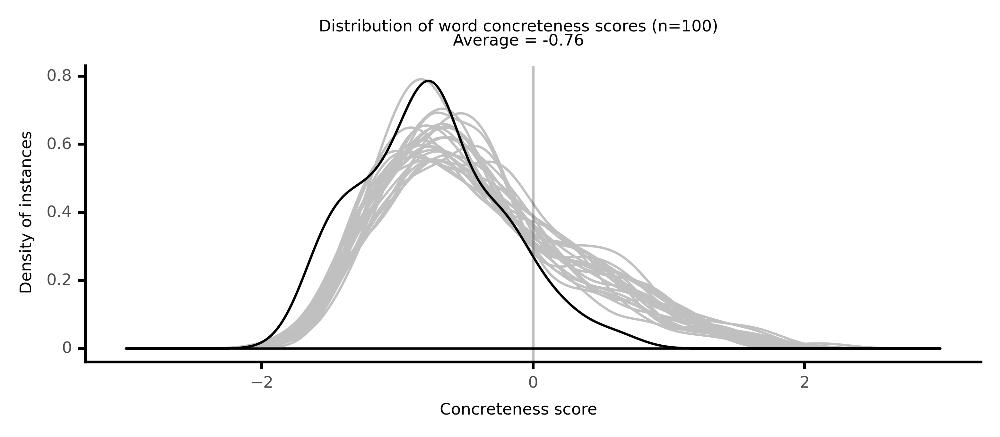

<ggplot: (8764105178057)>

 74%|███████▍  | 74/100 [15:33<04:47, 11.06s/it]

#### #75 most abstract passage: Scott, _Waverley; or, 'Tis Sixty Years Since [in, the Wave_ (1830)

<p><abs><conc069>disposition</conc069></abs> of this <neither><conc265>kind</conc265></neither>; for, from the <neither><conc557>instant</conc557></neither> I <neither><conc397>perceived</conc397></neither> the <abs><conc220>extreme</conc220></abs> <neither><conc352>curiosity</conc352></neither> <abs><conc050>manifested</conc050></abs> on the <abs><conc047>subject</conc047></abs>, I felt a <abs><conc218>secret</conc218></abs> <abs><conc161>satisfaction</conc161></abs> in <abs><conc238>baffling</conc238></abs> it, for which, when its unimportance is <abs><conc135>considered</conc135></abs>, I do not well know how to account. My <abs><conc040>desire</conc040></abs> to <neither><conc321>remain</conc321></neither> <neither><conc609>concealed</conc609></neither>, in the <abs><conc025>character</conc025></abs> of the <abs><conc072>Author</conc072></abs> of these <neither><conc432>Novels</conc432></neither>, <abs><conc150>subjected</conc150></abs> me <neither><conc488>occasionally</conc488></neither> to <neither><conc492>awkward</conc492></neither> <abs><conc061>embarrassments</conc061></abs>, as it sometime <neither><conc455>happened</conc455></neither> that those who were sufficiently <abs><conc211>intimate</conc211></abs> with me, would put the <abs><conc153>question</conc153></abs> in <abs><conc044>direct</conc044></abs> terms. In this case, only one of three <neither><conc378>courses</conc378></neither> could be followed. Either I must have <neither><conc310>surrendered</conc310></neither> my <abs><conc218>secret</conc218></abs>,-- or have returned an equivocating <abs><conc207>answer</conc207></abs>,-- or, finally, must have <neither><conc453>stoutly</conc453></neither> and <neither><conc407>boldly</conc407></neither> <abs><conc047>denied</conc047></abs> the <abs><conc067>fact</conc067></abs>. The first was a <abs><conc136>sacrifice</conc136></abs> which I <abs><conc089>conceive</conc089></abs> no one had a right to <abs><conc166>force</conc166></abs> from me, since I alone was <abs><conc114>concerned</conc114></abs> in the matter. The <abs><conc159>alternative</conc159></abs> of <abs><conc172>rendering</conc172></abs> a <abs><conc139>doubtful</conc139></abs> <abs><conc207>answer</conc207></abs> must have left me <neither><conc538>open</conc538></neither> to the <abs><conc060>degrading</conc060></abs> <abs><conc170>suspicion</conc170></abs> that I was not <abs><conc144>unwilling</conc144></abs> to <abs><conc134>assume</conc134></abs> the <abs><conc048>merit</conc048></abs>( if there was any) which I <neither><conc342>dared</conc342></neither> not <abs><conc149>absolutely</conc149></abs> lay <abs><conc093>claim</conc093></abs> to; or those who might think more <abs><conc021>justly</conc021></abs> of me, must have <neither><conc263>received</conc263></neither> such an <abs><conc086>equivocal</conc086></abs> <abs><conc207>answer</conc207></abs> as an <abs><conc080>indirect</conc080></abs> <abs><conc021>avowal</conc021></abs>. I therefore <abs><conc135>considered</conc135></abs> myself <abs><conc138>entitled</conc138></abs>, Like an <abs><conc153>accused</conc153></abs> person put upon <abs><conc179>trial</conc179></abs>, to <neither><conc265>refuse</conc265></neither> giving my own <abs><conc069>evidence</conc069></abs> to my own <abs><conc004>conviction</conc004></abs>, and <abs><conc148>flatly</conc148></abs> to <abs><conc036>deny</conc036></abs> all that could not be <abs><conc155>proved</conc155></abs> against me. At the same time I usually <abs><conc112>qualified</conc112></abs> my <abs><conc017>denial</conc017></abs> by <abs><conc144>stating</conc144></abs>, that, had I been the <abs><conc072>author</conc072></abs> of these works, I would have felt myself quite <abs><conc138>entitled</conc138></abs> to <neither><conc353>protect</conc353></neither> my <abs><conc218>secret</conc218></abs> by <abs><conc183>refusing</conc183></abs> my own <abs><conc069>evidence</conc069></abs>, when it was <neither><conc379>asked</conc379></neither> for to <abs><conc129>accomplish</conc129></abs> a <abs><conc255>discovery</conc255></abs> of what I <abs><conc252>desired</conc252></abs> to <neither><conc381>conceal</conc381></neither>. The real <abs><conc013>truth</conc013></abs> is, that I never <abs><conc195>expected</conc195></abs> or <abs><conc253>hoped</conc253></abs> to <neither><conc379>disguise</conc379></neither> my <abs><conc098>connexion</conc098></abs> with these <neither><conc432>Novels</conc432></neither> from any one who <neither><conc460>lived</conc460></neither> on terms of <abs><conc261>intimacy</conc261></abs> with me. The <neither><conc413>number</conc413></neither> of <abs><conc091>coincidences</conc091></abs> which necessarily <abs><conc160>existed</conc160></abs> between <abs><conc134>narratives</conc134></abs> <abs><conc242>recounted</conc242></abs>, <abs><conc127>modes</conc127></abs> of <abs><conc132>expression</conc132></abs>, and <abs><conc013>opinions</conc013></abs> <abs><conc237>broached</conc237></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

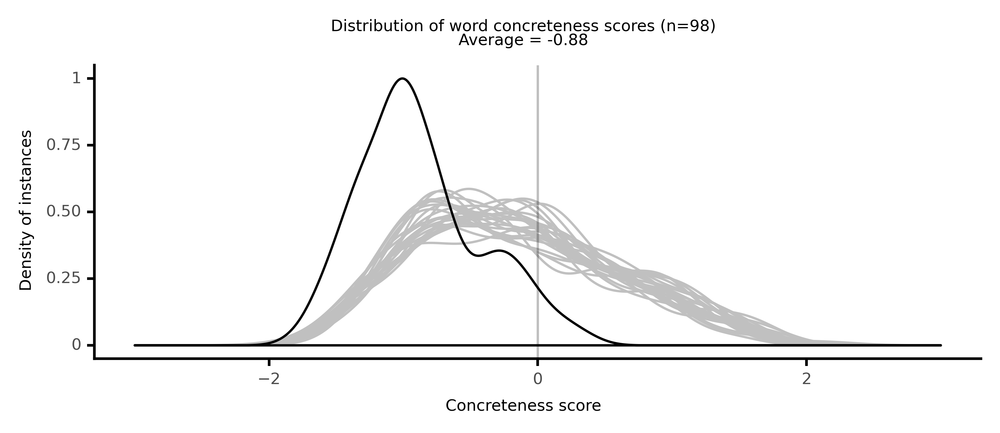

<ggplot: (8764097633241)>

 75%|███████▌  | 75/100 [15:47<04:55, 11.80s/it]

#### #76 most abstract passage: Simms, _The Lily and the Totem; or, The Huguenots in Flori_ (1850)

<p>that, with our Huguenots, as in the case of the New England <abs><conc123>Puritans</conc123></abs>, the <abs><conc104>idea</conc104></abs> of <abs><conc025>religion</conc025></abs> was more <neither><conc318>properly</conc318></neither> the <abs><conc104>idea</conc104></abs> of <abs><conc215>party</conc215></abs>. It was a <abs><conc145>struggle</conc145></abs> for <abs><conc009>political</conc009></abs> <abs><conc028>power</conc028></abs> that <neither><conc489>moved</conc489></neither> the <abs><conc082>Dissenters</conc082></abs>, as well in France as England, quite as much as any <abs><conc062>feeling</conc062></abs> of <abs><conc017>denial</conc017></abs> or <abs><conc143>privation</conc143></abs> on the <neither><conc452>score</conc452></neither> of their <abs><conc025>religion</conc025></abs>. This <neither><conc292>pretext</conc292></neither> was made to <abs><conc006>justify</conc006></abs> a cause which might have well found its <abs><conc012>sanction</conc012></abs> in its <abs><conc086>intrinsic</conc086></abs> <abs><conc076>merits</conc076></abs>; but which it was <abs><conc096>deemed</conc096></abs> <abs><conc110>politic</conc110></abs> to <abs><conc117>urge</conc117></abs> on the <neither><conc262>higher</conc262></neither> <neither><conc323>grounds</conc323></neither> of <abs><conc026>conscience</conc026></abs> and <abs><conc127>duty</conc127></abs> to God. Certain it is that we do not anywhere see, in the <abs><conc108>history</conc108></abs> of the <neither><conc310>colony</conc310></neither> <abs><conc172>established</conc172></abs> by Coligny, any <abs><conc086>proofs</conc086></abs> of that <neither><conc370>strong</conc370></neither> <abs><conc157>devotional</conc157></abs> <abs><conc050>sentiment</conc050></abs> which has been <abs><conc123>urged</conc123></abs> as the <abs><conc061>motive</conc061></abs> to its <neither><conc341>establishment</conc341></neither>. <abs><conc078>Doubtless</conc078></abs>, this was a <abs><conc133>prevailing</conc133></abs> <abs><conc061>motive</conc061></abs>, along with others, for Coligny himself; but the <neither><conc334>adventurers</conc334></neither> <abs><conc210>chosen</conc210></abs> to begin the <neither><conc355>settlement</conc355></neither> for the <neither><conc385>reception</conc385></neither> of the <abs><conc114>persecuted</conc114></abs> <abs><conc102>sect</conc102></abs> in Florida, were <neither><conc338>evidently</conc338></neither> not very <neither><conc275>deeply</conc275></neither> <abs><conc102>imbued</conc102></abs> with <abs><conc025>religion</conc025></abs> of any <neither><conc265>kind</conc265></neither>. They were a <neither><conc593>wild</conc593></neither> and <abs><conc136>reckless</conc136></abs> body of men, whose <abs><conc101>deeds</conc101></abs> were <abs><conc085>wholly</conc085></abs> in <abs><conc066>conflict</conc066></abs> with the <neither><conc371>pure</conc371></neither> and <conc><conc844>lovely</conc844></conc> <abs><conc075>profession</conc075></abs> of <abs><conc050>sentiment</conc050></abs> which has been made in their behalf. How far their <abs><conc101>deeds</conc101></abs> are to be <abs><conc008>justified</conc008></abs> by the <abs><conc008>provocations</conc008></abs> which they <neither><conc263>received</conc263></neither>, and the <abs><conc068>tyrannies</conc068></abs> which they <abs><conc184>endured</conc184></abs>, may be a <abs><conc153>question</conc153></abs>; but there can be no <abs><conc153>question</conc153></abs> with regard to the <abs><conc129>general</conc129></abs> <abs><conc133>temper</conc133></abs> which they <abs><conc196>exhibited</conc196></abs>-- the <abs><conc243>tone</conc243></abs> of their <abs><conc040>minds</conc040></abs>-- the <abs><conc081>feelings</conc081></abs> of their <neither><conc274>hearts</conc274></neither>-- by all of which they are shown as <abs><conc218>stubborn</conc218></abs>, <abs><conc073>insubordinate</conc073></abs> and <abs><conc111>selfish</conc111></abs>. It is not <abs><conc047>denied</conc047></abs> that they had great <abs><conc232>provocation</conc232></abs> to <abs><conc112>violence</conc112></abs>; but Laudonniere himself <abs><conc096>admits</conc096></abs> that they were, in all <abs><conc100>probability</conc100></abs>, not so <neither><conc376>obedient</conc376></neither> to their captain as they should have been.'' <abs><conc146>Misfortune</conc146></abs>,'' he <abs><conc170>adds</conc170></abs>, or rather the just <abs><conc006>judgement</conc006></abs> of God would have it that those which could not be <abs><conc175>overcome</conc175></abs> by fire nor <conc><conc852>water</conc852></conc>, should be <neither><conc337>undone</conc337></neither> by their ownselves. This is the <abs><conc256>common</conc256></abs> <neither><conc495>fashion</conc495></neither> of men, which can not <abs><conc156>continue</conc156></abs> in one state, and had rather to <abs><conc046>overthrow</conc046></abs> themselves, than not to <abs><conc106>attempt</conc106></abs> some new thing <neither><conc314>daily</conc314></neither>.'' Not only was no <abs><conc093>peace</conc093></abs> in the <neither><conc310>colony</conc310></neither> after the <abs><conc199>execution</conc199></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

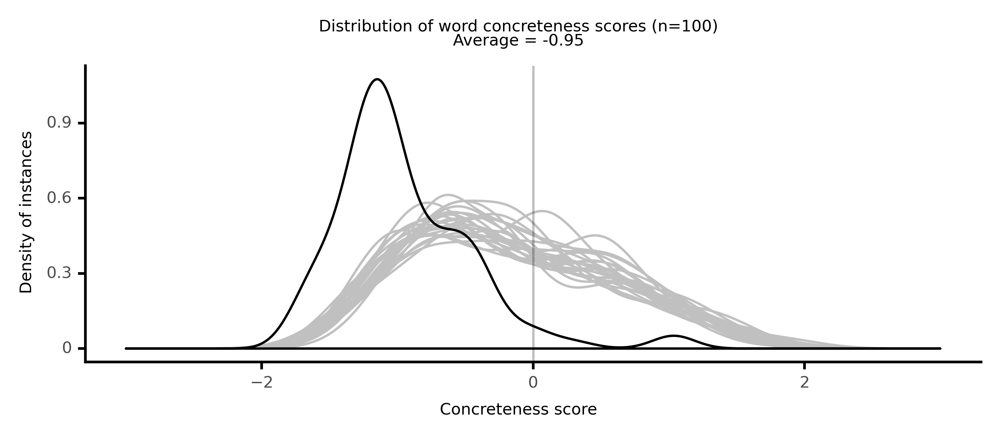

<ggplot: (8764113016909)>

 76%|███████▌  | 76/100 [16:00<04:53, 12.22s/it]

#### #77 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>, <abs><conc212>preferable</conc212></abs> to the <abs><conc079>redress</conc079></abs> of <abs><conc082>grievances</conc082></abs>, and to <abs><conc157>depend</conc157></abs> on <neither><conc409>royal</conc409></neither> <abs><conc095>promises</conc095></abs>, for time and <neither><conc259>opportunity</conc259></neither> to <neither><conc342>dispatch</conc342></neither> other business.3. That the <neither><conc256>commons</conc256></neither> had no right and <abs><conc020>power</conc020></abs> of <neither><conc249>inquiring</conc249></neither> into the <abs><conc195>demeanour</conc195></abs> of the king's <abs><conc071>ministers</conc071></abs> and <neither><conc418>nearest</conc418></neither> <neither><conc453>servants</conc453></neither>, and <abs><conc018>impeaching</conc018></abs> them for misdemeanours.4. That the king could, in his <neither><conc236>courts</conc236></neither> below, take <abs><conc099>cognizance</conc099></abs> of, and <abs><conc018>censure</conc018></abs> the <abs><conc137>debates</conc137></abs> of the commons.5. That the king could, by <abs><conc165>warrants</conc165></abs> <neither><conc375>signed</conc375></neither> with his own <neither><conc549>hand</conc549></neither>, <neither><conc269>arrest</conc269></neither> and <neither><conc374>imprison</conc374></neither> his <abs><conc046>Subject</conc046></abs>'s; and especially the <abs><conc194>members</conc194></abs> of <abs><conc156>parliament</conc156></abs>, for what they said and did in <abs><conc156>parliament</conc156></abs>. These <abs><conc060>illegal</conc060></abs> and <abs><conc185>destructive</conc185></abs> <abs><conc054>acts</conc054></abs> of <abs><conc020>power</conc020></abs> king Charles the First <abs><conc137>claimed</conc137></abs> as his <abs><conc067>prerogatives</conc067></abs>, and <abs><conc037>exercised</conc037></abs> them as <neither><conc513>long</conc513></neither> as he was able, with great <abs><conc129>rigour</conc129></abs>, and <abs><conc134>extraordinary</conc134></abs> circumstances; and how such a <abs><conc090>general</conc090></abs> <abs><conc092>oppression</conc092></abs>, and <abs><conc128>rendering</conc128></abs> the two <neither><conc237>estates</conc237></neither> of <neither><conc303>lords</conc303></neither> and <neither><conc256>commons</conc256></neither> of no <abs><conc126>signification</conc126></abs>, can make the <abs><conc199>memory</conc199></abs> of this prince <neither><conc300>blessed</conc300></neither>;------ or, how his <abs><conc092>suffering</conc092></abs>, in the manner he did, in <abs><conc110>defence</conc110></abs> of such <abs><conc013>absolute</conc013></abs>, lawgiving <abs><conc020>power</conc020></abs>, that was <abs><conc009>inconsistent</conc009></abs> with the <abs><conc098>constitution</conc098></abs>, and with the <abs><conc058>reasons</conc058></abs> upon which it is <abs><conc118>founded</conc118></abs>, can <abs><conc081>render</conc081></abs> him a <abs><conc194>holy</conc194></abs> and <neither><conc300>blessed</conc300></neither> <abs><conc222>martyr</conc222></abs>, is <neither><conc366>passed</conc366></neither> my <abs><conc019>comprehension</conc019></abs>. I should rather <neither><conc268>choose</conc268></neither> to say, that since Charles would not act for the <abs><conc169>protection</conc169></abs>, <abs><conc063>happiness</conc063></abs>, and <abs><conc117>safety</conc117></abs> of his people, but by a <neither><conc270>continued</conc270></neither> <abs><conc039>exertion</conc039></abs> of <abs><conc102>sovereign</conc102></abs> <abs><conc020>power</conc020></abs>, <abs><conc171>endeavoured</conc171></abs> to <abs><conc170>oppress</conc170></abs> and <neither><conc297>ruin</conc297></neither> them, and <neither><conc260>change</conc260></neither> the from of <abs><conc027>government</conc027></abs>, his <abs><conc017>arbitrary</conc017></abs> <abs><conc010>principles</conc010></abs> brought him to a <neither><conc522>dismal</conc522></neither> <neither><conc670>extremity</conc670></neither>. This( as before <neither><conc372>observed</conc372></neither>) is the <abs><conc065>truth</conc065></abs> of the case. May his <abs><conc199>death</conc199></abs> be a <neither><conc250>warning</conc250></neither> to <abs><conc039>future</conc039></abs> English <abs><conc203>kings</conc203></abs>; that they may, Like his <abs><conc185>majesty</conc185></abs> king George the Second, <abs><conc037>govern</conc037></abs> with <abs><conc125>parliaments</conc125></abs>, and <abs><conc071>exert</conc071></abs> their <abs><conc020>power</conc020></abs> for the <abs><conc169>protection</conc169></abs>, <abs><conc117>safety</conc117></abs>, and <abs><conc063>happiness</conc063></abs> of the people.; and when James the Second <neither><conc357>began</conc357></neither> his <abs><conc067>tyranny</conc067></abs>, by <abs><conc055>dispensing</conc055></abs> with the <abs><conc071>penal</conc071></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

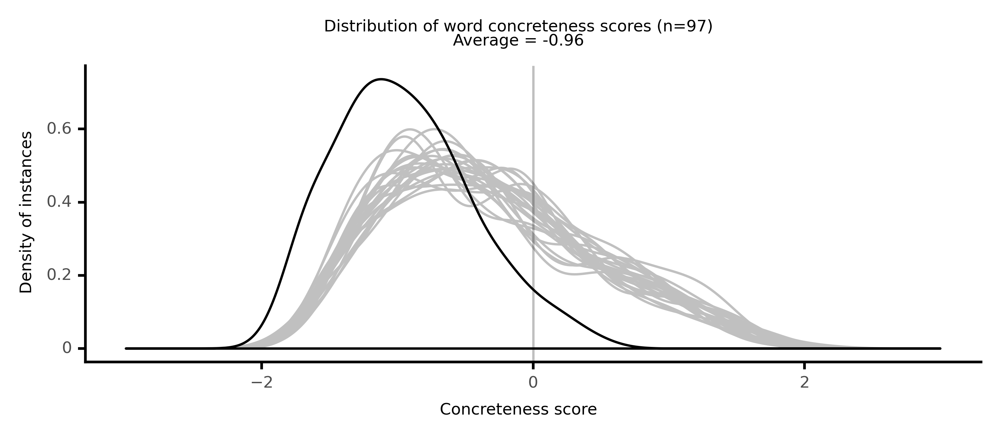

<ggplot: (8764112222401)>

 77%|███████▋  | 77/100 [16:14<04:56, 12.88s/it]

#### #78 most abstract passage: Richardson, _Clarissa (3rd ed.) (1751)_ (1751)

<p>with you upon the occasion. It is not my <abs><conc076>intention</conc076></abs> to <abs><conc174>displease</conc174></abs> you in what I am going to <neither><conc280>write</conc280></neither>: And yet I must deal <abs><conc167>freely</conc167></abs> with you. The occasion <neither><conc283>calls</conc283></neither> for it. And <abs><conc209>permit</conc209></abs> me, in the first place, to <abs><conc120>remind</conc120></abs> you, That I am your Sister; and not your Servant; and that, therefore, the <neither><conc408>bitter</conc408></neither> <abs><conc206>revilings</conc206></abs> and <abs><conc195>passionate</conc195></abs> <abs><conc158>language</conc158></abs> brought me from you, upon an occasion in which you have no <abs><conc031>reason</conc031></abs> to <abs><conc117>prescribe</conc117></abs> to me, are neither <abs><conc116>worthy</conc116></abs> of my <abs><conc182>character</conc182></abs> to <neither><conc338>bear</conc338></neither>, nor of yours to <abs><conc220>offer</conc220></abs>. Put the case, that I were to <neither><conc441>marry</conc441></neither> the man you <abs><conc072>dislike</conc072></abs>; and that he were not to make a <neither><conc243>polite</conc243></neither> or <neither><conc541>tender</conc541></neither> <neither><conc581>Husband</conc581></neither>, Is that a <abs><conc031>reason</conc031></abs> for you to be an <neither><conc243>polite</conc243></neither> and <abs><conc072>disobliging</conc072></abs> Brother?-- Why must you, Sir, <abs><conc038>anticipate</conc038></abs> my <abs><conc112>misfortunes</conc112></abs>, were such a case to <neither><conc262>happen</conc262></neither>?-- Let me tell you <abs><conc114>plainly</conc114></abs>, that the man who could <abs><conc186>treat</conc186></abs> me as a <neither><conc538>Wife</conc538></neither>, worse than you of <neither><conc291>late</conc291></neither> have <abs><conc197>treated</conc197></abs> me as a Sister, must be a <abs><conc167>barbarous</conc167></abs> man indeed. Ask yourself, I <neither><conc608>prey</conc608></neither> you, Sir, If you would thus have <abs><conc197>treated</conc197></abs> your Sister <neither><conc545>Bella</conc545></neither>, had she thought <neither><conc311>fit</conc311></neither> to <neither><conc238>receive</conc238></neither> the <abs><conc195>addresses</conc195></abs> of the man so much <abs><conc201>hated</conc201></abs> by you?-- If not, let me <abs><conc175>caution</conc175></abs> you, my Brother, not to take your <abs><conc153>measures</conc153></abs> by what you think will be <neither><conc297>born</conc297></neither>, but rather by what aught to be <abs><conc228>offered</conc228></abs>. How would you take it, if you had a Brother, who, in a Like case, were to act by you, as you do by me? You can not but <neither><conc299>remember</conc299></neither> what a <neither><conc307>Laconic</conc307></neither> <abs><conc148>answer</conc148></abs> you gave even to my Father, who <abs><conc225>recommended</conc225></abs> to you Miss <neither><conc725>Nelly</conc725></neither> D'Oily-- You did not Like her, were your words: And that was thought <abs><conc164>sufficient</conc164></abs>. You must needs think, that I can not but know to whom to <abs><conc035>attribute</conc035></abs> my <abs><conc043>disgraces</conc043></abs>, when I <neither><conc258>recollect</conc258></neither> my Father's <abs><conc029>indulgence</conc029></abs> to me, in <abs><conc101>permitting</conc101></abs> me to <abs><conc127>decline</conc127></abs> several <abs><conc170>offers</conc170></abs>; and to whom, that a <abs><conc232>common</conc232></abs> cause is <abs><conc171>endeavoured</conc171></abs> to be made, in <abs><conc067>favour</conc067></abs> of a man whose person and <abs><conc130>manners</conc130></abs> are more <abs><conc047>exceptionable</conc047></abs> than those of any of the <neither><conc332>gentlemen</conc332></neither> I have been <abs><conc210>permitted</conc210></abs> to <abs><conc201>refuse</conc201></abs>. I <abs><conc220>offer</conc220></abs> not to <neither><conc244>compare</conc244></neither> the two men together: Nor is there indeed the least <abs><conc099>comparison</conc099></abs> to be made between them. All the <abs><conc204>difference</conc204></abs> to the one's <abs><conc123>disadvantage</conc123></abs>, if I did, is but in one <neither><conc317>point</conc317></neither>-- Of the greatest importance, indeed-- But to whom of most importance?-- To myself, surely, were I to <abs><conc098>encourage</conc098></abs> his <abs><conc044>application</conc044></abs>:-- Of the least to you. Nevertheless, if you do not, by your <abs><conc227>strange</conc227></abs> <abs><conc081>politics</conc081></abs>, <neither><conc285>unite</conc285></neither> that man and me as joint-sufferers in one cause, you shall find me as much <abs><conc131>resolved</conc131></abs> to <abs><conc050>renounce</conc050></abs> him, as I am to <abs><conc201>refuse</conc201></abs> the other. I have made an <abs><conc220>overture</conc220></abs> to this <neither><conc295>purpose</conc295></neither>: I <abs><conc131>hope</conc131></abs> you will not give me <abs><conc031>reason</conc031></abs> to <abs><conc069>confirm</conc069></abs> my <abs><conc099>apprehensions</conc099></abs>, that it will be owing to you if it be not <abs><conc172>accepted</conc172></abs>. It is a <neither><conc377>sad</conc377></neither> thing to have it to say, without being <abs><conc127>conscious</conc127></abs> of ever having given you cause of <abs><conc088>offence</conc088></abs>, that I have in you a Brother, but not a Friend. Perhaps you will not <abs><conc193>condescend</conc193></abs> to <neither><conc354>enter</conc354></neither> into the <abs><conc058>reasons</conc058></abs> of your <neither><conc291>late</conc291></neither> and present <abs><conc010>conduct</conc010></abs> with a <neither><conc266>foolish</conc266></neither> Sister. But if <abs><conc201>politeness</conc201></abs>, if <abs><conc223>civility</conc223></abs>, be not due to that <abs><conc182>character</conc182></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

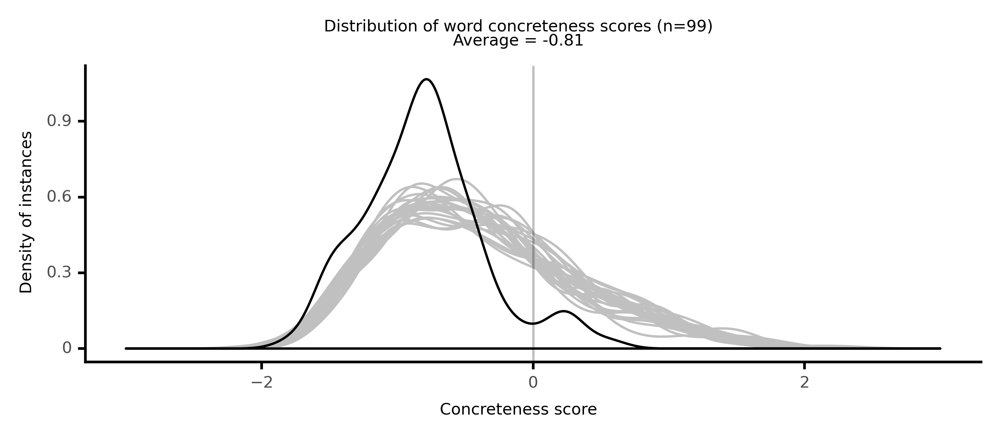

<ggplot: (8764171727157)>

 78%|███████▊  | 78/100 [16:42<06:19, 17.25s/it]

#### #79 most abstract passage: Richardson, _Familiar Letters (1750)_ (1750)

<p>( and I will say, for yours too, because your Honour is <abs><conc062>concerned</conc062></abs> in it so <neither><conc272>deeply</conc272></neither>), that I had had, at my first <neither><conc315>Acquaintance</conc315></neither> with you, such an <abs><conc130>Instance</conc130></abs> of your <abs><conc073>Plain-dealing</conc073></abs>, or, rather, <abs><conc099>Baseness</conc099></abs>: Then I should have had no <abs><conc136>Regret</conc136></abs> in <neither><conc617>letting</conc617></neither> you know how much I <abs><conc110>scorned</conc110></abs> the <abs><conc055>Proposer</conc055></abs>, and the <abs><conc227>Proposal</conc227></abs>: Tho' I <abs><conc131>hope</conc131></abs>, as it is, a little Time and <abs><conc083>Reflection</conc083></abs> will make me, for the <neither><conc253>sake</conc253></neither> of the latter, <abs><conc044>abhor</conc044></abs> the former. However, Sir, I must say, you are very <abs><conc202>cruel</conc202></abs> to use me thus, after you had, by all the <neither><conc423>alluring</conc423></neither> <abs><conc039>Professions</conc039></abs> of an <abs><conc085>honourable</conc085></abs> Love, <abs><conc040>inspired</conc040></abs> me with a <neither><conc280>grateful</conc280></neither> Return, and brought me to the <abs><conc072>Freedom</conc072></abs> of <abs><conc056>owning</conc056></abs> it-- Nor yet will I be an <neither><conc273>Hypocrite</conc273></neither>, or <abs><conc057>deny</conc057></abs> my <abs><conc184>honest</conc184></abs> <abs><conc175>Passion</conc175></abs>; for that would be to <abs><conc164>lessen</conc164></abs> your <abs><conc090>Guilt</conc090></abs>. God is my <abs><conc174>Witness</conc174></abs>, I <neither><conc253>loved</conc253></neither> you beyond all your <neither><conc409>Sex</conc409></neither>; yet I <neither><conc253>loved</conc253></neither> you <abs><conc041>virtuously</conc041></abs>; I <neither><conc253>loved</conc253></neither> you because I thought you <abs><conc077>virtuous</conc077></abs>. And now, though' it may take some Time, and too much <abs><conc136>Regret</conc136></abs>, to get over; yet do I <abs><conc131>hope</conc131></abs>, your <abs><conc093>Behaviour</conc093></abs> will <abs><conc152>enable</conc152></abs> me to <abs><conc208>conquer</conc208></abs> my found <abs><conc119>Folly</conc119></abs>. <abs><conc086>Ungenerous</conc086></abs> Man! to take <abs><conc139>Advantage</conc139></abs> of your <abs><conc139>superior</conc139></abs> <neither><conc290>Fortune</conc290></neither> to <abs><conc171>insult</conc171></abs> me thus, when you had <abs><conc182>gained</conc182></abs> my <abs><conc140>Affections</conc140></abs>! What, though' I am not <neither><conc300>blessed</conc300></neither> with a <abs><conc062>worldly</conc062></abs> Circumstance <neither><conc258>equal</conc258></neither> to what you might <abs><conc068>expect</conc068></abs> in a <neither><conc538>Wife</conc538></neither>, can you think my Mind so <neither><conc511>base</conc511></neither> as to <abs><conc033>submit</conc033></abs> to be yours on <abs><conc029>unworthy</conc029></abs> Terms? Go, <abs><conc029>unworthy</conc029></abs> Man, and make your <neither><conc251>Court</conc251></neither> to Miss Reynolds, as you seem to <abs><conc187>threaten</conc187></abs>. She has a <neither><conc290>Fortune</conc290></neither> <neither><conc258>equal</conc258></neither> to your own, and may you be <abs><conc211>happy</conc211></abs> together! I should have been so, had I never known you. I never <abs><conc163>deceived</conc163></abs> you: You knew my <neither><conc462>scanty</conc462></neither> <neither><conc290>Fortune</conc290></neither>, and yet <abs><conc082>pretended</conc082></abs> to <abs><conc219>prefer</conc219></abs> me to all my <neither><conc409>Sex</conc409></neither>. On me you might have <neither><conc503>laid</conc503></neither> the <neither><conc238>highest</conc238></neither> <abs><conc041>Obligation</conc041></abs>, by <neither><conc320>raising</conc320></neither> me to a <abs><conc148>Condition</conc148></abs> I was <neither><conc292>humble</conc292></neither> enough to think above me; and I should have been, on that Account, all <abs><conc108>Gratitude</conc108></abs>, all <abs><conc135>Duty</conc135></abs>, all <abs><conc039>Acknowlegement</conc039></abs>. On Miss Reynolds you will <abs><conc061>confer</conc061></abs> none; her <neither><conc290>Fortune</conc290></neither> will <neither><conc424>quit</conc424></neither> <neither><conc732>Scores</conc732></neither> with yours, and you must both, in your <abs><conc188>Union</conc188></abs>, be <neither><conc235>Strangers</conc235></neither> to the <neither><conc342>inexpressible</conc342></neither> <abs><conc191>Pleasure</conc191></abs> of <abs><conc222>receiving</conc222></abs> or <abs><conc073>conferring</conc073></abs> of <abs><conc019>Benefits</conc019></abs>: But this is a <abs><conc191>Pleasure</conc191></abs> which none but <abs><conc107>generous</conc107></abs> <abs><conc062>Minds</conc062></abs> can <neither><conc469>taste</conc469></neither>. That yours is not so, <abs><conc174>witness</conc174></abs> your <abs><conc230>detested</conc230></abs> <abs><conc227>Proposal</conc227></abs>, after such <neither><conc311>solemn</conc311></neither> <abs><conc039>Professions</conc039></abs> of <abs><conc165>faithful</conc165></abs> and <abs><conc085>honourable</conc085></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

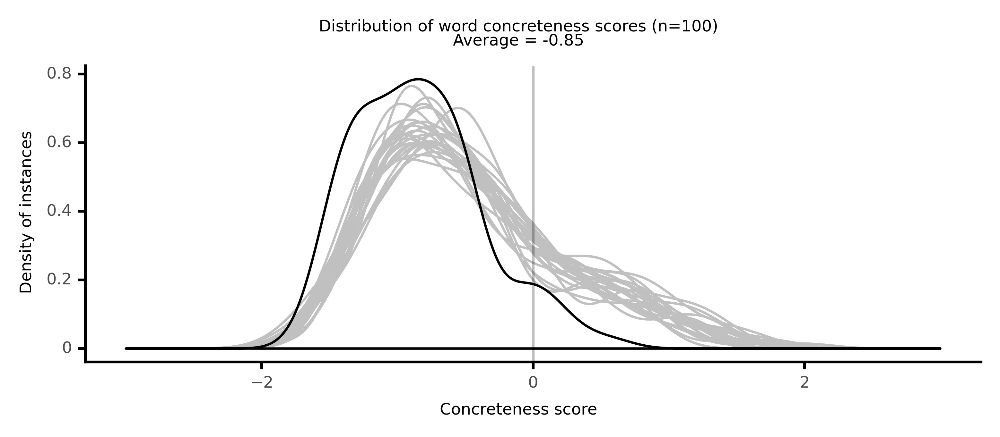

<ggplot: (8764196490461)>

 79%|███████▉  | 79/100 [16:54<05:29, 15.69s/it]

#### #80 most abstract passage: Sedgwick, _Hope Leslie, volume 2 (1827)_ (1827)

<p>would certainly, he <abs><conc119>believed</conc119></abs>, not be <neither><conc407>detected</conc407></neither>; and, at any <neither><conc401>rate</conc401></neither>, could not <abs><conc019>involve</conc019></abs> her in any <neither><conc353>disagreeable</conc353></neither> <abs><conc025>consequences</conc025></abs>. Any <abs><conc025>consequences</conc025></abs> to herself,' Esther said, she would not <abs><conc069>fear</conc069></abs>.' Everell <abs><conc154>assured</conc154></abs> her, that he was certain she would not; but he was <neither><conc281>anxious</conc281></neither> she should see he would not <abs><conc161>expose</conc161></abs> her to any, even to <abs><conc121>attain</conc121></abs> an <abs><conc162>object</conc162></abs> for which he would <neither><conc293>risk</conc293></neither> or <abs><conc136>sacrifice</conc136></abs> his own life. He then went on <neither><conc618>eagerly</conc618></neither> to detail his <abs><conc260>plan</conc260></abs> of <abs><conc203>operations</conc203></abs>, till Esther <neither><conc441>summoned</conc441></neither> <abs><conc158>courage</conc158></abs> to <neither><conc285>interrupt</conc285></neither> him. Perhaps there is not on <neither><conc452>earth</conc452></neither> a more <abs><conc219>difficult</conc219></abs> <abs><conc127>duty</conc127></abs>, than for a woman to place herself in a <neither><conc353>disagreeable</conc353></neither> <neither><conc532>light</conc532></neither> before the man she truly <neither><conc440>loves</conc440></neither>. Esther's <abs><conc228>affections</conc228></abs> were <neither><conc586>deep</conc586></neither>, <neither><conc347>fixed</conc347></neither>, and <neither><conc387>unpretending</conc387></neither>, <abs><conc174>capable</conc174></abs> of any <abs><conc124>effort</conc124></abs>, or any <abs><conc136>sacrifice</conc136></abs>, that was not <abs><conc083>proscribed</conc083></abs> by <abs><conc043>religious</conc043></abs> <abs><conc046>loyalty</conc046></abs>; but no <abs><conc197>earthly</conc197></abs> <abs><conc090>consideration</conc090></abs> could have <abs><conc254>tempted</conc254></abs> her to <neither><conc290>waver</conc290></neither> from the <abs><conc075>strictest</conc075></abs> <neither><conc343>letter</conc343></neither> of her <abs><conc043>religious</conc043></abs> <abs><conc127>duty</conc127></abs>, as that <abs><conc127>duty</conc127></abs> was <abs><conc098>interpreted</conc098></abs> by her <abs><conc026>conscience</conc026></abs>. It <neither><conc422>cost</conc422></neither> her <abs><conc199>severe</conc199></abs> <abs><conc204>struggles</conc204></abs>, but after several <abs><conc028>intimations</conc028></abs>, which Everell did not <abs><conc141>understand</conc141></abs>, she <abs><conc103>constrained</conc103></abs> herself to say, that she thought they had not <abs><conc123>scripture</conc123></abs> <abs><conc247>warrant</conc247></abs> for <abs><conc213>interfering</conc213></abs> between the <neither><conc397>prisoner</conc397></neither> and the <abs><conc138>magistrates</conc138></abs>.' <abs><conc123>Scripture</conc123></abs> <abs><conc247>warrant</conc247></abs>!'' <neither><conc638>exclaimed</conc638></neither> Everell with <neither><conc372>surprise</conc372></neither> and <neither><conc418>vexation</conc418></neither> he could not <neither><conc381>conceal</conc381></neither>. And are you to do no act of <abs><conc197>mercy</conc197></abs>, or <abs><conc230>compassion</conc230></abs>, or <abs><conc027>justice</conc027></abs>, for which you can not quote a <neither><conc353>text</conc353></neither> from <abs><conc123>scripture</conc123></abs>?'' <abs><conc123>Scripture</conc123></abs> hath <neither><conc408>abundant</conc408></neither> <abs><conc242>texts</conc242></abs> to authorise all <abs><conc197>mercy</conc197></abs>, <abs><conc230>compassion</conc230></abs>, and <abs><conc027>justice</conc027></abs>, but we are not always the <neither><conc288>allowed</conc288></neither> <abs><conc112>judges</conc112></abs> of their <abs><conc085>application</conc085></abs>; and in the case before us we have an <abs><conc116>express</conc116></abs> <abs><conc103>rule</conc103></abs>, to which, if we <abs><conc062>submit</conc062></abs>, we can not <abs><conc028>err</conc028></abs>; for thou well <neither><conc329>knowest</conc329></neither>, Everell, we are <neither><conc408>commanded</conc408></neither> in the first of Peter,2d chapter, to <abs><conc062>submit</conc062></abs> ourselves to every <abs><conc211>ordinance</conc211></abs> of man, for the Lord's <abs><conc219>sake</conc219></abs>: whither it be to the king, as <abs><conc098>supreme</conc098></abs>; or unto <abs><conc201>governors</conc201></abs>, as unto them that are sent by him for the <abs><conc043>punishment</conc043></abs> of <abs><conc031>evil</conc031></abs> <abs><conc029>doers</conc029></abs>, and for the <abs><conc130>praise</conc130></abs> of them that do well.' But surely, Esther, there must be <abs><conc247>warrant</conc247></abs>, as you call it, for sometime <abs><conc119>resisting</conc119></abs> <abs><conc026>legitimate</conc026></abs> <abs><conc017>authority</conc017></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

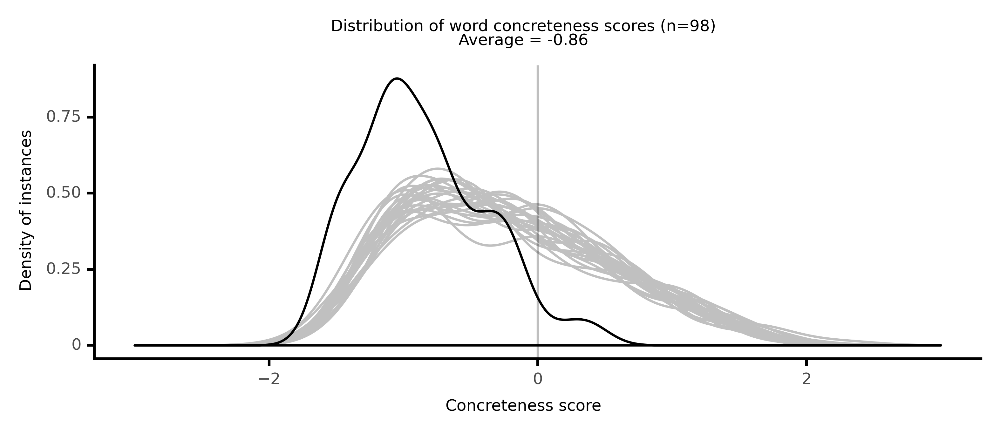

<ggplot: (8764112743201)>

 80%|████████  | 80/100 [17:05<04:45, 14.26s/it]

#### #81 most abstract passage: Brooke, _The Fool of Quality (1765)_ (1765)

<p>by their <abs><conc134>Delegates</conc134></abs> in <abs><conc156>Parliament</conc156></abs>; this great Body <abs><conc078>politic</conc078></abs> or <abs><conc125>Representative</conc125></abs> of the <abs><conc073>Nation</conc073></abs> <neither><conc504>consists</conc504></neither>, Like the Body <abs><conc077>natural</conc077></abs>, of a <conc><conc808>Head</conc808></conc> and several <abs><conc194>Members</conc194></abs>, which, being <neither><conc236>endowed</conc236></neither> with different <abs><conc054>Powers</conc054></abs> for the <abs><conc064>exercise</conc064></abs> of different <abs><conc150>Offices</conc150></abs>, are yet <abs><conc183>connected</conc183></abs> by one <neither><conc494>main</conc494></neither> and <abs><conc232>common</conc232></abs> Interest, and <abs><conc022>actuated</conc022></abs> by one Life or <abs><conc032>Spirit</conc032></abs> of <abs><conc077>public</conc077></abs> <abs><conc031>Reason</conc031></abs>, <neither><conc481>called</conc481></neither> the <abs><conc023>Laws</conc023></abs>. In all <neither><conc486>Steps</conc486></neither> of <abs><conc024>National</conc024></abs> <abs><conc212>Import</conc212></abs>, the King it to be <neither><conc343>conducted</conc343></neither> by the <neither><conc308>Direction</conc308></neither> of the <abs><conc156>Parliament</conc156></abs>, his great <abs><conc024>national</conc024></abs> <abs><conc133>Council</conc133></abs>; a <abs><conc133>Council</conc133></abs>, on whom it is <abs><conc084>equally</conc084></abs> <neither><conc288>incumbent</conc288></neither> to <abs><conc140>consult</conc140></abs> for the King with whom they are <abs><conc183>connected</conc183></abs>, and for the People by whom they are <abs><conc024>delegated</conc024></abs>, and whom they <abs><conc184>represent</conc184></abs>. Thus the King is <abs><conc007>constitutionally</conc007></abs>, to be <abs><conc105>guided</conc105></abs> by the <abs><conc039>Sense</conc039></abs> of his <abs><conc156>Parliament</conc156></abs>; and the <abs><conc156>Parliament</conc156></abs> <abs><conc222>alike</conc222></abs> is, <abs><conc007>constitutionally</conc007></abs>, to be <abs><conc105>guided</conc105></abs> by the <abs><conc090>general</conc090></abs> <abs><conc039>Sense</conc039></abs> of the People. The two <neither><conc237>Estates</conc237></neither> in <abs><conc156>Parliament</conc156></abs> are the <abs><conc021>Constituents</conc021></abs> of the King; and the People, <abs><conc056>mediately</conc056></abs> or immediately, are the <abs><conc021>Constituents</conc021></abs> of the two <neither><conc237>Estates</conc237></neither> in <abs><conc156>Parliament</conc156></abs>. Now, while the three <neither><conc237>Estates</conc237></neither> act <neither><conc295>distinctly</conc295></neither>, within their <abs><conc195>respective</conc195></abs> <abs><conc131>Departments</conc131></abs>, they <abs><conc080>affect</conc080></abs> and are <abs><conc185>reciprocally</conc185></abs> affected by <neither><conc302>Each-Other</conc302></neither>. This <abs><conc098>Action</conc098></abs> and <neither><conc280>Reaction</conc280></neither> <neither><conc376>produces</conc376></neither> that <abs><conc090>general</conc090></abs> and <abs><conc074>systematic</conc074></abs> <abs><conc092>Controul</conc092></abs> which, Like <abs><conc064>Conscience</conc064></abs>, <abs><conc225>pervades</conc225></abs> and <abs><conc225>superintends</conc225></abs> the Whole, <abs><conc063>checking</conc063></abs> and <neither><conc292>prohibiting</conc292></neither> <abs><conc032>Evil</conc032></abs> from every Part of the <abs><conc098>Constitution</conc098></abs>. And, from this <neither><conc331>Confinement</conc331></neither> of every Part to the <abs><conc065>Rule</conc065></abs> of Right <abs><conc031>Reason</conc031></abs>, the great <abs><conc016>Law</conc016></abs> of <abs><conc055>Liberty</conc055></abs> to All <abs><conc153>arises</conc153></abs>. For <abs><conc130>Instance</conc130></abs>. The King has the <abs><conc177>sole</conc177></abs> <abs><conc084>Prerogative</conc084></abs> of making <abs><conc199>War</conc199></abs>,& <neither><conc443>c.</conc443></neither> But then the Means are in the <neither><conc550>Hands</conc550></neither> of the People and their <abs><conc136>Representatives</conc136></abs>. Again: To the King is <abs><conc134>committed</conc134></abs> the whole <abs><conc095>executive</conc095></abs> <abs><conc020>Power</conc020></abs>; but then the <abs><conc071>Ministers</conc071></abs> of that <abs><conc020>Power</conc020></abs> are <abs><conc007>accountable</conc007></abs> to a <abs><conc156>Tribunal</conc156></abs>, from which a <abs><conc037>Criminal</conc037></abs> has no <abs><conc016>Appeal</conc016></abs> or <abs><conc100>Deliverance</conc100></abs> to look for. Again, to the King is <abs><conc134>committed</conc134></abs> the <abs><conc099>Cognizance</conc099></abs> of all Causes. But, should his <abs><conc057>Judges</conc057></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

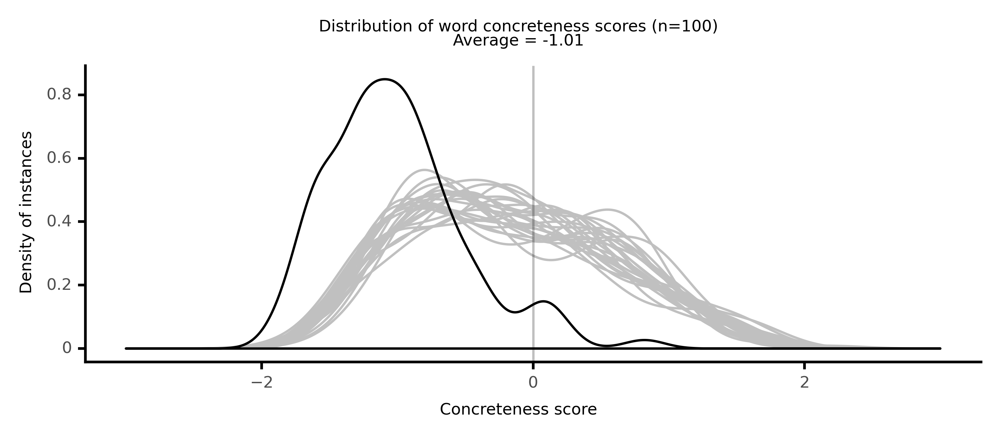

<ggplot: (8764100409529)>

 81%|████████  | 81/100 [17:21<04:44, 14.97s/it]

#### #82 most abstract passage: Richardson, _Sir Charles Grandison (1754)_ (1754)

<p>of the <abs><conc032>spirit</conc032></abs> of my <abs><conc182>ancestors</conc182></abs>: Tell me what you <abs><conc111>fear</conc111></abs>?-- I only <abs><conc111>fear</conc111></abs> one thing; and that is, that I should be thought to be more in your <abs><conc020>power</conc020></abs> than in my own. <neither><conc291>Noble</conc291></neither> Lady! And think you, that while my <abs><conc063>happiness</conc063></abs> is not yet <abs><conc086>absolutely</conc086></abs> <abs><conc131>resolved</conc131></abs> upon, I have not <abs><conc031>reason</conc031></abs> to <abs><conc111>fear</conc111></abs>?-- You will always, madam, be in your own <abs><conc020>power</conc020></abs>: You will be most so when in mine. My <abs><conc108>gratitude</conc108></abs> will ever <abs><conc076>prompt</conc076></abs> me to <abs><conc010>acknowledge</conc010></abs> your <abs><conc093>goodness</conc093></abs> to me as a <abs><conc105>condescension</conc105></abs>. But say; tell me, Sir; Did you not, at first <abs><conc222>receiving</conc222></abs> the <neither><conc358>invitation</conc358></neither>, <abs><conc104>despise</conc104></abs>, in <abs><conc198>absence</conc198></abs>, the Clementina, that now perhaps, in <abs><conc176>presence</conc176></abs>, you have the <abs><conc093>goodness</conc093></abs> to <neither><conc254>pity</conc254></neither>? O that the high-souled Clementina would not think so <abs><conc110>contemptibly</conc110></abs> of the man before her, as she must think, when she <neither><conc448>puts</conc448></neither> a <abs><conc103>question</conc103></abs> that would <abs><conc052>entitle</conc052></abs> him to <abs><conc188>infamy</conc188></abs>, could he <abs><conc121>presume</conc121></abs> to think an <abs><conc148>answer</conc148></abs> to it necessary! Well, Sir; I shall see how far the <neither><conc273>advances</conc273></neither> made on the <abs><conc085>wrong</conc085></abs> side will be <abs><conc001>justified</conc001></abs>, or rather <abs><conc031>countenanced</conc031></abs>, by the <neither><conc273>advances</conc273></neither>, or, shall I say( I will if you please) <abs><conc000>condescensions</conc000></abs> to be made on yours.[ What a <abs><conc122>petulance</conc122></abs>, thought I!-- But can the <abs><conc107>generous</conc107></abs>, the <neither><conc291>noble</conc291></neither> Clementina, <abs><conc091>knowing</conc091></abs> that terms will be <abs><conc135>proposed</conc135></abs>, with which in honour and <abs><conc064>conscience</conc064></abs> I can not <abs><conc176>comply</conc176></abs>, put my regard for her on such a <abs><conc149>test</conc149></abs> as this?-- I will not <neither><conc251>suppose</conc251></neither> that she is <abs><conc107>capable</conc107></abs> of <neither><conc650>mingling</conc650></neither> <neither><conc319>art</conc319></neither> with her <abs><conc037>magnanimity</conc037></abs>.] Is this, madam, said I, a <abs><conc107>generous</conc107></abs> <abs><conc039>anticipation</conc039></abs>? <abs><conc142>Forgive</conc142></abs> me: But when your friends are so good as to think me <abs><conc040>incapable</conc040></abs> of returning <abs><conc098>ingratitude</conc098></abs> for <abs><conc041>obligation</conc041></abs>, I <abs><conc131>hope</conc131></abs> I shall not be <neither><conc283>classed</conc283></neither>, by their <neither><conc275>beloved</conc275></neither> <neither><conc608>daughter</conc608></neither>, among the <neither><conc298>lowest</conc298></neither> of <abs><conc017>mankind</conc017></abs>. <abs><conc140>Excuse</conc140></abs> me, Sir; the woman who has been once <abs><conc085>wrong</conc085></abs>, has <abs><conc031>reason</conc031></abs> to be always <neither><conc250>afraid</conc250></neither> of herself. If you do not think <neither><conc275>meanly</conc275></neither> of me, I will <abs><conc118>endeavour</conc118></abs> to think well of myself; and then, Sir, I shall think better of you, if better I can think: For, after all, did I not more <abs><conc098>mistrust</conc098></abs> myself than I do you, I should not perhaps be so <abs><conc138>capricious</conc138></abs> as, I am <neither><conc250>afraid</conc250></neither>, I sometime am. The Marquis has <abs><conc193>hinted</conc193></abs> to me, madam, That your brother the <abs><conc218>Bishop</conc218></abs> is to <abs><conc189>discourse</conc189></abs> with me on the <abs><conc046>subject</conc046></abs> now the <neither><conc418>nearest</conc418></neither> to my <neither><conc325>heart</conc325></neither> of all others: May I <abs><conc121>presume</conc121></abs> to <abs><conc176>address</conc176></abs> myself to their <neither><conc275>beloved</conc275></neither> <neither><conc608>daughter</conc608></neither> upon it, without being thought <abs><conc107>capable</conc107></abs> of <abs><conc182>endeavouring</conc182></abs> to <abs><conc051>prepossess</conc051></abs> her in my <abs><conc067>favour</conc067></abs> before my Lord and I <neither><conc336>meet</conc336></neither>? I will <abs><conc148>answer</conc148></abs> you <abs><conc158>frankly</conc158></abs>, Sir: There are <neither><conc248>preliminaries</conc248></neither> to be <neither><conc252>settled</conc252></neither>; and, till they are, I that know there are, do not think myself at <abs><conc055>liberty</conc055></abs> to hear you upon any <abs><conc046>subject</conc046></abs> that may <abs><conc130>tend</conc130></abs> to <abs><conc084>prepossession</conc084></abs>. I <abs><conc003>acquiesce</conc003></abs>, madam: I would not for the world be thought to wish for the honour of your <abs><conc185>attention</conc185></abs>, while it is <abs><conc168>improper</conc168></abs> for you to <abs><conc067>favour</conc067></abs> me with it.[ I did not know, Dr.</p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

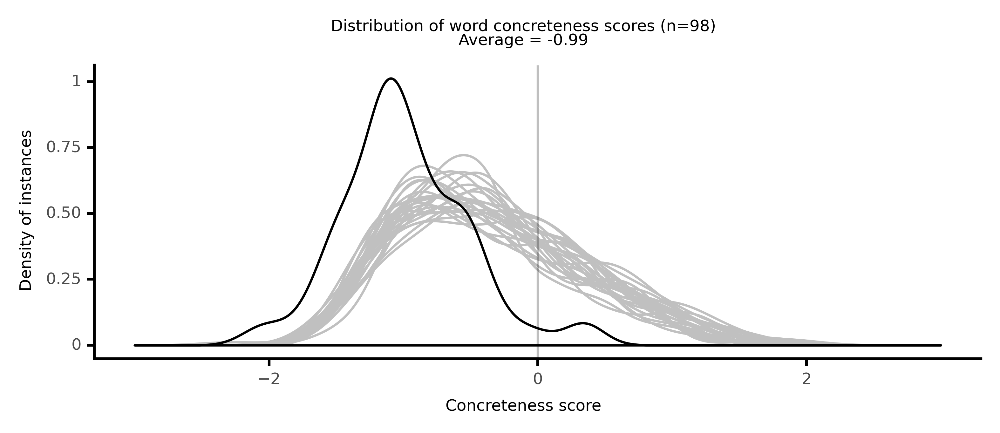

<ggplot: (8764097423573)>

 82%|████████▏ | 82/100 [17:47<05:27, 18.19s/it]

#### #83 most abstract passage: Disraeli, _Tancred: or, The New Crusade. By B. Disraeli_ (1847)

<p><neither><conc283>destitute</conc283></neither> of <abs><conc069>genius</conc069></abs>, <abs><conc261>possesses</conc261></abs> nevertheless <neither><conc373>considerable</conc373></neither> <abs><conc100>talents</conc100></abs>; who has <abs><conc113>official</conc113></abs> <abs><conc101>aptitude</conc101></abs>, a <neither><conc408>volubility</conc408></neither> of <abs><conc253>routine</conc253></abs> <abs><conc174>rhetoric</conc174></abs>, great <abs><conc101>perseverance</conc101></abs>, a love of <abs><conc124>affairs</conc124></abs>; who, <neither><conc351>embarrassed</conc351></neither> neither by the <abs><conc016>principles</conc016></abs> of the <abs><conc169>philosopher</conc169></abs> nor by the <abs><conc048>prejudices</conc048></abs> of the <abs><conc098>bigot</conc098></abs>, can <abs><conc134>assume</conc134></abs>, with a <abs><conc229>cautious</conc229></abs> <abs><conc143>facility</conc143></abs>, the <abs><conc108>prevalent</conc108></abs> <abs><conc243>tone</conc243></abs>, and disembarrass himself of it with a <neither><conc482>dexterous</conc482></neither> <abs><conc033>ambiguity</conc033></abs>, the moment it <neither><conc332>ceases</conc332></neither> to be <abs><conc083>predominant</conc083></abs>; <abs><conc141>recommending</conc141></abs> himself to the <abs><conc141>innovator</conc141></abs> by his <abs><conc048>approbation</conc048></abs> of <abs><conc200>change</conc200></abs> in the <abs><conc032>abstract</conc032></abs>,'' and to the <abs><conc073>conservative</conc073></abs> by his <abs><conc023>prudential</conc023></abs> and <abs><conc040>practical</conc040></abs> <abs><conc021>respect</conc021></abs> for that which is <abs><conc172>established</conc172></abs>; such a man, though he be one of an <abs><conc076>essentially</conc076></abs> <conc><conc817>small</conc817></conc> mind, though his <abs><conc067>intellectual</conc067></abs> <abs><conc173>qualities</conc173></abs> be less than <neither><conc297>moderate</conc297></neither>, with <neither><conc341>feeble</conc341></neither> <abs><conc035>powers</conc035></abs> of thought, no <abs><conc198>imagination</conc198></abs>, <neither><conc358>contracted</conc358></neither> <abs><conc119>sympathies</conc119></abs>, and a most <abs><conc249>lose</conc249></abs> <abs><conc049>public</conc049></abs> <abs><conc036>morality</conc036></abs>;-- such a man is the <abs><conc038>individual</conc038></abs> whom <neither><conc268>kings</conc268></neither> and <abs><conc076>parliaments</conc076></abs> would <neither><conc441>select</conc441></neither> to <abs><conc042>govern</conc042></abs> the State or <abs><conc103>rule</conc103></abs> the <neither><conc309>Church</conc309></neither>. <abs><conc200>Change</conc200></abs>, in the <abs><conc032>abstract</conc032></abs>,'' is what is wanted by a people who are at the same time <neither><conc378>inquiring</conc378></neither> and <neither><conc447>wealthy</conc447></neither>. Instead of <abs><conc089>statesmen</conc089></abs>, they <abs><conc040>desire</conc040></abs> shufflers; and <abs><conc160>compromise</conc160></abs> in <abs><conc010>conduct</conc010></abs> and <abs><conc033>ambiguity</conc033></abs> in <abs><conc187>speech</conc187></abs> are-- though nobody will <abs><conc149>confess</conc149></abs> it-- the <abs><conc049>public</conc049></abs> <abs><conc173>qualities</conc173></abs> now most in <neither><conc365>vogue</conc365></neither>. Not exactly, however, those <abs><conc148>calculated</conc148></abs> to <abs><conc256>meet</conc256></abs> the case of Tancred. The <neither><conc353>interview</conc353></neither> was <neither><conc561>long</conc561></neither>, for Tancred <neither><conc441>listened</conc441></neither> with <abs><conc047>apparent</conc047></abs> <abs><conc021>respect</conc021></abs> and <abs><conc114>deference</conc114></abs> to the <abs><conc038>individual</conc038></abs> under whose <neither><conc279>auspices</conc279></neither> he had <neither><conc501>entered</conc501></neither> the <neither><conc309>Church</conc309></neither> of Christ; but the replies to his <abs><conc254>inquiries</conc254></abs>, though more <abs><conc208>adroit</conc208></abs> than the duke's, were in <abs><conc060>reality</conc060></abs> not more <abs><conc174>satisfactory</conc174></abs>, and could not, in any way, <abs><conc256>meet</conc256></abs> the <abs><conc138>inexorable</conc138></abs> <abs><conc101>logic</conc101></abs> of Lord Montacute. The <neither><conc290>bishop</conc290></neither> was as little able as the duke to indicate the <abs><conc033>principle</conc033></abs> on which the present <abs><conc191>order</conc191></abs> of things in England was <abs><conc105>founded</conc105></abs>; neither <abs><conc023>faith</conc023></abs> nor its <abs><conc068>consequence</conc068></abs>, <abs><conc127>duty</conc127></abs>, were at all <neither><conc438>illustrated</conc438></neither> or <abs><conc241>invigorated</conc241></abs> by his <neither><conc522>handling</conc522></neither>. He <abs><conc087>utterly</conc087></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

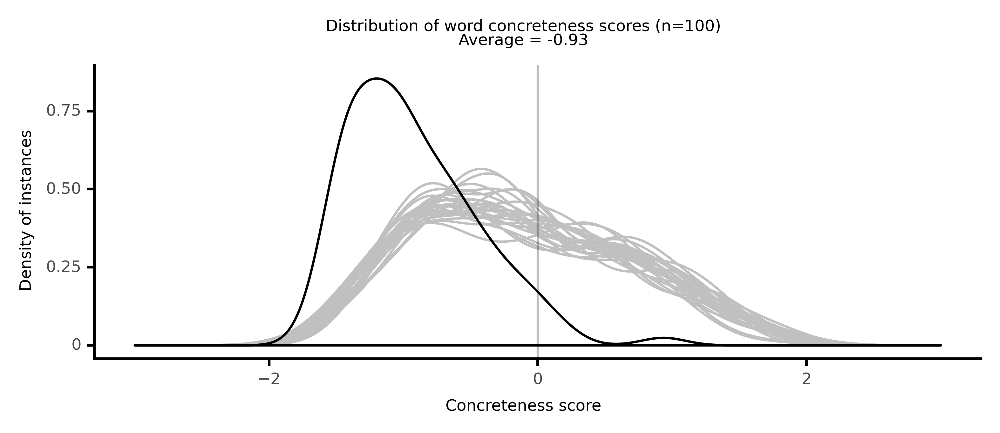

<ggplot: (8764100752469)>

 83%|████████▎ | 83/100 [17:59<04:39, 16.43s/it]

#### #84 most abstract passage: Calprenede, _Cassandra_ (1642)

<p>has <neither><conc564>touched</conc564></neither> me so nearly, that I have not <abs><conc199>courage</conc199></abs> enough to <neither><conc428>bear</conc428></neither> it; and though <neither><conc360>perchance</conc360></neither> I have enough to <abs><conc075>dispute</conc075></abs> for you, with Hephestion to the last moment of my life, I have not any that is <abs><conc149>proof</conc149></abs> against the <abs><conc066>Declaration</conc066></abs> you make in <abs><conc073>favour</conc073></abs> of him; I do not at all <abs><conc046>urge</conc046></abs> the <abs><conc188>promise</conc188></abs> you made me, there is no <abs><conc106>engagement</conc106></abs> of a <abs><conc112>Soveraign</conc112></abs> to his <abs><conc027>Subject</conc027></abs>'s, and I have no right to <abs><conc173>exact</conc173></abs> that from you, which you were <abs><conc135>pleased</conc135></abs> to <abs><conc044>grant</conc044></abs> me out of <abs><conc046>mere</conc046></abs> <abs><conc107>mercy</conc107></abs>. I <neither><conc378>ended</conc378></neither> these words with the same <abs><conc161>confusion</conc161></abs> I had showed at the beginning of my <abs><conc201>discourse</conc201></abs>, and the Princess after she had <neither><conc283>hearkened</conc283></neither> <abs><conc166>patiently</conc166></abs> to me, replied without being <abs><conc221>moved</conc221></abs>; It is <abs><conc089>true</conc089></abs>, Lysimachus, I have in <abs><conc073>favour</conc073></abs> of you taken a <abs><conc067>liberty</conc067></abs> to do what I might well have <abs><conc149>forborn</conc149></abs>; but what <abs><conc148>fault</conc148></abs> <abs><conc133>soever</conc133></abs> I <abs><conc210>committed</conc210></abs>, I <neither><conc361>forgotten</conc361></neither> not those <abs><conc066>reservations</conc066></abs> it was necessary for me to <neither><conc378>add</conc378></neither>, and I <neither><conc246>remember</conc246></neither> I often <neither><conc277>represented</conc277></neither> to you, with what <abs><conc048>dependence</conc048></abs> I am <conc><conc782>tied</conc782></conc> to the will of those persons to whom my <neither><conc475>birth</conc475></neither> hath <abs><conc078>submitted</conc078></abs> me, and my own <abs><conc026>intention</conc026></abs> never to <abs><conc073>swerve</conc073></abs> from it while I live. This <neither><conc304>suffices</conc304></neither> for my <abs><conc023>justification</conc023></abs>, and as you have <abs><conc104>learned</conc104></abs> that I returned an <abs><conc088>Answer</conc088></abs> to Hephestions <neither><conc373>Letter</conc373></neither>, you shall <abs><conc202>learn</conc202></abs> also when you please, that I did it by the Queen's <abs><conc030>express</conc030></abs> <abs><conc201>command</conc201></abs>, and that if I can be <abs><conc136>blamed</conc136></abs> in that <abs><conc062>action</conc062></abs>,'this only for the <abs><conc151>resistance</conc151></abs> I showed in <abs><conc035>obeying</conc035></abs> her, both through the <abs><conc012>repugnance</conc012></abs> I found in my self, and perhaps through your <abs><conc019>consideration</conc019></abs>. Without her <abs><conc008>absolute</conc008></abs> <abs><conc176>order</conc176></abs>, I would not so much as have <abs><conc214>received</conc214></abs> his <neither><conc373>letter</conc373></neither>, but she was <neither><conc299>solicited</conc299></neither> by Alexanders <neither><conc242>entreaties</conc242></neither>, to which she could <abs><conc185>refuse</conc185></abs> nothing in the <conc><conc859>fresh</conc859></conc> <abs><conc044>obligation</conc044></abs> she had to him, and the <abs><conc168>deplorable</conc168></abs> <abs><conc128>condition</conc128></abs> of our <abs><conc075>affairs</conc075></abs>. <neither><conc606>Behold</conc606></neither> what I believe due to your <abs><conc020>satisfaction</conc020></abs>; and for mine own I will tell you, that you aught not to think it <neither><conc320>strange</conc320></neither> hereafter, if I <abs><conc072>obey</conc072></abs> the only person to whom the Gods have left any <abs><conc080>lawful</conc080></abs> <abs><conc024>power</conc024></abs> over me; and although I <abs><conc072>esteem</conc072></abs> you at least as much as Hephestion, and that <neither><conc360>perchance</conc360></neither> in my <abs><conc119>inclination</conc119></abs> you have some <abs><conc099>advantage</conc099></abs> above him, be certain that as <neither><conc618>long</conc618></neither> as I live, I will <abs><conc116>follow</conc116></abs> only those <abs><conc139>motions</conc139></abs> the Queen shall give me. It would be <neither><conc649>hard</conc649></neither> for me to <abs><conc188>represent</conc188></abs> unto you the different <abs><conc054>effects</conc054></abs> this <abs><conc201>discourse</conc201></abs> <abs><conc199>produced</conc199></abs> in me; on the one side, the <neither><conc288>care</conc288></neither> my Princess took to <abs><conc004>justify</conc004></abs> her self to me, and the <abs><conc081>preferring</conc081></abs> of me before Hephestion, by her own <abs><conc127>confession</conc127></abs>, did <neither><conc367>extremely</conc367></neither> <neither><conc310>joy</conc310></neither> me; but the <abs><conc115>protestation</conc115></abs> she made, to <abs><conc032>regulate</conc032></abs> her will <abs><conc123>totally</conc123></abs> by that of Sysigambis, which I knew to be for Hephestion rather then for me, <neither><conc390>overwhelmed</conc390></neither> me in a <abs><conc214>mortal</conc214></abs> <neither><conc311>sorrow</conc311></neither>. These two <abs><conc118>passion</conc118></abs> <neither><conc354>wrought</conc354></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

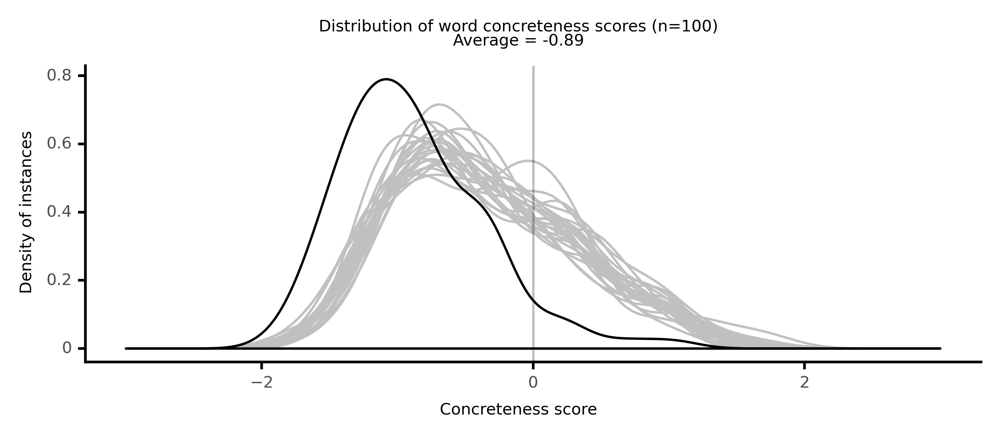

<ggplot: (8764111126589)>

 84%|████████▍ | 84/100 [18:19<04:37, 17.36s/it]

#### #85 most abstract passage: Richardson, _Pamela (1741)_ (1741)

<p>: They <abs><conc143>covet</conc143></abs> this or that <neither><conc761>Plaything</conc761></neither>, and have no other <abs><conc024>Motive</conc024></abs> than being <abs><conc184>gratified</conc184></abs> in the <neither><conc305>Possession</conc305></neither> of what they <abs><conc119>desire</conc119></abs>. The <neither><conc300>Parent</conc300></neither>, or Governor, has another <abs><conc024>Motive</conc024></abs> in <abs><conc230>obliging</conc230></abs> the Child: He <neither><conc522>takes</conc522></neither> <abs><conc139>Advantage</conc139></abs> of its <abs><conc133>Desires</conc133></abs>, and <abs><conc057>annexes</conc057></abs> to the <abs><conc029>Indulgence</conc029></abs> which the Child <abs><conc131>Hope</conc131></abs>'s for, such or such a <abs><conc207>Task</conc207></abs> or <abs><conc135>Duty</conc135></abs>, as a <abs><conc148>Condition</conc148></abs>; and shows himself <abs><conc169>pleased</conc169></abs> with its <abs><conc125>Compliance</conc125></abs> with it: So the Child <neither><conc490>wins</conc490></neither> its <neither><conc761>Plaything</conc761></neither>, and <neither><conc407>receives</conc407></neither> the <abs><conc165>Praise</conc165></abs> and <abs><conc111>Commendation</conc111></abs> so necessary to <neither><conc312>led</conc312></neither> on <neither><conc718>young</conc718></neither> <abs><conc062>Minds</conc062></abs> to <abs><conc056>laudable</conc056></abs> <abs><conc036>Pursuits</conc036></abs>. But, dear Sir, shall it not be <abs><conc168>suffered</conc168></abs> to <abs><conc162>enjoy</conc162></abs> the <abs><conc198>innocent</conc198></abs> <abs><conc106>Reward</conc106></abs> of its <abs><conc125>Compliance</conc125></abs>, unless it can give <abs><conc060>Satisfaction</conc060></abs>, that its greatest <neither><conc315>Delight</conc315></neither> is not in having the Thing <neither><conc311>coveted</conc311></neither>, but in <abs><conc214>performing</conc214></abs> the <abs><conc207>Task</conc207></abs>, or <abs><conc025>obeying</conc025></abs> the <abs><conc125>Injunctions</conc125></abs>, <abs><conc143>imposed</conc143></abs> upon it as a <abs><conc148>Condition</conc148></abs> of its being <abs><conc231>obliged</conc231></abs>? I <abs><conc097>doubt</conc097></abs>, Sir, this is a little too <abs><conc078>strict</conc078></abs>, and not to be <abs><conc129>expected</conc129></abs> from Children. A Servant, fullgrown, would not be able to show one, that, on <abs><conc148>Condition</conc148></abs> he <neither><conc275>complied</conc275></neither> with such and such Terms,( which, it is to be <abs><conc230>supposed</conc230></abs> by the <abs><conc220>Offer</conc220></abs>, he would not have <neither><conc275>complied</conc275></neither> with, but for that <abs><conc116>Inducement</conc116></abs>) that he should have such and such a <abs><conc106>Reward</conc106></abs>; I say, he would hardly be able to show one, that he <abs><conc199>preferred</conc199></abs> the <abs><conc191>Pleasure</conc191></abs> of <abs><conc214>performing</conc214></abs> the <abs><conc101>requisite</conc101></abs> <abs><conc066>Conditions</conc066></abs> to the <abs><conc220>stipulated</conc220></abs> <abs><conc106>Reward</conc106></abs>. How then is it to be <abs><conc129>expected</conc129></abs> from a Child, who is less <abs><conc107>capable</conc107></abs> of <abs><conc101>distinguishing</conc101></abs>? Let therefore, if, Sir, I may <abs><conc121>presume</conc121></abs> to say so, <abs><conc198>innocent</conc198></abs> <abs><conc029>Rewards</conc029></abs> be <abs><conc135>proposed</conc135></abs>, and let us be <abs><conc169>contented</conc169></abs> to <neither><conc312>led</conc312></neither> on the <neither><conc528>ductile</conc528></neither> <abs><conc062>Minds</conc062></abs> of Children to a Love of their <abs><conc135>Duty</conc135></abs>, by <abs><conc230>obliging</conc230></abs> them with such: We may tell them what we <abs><conc068>expect</conc068></abs> in this Case; but we aught not, I <abs><conc233>humbly</conc233></abs> <abs><conc130>conceive</conc130></abs>, to be too <abs><conc095>rigorous</conc095></abs> in <abs><conc053>exacting</conc053></abs> it; for, after all, the <abs><conc116>Inducement</conc116></abs> will certainly be the <conc><conc787>uppermost</conc787></conc> <abs><conc052>Consideration</conc052></abs> with the Child:'T is out of <abs><conc083>Nature</conc083></abs> to <neither><conc251>Suppose</conc251></neither> it otherwise; nor had it been <abs><conc228>offered</conc228></abs> to it, if the <neither><conc300>Parent</conc300></neither> himself had not thought so. And therefore we can only let the Child know his <abs><conc135>Duty</conc135></abs> in this <abs><conc047>respect</conc047></abs>, and that he aught to give a <abs><conc164>Preference</conc164></abs> to that, and then <neither><conc427>rest</conc427></neither> ourselves <abs><conc169>contented</conc169></abs>, although' we should <abs><conc221>discern</conc221></abs>, that the <abs><conc106>Reward</conc106></abs> is the <abs><conc218>chief</conc218></abs> <abs><conc039>Incentive</conc039></abs>, if it do but <abs><conc143>oblige</conc143></abs> to the <abs><conc120>Performance</conc120></abs> of it. For this, from whatever <abs><conc024>Motive</conc024></abs> <abs><conc023>inculcated</conc023></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

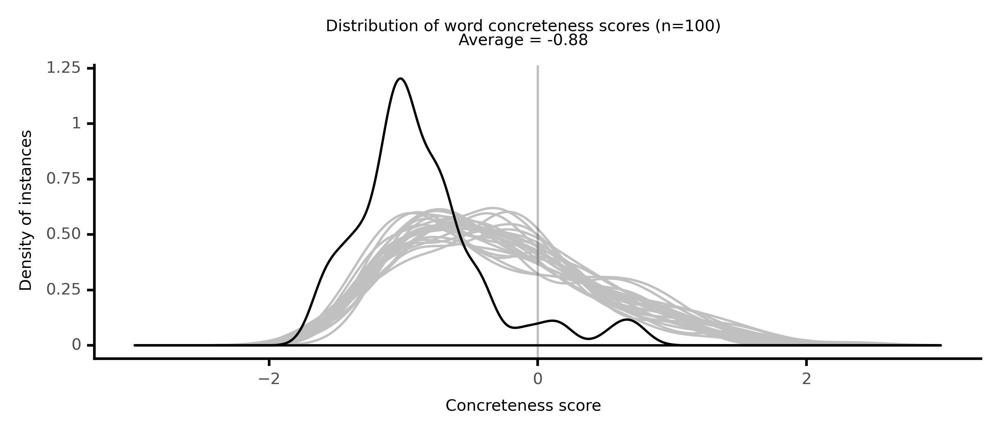

<ggplot: (8764109475161)>

 85%|████████▌ | 85/100 [18:37<04:24, 17.63s/it]

#### #86 most abstract passage: Brown, _The Novels . . . (1827): a machine-readable transc_ (1827)

<p>in a new <neither><conc532>light</conc532></neither>. It was of <abs><conc225>sufficient</conc225></abs> importance to make him <abs><conc095>deliberate</conc095></abs>. He <abs><conc134>reasoned</conc134></abs> somewhat in the following manner. <neither><conc373>Marriage</conc373></neither> is <abs><conc107>absurd</conc107></abs>. This <neither><conc559>flows</conc559></neither> from the <abs><conc129>general</conc129></abs> and <abs><conc187>incurable</conc187></abs> <abs><conc024>imperfection</conc024></abs> of the <neither><conc655>female</conc655></neither> <abs><conc025>character</conc025></abs>. No woman can <abs><conc123>possess</conc123></abs> that worth which would <abs><conc171>induce</conc171></abs> me to <neither><conc355>enter</conc355></neither> into this <neither><conc318>contract</conc318></neither>, and <neither><conc398>bind</conc398></neither> myself, without <abs><conc028>power</conc028></abs> of <abs><conc065>revoking</conc065></abs> the <abs><conc115>decree</conc115></abs>, to her <abs><conc147>society</conc147></abs>. This <abs><conc020>opinion</conc020></abs> may possibly be <abs><conc025>erroneous</conc025></abs>, but it is <abs><conc073>undoubtedly</conc073></abs> <abs><conc024>true</conc024></abs> with <abs><conc021>respect</conc021></abs> to Helena, and the <abs><conc098>uncertainty</conc098></abs> of the <neither><conc268>position</conc268></neither> in <abs><conc129>general</conc129></abs>, will <abs><conc199>increase</conc199></abs> the <abs><conc025>necessity</conc025></abs> of <abs><conc212>caution</conc212></abs> in the present case. That woman may <abs><conc115>exist</conc115></abs> whom I should not <abs><conc069>fear</conc069></abs> to <abs><conc044>espouse</conc044></abs>. This is not her. Some <neither><conc447>accident</conc447></neither> may cause our <neither><conc320>meeting</conc320></neither>. Shall I then <abs><conc262>disable</conc262></abs> myself, by an <abs><conc084>irrevocable</conc084></abs> <abs><conc064>obligation</conc064></abs>, from <abs><conc051>profiting</conc051></abs> by so <abs><conc190>auspicious</conc190></abs> an <abs><conc227>occurrence</conc227></abs>? This girl's <abs><conc147>society</conc147></abs> was to be <neither><conc293>enjoyed</conc293></neither> in one of two ways. Should he <neither><conc268>consult</conc268></neither> his <abs><conc246>inclination</conc246></abs> there was little room for <abs><conc082>doubt</conc082></abs>. He had never <neither><conc367>met</conc367></neither> with one more <neither><conc312>highly</conc312></neither> <abs><conc112>qualified</conc112></abs> for that <neither><conc448>species</conc448></neither> of <abs><conc140>intercourse</conc140></abs> which he <neither><conc324>esteemed</conc324></neither> <abs><conc015>rational</conc015></abs>. No man more <abs><conc131>abhorred</conc131></abs> the <abs><conc156>votaries</conc156></abs> of <abs><conc046>licentiousness</conc046></abs>. Nothing was more <abs><conc225>detestable</conc225></abs> to him than a <abs><conc137>mercenary</conc137></abs> <abs><conc225>alliance</conc225></abs>. <abs><conc015>Personal</conc015></abs> <abs><conc066>fidelity</conc066></abs> and the <abs><conc055>existence</conc055></abs> of that <abs><conc169>passion</conc169></abs>, of which he had, in the present case, the good <neither><conc334>fortune</conc334></neither> to be the <abs><conc162>object</conc162></abs>, were <abs><conc204>indispensable</conc204></abs> in his <abs><conc112>scheme</conc112></abs>. The <abs><conc197>union</conc197></abs> was <abs><conc161>indebted</conc161></abs> for its <conc><conc772>valve</conc772></conc> on the voluntariness with which it was <neither><conc509>formed</conc509></neither>, and the <abs><conc232>entire</conc232></abs> <abs><conc077>acquiescence</conc077></abs> of the <abs><conc006>judgement</conc006></abs> of both <abs><conc193>parties</conc193></abs> in its <abs><conc009>rectitude</conc009></abs>. <abs><conc014>Dissimulation</conc014></abs> and <abs><conc148>artifice</conc148></abs> were <abs><conc085>wholly</conc085></abs> <abs><conc170>foreign</conc170></abs> to the <abs><conc077>success</conc077></abs> of his <abs><conc223>project</conc223></abs>. If the lady thought <abs><conc232>proper</conc232></abs> to <abs><conc178>assent</conc178></abs> to his <abs><conc243>proposal</conc243></abs>, it was well. She did so because <abs><conc178>assent</conc178></abs> was more <neither><conc312>eligible</conc312></neither> than <abs><conc127>refusal</conc127></abs>. She would, no <abs><conc082>doubt</conc082></abs>, <neither><conc346>prefer</conc346></neither> <neither><conc373>marriage</conc373></neither>. She would <abs><conc102>deem</conc102></abs> it more <abs><conc066>conducive</conc066></abs> to <abs><conc149>happiness</conc149></abs>. This was an <abs><conc014>error</conc014></abs>. This was an <abs><conc020>opinion</conc020></abs>, his <abs><conc100>reasons</conc100></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

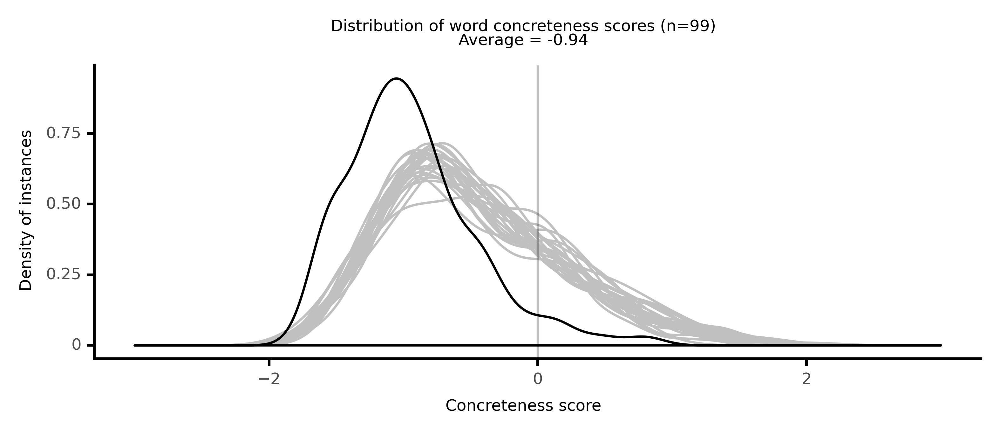

<ggplot: (8764116897637)>

 86%|████████▌ | 86/100 [18:50<03:45, 16.11s/it]

#### #87 most abstract passage: Ingraham, _The Quadroone; or, St. Michael's Day . . .  Volume_ (1841)

<p>is to <abs><conc261>receive</conc261></abs> still farther <abs><conc249>improvements</conc249></abs>. I <abs><conc100>hope</conc100></abs> you will be <abs><conc126>encouraged</conc126></abs> and <abs><conc091>sustained</conc091></abs> in this <abs><conc095>undertaking</conc095></abs> by a very <neither><conc331>extensive</conc331></neither> <abs><conc151>patronage</conc151></abs> from an <abs><conc018>enlightened</conc018></abs> <abs><conc103>community</conc103></abs>. I have <neither><conc287>read</conc287></neither> with much <abs><conc161>satisfaction</conc161></abs> <neither><conc363>Professor</conc363></neither> Upham's works on <abs><conc067>Intellectual</conc067></abs> <abs><conc062>Philosophy</conc062></abs> and on the Will. The <abs><conc243>tone</conc243></abs> and manner of these <neither><conc382>books</conc382></neither> must be <neither><conc350>pleasing</conc350></neither> to all who love <neither><conc291>calm</conc291></neither>, <abs><conc013>dispassionate</conc013></abs>, and <abs><conc196>accurate</conc196></abs> <abs><conc087>investigation</conc087></abs>, and <abs><conc026>moderation</conc026></abs> in <abs><conc101>defending</conc101></abs> one's own <abs><conc013>opinions</conc013></abs> and canvasing those of others. I have no <neither><conc330>hesitation</conc330></neither> in saying, that I regard <neither><conc363>Professor</conc363></neither> Upham's <neither><conc382>books</conc382></neither> as giving the best <abs><conc017>views</conc017></abs> of the <abs><conc047>Subject</conc047></abs>'s <neither><conc440>nam</conc440></neither> which we have in the English <abs><conc082>language</conc082></abs>, and as <abs><conc118>worthy</conc118></abs> of being <neither><conc287>read</conc287></neither> and <neither><conc285>studied</conc285></neither> in the <neither><conc307>schools</conc307></neither> and <neither><conc263>colleges</conc263></neither> of our country. Even those who may <abs><conc207>differ</conc207></abs> from him in <abs><conc020>opinion</conc020></abs>, will feel no <abs><conc069>disposition</conc069></abs> to <abs><conc149>indulge</conc149></abs> <abs><conc242>unkind</conc242></abs> <abs><conc081>feelings</conc081></abs> towards so sincere and <abs><conc079>candid</conc079></abs> an <abs><conc128>inquirer</conc128></abs> after <abs><conc013>truth</conc013></abs>. Most <abs><conc137>sincerely</conc137></abs> do I wish <neither><conc383>ample</conc383></neither> <abs><conc077>success</conc077></abs> to the <abs><conc072>author</conc072></abs> and the <neither><conc373>publishers</conc373></neither> of the works in <abs><conc153>question</conc153></abs>; especially at a time when the <abs><conc049>public</conc049></abs> mind is <neither><conc312>allured</conc312></neither> by <neither><conc382>books</conc382></neither> on these <abs><conc047>Subject</conc047></abs>'s in many <abs><conc175>respects</conc175></abs> <neither><conc575>dreamy</conc575></neither> and <neither><conc282>unintelligible</conc282></neither> to the great <neither><conc397>mass</conc397></neither> of <abs><conc191>readers</conc191></abs>. I <abs><conc157>fully</conc157></abs> <abs><conc028>concur</conc028></abs> in the <abs><conc020>opinion</conc020></abs> of <neither><conc363>Professor</conc363></neither> Stuart, <abs><conc076>expressed</conc076></abs> in the <neither><conc390>preceding</conc390></neither> <neither><conc351>certificate</conc351></neither>, and could <neither><conc429>add</conc429></neither> more in <abs><conc142>favour</conc142></abs> of the works <neither><conc440>nam</conc440></neither> were it necessary. I am <neither><conc317>happy</conc317></neither> to <abs><conc234>learn</conc234></abs> that you are about to <abs><conc161>publish</conc161></abs> a <neither><conc507>stereotype</conc507></neither> <neither><conc467>edition</conc467></neither> of <neither><conc363>Professor</conc363></neither> Upham's works. To this <neither><conc481>gentleman</conc481></neither> the <abs><conc136>literary</conc136></abs> <abs><conc049>public</conc049></abs> are much <abs><conc161>indebted</conc161></abs> for his <abs><conc157>Elements</conc157></abs> of <abs><conc092>Mental</conc092></abs> <abs><conc062>Philosophy</conc062></abs>,'' a work which was <abs><conc201>greatly</conc201></abs> <neither><conc298>needed</conc298></neither> as a <neither><conc268>text-book</conc268></neither> in our <neither><conc263>colleges</conc263></neither> and <neither><conc313>academies</conc313></neither> at the time it was first <neither><conc270>published</conc270></neither>. It is now used, I believe, in most of our <abs><conc136>literary</conc136></abs> <abs><conc089>institutions</conc089></abs>; and I <abs><conc167>hesitate</conc167></abs> not to say, it is better <neither><conc325>adapted</conc325></neither> to the wants of <abs><conc245>students</conc245></abs>, in the <abs><conc067>science</conc067></abs> of which it <abs><conc162>treats</conc162></abs>, than any other work <neither><conc263>extant</conc263></neither>. It can not but be <abs><conc174>satisfactory</conc174></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

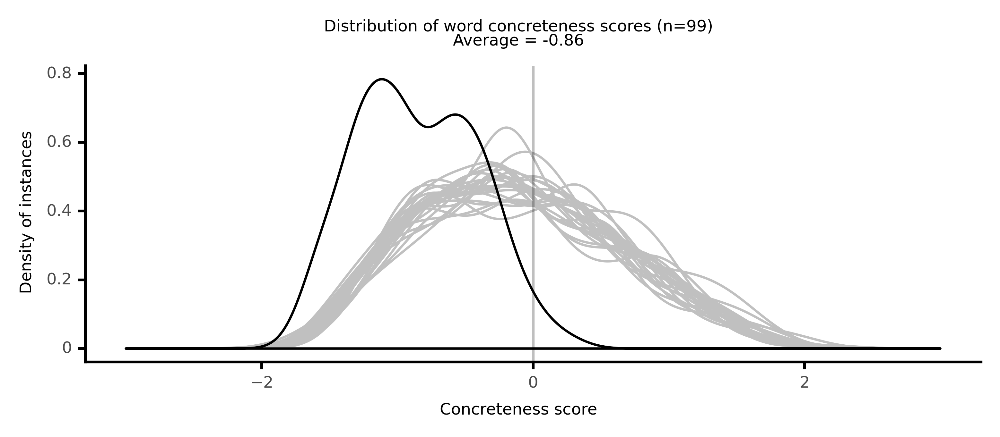

<ggplot: (8764111397505)>

 87%|████████▋ | 87/100 [19:02<03:14, 14.97s/it]

#### #88 most abstract passage: Clark, _The Literary Remains of the Late Willis Gaylord Cl_ (1844)

<p>, which <abs><conc099>adulation</conc099></abs> would have <abs><conc214>offended</conc214></abs>, which the <abs><conc044>voluntary</conc044></abs> <neither><conc290>plaudits</conc290></neither> of millions could not <abs><conc217>betray</conc217></abs> into <abs><conc063>indiscretion</conc063></abs>, and which never <abs><conc174>obtruded</conc174></abs> upon others his <abs><conc051>claims</conc051></abs> to <abs><conc164>superior</conc164></abs> <abs><conc090>consideration</conc090></abs>, was <neither><conc308>happily</conc308></neither> <neither><conc372>blended</conc372></neither> with a <neither><conc461>high</conc461></neither> and <abs><conc082>correct</conc082></abs> <abs><conc020>sense</conc020></abs> of <abs><conc015>personal</conc015></abs> <abs><conc163>dignity</conc163></abs>, and with a just <abs><conc093>consciousness</conc093></abs> of that <abs><conc021>respect</conc021></abs> which is due to <neither><conc584>station</conc584></neither>. Without <abs><conc239>exertion</conc239></abs>, he could <abs><conc064>maintain</conc064></abs> the <neither><conc317>happy</conc317></neither> <neither><conc401>medium</conc401></neither> between that <abs><conc027>arrogance</conc027></abs> which <neither><conc521>wounds</conc521></neither>, and that <abs><conc143>facility</conc143></abs> which allows the <abs><conc173>office</conc173></abs> to be <abs><conc161>degraded</conc161></abs> in the person who <neither><conc517>fills</conc517></neither> it. It is <abs><conc154>impossible</conc154></abs> to <abs><conc118>contemplate</conc118></abs> the great <abs><conc103>events</conc103></abs> which have <neither><conc340>occurred</conc340></neither> in the <abs><conc219>United</conc219></abs> <abs><conc233>States</conc233></abs>, under the <neither><conc279>auspices</conc279></neither> of Washington, without <abs><conc000>ascribing</conc000></abs> them, in some <abs><conc034>measure</conc034></abs>, to him. If we ask the causes of the <neither><conc313>prosperous</conc313></neither> <abs><conc115>issue</conc115></abs> of a <abs><conc135>war</conc135></abs>, against the <abs><conc131>successful</conc131></abs> <abs><conc260>termination</conc260></abs> of which there were so many <abs><conc084>probabilities</conc084></abs>; of the good which was <neither><conc361>produced</conc361></neither>, and the <neither><conc315>ill</conc315></neither> which was <abs><conc238>avoided</conc238></abs> during an <abs><conc019>administration</conc019></abs> <neither><conc404>fated</conc404></neither> to <abs><conc038>contend</conc038></abs> with the <abs><conc191>strongest</conc191></abs> <abs><conc048>prejudices</conc048></abs> that a <neither><conc268>combination</conc268></neither> of circumstances, and of <abs><conc169>passion</conc169></abs> could <neither><conc319>produce</conc319></neither>; of the <abs><conc178>constant</conc178></abs> <abs><conc142>favour</conc142></abs> of the great <neither><conc397>mass</conc397></neither> of his <abs><conc080>fellow-citizens</conc080></abs>, and of the <abs><conc019>confidence</conc019></abs> which, to to the last moment of his life, they <neither><conc440>reposed</conc440></neither> in him-- the <abs><conc207>answer</conc207></abs>, so far as these causes may be found in his <abs><conc025>character</conc025></abs>, will <abs><conc245>furnish</conc245></abs> a <neither><conc265>lesson</conc265></neither> well <abs><conc038>meriting</conc038></abs> the <abs><conc237>attention</conc237></abs> of those who are <abs><conc244>candidates</conc244></abs> for <abs><conc179>fame</conc179></abs>. <abs><conc184>Endowed</conc184></abs> by <abs><conc041>nature</conc041></abs> with a found <abs><conc006>judgement</conc006></abs>, and an <abs><conc196>accurate</conc196></abs>, <abs><conc065>discriminating</conc065></abs> mind, he <abs><conc207>feared</conc207></abs> not that <abs><conc192>laborious</conc192></abs> <abs><conc237>attention</conc237></abs> which made him <neither><conc389>perfectly</conc389></neither> master of those <abs><conc047>Subject</conc047></abs>'s, in all their <abs><conc113>relations</conc113></abs>, on which he was to <abs><conc219>decide</conc219></abs>; and this <abs><conc081>essential</conc081></abs> <neither><conc356>quality</conc356></neither> was <abs><conc236>guided</conc236></abs> by an <abs><conc249>unvarying</conc249></abs> <abs><conc020>sense</conc020></abs> of <abs><conc005>moral</conc005></abs> right, which would <abs><conc061>tolerate</conc061></abs> the <abs><conc213>employment</conc213></abs> only of those means that would <neither><conc375>bear</conc375></neither> the most <neither><conc295>rigid</conc295></neither> <abs><conc248>examination</conc248></abs>, by a <abs><conc108>fairness</conc108></abs> of <abs><conc191>intention</conc191></abs>, which neither <abs><conc133>sought</conc133></abs> nor <abs><conc238>required</conc238></abs> <neither><conc379>disguise</conc379></neither>, and by a <abs><conc202>purity</conc202></abs> of <abs><conc041>virtue</conc041></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

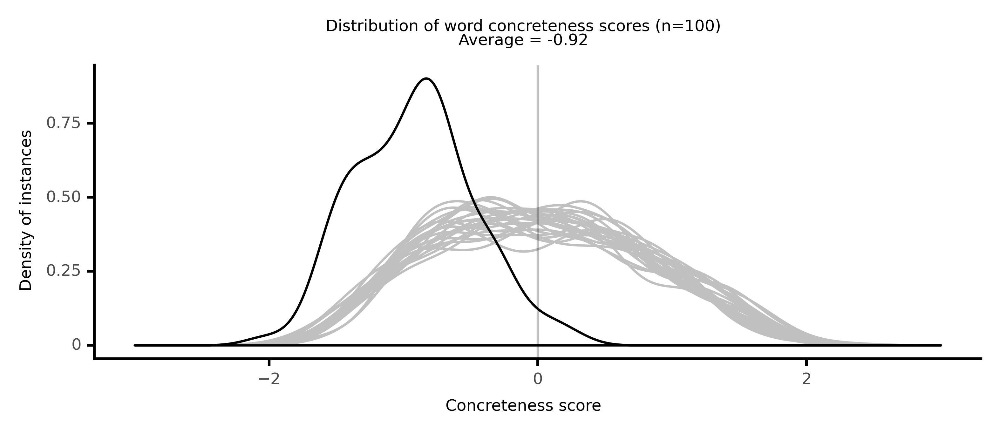

<ggplot: (8764121469341)>

 88%|████████▊ | 88/100 [19:14<02:49, 14.16s/it]

#### #89 most abstract passage: Amory, _John Buncle (1756)_ (1756)

<p>. That if in this manner we live <neither><conc412>prepared</conc412></neither> for any <abs><conc085>honourable</conc085></abs> <abs><conc102>services</conc102></abs> to God, our <neither><conc564>fellows</conc564></neither>, and ourselves, and <abs><conc052>practice</conc052></abs> <abs><conc099>piety</conc099></abs> towards God, <abs><conc193>goodwill</conc193></abs> towards men, and immediately <abs><conc180>aim</conc180></abs> at our own <neither><conc263>perfection</conc263></neither>, then we may <abs><conc068>expect</conc068></abs>, <abs><conc094>notwithstanding</conc094></abs> our being <abs><conc045>involved</conc045></abs> in <abs><conc060>manifold</conc060></abs> <abs><conc098>weaknesses</conc098></abs> and <abs><conc169>disorders</conc169></abs> of <abs><conc194>soul</conc194></abs>, that the <abs><conc054>divine</conc054></abs> <abs><conc093>goodness</conc093></abs> and <abs><conc017>clemency</conc017></abs> will have <abs><conc129>mercy</conc129></abs> on such as <abs><conc078>sincerely</conc078></abs> love him, and <abs><conc119>desire</conc119></abs> to <neither><conc332>serve</conc332></neither> him with <abs><conc135>duty</conc135></abs> and <abs><conc108>gratitude</conc108></abs>; will be <neither><conc337>propitious</conc337></neither> and <abs><conc038>placable</conc038></abs> to the <abs><conc205>penitents</conc205></abs>, and all who <abs><conc071>exert</conc071></abs> their utmost <abs><conc078>endeavours</conc078></abs> in the <abs><conc036>pursuits</conc036></abs> of <abs><conc076>virtue</conc076></abs>: And since the <neither><conc263>perfection</conc263></neither> of <abs><conc076>virtue</conc076></abs> must <abs><conc197>constitute</conc197></abs> the <abs><conc022>supreme</conc022></abs> <abs><conc115>felicity</conc115></abs> of man, our <abs><conc135>efforts</conc135></abs> to <abs><conc114>attain</conc114></abs> it, must be <abs><conc093>effectual</conc093></abs> in <abs><conc061>obtaining</conc061></abs> <neither><conc260>complete</conc260></neither> <abs><conc115>felicity</conc115></abs>, or at least some <conc><conc788>lower</conc788></conc> <abs><conc135>degree</conc135></abs> of it.[ Side note:1Kb] Of <abs><conc040>Revealed</conc040></abs> <abs><conc043>Religion</conc043></abs>. This <conc><conc881>beautiful</conc881></conc>, <abs><conc013>moral</conc013></abs> <abs><conc086>Philosophy</conc086></abs> I found <neither><conc623>scattered</conc623></neither> in the <abs><conc064>writings</conc064></abs> of the old <abs><conc068>theist</conc068></abs> <abs><conc123>philosophers</conc123></abs>, and with great <neither><conc245>pains</conc245></neither> <neither><conc250>reduced</conc250></neither> the various <abs><conc184>lessons</conc184></abs> to a system of <abs><conc124>active</conc124></abs> and <abs><conc077>virtuous</conc077></abs> <abs><conc150>offices</conc150></abs>: but this I knew was what the <abs><conc133>majority</conc133></abs> of <abs><conc017>mankind</conc017></abs> were <abs><conc040>incapable</conc040></abs> of doing; and if they could do it, I saw it was far <neither><conc243>inferior</conc243></neither> to <abs><conc017>revelation</conc017></abs>. Every Sunday I <neither><conc355>appropriated</conc355></neither> to the <abs><conc136>study</conc136></abs> of <abs><conc040>revealed</conc040></abs> <abs><conc043>Religion</conc043></abs>, and <neither><conc397>perceived</conc397></neither> as I <neither><conc287>read</conc287></neither> the <neither><conc283>sacred</conc283></neither> <abs><conc206>records</conc206></abs>, that the Works of Plato, and Cicero, and Epictetus, and all the <abs><conc002>uninspired</conc002></abs> <neither><conc280>sages</conc280></neither> of <neither><conc291>antiquity</conc291></neither>, were but <abs><conc192>weak</conc192></abs> <abs><conc112>rules</conc112></abs> in <abs><conc047>respect</conc047></abs> of the <abs><conc054>divine</conc054></abs> <abs><conc067>oracles</conc067></abs>. It is the <abs><conc129>mercy</conc129></abs> and <abs><conc020>power</conc020></abs> of God in the <neither><conc246>triumphs</conc246></neither> of <neither><conc291>grace</conc291></neither>, that <abs><conc227>restores</conc227></abs> <abs><conc017>mankind</conc017></abs> from the <abs><conc212>bondage</conc212></abs> and <abs><conc032>ignorance</conc032></abs> of <abs><conc125>idolatry</conc125></abs>. To this the <abs><conc212>sinner</conc212></abs> <abs><conc218>owes</conc218></abs> the <abs><conc059>conversion</conc059></abs> of his <abs><conc194>soul</conc194></abs>. It is the <abs><conc205>statutes</conc205></abs> of the Lord that <abs><conc211>rejoice</conc211></abs> the <neither><conc325>heart</conc325></neither>, and <abs><conc077>enlighten</conc077></abs> the <neither><conc657>eyes</conc657></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

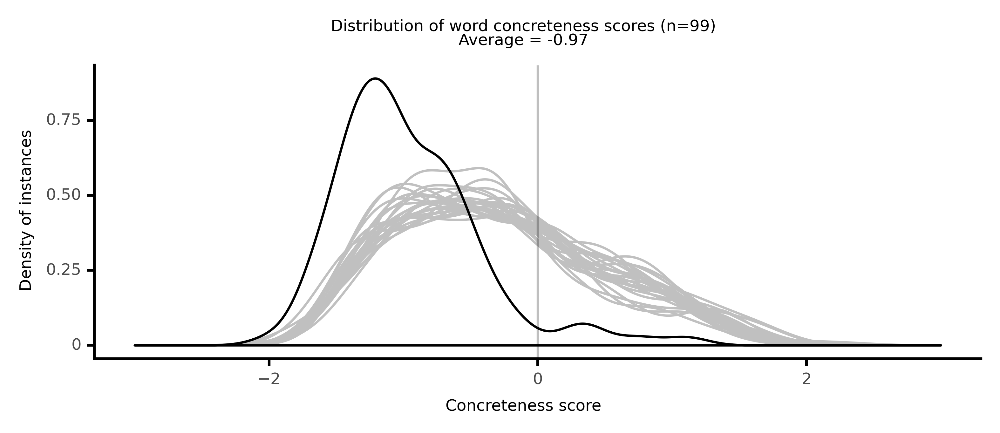

<ggplot: (8764108854301)>

 89%|████████▉ | 89/100 [19:29<02:38, 14.39s/it]

#### #90 most abstract passage: Orrery, _Parthenissa, Part 2 (1655)_ (1655)

<p><abs><conc184>temper</conc184></abs> of mind, she knew my <abs><conc019>judgement</conc019></abs> would <abs><conc011>deny</conc011></abs>; gives Perolla <abs><conc012>unjust</conc012></abs> <abs><conc224>praises</conc224></abs>, to make me give him, an <abs><conc012>unjust</conc012></abs> <abs><conc128>reward</conc128></abs>, and would <abs><conc029>render</conc029></abs> that an act of Freindship for me, which was but one of Freindship to himself, as you may be <abs><conc135>pleased</conc135></abs> to <neither><conc246>remember</conc246></neither> I then largely <abs><conc017>evinced</conc017></abs>; but when the second time I was taken, whither it <abs><conc109>proceeded</conc109></abs> from their <abs><conc198>Revenge</conc198></abs>, or my own <neither><conc386>Misfortune</conc386></neither>, I will not <abs><conc052>positively</conc052></abs> <abs><conc008>determine</conc008></abs>; Alas( Sir) how <abs><conc160>ungrateful</conc160></abs> was his <neither><conc335>carriage</conc335></neither>? she says that she came to <neither><conc256>preserve</conc256></neither> my life, but his <abs><conc004>actions</conc004></abs> say'it to <neither><conc256>preserve</conc256></neither> Perolla's, and when his <neither><conc270>Fathers</conc270></neither>, and his <neither><conc536>Lovers</conc536></neither> Life, came in <abs><conc114>competition</conc114></abs>, she gave up the first a <neither><conc244>Sacrifice</conc244></neither>, to <neither><conc256>preserve</conc256></neither> the last from being one; neither can she <abs><conc071>allege</conc071></abs> this <abs><conc079>impious</conc079></abs> <abs><conc041>proceeding</conc041></abs> was an effect of a <neither><conc531>precipitate</conc531></neither> <abs><conc052>election</conc052></abs> upon a <neither><conc442>sudden</conc442></neither> <abs><conc051>emergency</conc051></abs>, for after she had <abs><conc231>published</conc231></abs> his Love was the God over his <abs><conc021>duty</conc021></abs>, Hannibal( <neither><conc334>startled</conc334></neither> at a <abs><conc066>declaration</conc066></abs> which was even a <neither><conc660>Monster</conc660></neither> in <abs><conc081>Nature</conc081></abs>) gave his not only <abs><conc219>leisure</conc219></abs> to <abs><conc077>reflect</conc077></abs> on his <abs><conc085>Cryme</conc085></abs>, but <abs><conc024>power</conc024></abs> to <abs><conc125>recall</conc125></abs> it; yet she, to <abs><conc025>demonstrate</conc025></abs> that the <neither><conc532>murdering</conc532></neither> his Father, was a <abs><conc079>premeditated</conc079></abs> <abs><conc143>design</conc143></abs>, and not a <neither><conc335>hasty</conc335></neither> <neither><conc312>choice</conc312></neither>, <abs><conc045>perseveres</conc045></abs> in, and <neither><conc247>repeats</conc247></neither> his <abs><conc058>impiety</conc058></abs>, when he that was to <abs><conc155>receive</conc155></abs> the <abs><conc099>advantage</conc099></abs> of it <abs><conc149>condemned</conc149></abs>,& <abs><conc196>detested</conc196></abs> it: which <abs><conc062>action</conc062></abs> of <abs><conc181>virtue</conc181></abs>, his <abs><conc048>depraved</conc048></abs> <abs><conc027>reason</conc027></abs> makes a confirmative <abs><conc038>argument</conc038></abs> for his <neither><conc261>continuing</conc261></neither> in his <abs><conc145>vice</conc145></abs>. This( Sir) which I <abs><conc071>allege</conc071></abs>, would be, I believe, the <abs><conc016>reasoning</conc016></abs> of a <neither><conc469>stranger</conc469></neither>, which has any, but now I <abs><conc150>beseech</conc150></abs> you let us take his own <abs><conc017>sense</conc017></abs> upon this way of <abs><conc041>proceeding</conc041></abs>; she first <abs><conc100>alleged</conc100></abs>, that I had not been <abs><conc201>grateful</conc201></abs> enough to Perolla's <abs><conc181>virtue</conc181></abs>, and that now she was to act my part, she would make him know what his <abs><conc032>performances</conc032></abs> were, and what my <abs><conc063>gratitude</conc063></abs> should have been by his <abs><conc000>Retributions</conc000></abs>. To this I <abs><conc088>answer</conc088></abs> that beside my former <abs><conc082>saving</conc082></abs> his Life, after his Father <neither><conc540>treacherously</conc540></neither> <abs><conc214>endeavoured</conc214></abs> to take away Mine, the <abs><conc128>Condition</conc128></abs> I then was in, sufficiently <abs><conc113>confirmed</conc113></abs> my <abs><conc063>Gratitude</conc063></abs>; for the same <neither><conc375>Proclamation</conc375></neither> which gave his a <neither><conc437>rise</conc437></neither> to <neither><conc254>save</conc254></neither> my Life, by his <abs><conc022>declaring</conc022></abs> who'it that <neither><conc486>forced</conc486></neither> the <neither><conc668>Prison</conc668></neither> for my <abs><conc189>deliverance</conc189></abs>, gave me the same <abs><conc024>power</conc024></abs>,( for no one was <abs><conc077>excluded</conc077></abs> by the <abs><conc016>manifest</conc016></abs>) which my <abs><conc063>Gratitude</conc063></abs> made me <abs><conc108>decline</conc108></abs>, and rather <abs><conc134>elect</conc134></abs> to <neither><conc270>loose</conc270></neither> my own life, than <abs><conc180>secure</conc180></abs> it by <abs><conc085>hazarding</conc085></abs> my <abs><conc121>Preservers</conc121></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

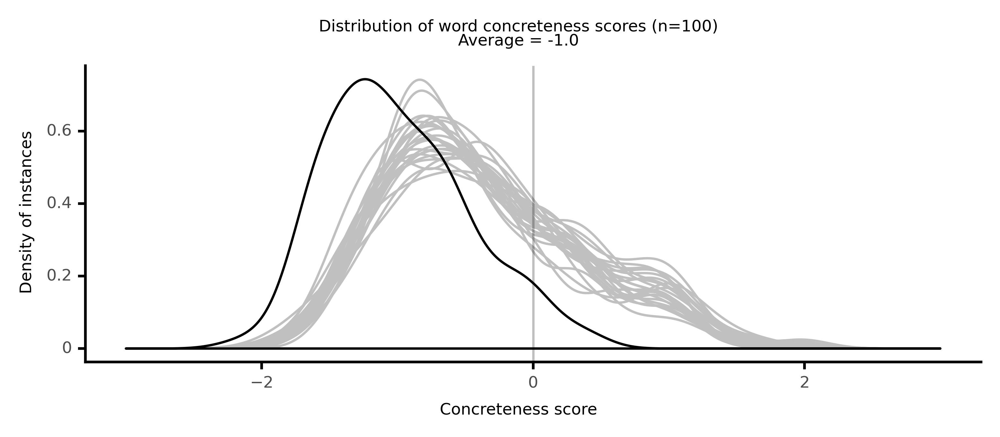

<ggplot: (8764084817229)>

 90%|█████████ | 90/100 [19:40<02:13, 13.39s/it]

#### #91 most abstract passage: Plato, _Dialogues_ (-375)

<p>that every man is a <abs><conc110>partaker</conc110></abs> of it. And I will now Pkotacoras. endeavoiu to show further that they do not <abs><conc140>conceive</conc140></abs> this <abs><conc125>virtue</conc125></abs> to be given by <abs><conc157>nature</conc157></abs>, or to <neither><conc639>grow</conc639></neither> spontaneously, but to be a thing which may be <abs><conc205>taught</conc205></abs>; and which comes to a and are man by taking <neither><conc304>pains</conc304></neither>. No one would <abs><conc104>instruct</conc104></abs>, no one would STc^wamoT <abs><conc125>rebuke</conc125></abs>, or be <neither><conc400>angry</conc400></neither> with those whose <abs><conc069>calamities</conc069></abs> they <abs><conc142>suppose</conc142></abs> them, which% to be due to <abs><conc157>nature</conc157></abs> or <neither><conc622>chance</conc622></neither>; they do not try to pimish or1'''^'^' to <abs><conc131>prevent</conc131></abs> them from being what they are; they do but <neither><conc353>pity</conc353></neither> <abs><conc014>acquired</conc014></abs> and them. Who is so foohsh as to <abs><conc097>chastise</conc097></abs> or <abs><conc104>instruct</conc104></abs> the <conc><conc834>ugly</conc834></conc>,'''8- or the diminutive, or the <neither><conc540>feeble</conc540></neither>? And why not? <conc><conc809>Be-</conc809></conc> cause he knows that good and <abs><conc136>evil</conc136></abs> of this <neither><conc478>kind</conc478></neither> is the work of <abs><conc157>nature</conc157></abs> and of <neither><conc622>chance</conc622></neither>; whereas if a man is <abs><conc220>wanting</conc220></abs> in the good <abs><conc236>qualities</conc236></abs> which are <abs><conc129>attained</conc129></abs> by <abs><conc056>study</conc056></abs> and <abs><conc086>exercise</conc086></abs> and <abs><conc044>teaching</conc044></abs>, and has only the <abs><conc053>contrary</conc053></abs> <abs><conc136>evil</conc136></abs> <abs><conc236>qualities</conc236></abs>, other men are <neither><conc400>angry</conc400></neither> with him, and <abs><conc021>punish</conc021></abs> and <abs><conc020>reprove</conc020></abs> him-- of which <abs><conc136>evil</conc136></abs> <abs><conc236>qualities</conc236></abs> one is <abs><conc038>impiety</conc038></abs>, another <abs><conc008>injustice</conc008></abs>, and they may be described <abs><conc058>generally</conc058></abs> as the very <neither><conc285>opposite</conc285></neither> of <abs><conc027>political</conc027></abs> <abs><conc125>virtue</conc125></abs>. In such <abs><conc072>cases</conc072></abs> any man will be <neither><conc400>angry</conc400></neither> with another, and reprimand him,-- clearly because he thinks that by <abs><conc056>study</conc056></abs> and <abs><conc135>learning</conc135></abs>, the <abs><conc125>virtue</conc125></abs> in which the other is <abs><conc129>deficient</conc129></abs> may be <abs><conc014>acquired</conc014></abs>. If you will think, Socrates, of the <abs><conc157>nature</conc157></abs> of <abs><conc031>punishment</conc031></abs>, you will see at once that in the <abs><conc014>opinion</conc014></abs> of <abs><conc144>mankind</conc144></abs> <abs><conc125>virtue</conc125></abs> may be <abs><conc014>acquired</conc014></abs>; no one punishes the evildoer under the <abs><conc035>notion</conc035></abs>, or for the <abs><conc039>reason</conc039></abs>, that he has done <abs><conc185>wrong</conc185></abs>,-- only the imreasonable <neither><conc343>fury</conc343></neither> of a <conc><conc778>beast</conc778></conc> <abs><conc086>acts</conc086></abs> in that manner. But he who <abs><conc124>desires</conc124></abs> to <abs><conc130>inflict</conc130></abs> <neither><conc339>rational</conc339></neither> punish-: xnent does not retaliate for a <neither><conc413>passed</conc413></neither> <abs><conc185>wrong</conc185></abs> which can not be xindone; he has regard to the <abs><conc193>future</conc193></abs>, and is <abs><conc187>desirous</conc187></abs> that the who is pimished, and he who <neither><conc722>sees</conc722></neither> him <abs><conc065>punished</conc065></abs>, may deterred from doing <abs><conc185>wrong</conc185></abs> again. He punishes for the of <abs><conc078>prevention</conc078></abs>, thereby clearly <abs><conc012>implying</conc012></abs> that <abs><conc125>virtue</conc125></abs> is^: apable of being <abs><conc205>taught</conc205></abs>. This is the <abs><conc035>notion</conc035></abs> of all who retaliate upon others either <abs><conc113>privately</conc113></abs> or <abs><conc063>publicly</conc063></abs>. And the Athenians, too, your own <neither><conc249>citizens</conc249></neither>, Like other men, <abs><conc021>punish</conc021></abs> and take <abs><conc224>vengeance</conc224></abs> on all whom they regard as <abs><conc136>evil</conc136></abs> <abs><conc153>doers</conc153></abs>; and hence, we may <abs><conc021>infer</conc021></abs> them to be of the <neither><conc306>number</conc306></neither> of those who think that <abs><conc125>virtue</conc125></abs> may be <abs><conc014>acquired</conc014></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

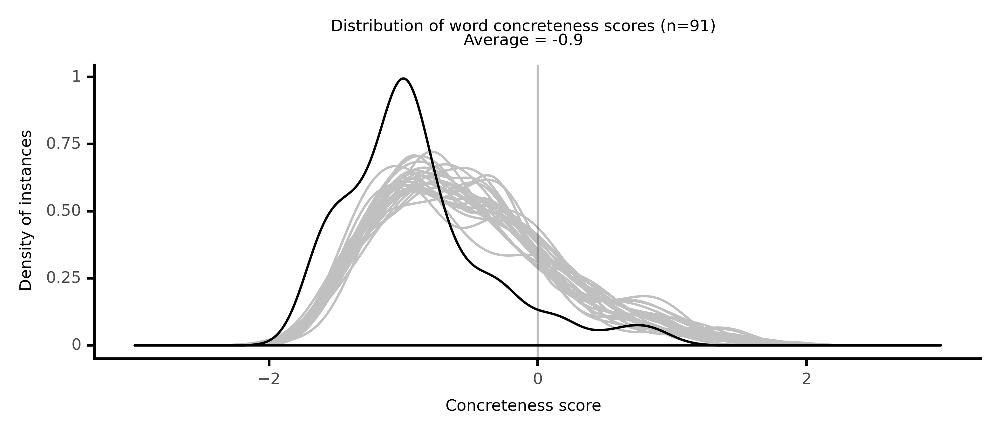

<ggplot: (8764106723197)>

 91%|█████████ | 91/100 [19:54<02:02, 13.60s/it]

#### #92 most abstract passage: More, _C&oelig;lebs in Search of a Wife._ (1809)

<p><abs><conc014>motives</conc014></abs> of <abs><conc161>attachment</conc161></abs>, an <abs><conc161>attachment</conc161></abs> which I <abs><conc253>hoped</conc253></abs> would be <abs><conc061>perpetuated</conc061></abs> beyond the <neither><conc550>narrow</conc550></neither> <abs><conc251>bounds</conc251></abs> of this <neither><conc372>perishable</conc372></neither> world. My dear Sir John,'' said Mr. Stanley, it is among the <neither><conc314>daily</conc314></neither> but <neither><conc326>comparatively</conc326></neither> <abs><conc160>petty</conc160></abs> <abs><conc169>trials</conc169></abs> of every man who is <neither><conc275>deeply</conc275></neither> in <abs><conc083>earnest</conc083></abs> to <abs><conc149>secure</conc149></abs> his <abs><conc204>immortal</conc204></abs> <abs><conc081>interests</conc081></abs>, to be <neither><conc295>classed</conc295></neither> with <neither><conc561>low</conc561></neither> and <neither><conc593>wild</conc593></neither> <abs><conc039>enthusiasts</conc039></abs> whom his <abs><conc006>judgement</conc006></abs> <abs><conc006>condemns</conc006></abs>, with <abs><conc127>hypocrites</conc127></abs> against whom his <abs><conc016>principles</conc016></abs> <abs><conc092>revolt</conc092></abs>, and with men, <neither><conc263>pious</conc263></neither> and <abs><conc036>conscientious</conc036></abs> I am most willing to allow, but <neither><conc283>differing</conc283></neither> widely from his own <abs><conc017>views</conc017></abs>; with others who <abs><conc008>evince</conc008></abs> a want of <abs><conc217>charity</conc217></abs> in some <neither><conc361>points</conc361></neither>, and a want of <abs><conc006>judgement</conc006></abs> in most. To be <abs><conc250>identified</conc250></abs>, I say, with men so different from yourself, because you <neither><conc306>hold</conc306></neither> in <abs><conc256>common</conc256></abs> some great <abs><conc053>truths</conc053></abs>, which all real <abs><conc084>Christians</conc084></abs> have <neither><conc305>held</conc305></neither> in all <abs><conc240>ages</conc240></abs>, and because you <abs><conc160>agree</conc160></abs> with them in <abs><conc259>avoiding</conc259></abs> the blameable <abs><conc033>excesses</conc033></abs> of <abs><conc256>dissipation</conc256></abs>, is among the <abs><conc128>sacrifices</conc128></abs> of <abs><conc146>reputation</conc146></abs>, which a man must be <neither><conc335>contented</conc335></neither> to make, who is <abs><conc083>earnest</conc083></abs> in the great <abs><conc162>object</conc162></abs> of a <abs><conc057>Christian</conc057></abs>'s <abs><conc209>pursuit</conc209></abs>. I <abs><conc075>trust</conc075></abs>, however, that, through <abs><conc020>divine</conc020></abs> <neither><conc290>grace</conc290></neither>, I shall never <abs><conc024>renounce</conc024></abs> my <abs><conc041>integrity</conc041></abs> for the <abs><conc130>praise</conc130></abs> of men, who have so little <abs><conc144>consistency</conc144></abs>, that though they <abs><conc160>pretend</conc160></abs> their <neither><conc325>quarrel</conc325></neither> is with your <abs><conc023>faith</conc023></abs>, yet who would not <neither><conc398>care</conc398></neither> how <abs><conc146>extravagant</conc146></abs> your <abs><conc004>belief</conc004></abs> was, if your <abs><conc086>practice</conc086></abs> <abs><conc195>assimilated</conc195></abs> with their own. I <abs><conc075>trust</conc075></abs> on the other <neither><conc486>hand</conc486></neither>, that I shall always <abs><conc064>maintain</conc064></abs> my <abs><conc028>candour</conc028></abs> towards those with whom we are <abs><conc027>unfairly</conc027></abs> <abs><conc028>involved</conc028></abs>; men, <abs><conc043>religious</conc043></abs> though somewhat <neither><conc352>eccentric</conc352></neither>, <abs><conc148>devout</conc148></abs>, though <abs><conc057>injudicious</conc057></abs>, and sincere, though <abs><conc174>mistaken</conc174></abs>; but who, with all their <abs><conc020>errors</conc020></abs>, against which I <abs><conc208>protest</conc208></abs>, and with all their <abs><conc063>indiscretion</conc063></abs>, which I <abs><conc205>lament</conc205></abs>, and with all their <abs><conc066>ill-judged</conc066></abs>, because <neither><conc549>irregular</conc549></neither> <abs><conc037>zeal</conc037></abs>, which I <abs><conc215>blame</conc215></abs>, I shall ever think-- always excepting <abs><conc127>hypocrites</conc127></abs> and <abs><conc085>false</conc085></abs> <abs><conc037>pretenders</conc037></abs>-- are better men, and in a <neither><conc349>safer</conc349></neither> state than their revilers.'' I have often <neither><conc267>suspected</conc267></neither>,'' said I, that under the <abs><conc104>plausible</conc104></abs> <neither><conc289>pretence</conc289></neither> of <abs><conc193>objecting</conc193></abs> to your <abs><conc062>creed</conc062></abs>, men <neither><conc381>conceal</conc381></neither> their <neither><conc325>quarrel</conc325></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

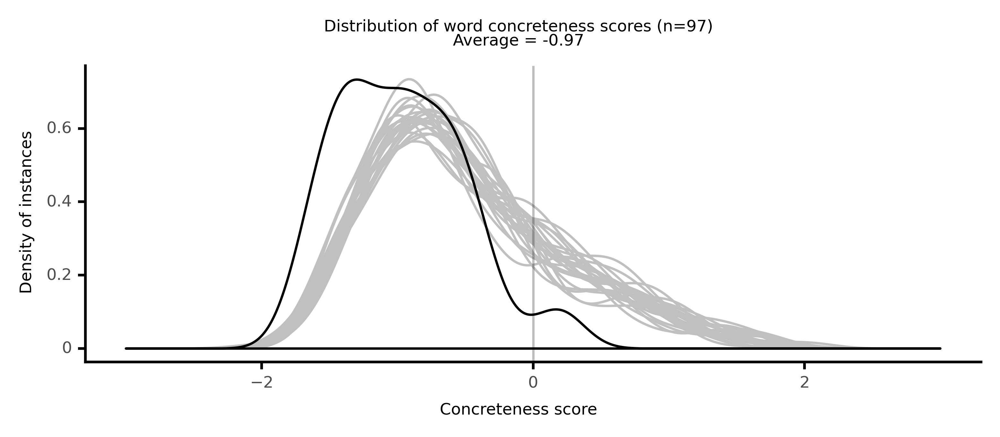

<ggplot: (8764118548161)>

 92%|█████████▏| 92/100 [20:07<01:45, 13.25s/it]

#### #93 most abstract passage: Moore, _Mordaunt. Sketches of Life, Characters, and Manner_ (1800)

<p>was of <abs><conc086>laymen</conc086></abs> <neither><conc275>meddling</conc275></neither> in <abs><conc124>affairs</conc124></abs> of religion.-- Indeed, sir,'' <neither><conc280>continued</conc280></neither> he, <abs><conc057>honesty</conc057></abs> is not <abs><conc135>considered</conc135></abs>, in this country, as <abs><conc076>essentially</conc076></abs> <neither><conc280>connected</conc280></neither> with <abs><conc025>religion</conc025></abs>. To <abs><conc164>infuse</conc164></abs> the <abs><conc008>spirit</conc008></abs> of <abs><conc086>benevolence</conc086></abs>, and <abs><conc094>prevail</conc094></abs> on men to <abs><conc176>regulate</conc176></abs> their <abs><conc010>actions</conc010></abs> by <abs><conc114>strict</conc114></abs> <abs><conc041>integrity</conc041></abs>, is a more <abs><conc219>difficult</conc219></abs> <abs><conc203>task</conc203></abs> than to <abs><conc216>persuade</conc216></abs> them to the <abs><conc246>performance</conc246></abs> of certain <neither><conc318>ceremonies</conc318></neither>, by which they <abs><conc119>compensate</conc119></abs> for a <abs><conc074>failure</conc074></abs> in <abs><conc005>moral</conc005></abs> <abs><conc194>duties</conc194></abs>. The <abs><conc217>vulgar</conc217></abs> mind can not <neither><conc304>imagine</conc304></neither> that the <abs><conc121>Deity</conc121></abs> is not better <neither><conc306>pleased</conc306></neither> with <neither><conc450>pompous</conc450></neither> <conc><conc731>procession</conc731></conc> in honour of himself than <neither><conc274>simple</conc274></neither> <neither><conc381>fair</conc381></neither> <abs><conc077>dealing</conc077></abs> of men with each other: the <abs><conc166>speediest</conc166></abs> way of <abs><conc036>convincing</conc036></abs> the <abs><conc221>multitude</conc221></abs> is by <abs><conc073>inflaming</conc073></abs> their <abs><conc169>passion</conc169></abs>. It is <neither><conc323>generally</conc323></neither> <abs><conc208>fruitless</conc208></abs>, and sometime not very <neither><conc348>safe</conc348></neither>, to <abs><conc157>endeavour</conc157></abs> to <abs><conc216>persuade</conc216></abs> them that the <neither><conc318>ceremonies</conc318></neither> of <abs><conc025>religion</conc025></abs> are of little <abs><conc132>benefit</conc132></abs> without <abs><conc007>probity</conc007></abs>. The very <abs><conc137>judge</conc137></abs> of whom you <abs><conc144>complain</conc144></abs> is a <abs><conc178>constant</conc178></abs> <neither><conc533>attendant</conc533></neither> at <neither><conc397>mass</conc397></neither>, and <neither><conc382>repeats</conc382></neither> his <neither><conc356>prayers</conc356></neither> which much <abs><conc047>apparent</conc047></abs> <abs><conc085>piety</conc085></abs>; yet I am of <abs><conc020>opinion</conc020></abs> that a <conc><conc817>small</conc817></conc> <neither><conc282>bribe</conc282></neither> will <neither><conc329>dispose</conc329></neither> him more to do you <abs><conc027>justice</conc027></abs> than all the <abs><conc025>religion</conc025></abs> he <abs><conc261>possesses</conc261></abs>.'' You lay more <abs><conc213>stress</conc213></abs> on a man's <abs><conc005>moral</conc005></abs> <abs><conc010>conduct</conc010></abs>, father, than on his <abs><conc043>religious</conc043></abs> <abs><conc034>sentiments</conc034></abs>,'' said <neither><conc449>I.</conc449></neither> I lay more <abs><conc213>stress</conc213></abs> on a man's <abs><conc005>moral</conc005></abs> <abs><conc010>conduct</conc010></abs> than on his <abs><conc043>religious</conc043></abs> <abs><conc052>professions</conc052></abs>,'' replied he. Yet still <abs><conc025>religion</conc025></abs> is of more importance than <abs><conc036>morality</conc036></abs>, because in <abs><conc180>genuine</conc180></abs> <abs><conc025>religion</conc025></abs> <abs><conc036>morality</conc036></abs> is <neither><conc348>included</conc348></neither>; whereas in <abs><conc036>morality</conc036></abs> <abs><conc025>religion</conc025></abs> is not <neither><conc348>included</conc348></neither>, though <abs><conc149>absolutely</conc149></abs> necessary for men's <abs><conc149>happiness</conc149></abs>. I am <abs><conc087>convinced</conc087></abs>, therefore, that it would be of <abs><conc154>infinite</conc154></abs> importance to the <abs><conc014>moralists</conc014></abs> to have more <abs><conc025>religion</conc025></abs>; and I believe also it would be good for many <abs><conc211>professors</conc211></abs> of <abs><conc025>religion</conc025></abs> to have more <abs><conc036>morality</conc036></abs>.'' The frank and <neither><conc322>friendly</conc322></neither> <abs><conc174>behaviour</conc174></abs> of this <neither><conc421>priest</conc421></neither> <neither><conc306>pleased</conc306></neither> me <abs><conc201>greatly</conc201></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

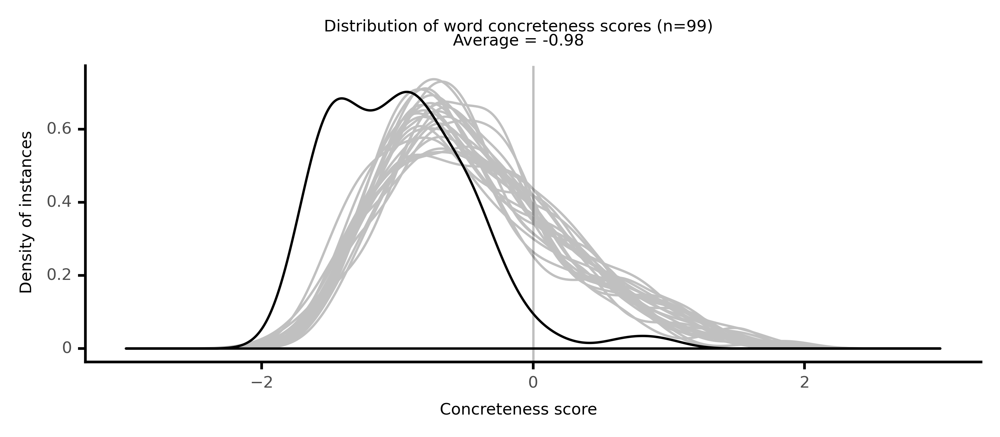

<ggplot: (8764099091785)>

 93%|█████████▎| 93/100 [20:21<01:35, 13.61s/it]

#### #94 most abstract passage: Ware, _Letters of Lucius M. Piso, from Palmyra, to His Fr_ (1837)

<p>its <abs><conc029>policy</conc029></abs>. I am <neither><conc435>afraid</conc435></neither> it formerly <abs><conc134>tolerated</conc134></abs>, only because it saw nothing to <abs><conc069>fear</conc069></abs>. <neither><conc354>Fearing</conc354></neither> <abs><conc049>christianity</conc049></abs>, it <abs><conc212>seeks</conc212></abs> to <abs><conc177>destroy</conc177></abs> it. That is <neither><conc372>scarcely</conc372></neither> <abs><conc167>generous</conc167></abs> of you, Lucius; nor very <abs><conc042>wise</conc042></abs>, either-- for surely <abs><conc013>truth</conc013></abs> can neither be <abs><conc087>created</conc087></abs> nor <neither><conc363>suppressed</conc363></neither> by <abs><conc195>applications</conc195></abs> of <abs><conc166>force</conc166></abs>. Such is not the <abs><conc008>doctrine</conc008></abs> of <abs><conc049>christianity</conc049></abs>, if I <abs><conc141>understand</conc141></abs> you right.' Lady, most certainly not,' he replied. <abs><conc049>Christianity</conc049></abs> is <neither><conc297>offered</conc297></neither> to <abs><conc013>mankind</conc013></abs>, not <abs><conc195>forced</conc195></abs> upon them. And this <abs><conc062>supposes</conc062></abs> in them the <abs><conc028>power</conc028></abs> and the right to <neither><conc652>sit</conc652></neither> in <abs><conc006>judgement</conc006></abs> upon its <abs><conc013>truth</conc013></abs>. But were not all free <abs><conc006>judgement</conc006></abs> <neither><conc350>destroyed</conc350></neither>, and all <abs><conc118>worthy</conc118></abs> <neither><conc385>reception</conc385></neither> of it, therefore, if any <abs><conc118>penal</conc118></abs> <abs><conc025>consequences</conc025></abs>-- <abs><conc195>greater</conc195></abs> or less, of one <neither><conc265>kind</conc265></neither> or another, present or <abs><conc066>future</conc066></abs>-- followed upon its <abs><conc017>rejection</conc017></abs>? Rome has done <abs><conc247>wickedly</conc247></abs>, in her <abs><conc146>aim</conc146></abs> to <abs><conc135>suppress</conc135></abs> <abs><conc014>error</conc014></abs> and <abs><conc064>maintain</conc064></abs> <abs><conc013>truth</conc013></abs> by <abs><conc166>force</conc166></abs>. Is Rome a God to <neither><conc331>distinguish</conc331></neither> with <abs><conc058>certainty</conc058></abs> the one from the other? But alas! Rome is not alone to <abs><conc215>blame</conc215></abs> in this. <abs><conc084>Christians</conc084></abs> themselves are <abs><conc143>guilty</conc143></abs> of the same <abs><conc077>folly</conc077></abs> and <abs><conc076>crime</conc076></abs>. They <abs><conc048>interpret</conc048></abs> <neither><conc359>differently</conc359></neither> the <neither><conc270>sayings</conc270></neither> of Christ-- as how should they not?-- and the <abs><conc215>party</conc215></abs> which is <neither><conc269>stronger</conc269></neither> in <neither><conc287>numbers</conc287></neither> already begins to <abs><conc116>oppress</conc116></abs>, with <neither><conc518>hard</conc518></neither> <abs><conc174>usage</conc174></abs> and <abs><conc082>language</conc082></abs>, the <neither><conc339>weaker</conc339></neither> <abs><conc215>party</conc215></abs>, which presumest to <abs><conc108>entertain</conc108></abs> its own <abs><conc013>opinions</conc013></abs>. The <abs><conc084>Christians</conc084></abs> of Alexandria and Rome, found of the <neither><conc270>ancient</conc270></neither> <abs><conc062>philosophy</conc062></abs>, and <abs><conc148>desirous</conc148></abs> to <abs><conc250>recommend</conc250></abs> the <abs><conc017>doctrines</conc017></abs> of Christ, by <neither><conc387>showing</conc387></neither> their near accordance with it, have, as many think, <abs><conc201>greatly</conc201></abs> <neither><conc549>adulterated</conc549></neither> the <abs><conc071>gospel</conc071></abs>, by <neither><conc667>mixing</conc667></neither> up with its <abs><conc053>truths</conc053></abs> the <neither><conc555>fantastic</conc555></neither> <neither><conc331>dreams</conc331></neither> of Plato. Others, among whom is our Paul of Antioch, <abs><conc108>deeming</conc108></abs> this <abs><conc155>injurious</conc155></abs> and <abs><conc025>erroneous</conc025></abs>, <abs><conc146>aim</conc146></abs> to <abs><conc231>restore</conc231></abs> the <abs><conc057>Christian</conc057></abs> <abs><conc008>doctrine</conc008></abs> to the <abs><conc222>simplicity</conc222></abs> that <neither><conc273>belongs</conc273></neither> to it in the <abs><conc192>original</conc192></abs> <abs><conc154>records</conc154></abs>, and which, for the most part, it still <neither><conc351>retains</conc351></neither> among the <abs><conc256>common</conc256></abs> people. But this is not <abs><conc228>willingly</conc228></abs> <neither><conc288>allowed</conc288></neither>. On the <abs><conc072>contrary</conc072></abs>, because Paul can not see with their <neither><conc558>eyes</conc558></neither>, and <abs><conc137>judge</conc137></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

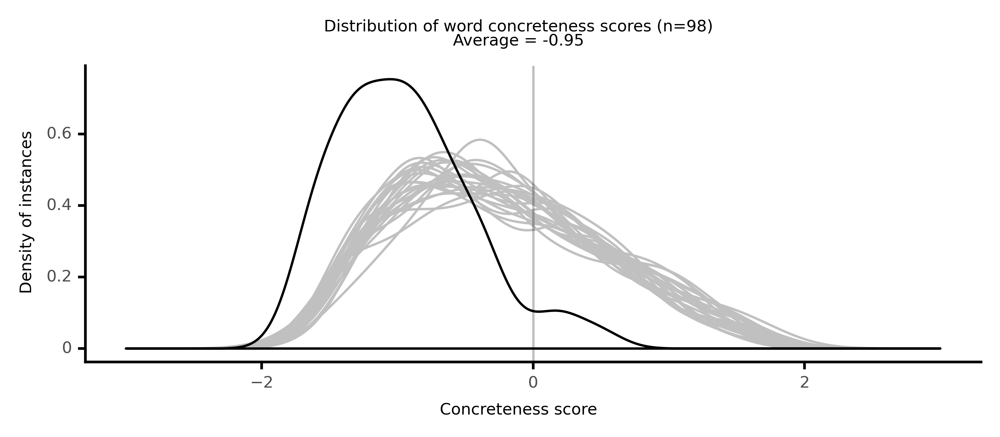

<ggplot: (8764099117949)>

 94%|█████████▍| 94/100 [20:32<01:15, 12.64s/it]

#### #95 most abstract passage: McHenry, _Meredith; or, The Mystery of the Meschianza. A Tal_ (1831)

<p>, to <abs><conc209>excess</conc209></abs>. Her <neither><conc275>heart</conc275></neither> really <neither><conc368>preferred</conc368></neither> Meredith to any other suitor, and she did not wish to <neither><conc462>sport</conc462></neither> with his <abs><conc081>feelings</conc081></abs> so far as either to <abs><conc019>alienate</conc019></abs> them from herself, or <abs><conc055>impel</conc055></abs> him to a serious and <abs><conc169>hazardous</conc169></abs> <abs><conc013>hostility</conc013></abs> with Harris. When Edward, therefore, <neither><conc470>driven</conc470></neither> almost to <neither><conc297>desperation</conc297></neither> by her <abs><conc078>indulgence</conc078></abs> of the <abs><conc180>familiarities</conc180></abs> of his cousin, <abs><conc236>resolved</conc236></abs>, even at the <neither><conc293>risk</conc293></neither> of <abs><conc029>incurring</conc029></abs> her <abs><conc155>displeasure</conc155></abs>, to <abs><conc102>declare</conc102></abs> to her his <abs><conc081>feelings</conc081></abs> on the <abs><conc047>subject</conc047></abs>, and <abs><conc202>require</conc202></abs> from her an <abs><conc132>explanation</conc132></abs> of her <abs><conc010>conduct</conc010></abs>, that he might know whither or not, he yet <abs><conc182>possessed</conc182></abs> any place in her regards, she <neither><conc269>afforded</conc269></neither> him <abs><conc232>entire</conc232></abs> <abs><conc161>satisfaction</conc161></abs> on the <abs><conc047>subject</conc047></abs>. I think,'' said she, that the <abs><conc237>relationship</conc237></abs> <abs><conc070>existing</conc070></abs> between Harris and me, <abs><conc157>fully</conc157></abs> <abs><conc009>sanctions</conc009></abs> the <abs><conc261>intimacy</conc261></abs> of which you <abs><conc144>complain</conc144></abs>. At the same time, I <abs><conc149>confess</conc149></abs>, that I have <abs><conc181>intentionally</conc181></abs> <abs><conc126>encouraged</conc126></abs> his <neither><conc368>attentions</conc368></neither> for the <abs><conc211>purpose</conc211></abs> of trying the <abs><conc045>sincerity</conc045></abs> of your <abs><conc161>attachment</conc161></abs>, and also, because I was willing to <abs><conc111>punish</conc111></abs> you for being so <neither><conc384>easily</conc384></neither> made <neither><conc285>jealous</conc285></neither>.'' Oh! Harriet, how could you take <abs><conc219>pleasure</conc219></abs> in giving me <neither><conc320>pain</conc320></neither>!'' Mr. Meredith,'' said she, if you <neither><conc287>choose</conc287></neither> to <neither><conc333>torment</conc333></neither> yourself, when I think <abs><conc232>proper</conc232></abs> to <neither><conc264>enjoy</conc264></neither> the <abs><conc147>society</conc147></abs> of my friends, it is your own <abs><conc193>fault</conc193></abs>. I really can not <abs><conc206>consent</conc206></abs> to <abs><conc136>abandon</conc136></abs> the <abs><conc125>enjoyments</conc125></abs> of <abs><conc137>social</conc137></abs> life, in <abs><conc191>order</conc191></abs> to keep you in good <abs><conc133>temper</conc133></abs>.'' You <abs><conc229>mistake</conc229></abs> me, Miss Lewis; I do not wish such a <abs><conc136>sacrifice</conc136></abs>. But you, indeed, of <neither><conc302>late</conc302></neither> seemed to <neither><conc346>prefer</conc346></neither> the <abs><conc147>society</conc147></abs> of Harris to mine.'' Seemed-- that word is truly spoken,'' said she. It was but a seeming <abs><conc236>preference</conc236></abs>. Besides you are not my cousin.'' But cousin's,'' he <neither><conc379>observed</conc379></neither>, may be <neither><conc506>lovers</conc506></neither>, and are often <abs><conc175>dangerous</conc175></abs> <neither><conc596>playmates</conc596></neither>.'' Edward!'' she replied, you are really <neither><conc521>provokingly</conc521></neither> <neither><conc341>suspicious</conc341></neither>. Have I not already made <abs><conc057>avowals</conc057></abs> <abs><conc225>sufficient</conc225></abs> to <abs><conc064>convince</conc064></abs> you of my <abs><conc236>preference</conc236></abs>. If you are not <abs><conc180>satisfied</conc180></abs>, I <neither><conc291>assure</conc291></neither> you I will not <neither><conc404>fall</conc404></neither> on my <conc><conc858>knees</conc858></conc> and <neither><conc267>implore</conc267></neither> you to believe me. I have not affected to <abs><conc082>doubt</conc082></abs> the <abs><conc045>sincerity</conc045></abs> of your <abs><conc052>professions</conc052></abs>, and I consider it a very <neither><conc633>bade</conc633></neither> <neither><conc331>compliment</conc331></neither> to my <abs><conc012>veracity</conc012></abs> that you should <abs><conc082>doubt</conc082></abs> mine.'' Do not be <abs><conc214>offended</conc214></abs>, Miss Lewis,'' said he. It is the very <abs><conc119>ardor</conc119></abs> of my <abs><conc228>affections</conc228></abs> which <abs><conc203>renders</conc203></abs> me <neither><conc281>anxious</conc281></neither> to have the <abs><conc101>assurance</conc101></abs> of yours made <neither><conc302>doubly</conc302></neither> sure. But I am now <abs><conc180>satisfied</conc180></abs>. I will no <neither><conc302>longer</conc302></neither> <abs><conc082>doubt</conc082></abs> that I am, in <abs><conc013>truth</conc013></abs>, the <neither><conc368>preferred</conc368></neither> of your <neither><conc275>heart</conc275></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

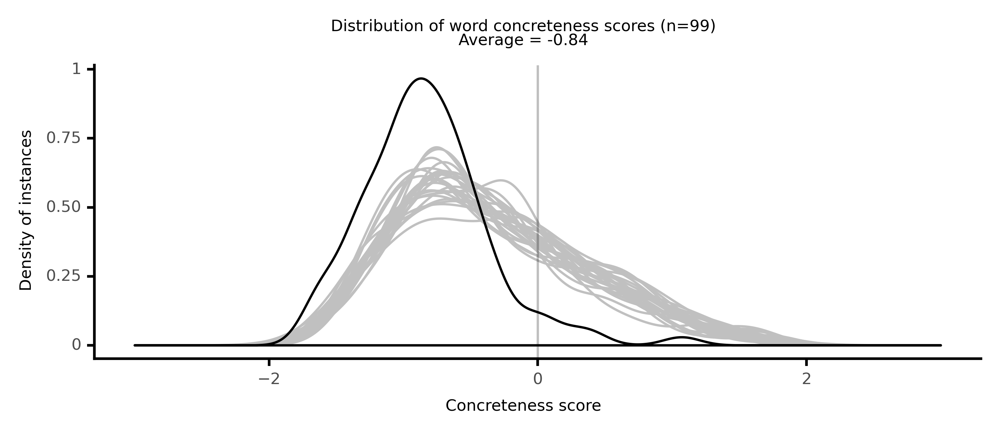

<ggplot: (8764106972189)>

 95%|█████████▌| 95/100 [20:42<01:00, 12.08s/it]

#### #96 most abstract passage: McHenry, _The Betrothed of Wyoming (1830)_ (1830)

<p>her father she would <neither><conc391>cheerfully</conc391></neither> <neither><conc363>die</conc363></neither>; but could she <abs><conc094>wrong</conc094></abs> her <abs><conc163>soul</conc163></abs>? Could she become a <abs><conc241>bold</conc241></abs> <abs><conc149>offender</conc149></abs> against <neither><conc267>Heaven</conc267></neither> and <abs><conc047>subject</conc047></abs> herself to <abs><conc234>perdition</conc234></abs>?-- No, no-- her father himself would <neither><conc534>shudder</conc534></neither> at the thought. She must <abs><conc023>reject</conc023></abs> the <neither><conc452>dreadful</conc452></neither> <abs><conc159>alternative</conc159></abs>, be the <abs><conc068>consequence</conc068></abs> what it would. To Mary Watson she showed the <neither><conc343>letter</conc343></neither>, and <neither><conc331>explained</conc331></neither> her <abs><conc078>perplexities</conc078></abs>, and from her she <neither><conc502>requested</conc502></neither> <abs><conc107>counsel</conc107></abs>. <neither><conc267>Heaven</conc267></neither> be <neither><conc376>praised</conc376></neither>,'' she said, my father is <neither><conc430>alive</conc430></neither>; and he has not been <neither><conc347>tortured</conc347></neither>. But how shall I <abs><conc256>save</conc256></abs> him from the <abs><conc144>perils</conc144></abs> with which he is <abs><conc241>threatened</conc241></abs>. Oh! my friend, thy <abs><conc006>judgement</conc006></abs> is <neither><conc325>clear</conc325></neither>-- <abs><conc107>counsel</conc107></abs> me what I shall do!'' Thy <abs><conc194>situation</conc194></abs> is, indeed, <abs><conc153>perplexing</conc153></abs>,'' said Miss Watson, what <abs><conc107>counsel</conc107></abs> to give it is <abs><conc219>difficult</conc219></abs> to <abs><conc148>determine</conc148></abs>. <abs><conc100>Concession</conc100></abs> to the <abs><conc041>demands</conc041></abs> of this <neither><conc273>wicked</conc273></neither> man can not be thought of. To <neither><conc265>refuse</conc265></neither> him entirely might be to <neither><conc552>seal</conc552></neither> thy father's <abs><conc213>fate</conc213></abs>. To <abs><conc114>defer</conc114></abs> making any reply to his <neither><conc343>letter</conc343></neither> might <abs><conc100>gain</conc100></abs> time for the <abs><conc227>occurrence</conc227></abs> of some <abs><conc232>favourable</conc232></abs> <abs><conc161>event</conc161></abs>. But that is <neither><conc264>uncertain</conc264></neither>; and he <abs><conc259>threatens</conc259></abs> <abs><conc091>harshness</conc091></abs> in case of <neither><conc288>delay</conc288></neither>. To <abs><conc260>deceive</conc260></abs> him by a <neither><conc282>feigned</conc282></neither> and <abs><conc020>conditional</conc020></abs> <abs><conc146>compliance</conc146></abs>, would be the <neither><conc300>safest</conc300></neither> course; but would it be <abs><conc232>proper</conc232></abs>? Would it be <abs><conc009>justifiable</conc009></abs>? These are <abs><conc154>questions</conc154></abs> which <abs><conc202>require</conc202></abs> a <abs><conc254>clearer</conc254></abs> <abs><conc006>judgement</conc006></abs> than mine, to <abs><conc144>resolve</conc144></abs>.'' Alas!'' said Agnes, in what a <abs><conc194>situation</conc194></abs> am I placed, when the least <abs><conc254>unhappy</conc254></abs> <abs><conc159>alternative</conc159></abs> for me to <abs><conc092>adopt</conc092></abs> is <abs><conc189>deception</conc189></abs>!'' But it is <abs><conc189>deception</conc189></abs> to <neither><conc280>prevent</conc280></neither> <abs><conc140>cruelty</conc140></abs> and <abs><conc076>crime</conc076></abs>,'' <neither><conc379>observed</conc379></neither> Miss Watson, and <abs><conc189>deception</conc189></abs> too that will <abs><conc247>injure</conc247></abs> no one. Does this not <abs><conc071>argue</conc071></abs> something in its <abs><conc142>favour</conc142></abs>?'' I would <neither><conc321>fain</conc321></neither> <abs><conc028>reconcile</conc028></abs> my <abs><conc026>conscience</conc026></abs> to its <abs><conc126>adoption</conc126></abs> in this <abs><conc233>instance</conc233></abs>, said Agnes, but I can not. The <abs><conc061>motive</conc061></abs> for the <abs><conc130>imposition</conc130></abs> may be <abs><conc053>laudable</conc053></abs>. But still it would be <abs><conc130>imposition</conc130></abs>. It would be <neither><conc330>promising</conc330></neither> to do that which I am <abs><conc236>resolved</conc236></abs> not to do-- Oh, Mary Watson, would you <abs><conc225>advice</conc225></abs> me to be <abs><conc143>guilty</conc143></abs> of <abs><conc113>falsehood</conc113></abs>?'' I am, indeed, <neither><conc442>bewildered</conc442></neither> on the <abs><conc047>subject</conc047></abs>,'' replied Miss Watson. <neither><conc640>Anxiously</conc640></neither> do I wish for the <abs><conc126>adoption</conc126></abs> of some means to <abs><conc239>preserve</conc239></abs> your father,-- and I can see no other than your <abs><conc080>consenting</conc080></abs> to <abs><conc260>deceive</conc260></abs> the <neither><conc273>wicked</conc273></neither> man into whose <abs><conc028>power</conc028></abs> he has <neither><conc478>fallen</conc478></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

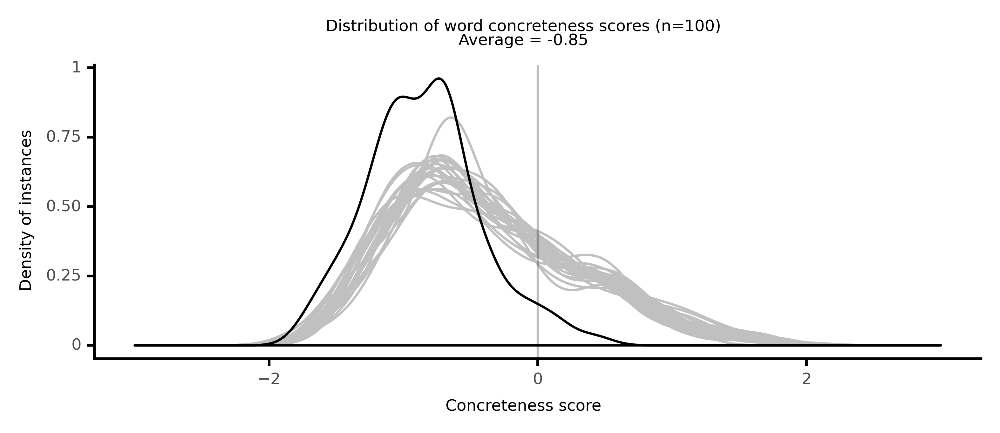

<ggplot: (8764120873797)>

 96%|█████████▌| 96/100 [20:52<00:45, 11.47s/it]

#### #97 most abstract passage: Radcliffe, _The Mysteries of Udolpho, A Romance ..._ (1794)

<p>.'' Emily <abs><conc146>assured</conc146></abs> him, that his <abs><conc127>advice</conc127></abs> was most <neither><conc633>precious</conc633></neither> to her, and that she would never <abs><conc212>forget</conc212></abs> it, or <abs><conc200>cease</conc200></abs> from <abs><conc182>endeavouring</conc182></abs> to <abs><conc202>profit</conc202></abs> by it. <neither><conc450>St.</conc450></neither> Aubert <neither><conc474>smiled</conc474></neither> <neither><conc358>affectionately</conc358></neither> and <neither><conc425>sorrowfully</conc425></neither> upon her. I <neither><conc284>repeat</conc284></neither> it,'' said he, I would not <abs><conc188>teach</conc188></abs> you to become <abs><conc197>insensible</conc197></abs>, if I could; I would only <neither><conc255>warn</conc255></neither> you of the <abs><conc066>evils</conc066></abs> of <abs><conc148>susceptibility</conc148></abs>, and <neither><conc317>point</conc317></neither> out how you may <abs><conc146>avoid</conc146></abs> them. <neither><conc258>Beware</conc258></neither>, my love, I <neither><conc240>conjure</conc240></neither> you, of that <abs><conc051>self-delusion</conc051></abs>, which has been <neither><conc299>fatal</conc299></neither> to the <abs><conc120>peace</conc120></abs> of so many persons; <neither><conc258>beware</conc258></neither> of <abs><conc228>priding</conc228></abs> yourself on the <neither><conc240>gracefulness</conc240></neither> of <abs><conc199>sensibility</conc199></abs>; if you <neither><conc360>yield</conc360></neither> to this <abs><conc139>vanity</conc139></abs>, your <abs><conc063>happiness</conc063></abs> is <neither><conc303>lost</conc303></neither> for ever. Always <neither><conc299>remember</conc299></neither> how much more <neither><conc390>valuable</conc390></neither> is the <neither><conc256>strength</conc256></neither> of <abs><conc137>fortitude</conc137></abs>, than the <neither><conc291>grace</conc291></neither> of <abs><conc199>sensibility</conc199></abs>. Do not, however, <abs><conc173>confound</conc173></abs> <abs><conc137>fortitude</conc137></abs> with <abs><conc145>apathy</conc145></abs>; <abs><conc145>apathy</conc145></abs> can not know the <abs><conc076>virtue</conc076></abs>. <neither><conc299>Remember</conc299></neither>, too, that one act of <abs><conc016>beneficence</conc016></abs>, one act of real usefulness, is worth all the <abs><conc035>abstract</conc035></abs> <abs><conc069>sentiment</conc069></abs> in the world. <abs><conc069>Sentiment</conc069></abs> is a <abs><conc148>disgrace</conc148></abs>, instead of an <neither><conc715>ornament</conc715></neither>, unless it <neither><conc312>led</conc312></neither> us to good <abs><conc007>actions</conc007></abs>. The <neither><conc385>miser</conc385></neither>, who thinks himself <abs><conc174>respectable</conc174></abs>, merely because he <abs><conc212>possesses</conc212></abs> <abs><conc215>wealth</conc215></abs>, and thus <abs><conc072>mistakes</conc072></abs> the means of doing good, for the <abs><conc015>actual</conc015></abs> <abs><conc050>accomplishment</conc050></abs> of it, is not more <abs><conc006>blameable</conc006></abs> than the man of <abs><conc069>sentiment</conc069></abs>, without <abs><conc124>active</conc124></abs> <abs><conc076>virtue</conc076></abs>. You may have <neither><conc372>observed</conc372></neither> persons, who <neither><conc315>delight</conc315></neither> so much in this sort of <abs><conc199>sensibility</conc199></abs> to <abs><conc069>sentiment</conc069></abs>, which <abs><conc045>excludes</conc045></abs> that to the <neither><conc283>calls</conc283></neither> of any <abs><conc051>practical</conc051></abs> <abs><conc076>virtue</conc076></abs>, that they <neither><conc401>turn</conc401></neither> from the <abs><conc187>distressed</conc187></abs>, and, because their <abs><conc035>sufferings</conc035></abs> are <abs><conc182>painful</conc182></abs> to be <abs><conc208>contemplated</conc208></abs>, do not <abs><conc118>endeavour</conc118></abs> to <abs><conc148>relieve</conc148></abs> them. How <abs><conc140>despicable</conc140></abs> is that <abs><conc032>humanity</conc032></abs>, which can be <abs><conc169>contented</conc169></abs> to <neither><conc254>pity</conc254></neither>, where it might <abs><conc217>assuage</conc217></abs>!'' <neither><conc450>St.</conc450></neither> Aubert, some time after, spoke of Madame Cheron, his sister. Let me <abs><conc227>inform</conc227></abs> you of a circumstance, that nearly affects your <abs><conc041>welfare</conc041></abs>,'' he added. We have, you know, had little <abs><conc201>intercourse</conc201></abs> for some years; but, as she is now your only <conc><conc820>female</conc820></conc> <abs><conc127>relation</conc127></abs>, I have thought it <abs><conc196>proper</conc196></abs> to <neither><conc375>consign</conc375></neither> you to her <neither><conc375>care</conc375></neither>, as you will see in my will, till you are of <abs><conc229>age</conc229></abs>, and to <abs><conc212>recommend</conc212></abs> you to her <abs><conc169>protection</conc169></abs> afterwards. She is not exactly the person, to whom I would have <abs><conc134>committed</conc134></abs> my Emily, but I had no <abs><conc090>alternative</conc090></abs>, and I believe her to be upon the whole-- a good <neither><conc392>kind</conc392></neither> of woman. I needs not <abs><conc212>recommend</conc212></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

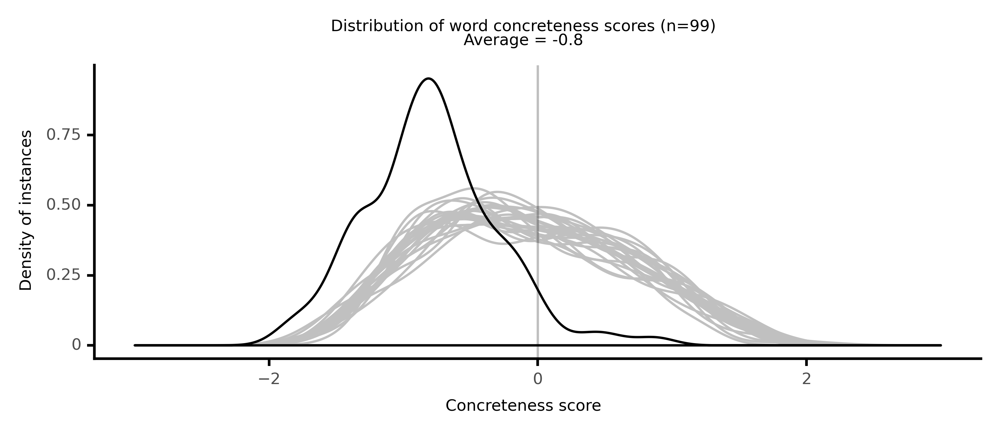

<ggplot: (8764101622025)>

 97%|█████████▋| 97/100 [21:06<00:36, 12.03s/it]

#### #98 most abstract passage: Cooper, _The Pioneers, volume 1 (1823)_ (1823)

<p><neither><conc269>difference</conc269></neither> between a <neither><conc276>saving</conc276></neither> <abs><conc023>faith</conc023></abs>, and the <abs><conc029>corollaries</conc029></abs> of a <abs><conc040>philosophical</conc040></abs> <abs><conc088>theology</conc088></abs>; and it <abs><conc094>teaches</conc094></abs> us to <abs><conc187>reduce</conc187></abs> our <abs><conc009>self-examination</conc009></abs> to the <abs><conc138>test</conc138></abs> of good works. By good works, must be <abs><conc118>understood</conc118></abs> the <neither><conc464>fruits</conc464></neither> of <abs><conc088>repentance</conc088></abs>, the <abs><conc178>chiefest</conc178></abs> of which is <abs><conc217>charity</conc217></abs>. Not that <abs><conc217>charity</conc217></abs> only, which causes us to help the <neither><conc314>needy</conc314></neither> and <neither><conc374>comfort</conc374></neither> the <abs><conc153>suffering</conc153></abs>, but that <abs><conc062>feeling</conc062></abs> of <abs><conc019>universal</conc019></abs> <abs><conc024>philanthropy</conc024></abs>, which, by <abs><conc154>teaching</conc154></abs> us to love, causes us to <abs><conc137>judge</conc137></abs> with <abs><conc003>lenity</conc003></abs>, all men; <neither><conc336>striking</conc336></neither> at the <neither><conc509>root</conc509></neither> of <abs><conc157>self-righteousness</conc157></abs>, and <neither><conc342>warning</conc342></neither> us to be <abs><conc118>sparing</conc118></abs> of our <abs><conc012>condemnation</conc012></abs> of others, while our own <abs><conc103>salvation</conc103></abs> is not yet <abs><conc149>secure</conc149></abs>. The <neither><conc265>lesson</conc265></neither> of <abs><conc080>expediency</conc080></abs>, my <neither><conc529>brothers</conc529></neither>, which I would <neither><conc593>gather</conc593></neither> from the <abs><conc090>consideration</conc090></abs> of this <abs><conc047>subject</conc047></abs>, is most strongly <abs><conc005>inculcated</conc005></abs> by our <abs><conc120>humility</conc120></abs>. On the <neither><conc299>leading</conc299></neither> and <abs><conc081>essential</conc081></abs> <neither><conc361>points</conc361></neither> of our <abs><conc023>faith</conc023></abs>, there is but little <neither><conc269>difference</conc269></neither>, amongst those <abs><conc241>classes</conc241></abs> of <abs><conc084>Christians</conc084></abs> who <abs><conc023>acknowledge</conc023></abs> the <abs><conc063>attributes</conc063></abs> of the <neither><conc292>Saviour</conc292></neither>, and <abs><conc251>depend</conc251></abs> on his <abs><conc015>mediation</conc015></abs>. But <abs><conc010>heresies</conc010></abs> have <neither><conc346>polluted</conc346></neither> every <neither><conc309>church</conc309></neither>, and <abs><conc028>schisms</conc028></abs> are the <neither><conc464>fruits</conc464></neither> of <abs><conc014>disputation</conc014></abs>. In <abs><conc191>order</conc191></abs> to <abs><conc237>arrest</conc237></abs> these <abs><conc112>dangers</conc112></abs>, and to <abs><conc088>ensure</conc088></abs> the <abs><conc197>union</conc197></abs> of his <abs><conc090>followers</conc090></abs>, it would seem that Christ had <abs><conc172>established</conc172></abs> his <neither><conc409>visible</conc409></neither> <neither><conc309>church</conc309></neither>, and <abs><conc169>delegated</conc169></abs> the <abs><conc027>ministry</conc027></abs>. <abs><conc042>Wise</conc042></abs> and <abs><conc197>holy</conc197></abs> men, the father's of our <abs><conc025>religion</conc025></abs>, have <neither><conc358>expended</conc358></neither> their <abs><conc196>labours</conc196></abs> in <conc><conc740>clearing</conc740></conc> what was <neither><conc262>revealed</conc262></neither> from the <abs><conc200>obscurities</conc200></abs> of <abs><conc082>language</conc082></abs>; and the results of their <abs><conc032>experience</conc032></abs> and <abs><conc186>researches</conc186></abs> have been <abs><conc070>embodied</conc070></abs> in the from of <abs><conc056>evangelical</conc056></abs> <abs><conc085>discipline</conc085></abs>. That this <abs><conc085>discipline</conc085></abs> must be <abs><conc057>salutary</conc057></abs>, is <abs><conc116>evident</conc116></abs> from the <abs><conc137>view</conc137></abs> of the <abs><conc077>weakness</conc077></abs> of <abs><conc115>human</conc115></abs> <abs><conc041>nature</conc041></abs> that we have already taken: and that it may be <neither><conc278>profitable</conc278></neither> to us, and all who <neither><conc379>listen</conc379></neither> to its <abs><conc054>precepts</conc054></abs> and its <abs><conc187>liturgy</conc187></abs>, may God, in his <abs><conc154>infinite</conc154></abs> <abs><conc019>wisdom</conc019></abs>, grant.-- And now to,''& <neither><conc625>c.</conc625></neither> With this <neither><conc282>ingenious</conc282></neither> <abs><conc086>reference</conc086></abs></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

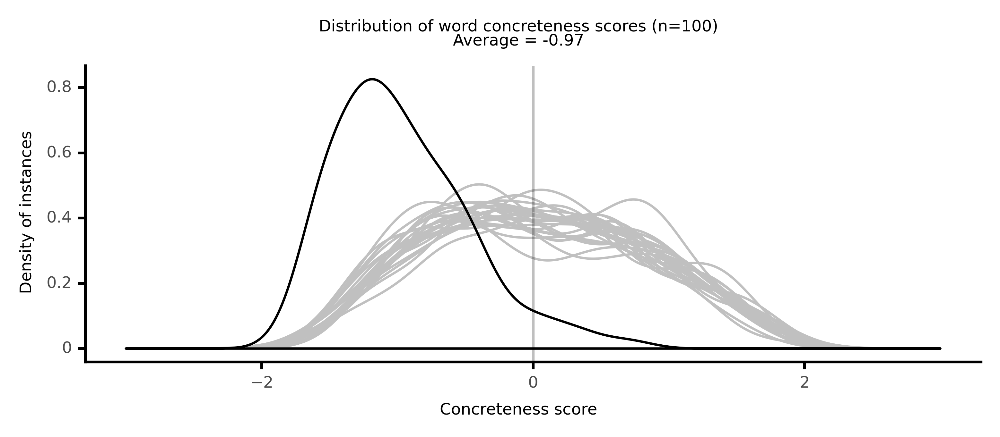

<ggplot: (8764111790961)>

 98%|█████████▊| 98/100 [21:16<00:22, 11.37s/it]

#### #99 most abstract passage: Hawkesworth, _Almoran and Hamet (1761)_ (1761)

<p>should <abs><conc157>refer</conc157></abs> it to some person of <abs><conc102>approved</conc102></abs> <abs><conc027>integrity</conc027></abs> and <abs><conc033>wisdom</conc033></abs>, and <abs><conc232>abide</conc232></abs> by his <abs><conc033>determination</conc033></abs>. Omar <neither><conc286>easily</conc286></neither> <abs><conc069>foresaw</conc069></abs>, that when the <abs><conc033>opinion</conc033></abs> of Almoran and Hamet should <abs><conc223>differ</conc223></abs>, the <abs><conc033>opinion</conc033></abs> of Almoran would be <abs><conc072>established</conc072></abs>; for there were many causes that would <abs><conc081>render</conc081></abs> Almoran <abs><conc053>inflexible</conc053></abs>, and Hamet <neither><conc403>yielding</conc403></neither>: Almoran was <abs><conc053>naturally</conc053></abs> <abs><conc058>confident</conc058></abs> and <abs><conc129>assuming</conc129></abs>, Hamet <abs><conc044>diffident</conc044></abs> and <neither><conc368>modest</conc368></neither>; Almoran was <neither><conc258>impatient</conc258></neither> of <abs><conc008>contradiction</conc008></abs>, Hamet was <abs><conc225>attentive</conc225></abs> to <abs><conc061>argument</conc061></abs>, and <abs><conc118>solicitous</conc118></abs> only for the <neither><conc274>discovery</conc274></neither> of <abs><conc065>truth</conc065></abs>. Almoran also <abs><conc112>conceived</conc112></abs>, that by the will of his father, he had <abs><conc168>suffered</conc168></abs> <abs><conc085>wrong</conc085></abs>; Hamet, that he had <neither><conc235>received</conc235></neither> a <abs><conc067>favour</conc067></abs>: Almoran, therefore, was <neither><conc350>disposed</conc350></neither> to <abs><conc102>resent</conc102></abs> the first <neither><conc430>appearance</conc430></neither> of <abs><conc003>opposition</conc003></abs>; and Hamet, on the <abs><conc057>contrary</conc057></abs>, to <abs><conc003>acquiesce</conc003></abs>, as in his <abs><conc163>share</conc163></abs> of <abs><conc027>government</conc027></abs>, whatever it might be, he had more than was his right by <abs><conc235>birth</conc235></abs>, and his brother had less. Thus, therefore, the will of Almoran would probably <abs><conc172>predominate</conc172></abs> in the state: but as the same cause which <abs><conc131>conferred</conc131></abs> this <abs><conc055>superiority</conc055></abs>, would often <neither><conc260>prevent</conc260></neither> <abs><conc160>contention</conc160></abs>, Omar <abs><conc083>considered</conc083></abs> it, upon the whole, rather as good than <abs><conc032>evil</conc032></abs>. When he had <neither><conc412>prepared</conc412></neither> his <abs><conc172>plan</conc172></abs>, therefore, he sent a <neither><conc363>copy</conc363></neither> of it, by different <abs><conc225>messengers</conc225></abs> at the same time, both to Almoran and Hamet, <conc><conc875>enclosed</conc875></conc> in a <neither><conc356>letter</conc356></neither>, in which he <abs><conc128>expressed</conc128></abs> his <abs><conc039>sense</conc039></abs> of <abs><conc041>obligation</conc041></abs> to their father, and his <abs><conc054>zeal</conc054></abs> and <abs><conc144>affection</conc144></abs> for them: he <neither><conc274>mentioned</conc274></neither> the <abs><conc156>promise</conc156></abs> he had made, to <abs><conc205>devote</conc205></abs> himself to their <abs><conc185>service</conc185></abs>; and the <abs><conc229>oath</conc229></abs> he had taken, to <abs><conc135>propose</conc135></abs> whatever he thought might <neither><conc267>facilitate</conc267></neither> the <abs><conc050>accomplishment</conc050></abs> of their father's <abs><conc162>design</conc162></abs>, with honour to them and <abs><conc063>happiness</conc063></abs> to their people: these <abs><conc008>motives</conc008></abs>, which he could not <abs><conc176>resist</conc176></abs> without <abs><conc048>impiety</conc048></abs>, he <abs><conc104>hoped</conc104></abs> would <abs><conc017>absolve</conc017></abs> him from <abs><conc017>presumption</conc017></abs>; and <abs><conc075>trusting</conc075></abs> in the <abs><conc010>rectitude</conc010></abs> of his <abs><conc049>intentions</conc049></abs>, he left the <neither><conc347>issue</conc347></neither> to God. The <neither><conc458>receipt</conc458></neither> of this <neither><conc356>letter</conc356></neither> <neither><conc699>threw</conc699></neither> Almoran into another <neither><conc432>agony</conc432></neither> of <abs><conc117>indignation</conc117></abs>: he felt again the <neither><conc241>loss</conc241></neither> of his <abs><conc084>prerogative</conc084></abs>; the <abs><conc220>offer</conc220></abs> of <abs><conc127>advice</conc127></abs> he <abs><conc051>disdained</conc051></abs> as an <abs><conc171>insult</conc171></abs>, to which he had been <abs><conc047>injuriously</conc047></abs> <abs><conc035>subjected</conc035></abs> by the will of his father; and he was <neither><conc350>disposed</conc350></neither> to <abs><conc038>reject</conc038></abs> whatever was <abs><conc059>suggested</conc059></abs> by Omar, even before his <abs><conc227>proposal</conc227></abs> was known. With this <abs><conc117>temper</conc117></abs> of mind he <neither><conc357>began</conc357></neither> to <neither><conc287>read</conc287></neither>, and at every <neither><conc256>paragraph</conc256></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

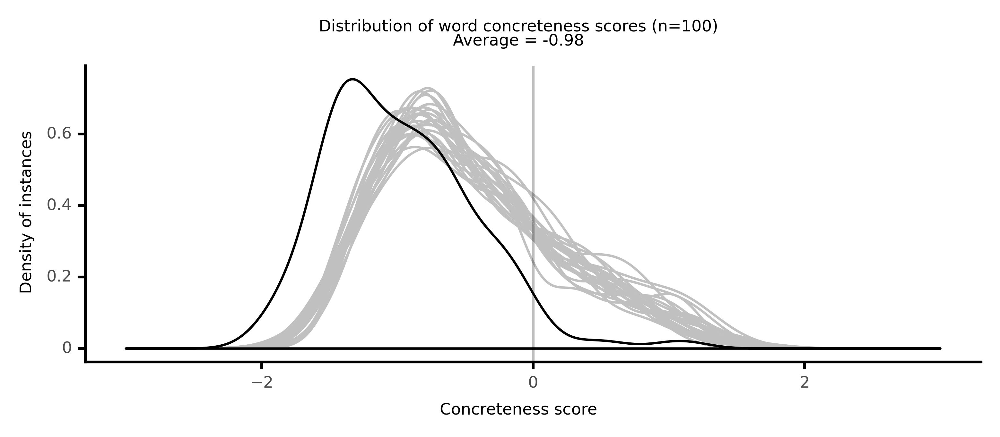

<ggplot: (8764105937645)>

 99%|█████████▉| 99/100 [21:23<00:10, 10.33s/it]

#### #100 most abstract passage: Radcliffe, _The Italian, or the Confessional of the Black Peni_ (1797)

<p>had <abs><conc131>betrayed</conc131></abs> her into <abs><conc089>imprudence</conc089></abs>, <abs><conc111>condescended</conc111></abs> to <abs><conc118>apologise</conc118></abs> for that which she <neither><conc258>termed</conc258></neither> an effect of her <abs><conc221>extreme</conc221></abs> <abs><conc188>anxiety</conc188></abs>, as to what might <abs><conc221>follow</conc221></abs> from an act of such <abs><conc139>indiscreet</conc139></abs> <abs><conc029>indulgence</conc029></abs>; and Schedoni as <abs><conc095>willingly</conc095></abs> <abs><conc172>accepted</conc172></abs> the <abs><conc141>apology</conc141></abs>, each <abs><conc065>believing</conc065></abs> the <abs><conc173>assistance</conc173></abs> of the other necessary to <abs><conc132>success</conc132></abs>. Schedoni then <neither><conc289>informed</conc289></neither> her, that he had better <abs><conc008>authority</conc008></abs> for what he had <abs><conc198>advanced</conc198></abs> than the <abs><conc038>assertion</conc038></abs> of Ellena; and he <neither><conc274>mentioned</conc274></neither> some circumstances, which <abs><conc139>proved</conc139></abs> him to be more <abs><conc190>anxious</conc190></abs> for the <abs><conc132>reputation</conc132></abs> than for the <abs><conc065>truth</conc065></abs> of his word. <abs><conc065>Believing</conc065></abs> that his <abs><conc200>origin</conc200></abs> was entirely <neither><conc241>unknown</conc241></neither> to the <abs><conc133>Marchesa</conc133></abs>, he <neither><conc267>ventured</conc267></neither> to <neither><conc355>disclose</conc355></neither> some <abs><conc206>particulars</conc206></abs> of Ellena's family, without <abs><conc188>apprehending</conc188></abs> that it could <neither><conc312>led</conc312></neither> to a <abs><conc172>suspicion</conc172></abs> of his own. The <abs><conc133>Marchesa</conc133></abs>, though neither <abs><conc104>appeased</conc104></abs> or <abs><conc049>convinced</conc049></abs>, <neither><conc239>commanded</conc239></neither> her <abs><conc096>feelings</conc096></abs> so far as to appear <neither><conc248>tranquil</conc248></neither>, while the <neither><conc306>Confessor</conc306></neither> <neither><conc292>represented</conc292></neither>, with the most <neither><conc550>delicate</conc550></neither> <abs><conc176>address</conc176></abs>, the <abs><conc088>unhappiness</conc088></abs> of her <abs><conc201>son</conc201></abs>, and the <abs><conc060>satisfaction</conc060></abs>, which must finally <abs><conc043>result</conc043></abs> to herself from an <abs><conc025>acquiescence</conc025></abs> with his <abs><conc145>choice</conc145></abs>, since the <abs><conc147>object</conc147></abs> of it was known to be <abs><conc116>worthy</conc116></abs> of his <abs><conc180>alliance</conc180></abs>. He added, that, while he had <abs><conc143>believed</conc143></abs> the <abs><conc057>contrary</conc057></abs>, he had <abs><conc139>proved</conc139></abs> himself as <abs><conc049>strenuous</conc049></abs> to <neither><conc260>prevent</conc260></neither>, as he was now sincere in <abs><conc052>approving</conc052></abs> their <neither><conc360>marriage</conc360></neither>; and <neither><conc251>concluded</conc251></neither> with <conc><conc855>gently</conc855></conc> <abs><conc040>blaming</conc040></abs> her for <abs><conc092>suffering</conc092></abs> <abs><conc028>prejudice</conc028></abs> and some <neither><conc475>remains</conc475></neither> of <abs><conc076>resentment</conc076></abs> to <abs><conc182>obscure</conc182></abs> her <neither><conc437>excellent</conc437></neither> <abs><conc056>understanding</conc056></abs>. <abs><conc075>Trusting</conc075></abs> to the <abs><conc077>natural</conc077></abs> <abs><conc180>clearness</conc180></abs> of your <abs><conc089>perceptions</conc089></abs>,'' he added, I <abs><conc097>doubt</conc097></abs> not that when you have <abs><conc091>maturely</conc091></abs> <abs><conc083>considered</conc083></abs> the <abs><conc046>subject</conc046></abs>, every <abs><conc143>objection</conc143></abs> will <neither><conc360>yield</conc360></neither> to a <abs><conc052>consideration</conc052></abs> of your <abs><conc201>son</conc201></abs>'s <abs><conc063>happiness</conc063></abs>.'' The <abs><conc180>earnestness</conc180></abs>, with which Schedoni <abs><conc096>pleaded</conc096></abs> for Vivaldi, <abs><conc112>excited</conc112></abs> some <neither><conc290>surprise</conc290></neither>; but the <abs><conc133>Marchesa</conc133></abs>, without <abs><conc175>condescending</conc175></abs> to reply either to his <abs><conc061>argument</conc061></abs> or <abs><conc099>remonstrance</conc099></abs>, <neither><conc331>inquired</conc331></neither> whither Ellena had a <abs><conc172>suspicion</conc172></abs> of the <abs><conc162>design</conc162></abs>, with which she had been <neither><conc487>carried</conc487></neither> into the <conc><conc763>forests</conc763></conc> of the Garganus, or concerning the <abs><conc096>identity</conc096></abs> of her <abs><conc074>persecutor</conc074></abs>. Schedoni, immediately <neither><conc276>perceiving</conc276></neither></p>

<style type="text/css">conc000 {display: inline-block; border: 4px solid dimgray;  }
conc001 {display: inline-block; border: 4px solid dimgray;  }
conc002 {display: inline-block; border: 4px solid dimgray;  }
conc003 {display: inline-block; border: 4px solid dimgray;  }
conc004 {display: inline-block; border: 4px solid dimgray;  }
conc005 {display: inline-block; border: 4px solid dimgray;  }
conc006 {display: inline-block; border: 4px solid dimgray;  }
conc007 {display: inline-block; border: 4px solid dimgray;  }
conc008 {display: inline-block; border: 4px solid dimgray;  }
conc009 {display: inline-block; border: 4px solid dimgray;  }
conc010 {display: inline-block; border: 4px solid dimgray;  }
conc011 {display: inline-block; border: 4px solid dimgray;  }
conc012 {display: inline-block; border: 4px solid dimgray;  }
conc013 {display: inline-block; border: 4px solid dimgray;  }
conc014 {display: inline-block; border: 4px solid dimgray;  }
conc015 {display: inline-block; border: 4px solid dimgray;  }
conc016 {display: inline-block; border: 4px solid dimgray;  }
conc017 {display: inline-block; border: 4px solid dimgray;  }
conc018 {display: inline-block; border: 4px solid dimgray;  }
conc019 {display: inline-block; border: 4px solid dimgray;  }
conc020 {display: inline-block; border: 4px solid dimgray;  }
conc021 {display: inline-block; border: 4px solid dimgray;  }
conc022 {display: inline-block; border: 4px solid dimgray;  }
conc023 {display: inline-block; border: 4px solid dimgray;  }
conc024 {display: inline-block; border: 4px solid dimgray;  }
conc025 {display: inline-block; border: 4px solid dimgray;  }
conc026 {display: inline-block; border: 4px solid dimgray;  }
conc027 {display: inline-block; border: 4px solid dimgray;  }
conc028 {display: inline-block; border: 4px solid dimgray;  }
conc029 {display: inline-block; border: 4px solid dimgray;  }
conc030 {display: inline-block; border: 4px solid dimgray;  }
conc031 {display: inline-block; border: 4px solid dimgray;  }
conc032 {display: inline-block; border: 4px solid dimgray;  }
conc033 {display: inline-block; border: 4px solid dimgray;  }
conc034 {display: inline-block; border: 4px solid dimgray;  }
conc035 {display: inline-block; border: 4px solid dimgray;  }
conc036 {display: inline-block; border: 4px solid dimgray;  }
conc037 {display: inline-block; border: 4px solid dimgray;  }
conc038 {display: inline-block; border: 4px solid dimgray;  }
conc039 {display: inline-block; border: 4px solid dimgray;  }
conc040 {display: inline-block; border: 4px solid dimgray;  }
conc041 {display: inline-block; border: 4px solid dimgray;  }
conc042 {display: inline-block; border: 4px solid dimgray;  }
conc043 {display: inline-block; border: 4px solid dimgray;  }
conc044 {display: inline-block; border: 4px solid dimgray;  }
conc045 {display: inline-block; border: 4px solid dimgray;  }
conc046 {display: inline-block; border: 4px solid dimgray;  }
conc047 {display: inline-block; border: 4px solid dimgray;  }
conc048 {display: inline-block; border: 4px solid dimgray;  }
conc049 {display: inline-block; border: 4px solid dimgray;  }
conc050 {display: inline-block; border: 4px solid dimgray;  }
conc051 {display: inline-block; border: 4px solid dimgray;  }
conc052 {display: inline-block; border: 4px solid dimgray;  }
conc053 {display: inline-block; border: 4px solid dimgray;  }
conc054 {display: inline-block; border: 4px solid dimgray;  }
conc055 {display: inline-block; border: 4px solid dimgray;  }
conc056 {display: inline-block; border: 4px solid dimgray;  }
conc057 {display: inline-block; border: 4px solid dimgray;  }
conc058 {display: inline-block; border: 4px solid dimgray;  }
conc059 {display: inline-block; border: 4px solid dimgray;  }
conc060 {display: inline-block; border: 4px solid dimgray;  }
conc061 {display: inline-block; border: 4px solid dimgray;  }
conc062 {display: inline-block; border: 4px solid dimgray;  }
conc063 {display: inline-block; border: 3px solid dimgray;  }
conc064 {display: inline-block; border: 3px solid dimgray;  }
conc065 {display: inline-block; border: 3px solid dimgray;  }
conc066 {display: inline-block; border: 3px solid dimgray;  }
conc067 {display: inline-block; border: 3px solid dimgray;  }
conc068 {display: inline-block; border: 3px solid dimgray;  }
conc069 {display: inline-block; border: 3px solid dimgray;  }
conc070 {display: inline-block; border: 3px solid dimgray;  }
conc071 {display: inline-block; border: 3px solid dimgray;  }
conc072 {display: inline-block; border: 3px solid dimgray;  }
conc073 {display: inline-block; border: 3px solid dimgray;  }
conc074 {display: inline-block; border: 3px solid dimgray;  }
conc075 {display: inline-block; border: 3px solid dimgray;  }
conc076 {display: inline-block; border: 3px solid dimgray;  }
conc077 {display: inline-block; border: 3px solid dimgray;  }
conc078 {display: inline-block; border: 3px solid dimgray;  }
conc079 {display: inline-block; border: 3px solid dimgray;  }
conc080 {display: inline-block; border: 3px solid dimgray;  }
conc081 {display: inline-block; border: 3px solid dimgray;  }
conc082 {display: inline-block; border: 3px solid dimgray;  }
conc083 {display: inline-block; border: 3px solid dimgray;  }
conc084 {display: inline-block; border: 3px solid dimgray;  }
conc085 {display: inline-block; border: 3px solid dimgray;  }
conc086 {display: inline-block; border: 3px solid dimgray;  }
conc087 {display: inline-block; border: 3px solid dimgray;  }
conc088 {display: inline-block; border: 3px solid dimgray;  }
conc089 {display: inline-block; border: 3px solid dimgray;  }
conc090 {display: inline-block; border: 3px solid dimgray;  }
conc091 {display: inline-block; border: 3px solid dimgray;  }
conc092 {display: inline-block; border: 3px solid dimgray;  }
conc093 {display: inline-block; border: 3px solid dimgray;  }
conc094 {display: inline-block; border: 3px solid dimgray;  }
conc095 {display: inline-block; border: 3px solid dimgray;  }
conc096 {display: inline-block; border: 3px solid dimgray;  }
conc097 {display: inline-block; border: 3px solid dimgray;  }
conc098 {display: inline-block; border: 3px solid dimgray;  }
conc099 {display: inline-block; border: 3px solid dimgray;  }
conc100 {display: inline-block; border: 3px solid dimgray;  }
conc101 {display: inline-block; border: 3px solid dimgray;  }
conc102 {display: inline-block; border: 3px solid dimgray;  }
conc103 {display: inline-block; border: 3px solid dimgray;  }
conc104 {display: inline-block; border: 3px solid dimgray;  }
conc105 {display: inline-block; border: 3px solid dimgray;  }
conc106 {display: inline-block; border: 3px solid dimgray;  }
conc107 {display: inline-block; border: 3px solid dimgray;  }
conc108 {display: inline-block; border: 3px solid dimgray;  }
conc109 {display: inline-block; border: 3px solid dimgray;  }
conc110 {display: inline-block; border: 3px solid dimgray;  }
conc111 {display: inline-block; border: 3px solid dimgray;  }
conc112 {display: inline-block; border: 3px solid dimgray;  }
conc113 {display: inline-block; border: 3px solid dimgray;  }
conc114 {display: inline-block; border: 3px solid dimgray;  }
conc115 {display: inline-block; border: 3px solid dimgray;  }
conc116 {display: inline-block; border: 3px solid dimgray;  }
conc117 {display: inline-block; border: 3px solid dimgray;  }
conc118 {display: inline-block; border: 3px solid dimgray;  }
conc119 {display: inline-block; border: 3px solid dimgray;  }
conc120 {display: inline-block; border: 3px solid dimgray;  }
conc121 {display: inline-block; border: 3px solid dimgray;  }
conc122 {display: inline-block; border: 3px solid dimgray;  }
conc123 {display: inline-block; border: 3px solid dimgray;  }
conc124 {display: inline-block; border: 3px solid dimgray;  }
conc125 {display: inline-block; border: 3px solid dimgray;  }
conc126 {display: inline-block; border: 3px solid dimgray;  }
conc127 {display: inline-block; border: 3px solid dimgray;  }
conc128 {display: inline-block; border: 3px solid dimgray;  }
conc129 {display: inline-block; border: 3px solid dimgray;  }
conc130 {display: inline-block; border: 3px solid dimgray;  }
conc131 {display: inline-block; border: 3px solid dimgray;  }
conc132 {display: inline-block; border: 3px solid dimgray;  }
conc133 {display: inline-block; border: 3px solid dimgray;  }
conc134 {display: inline-block; border: 3px solid dimgray;  }
conc135 {display: inline-block; border: 3px solid dimgray;  }
conc136 {display: inline-block; border: 3px solid dimgray;  }
conc137 {display: inline-block; border: 3px solid dimgray;  }
conc138 {display: inline-block; border: 3px solid dimgray;  }
conc139 {display: inline-block; border: 3px solid dimgray;  }
conc140 {display: inline-block; border: 3px solid dimgray;  }
conc141 {display: inline-block; border: 3px solid dimgray;  }
conc142 {display: inline-block; border: 3px solid dimgray;  }
conc143 {display: inline-block; border: 3px solid dimgray;  }
conc144 {display: inline-block; border: 3px solid dimgray;  }
conc145 {display: inline-block; border: 3px solid dimgray;  }
conc146 {display: inline-block; border: 3px solid dimgray;  }
conc147 {display: inline-block; border: 3px solid dimgray;  }
conc148 {display: inline-block; border: 3px solid dimgray;  }
conc149 {display: inline-block; border: 3px solid dimgray;  }
conc150 {display: inline-block; border: 3px solid dimgray;  }
conc151 {display: inline-block; border: 3px solid dimgray;  }
conc152 {display: inline-block; border: 3px solid dimgray;  }
conc153 {display: inline-block; border: 3px solid dimgray;  }
conc154 {display: inline-block; border: 3px solid dimgray;  }
conc155 {display: inline-block; border: 3px solid dimgray;  }
conc156 {display: inline-block; border: 3px solid dimgray;  }
conc157 {display: inline-block; border: 3px solid dimgray;  }
conc158 {display: inline-block; border: 3px solid dimgray;  }
conc159 {display: inline-block; border: 3px solid dimgray;  }
conc160 {display: inline-block; border: 3px solid dimgray;  }
conc161 {display: inline-block; border: 3px solid dimgray;  }
conc162 {display: inline-block; border: 3px solid dimgray;  }
conc163 {display: inline-block; border: 3px solid dimgray;  }
conc164 {display: inline-block; border: 3px solid dimgray;  }
conc165 {display: inline-block; border: 3px solid dimgray;  }
conc166 {display: inline-block; border: 3px solid dimgray;  }
conc167 {display: inline-block; border: 3px solid dimgray;  }
conc168 {display: inline-block; border: 3px solid dimgray;  }
conc169 {display: inline-block; border: 3px solid dimgray;  }
conc170 {display: inline-block; border: 3px solid dimgray;  }
conc171 {display: inline-block; border: 3px solid dimgray;  }
conc172 {display: inline-block; border: 3px solid dimgray;  }
conc173 {display: inline-block; border: 3px solid dimgray;  }
conc174 {display: inline-block; border: 3px solid dimgray;  }
conc175 {display: inline-block; border: 3px solid dimgray;  }
conc176 {display: inline-block; border: 3px solid dimgray;  }
conc177 {display: inline-block; border: 3px solid dimgray;  }
conc178 {display: inline-block; border: 3px solid dimgray;  }
conc179 {display: inline-block; border: 3px solid dimgray;  }
conc180 {display: inline-block; border: 3px solid dimgray;  }
conc181 {display: inline-block; border: 3px solid dimgray;  }
conc182 {display: inline-block; border: 3px solid dimgray;  }
conc183 {display: inline-block; border: 3px solid dimgray;  }
conc184 {display: inline-block; border: 3px solid dimgray;  }
conc185 {display: inline-block; border: 3px solid dimgray;  }
conc186 {display: inline-block; border: 3px solid dimgray;  }
conc187 {display: inline-block; border: 3px solid dimgray;  }
conc188 {display: inline-block; border: 2px solid dimgray;  }
conc189 {display: inline-block; border: 2px solid dimgray;  }
conc190 {display: inline-block; border: 2px solid dimgray;  }
conc191 {display: inline-block; border: 2px solid dimgray;  }
conc192 {display: inline-block; border: 2px solid dimgray;  }
conc193 {display: inline-block; border: 2px solid dimgray;  }
conc194 {display: inline-block; border: 2px solid dimgray;  }
conc195 {display: inline-block; border: 2px solid dimgray;  }
conc196 {display: inline-block; border: 2px solid dimgray;  }
conc197 {display: inline-block; border: 2px solid dimgray;  }
conc198 {display: inline-block; border: 2px solid dimgray;  }
conc199 {display: inline-block; border: 2px solid dimgray;  }
conc200 {display: inline-block; border: 2px solid dimgray;  }
conc201 {display: inline-block; border: 2px solid dimgray;  }
conc202 {display: inline-block; border: 2px solid dimgray;  }
conc203 {display: inline-block; border: 2px solid dimgray;  }
conc204 {display: inline-block; border: 2px solid dimgray;  }
conc205 {display: inline-block; border: 2px solid dimgray;  }
conc206 {display: inline-block; border: 2px solid dimgray;  }
conc207 {display: inline-block; border: 2px solid dimgray;  }
conc208 {display: inline-block; border: 2px solid dimgray;  }
conc209 {display: inline-block; border: 2px solid dimgray;  }
conc210 {display: inline-block; border: 2px solid dimgray;  }
conc211 {display: inline-block; border: 2px solid dimgray;  }
conc212 {display: inline-block; border: 2px solid dimgray;  }
conc213 {display: inline-block; border: 2px solid dimgray;  }
conc214 {display: inline-block; border: 2px solid dimgray;  }
conc215 {display: inline-block; border: 2px solid dimgray;  }
conc216 {display: inline-block; border: 2px solid dimgray;  }
conc217 {display: inline-block; border: 2px solid dimgray;  }
conc218 {display: inline-block; border: 2px solid dimgray;  }
conc219 {display: inline-block; border: 2px solid dimgray;  }
conc220 {display: inline-block; border: 2px solid dimgray;  }
conc221 {display: inline-block; border: 2px solid dimgray;  }
conc222 {display: inline-block; border: 2px solid dimgray;  }
conc223 {display: inline-block; border: 2px solid dimgray;  }
conc224 {display: inline-block; border: 2px solid dimgray;  }
conc225 {display: inline-block; border: 2px solid dimgray;  }
conc226 {display: inline-block; border: 2px solid dimgray;  }
conc227 {display: inline-block; border: 2px solid dimgray;  }
conc228 {display: inline-block; border: 2px solid dimgray;  }
conc229 {display: inline-block; border: 2px solid dimgray;  }
conc230 {display: inline-block; border: 2px solid dimgray;  }
conc231 {display: inline-block; border: 2px solid dimgray;  }
conc232 {display: inline-block; border: 2px solid dimgray;  }
conc233 {display: inline-block; border: 2px solid dimgray;  }
conc234 {display: inline-block; border: 2px solid dimgray;  }
conc235 {display: inline-block; border: 2px solid dimgray;  }
conc236 {display: inline-block; border: 2px solid dimgray;  }
conc237 {display: inline-block; border: 2px solid dimgray;  }
conc238 {display: inline-block; border: 2px solid dimgray;  }
conc239 {display: inline-block; border: 2px solid dimgray;  }
conc240 {display: inline-block; border: 2px solid dimgray;  }
conc241 {display: inline-block; border: 2px solid dimgray;  }
conc242 {display: inline-block; border: 2px solid dimgray;  }
conc243 {display: inline-block; border: 2px solid dimgray;  }
conc244 {display: inline-block; border: 2px solid dimgray;  }
conc245 {display: inline-block; border: 2px solid dimgray;  }
conc246 {display: inline-block; border: 2px solid dimgray;  }
conc247 {display: inline-block; border: 2px solid dimgray;  }
conc248 {display: inline-block; border: 2px solid dimgray;  }
conc249 {display: inline-block; border: 2px solid dimgray;  }
conc250 {display: inline-block; border: 2px solid dimgray;  }
conc251 {display: inline-block; border: 2px solid dimgray;  }
conc252 {display: inline-block; border: 2px solid dimgray;  }
conc253 {display: inline-block; border: 2px solid dimgray;  }
conc254 {display: inline-block; border: 2px solid dimgray;  }
conc255 {display: inline-block; border: 2px solid dimgray;  }
conc256 {display: inline-block; border: 2px solid dimgray;  }
conc257 {display: inline-block; border: 2px solid dimgray;  }
conc258 {display: inline-block; border: 2px solid dimgray;  }
conc259 {display: inline-block; border: 2px solid dimgray;  }
conc260 {display: inline-block; border: 2px solid dimgray;  }
conc261 {display: inline-block; border: 2px solid dimgray;  }
conc262 {display: inline-block; border: 2px solid dimgray;  }
conc263 {display: inline-block; border: 2px solid dimgray;  }
conc264 {display: inline-block; border: 2px solid dimgray;  }
conc265 {display: inline-block; border: 2px solid dimgray;  }
conc266 {display: inline-block; border: 2px solid dimgray;  }
conc267 {display: inline-block; border: 2px solid dimgray;  }
conc268 {display: inline-block; border: 2px solid dimgray;  }
conc269 {display: inline-block; border: 2px solid dimgray;  }
conc270 {display: inline-block; border: 2px solid dimgray;  }
conc271 {display: inline-block; border: 2px solid dimgray;  }
conc272 {display: inline-block; border: 2px solid dimgray;  }
conc273 {display: inline-block; border: 2px solid dimgray;  }
conc274 {display: inline-block; border: 2px solid dimgray;  }
conc275 {display: inline-block; border: 2px solid dimgray;  }
conc276 {display: inline-block; border: 2px solid dimgray;  }
conc277 {display: inline-block; border: 2px solid dimgray;  }
conc278 {display: inline-block; border: 2px solid dimgray;  }
conc279 {display: inline-block; border: 2px solid dimgray;  }
conc280 {display: inline-block; border: 2px solid dimgray;  }
conc281 {display: inline-block; border: 2px solid dimgray;  }
conc282 {display: inline-block; border: 2px solid dimgray;  }
conc283 {display: inline-block; border: 2px solid dimgray;  }
conc284 {display: inline-block; border: 2px solid dimgray;  }
conc285 {display: inline-block; border: 2px solid dimgray;  }
conc286 {display: inline-block; border: 2px solid dimgray;  }
conc287 {display: inline-block; border: 2px solid dimgray;  }
conc288 {display: inline-block; border: 2px solid dimgray;  }
conc289 {display: inline-block; border: 2px solid dimgray;  }
conc290 {display: inline-block; border: 2px solid dimgray;  }
conc291 {display: inline-block; border: 2px solid dimgray;  }
conc292 {display: inline-block; border: 2px solid dimgray;  }
conc293 {display: inline-block; border: 2px solid dimgray;  }
conc294 {display: inline-block; border: 2px solid dimgray;  }
conc295 {display: inline-block; border: 2px solid dimgray;  }
conc296 {display: inline-block; border: 2px solid dimgray;  }
conc297 {display: inline-block; border: 2px solid dimgray;  }
conc298 {display: inline-block; border: 2px solid dimgray;  }
conc299 {display: inline-block; border: 2px solid dimgray;  }
conc300 {display: inline-block; border: 2px solid dimgray;  }
conc301 {display: inline-block; border: 2px solid dimgray;  }
conc302 {display: inline-block; border: 2px solid dimgray;  }
conc303 {display: inline-block; border: 2px solid dimgray;  }
conc304 {display: inline-block; border: 2px solid dimgray;  }
conc305 {display: inline-block; border: 2px solid dimgray;  }
conc306 {display: inline-block; border: 2px solid dimgray;  }
conc307 {display: inline-block; border: 2px solid dimgray;  }
conc308 {display: inline-block; border: 2px solid dimgray;  }
conc309 {display: inline-block; border: 2px solid dimgray;  }
conc310 {display: inline-block; border: 2px solid dimgray;  }
conc311 {display: inline-block; border: 2px solid dimgray;  }
conc312 {display: inline-block; border: 2px solid dimgray;  }
conc313 {display: inline-block; border: 1px solid dimgray;  }
conc314 {display: inline-block; border: 1px solid dimgray;  }
conc315 {display: inline-block; border: 1px solid dimgray;  }
conc316 {display: inline-block; border: 1px solid dimgray;  }
conc317 {display: inline-block; border: 1px solid dimgray;  }
conc318 {display: inline-block; border: 1px solid dimgray;  }
conc319 {display: inline-block; border: 1px solid dimgray;  }
conc320 {display: inline-block; border: 1px solid dimgray;  }
conc321 {display: inline-block; border: 1px solid dimgray;  }
conc322 {display: inline-block; border: 1px solid dimgray;  }
conc323 {display: inline-block; border: 1px solid dimgray;  }
conc324 {display: inline-block; border: 1px solid dimgray;  }
conc325 {display: inline-block; border: 1px solid dimgray;  }
conc326 {display: inline-block; border: 1px solid dimgray;  }
conc327 {display: inline-block; border: 1px solid dimgray;  }
conc328 {display: inline-block; border: 1px solid dimgray;  }
conc329 {display: inline-block; border: 1px solid dimgray;  }
conc330 {display: inline-block; border: 1px solid dimgray;  }
conc331 {display: inline-block; border: 1px solid dimgray;  }
conc332 {display: inline-block; border: 1px solid dimgray;  }
conc333 {display: inline-block; border: 1px solid dimgray;  }
conc334 {display: inline-block; border: 1px solid dimgray;  }
conc335 {display: inline-block; border: 1px solid dimgray;  }
conc336 {display: inline-block; border: 1px solid dimgray;  }
conc337 {display: inline-block; border: 1px solid dimgray;  }
conc338 {display: inline-block; border: 1px solid dimgray;  }
conc339 {display: inline-block; border: 1px solid dimgray;  }
conc340 {display: inline-block; border: 1px solid dimgray;  }
conc341 {display: inline-block; border: 1px solid dimgray;  }
conc342 {display: inline-block; border: 1px solid dimgray;  }
conc343 {display: inline-block; border: 1px solid dimgray;  }
conc344 {display: inline-block; border: 1px solid dimgray;  }
conc345 {display: inline-block; border: 1px solid dimgray;  }
conc346 {display: inline-block; border: 1px solid dimgray;  }
conc347 {display: inline-block; border: 1px solid dimgray;  }
conc348 {display: inline-block; border: 1px solid dimgray;  }
conc349 {display: inline-block; border: 1px solid dimgray;  }
conc350 {display: inline-block; border: 1px solid dimgray;  }
conc351 {display: inline-block; border: 1px solid dimgray;  }
conc352 {display: inline-block; border: 1px solid dimgray;  }
conc353 {display: inline-block; border: 1px solid dimgray;  }
conc354 {display: inline-block; border: 1px solid dimgray;  }
conc355 {display: inline-block; border: 1px solid dimgray;  }
conc356 {display: inline-block; border: 1px solid dimgray;  }
conc357 {display: inline-block; border: 1px solid dimgray;  }
conc358 {display: inline-block; border: 1px solid dimgray;  }
conc359 {display: inline-block; border: 1px solid dimgray;  }
conc360 {display: inline-block; border: 1px solid dimgray;  }
conc361 {display: inline-block; border: 1px solid dimgray;  }
conc362 {display: inline-block; border: 1px solid dimgray;  }
conc363 {display: inline-block; border: 1px solid dimgray;  }
conc364 {display: inline-block; border: 1px solid dimgray;  }
conc365 {display: inline-block; border: 1px solid dimgray;  }
conc366 {display: inline-block; border: 1px solid dimgray;  }
conc367 {display: inline-block; border: 1px solid dimgray;  }
conc368 {display: inline-block; border: 1px solid dimgray;  }
conc369 {display: inline-block; border: 1px solid dimgray;  }
conc370 {display: inline-block; border: 1px solid dimgray;  }
conc371 {display: inline-block; border: 1px solid dimgray;  }
conc372 {display: inline-block; border: 1px solid dimgray;  }
conc373 {display: inline-block; border: 1px solid dimgray;  }
conc374 {display: inline-block; border: 1px solid dimgray;  }
conc375 {display: inline-block; border: 1px solid dimgray;  }
conc376 {display: inline-block; border: 1px solid dimgray;  }
conc377 {display: inline-block; border: 1px solid dimgray;  }
conc378 {display: inline-block; border: 1px solid dimgray;  }
conc379 {display: inline-block; border: 1px solid dimgray;  }
conc380 {display: inline-block; border: 1px solid dimgray;  }
conc381 {display: inline-block; border: 1px solid dimgray;  }
conc382 {display: inline-block; border: 1px solid dimgray;  }
conc383 {display: inline-block; border: 1px solid dimgray;  }
conc384 {display: inline-block; border: 1px solid dimgray;  }
conc385 {display: inline-block; border: 1px solid dimgray;  }
conc386 {display: inline-block; border: 1px solid dimgray;  }
conc387 {display: inline-block; border: 1px solid dimgray;  }
conc388 {display: inline-block; border: 1px solid dimgray;  }
conc389 {display: inline-block; border: 1px solid dimgray;  }
conc390 {display: inline-block; border: 1px solid dimgray;  }
conc391 {display: inline-block; border: 1px solid dimgray;  }
conc392 {display: inline-block; border: 1px solid dimgray;  }
conc393 {display: inline-block; border: 1px solid dimgray;  }
conc394 {display: inline-block; border: 1px solid dimgray;  }
conc395 {display: inline-block; border: 1px solid dimgray;  }
conc396 {display: inline-block; border: 1px solid dimgray;  }
conc397 {display: inline-block; border: 1px solid dimgray;  }
conc398 {display: inline-block; border: 1px solid dimgray;  }
conc399 {display: inline-block; border: 1px solid dimgray;  }
conc400 {display: inline-block; border: 1px solid dimgray;  }
conc401 {display: inline-block; border: 1px solid dimgray;  }
conc402 {display: inline-block; border: 1px solid dimgray;  }
conc403 {display: inline-block; border: 1px solid dimgray;  }
conc404 {display: inline-block; border: 1px solid dimgray;  }
conc405 {display: inline-block; border: 1px solid dimgray;  }
conc406 {display: inline-block; border: 1px solid dimgray;  }
conc407 {display: inline-block; border: 1px solid dimgray;  }
conc408 {display: inline-block; border: 1px solid dimgray;  }
conc409 {display: inline-block; border: 1px solid dimgray;  }
conc410 {display: inline-block; border: 1px solid dimgray;  }
conc411 {display: inline-block; border: 1px solid dimgray;  }
conc412 {display: inline-block; border: 1px solid dimgray;  }
conc413 {display: inline-block; border: 1px solid dimgray;  }
conc414 {display: inline-block; border: 1px solid dimgray;  }
conc415 {display: inline-block; border: 1px solid dimgray;  }
conc416 {display: inline-block; border: 1px solid dimgray;  }
conc417 {display: inline-block; border: 1px solid dimgray;  }
conc418 {display: inline-block; border: 1px solid dimgray;  }
conc419 {display: inline-block; border: 1px solid dimgray;  }
conc420 {display: inline-block; border: 1px solid dimgray;  }
conc421 {display: inline-block; border: 1px solid dimgray;  }
conc422 {display: inline-block; border: 1px solid dimgray;  }
conc423 {display: inline-block; border: 1px solid dimgray;  }
conc424 {display: inline-block; border: 1px solid dimgray;  }
conc425 {display: inline-block; border: 1px solid dimgray;  }
conc426 {display: inline-block; border: 1px solid dimgray;  }
conc427 {display: inline-block; border: 1px solid dimgray;  }
conc428 {display: inline-block; border: 1px solid dimgray;  }
conc429 {display: inline-block; border: 1px solid dimgray;  }
conc430 {display: inline-block; border: 1px solid dimgray;  }
conc431 {display: inline-block; border: 1px solid dimgray;  }
conc432 {display: inline-block; border: 1px solid dimgray;  }
conc433 {display: inline-block; border: 1px solid dimgray;  }
conc434 {display: inline-block; border: 1px solid dimgray;  }
conc435 {display: inline-block; border: 1px solid dimgray;  }
conc436 {display: inline-block; border: 1px solid dimgray;  }
conc437 {display: inline-block; border: 1px solid dimgray;  }
conc438 {display: inline-block; border: 0px solid dimgray;  }
conc439 {display: inline-block; border: 0px solid dimgray;  }
conc440 {display: inline-block; border: 0px solid dimgray;  }
conc441 {display: inline-block; border: 0px solid dimgray;  }
conc442 {display: inline-block; border: 0px solid dimgray;  }
conc443 {display: inline-block; border: 0px solid dimgray;  }
conc444 {display: inline-block; border: 0px solid dimgray;  }
conc445 {display: inline-block; border: 0px solid dimgray;  }
conc446 {display: inline-block; border: 0px solid dimgray;  }
conc447 {display: inline-block; border: 0px solid dimgray;  }
conc448 {display: inline-block; border: 0px solid dimgray;  }
conc449 {display: inline-block; border: 0px solid dimgray;  }
conc450 {display: inline-block; border: 0px solid dimgray;  }
conc451 {display: inline-block; border: 0px solid dimgray;  }
conc452 {display: inline-block; border: 0px solid dimgray;  }
conc453 {display: inline-block; border: 0px solid dimgray;  }
conc454 {display: inline-block; border: 0px solid dimgray;  }
conc455 {display: inline-block; border: 0px solid dimgray;  }
conc456 {display: inline-block; border: 0px solid dimgray;  }
conc457 {display: inline-block; border: 0px solid dimgray;  }
conc458 {display: inline-block; border: 0px solid dimgray;  }
conc459 {display: inline-block; border: 0px solid dimgray;  }
conc460 {display: inline-block; border: 0px solid dimgray;  }
conc461 {display: inline-block; border: 0px solid dimgray;  }
conc462 {display: inline-block; border: 0px solid dimgray;  }
conc463 {display: inline-block; border: 0px solid dimgray;  }
conc464 {display: inline-block; border: 0px solid dimgray;  }
conc465 {display: inline-block; border: 0px solid dimgray;  }
conc466 {display: inline-block; border: 0px solid dimgray;  }
conc467 {display: inline-block; border: 0px solid dimgray;  }
conc468 {display: inline-block; border: 0px solid dimgray;  }
conc469 {display: inline-block; border: 0px solid dimgray;  }
conc470 {display: inline-block; border: 0px solid dimgray;  }
conc471 {display: inline-block; border: 0px solid dimgray;  }
conc472 {display: inline-block; border: 0px solid dimgray;  }
conc473 {display: inline-block; border: 0px solid dimgray;  }
conc474 {display: inline-block; border: 0px solid dimgray;  }
conc475 {display: inline-block; border: 0px solid dimgray;  }
conc476 {display: inline-block; border: 0px solid dimgray;  }
conc477 {display: inline-block; border: 0px solid dimgray;  }
conc478 {display: inline-block; border: 0px solid dimgray;  }
conc479 {display: inline-block; border: 0px solid dimgray;  }
conc480 {display: inline-block; border: 0px solid dimgray;  }
conc481 {display: inline-block; border: 0px solid dimgray;  }
conc482 {display: inline-block; border: 0px solid dimgray;  }
conc483 {display: inline-block; border: 0px solid dimgray;  }
conc484 {display: inline-block; border: 0px solid dimgray;  }
conc485 {display: inline-block; border: 0px solid dimgray;  }
conc486 {display: inline-block; border: 0px solid dimgray;  }
conc487 {display: inline-block; border: 0px solid dimgray;  }
conc488 {display: inline-block; border: 0px solid dimgray;  }
conc489 {display: inline-block; border: 0px solid dimgray;  }
conc490 {display: inline-block; border: 0px solid dimgray;  }
conc491 {display: inline-block; border: 0px solid dimgray;  }
conc492 {display: inline-block; border: 0px solid dimgray;  }
conc493 {display: inline-block; border: 0px solid dimgray;  }
conc494 {display: inline-block; border: 0px solid dimgray;  }
conc495 {display: inline-block; border: 0px solid dimgray;  }
conc496 {display: inline-block; border: 0px solid dimgray;  }
conc497 {display: inline-block; border: 0px solid dimgray;  }
conc498 {display: inline-block; border: 0px solid dimgray;  }
conc499 {display: inline-block; border: 0px solid dimgray;  }
conc500 {display: inline-block; font-weight: 1 }
conc501 {display: inline-block; font-weight: 3 }
conc502 {display: inline-block; font-weight: 5 }
conc503 {display: inline-block; font-weight: 7 }
conc504 {display: inline-block; font-weight: 9 }
conc505 {display: inline-block; font-weight: 11 }
conc506 {display: inline-block; font-weight: 13 }
conc507 {display: inline-block; font-weight: 15 }
conc508 {display: inline-block; font-weight: 17 }
conc509 {display: inline-block; font-weight: 19 }
conc510 {display: inline-block; font-weight: 21 }
conc511 {display: inline-block; font-weight: 23 }
conc512 {display: inline-block; font-weight: 25 }
conc513 {display: inline-block; font-weight: 27 }
conc514 {display: inline-block; font-weight: 29 }
conc515 {display: inline-block; font-weight: 31 }
conc516 {display: inline-block; font-weight: 33 }
conc517 {display: inline-block; font-weight: 35 }
conc518 {display: inline-block; font-weight: 37 }
conc519 {display: inline-block; font-weight: 39 }
conc520 {display: inline-block; font-weight: 41 }
conc521 {display: inline-block; font-weight: 43 }
conc522 {display: inline-block; font-weight: 45 }
conc523 {display: inline-block; font-weight: 47 }
conc524 {display: inline-block; font-weight: 49 }
conc525 {display: inline-block; font-weight: 51 }
conc526 {display: inline-block; font-weight: 53 }
conc527 {display: inline-block; font-weight: 55 }
conc528 {display: inline-block; font-weight: 57 }
conc529 {display: inline-block; font-weight: 59 }
conc530 {display: inline-block; font-weight: 61 }
conc531 {display: inline-block; font-weight: 63 }
conc532 {display: inline-block; font-weight: 65 }
conc533 {display: inline-block; font-weight: 67 }
conc534 {display: inline-block; font-weight: 69 }
conc535 {display: inline-block; font-weight: 71 }
conc536 {display: inline-block; font-weight: 73 }
conc537 {display: inline-block; font-weight: 75 }
conc538 {display: inline-block; font-weight: 77 }
conc539 {display: inline-block; font-weight: 79 }
conc540 {display: inline-block; font-weight: 81 }
conc541 {display: inline-block; font-weight: 83 }
conc542 {display: inline-block; font-weight: 85 }
conc543 {display: inline-block; font-weight: 87 }
conc544 {display: inline-block; font-weight: 89 }
conc545 {display: inline-block; font-weight: 91 }
conc546 {display: inline-block; font-weight: 93 }
conc547 {display: inline-block; font-weight: 95 }
conc548 {display: inline-block; font-weight: 97 }
conc549 {display: inline-block; font-weight: 99 }
conc550 {display: inline-block; font-weight: 101 }
conc551 {display: inline-block; font-weight: 103 }
conc552 {display: inline-block; font-weight: 105 }
conc553 {display: inline-block; font-weight: 107 }
conc554 {display: inline-block; font-weight: 109 }
conc555 {display: inline-block; font-weight: 111 }
conc556 {display: inline-block; font-weight: 113 }
conc557 {display: inline-block; font-weight: 115 }
conc558 {display: inline-block; font-weight: 117 }
conc559 {display: inline-block; font-weight: 119 }
conc560 {display: inline-block; font-weight: 121 }
conc561 {display: inline-block; font-weight: 123 }
conc562 {display: inline-block; font-weight: 125 }
conc563 {display: inline-block; font-weight: 127 }
conc564 {display: inline-block; font-weight: 129 }
conc565 {display: inline-block; font-weight: 131 }
conc566 {display: inline-block; font-weight: 133 }
conc567 {display: inline-block; font-weight: 135 }
conc568 {display: inline-block; font-weight: 137 }
conc569 {display: inline-block; font-weight: 139 }
conc570 {display: inline-block; font-weight: 141 }
conc571 {display: inline-block; font-weight: 143 }
conc572 {display: inline-block; font-weight: 145 }
conc573 {display: inline-block; font-weight: 147 }
conc574 {display: inline-block; font-weight: 149 }
conc575 {display: inline-block; font-weight: 151 }
conc576 {display: inline-block; font-weight: 153 }
conc577 {display: inline-block; font-weight: 155 }
conc578 {display: inline-block; font-weight: 157 }
conc579 {display: inline-block; font-weight: 159 }
conc580 {display: inline-block; font-weight: 161 }
conc581 {display: inline-block; font-weight: 163 }
conc582 {display: inline-block; font-weight: 165 }
conc583 {display: inline-block; font-weight: 167 }
conc584 {display: inline-block; font-weight: 169 }
conc585 {display: inline-block; font-weight: 171 }
conc586 {display: inline-block; font-weight: 173 }
conc587 {display: inline-block; font-weight: 175 }
conc588 {display: inline-block; font-weight: 177 }
conc589 {display: inline-block; font-weight: 179 }
conc590 {display: inline-block; font-weight: 181 }
conc591 {display: inline-block; font-weight: 183 }
conc592 {display: inline-block; font-weight: 185 }
conc593 {display: inline-block; font-weight: 187 }
conc594 {display: inline-block; font-weight: 189 }
conc595 {display: inline-block; font-weight: 191 }
conc596 {display: inline-block; font-weight: 193 }
conc597 {display: inline-block; font-weight: 195 }
conc598 {display: inline-block; font-weight: 197 }
conc599 {display: inline-block; font-weight: 199 }
conc600 {display: inline-block; font-weight: 201 }
conc601 {display: inline-block; font-weight: 203 }
conc602 {display: inline-block; font-weight: 205 }
conc603 {display: inline-block; font-weight: 207 }
conc604 {display: inline-block; font-weight: 209 }
conc605 {display: inline-block; font-weight: 211 }
conc606 {display: inline-block; font-weight: 213 }
conc607 {display: inline-block; font-weight: 215 }
conc608 {display: inline-block; font-weight: 217 }
conc609 {display: inline-block; font-weight: 219 }
conc610 {display: inline-block; font-weight: 221 }
conc611 {display: inline-block; font-weight: 223 }
conc612 {display: inline-block; font-weight: 225 }
conc613 {display: inline-block; font-weight: 227 }
conc614 {display: inline-block; font-weight: 229 }
conc615 {display: inline-block; font-weight: 231 }
conc616 {display: inline-block; font-weight: 233 }
conc617 {display: inline-block; font-weight: 235 }
conc618 {display: inline-block; font-weight: 237 }
conc619 {display: inline-block; font-weight: 239 }
conc620 {display: inline-block; font-weight: 241 }
conc621 {display: inline-block; font-weight: 243 }
conc622 {display: inline-block; font-weight: 245 }
conc623 {display: inline-block; font-weight: 247 }
conc624 {display: inline-block; font-weight: 249 }
conc625 {display: inline-block; font-weight: 251 }
conc626 {display: inline-block; font-weight: 253 }
conc627 {display: inline-block; font-weight: 255 }
conc628 {display: inline-block; font-weight: 257 }
conc629 {display: inline-block; font-weight: 259 }
conc630 {display: inline-block; font-weight: 261 }
conc631 {display: inline-block; font-weight: 263 }
conc632 {display: inline-block; font-weight: 265 }
conc633 {display: inline-block; font-weight: 267 }
conc634 {display: inline-block; font-weight: 269 }
conc635 {display: inline-block; font-weight: 271 }
conc636 {display: inline-block; font-weight: 273 }
conc637 {display: inline-block; font-weight: 275 }
conc638 {display: inline-block; font-weight: 277 }
conc639 {display: inline-block; font-weight: 279 }
conc640 {display: inline-block; font-weight: 281 }
conc641 {display: inline-block; font-weight: 283 }
conc642 {display: inline-block; font-weight: 285 }
conc643 {display: inline-block; font-weight: 287 }
conc644 {display: inline-block; font-weight: 289 }
conc645 {display: inline-block; font-weight: 291 }
conc646 {display: inline-block; font-weight: 293 }
conc647 {display: inline-block; font-weight: 295 }
conc648 {display: inline-block; font-weight: 297 }
conc649 {display: inline-block; font-weight: 299 }
conc650 {display: inline-block; font-weight: 301 }
conc651 {display: inline-block; font-weight: 303 }
conc652 {display: inline-block; font-weight: 305 }
conc653 {display: inline-block; font-weight: 307 }
conc654 {display: inline-block; font-weight: 309 }
conc655 {display: inline-block; font-weight: 311 }
conc656 {display: inline-block; font-weight: 313 }
conc657 {display: inline-block; font-weight: 315 }
conc658 {display: inline-block; font-weight: 317 }
conc659 {display: inline-block; font-weight: 319 }
conc660 {display: inline-block; font-weight: 321 }
conc661 {display: inline-block; font-weight: 323 }
conc662 {display: inline-block; font-weight: 325 }
conc663 {display: inline-block; font-weight: 327 }
conc664 {display: inline-block; font-weight: 329 }
conc665 {display: inline-block; font-weight: 331 }
conc666 {display: inline-block; font-weight: 333 }
conc667 {display: inline-block; font-weight: 335 }
conc668 {display: inline-block; font-weight: 337 }
conc669 {display: inline-block; font-weight: 339 }
conc670 {display: inline-block; font-weight: 341 }
conc671 {display: inline-block; font-weight: 343 }
conc672 {display: inline-block; font-weight: 345 }
conc673 {display: inline-block; font-weight: 347 }
conc674 {display: inline-block; font-weight: 349 }
conc675 {display: inline-block; font-weight: 351 }
conc676 {display: inline-block; font-weight: 353 }
conc677 {display: inline-block; font-weight: 355 }
conc678 {display: inline-block; font-weight: 357 }
conc679 {display: inline-block; font-weight: 359 }
conc680 {display: inline-block; font-weight: 361 }
conc681 {display: inline-block; font-weight: 363 }
conc682 {display: inline-block; font-weight: 365 }
conc683 {display: inline-block; font-weight: 367 }
conc684 {display: inline-block; font-weight: 369 }
conc685 {display: inline-block; font-weight: 371 }
conc686 {display: inline-block; font-weight: 373 }
conc687 {display: inline-block; font-weight: 375 }
conc688 {display: inline-block; font-weight: 377 }
conc689 {display: inline-block; font-weight: 379 }
conc690 {display: inline-block; font-weight: 381 }
conc691 {display: inline-block; font-weight: 383 }
conc692 {display: inline-block; font-weight: 385 }
conc693 {display: inline-block; font-weight: 387 }
conc694 {display: inline-block; font-weight: 389 }
conc695 {display: inline-block; font-weight: 391 }
conc696 {display: inline-block; font-weight: 393 }
conc697 {display: inline-block; font-weight: 395 }
conc698 {display: inline-block; font-weight: 397 }
conc699 {display: inline-block; font-weight: 399 }
conc700 {display: inline-block; font-weight: 401 }
conc701 {display: inline-block; font-weight: 403 }
conc702 {display: inline-block; font-weight: 405 }
conc703 {display: inline-block; font-weight: 407 }
conc704 {display: inline-block; font-weight: 409 }
conc705 {display: inline-block; font-weight: 411 }
conc706 {display: inline-block; font-weight: 413 }
conc707 {display: inline-block; font-weight: 415 }
conc708 {display: inline-block; font-weight: 417 }
conc709 {display: inline-block; font-weight: 419 }
conc710 {display: inline-block; font-weight: 421 }
conc711 {display: inline-block; font-weight: 423 }
conc712 {display: inline-block; font-weight: 425 }
conc713 {display: inline-block; font-weight: 427 }
conc714 {display: inline-block; font-weight: 429 }
conc715 {display: inline-block; font-weight: 431 }
conc716 {display: inline-block; font-weight: 433 }
conc717 {display: inline-block; font-weight: 435 }
conc718 {display: inline-block; font-weight: 437 }
conc719 {display: inline-block; font-weight: 439 }
conc720 {display: inline-block; font-weight: 441 }
conc721 {display: inline-block; font-weight: 443 }
conc722 {display: inline-block; font-weight: 445 }
conc723 {display: inline-block; font-weight: 447 }
conc724 {display: inline-block; font-weight: 449 }
conc725 {display: inline-block; font-weight: 451 }
conc726 {display: inline-block; font-weight: 453 }
conc727 {display: inline-block; font-weight: 455 }
conc728 {display: inline-block; font-weight: 457 }
conc729 {display: inline-block; font-weight: 459 }
conc730 {display: inline-block; font-weight: 461 }
conc731 {display: inline-block; font-weight: 463 }
conc732 {display: inline-block; font-weight: 465 }
conc733 {display: inline-block; font-weight: 467 }
conc734 {display: inline-block; font-weight: 469 }
conc735 {display: inline-block; font-weight: 471 }
conc736 {display: inline-block; font-weight: 473 }
conc737 {display: inline-block; font-weight: 475 }
conc738 {display: inline-block; font-weight: 477 }
conc739 {display: inline-block; font-weight: 479 }
conc740 {display: inline-block; font-weight: 481 }
conc741 {display: inline-block; font-weight: 483 }
conc742 {display: inline-block; font-weight: 485 }
conc743 {display: inline-block; font-weight: 487 }
conc744 {display: inline-block; font-weight: 489 }
conc745 {display: inline-block; font-weight: 491 }
conc746 {display: inline-block; font-weight: 493 }
conc747 {display: inline-block; font-weight: 495 }
conc748 {display: inline-block; font-weight: 497 }
conc749 {display: inline-block; font-weight: 499 }
conc750 {display: inline-block; font-weight: 501 }
conc751 {display: inline-block; font-weight: 503 }
conc752 {display: inline-block; font-weight: 505 }
conc753 {display: inline-block; font-weight: 507 }
conc754 {display: inline-block; font-weight: 509 }
conc755 {display: inline-block; font-weight: 511 }
conc756 {display: inline-block; font-weight: 513 }
conc757 {display: inline-block; font-weight: 515 }
conc758 {display: inline-block; font-weight: 517 }
conc759 {display: inline-block; font-weight: 519 }
conc760 {display: inline-block; font-weight: 521 }
conc761 {display: inline-block; font-weight: 523 }
conc762 {display: inline-block; font-weight: 525 }
conc763 {display: inline-block; font-weight: 527 }
conc764 {display: inline-block; font-weight: 529 }
conc765 {display: inline-block; font-weight: 531 }
conc766 {display: inline-block; font-weight: 533 }
conc767 {display: inline-block; font-weight: 535 }
conc768 {display: inline-block; font-weight: 537 }
conc769 {display: inline-block; font-weight: 539 }
conc770 {display: inline-block; font-weight: 541 }
conc771 {display: inline-block; font-weight: 543 }
conc772 {display: inline-block; font-weight: 545 }
conc773 {display: inline-block; font-weight: 547 }
conc774 {display: inline-block; font-weight: 549 }
conc775 {display: inline-block; font-weight: 551 }
conc776 {display: inline-block; font-weight: 553 }
conc777 {display: inline-block; font-weight: 555 }
conc778 {display: inline-block; font-weight: 557 }
conc779 {display: inline-block; font-weight: 559 }
conc780 {display: inline-block; font-weight: 561 }
conc781 {display: inline-block; font-weight: 563 }
conc782 {display: inline-block; font-weight: 565 }
conc783 {display: inline-block; font-weight: 567 }
conc784 {display: inline-block; font-weight: 569 }
conc785 {display: inline-block; font-weight: 571 }
conc786 {display: inline-block; font-weight: 573 }
conc787 {display: inline-block; font-weight: 575 }
conc788 {display: inline-block; font-weight: 577 }
conc789 {display: inline-block; font-weight: 579 }
conc790 {display: inline-block; font-weight: 581 }
conc791 {display: inline-block; font-weight: 583 }
conc792 {display: inline-block; font-weight: 585 }
conc793 {display: inline-block; font-weight: 587 }
conc794 {display: inline-block; font-weight: 589 }
conc795 {display: inline-block; font-weight: 591 }
conc796 {display: inline-block; font-weight: 593 }
conc797 {display: inline-block; font-weight: 595 }
conc798 {display: inline-block; font-weight: 597 }
conc799 {display: inline-block; font-weight: 599 }
conc800 {display: inline-block; font-weight: 601 }
conc801 {display: inline-block; font-weight: 603 }
conc802 {display: inline-block; font-weight: 605 }
conc803 {display: inline-block; font-weight: 607 }
conc804 {display: inline-block; font-weight: 609 }
conc805 {display: inline-block; font-weight: 611 }
conc806 {display: inline-block; font-weight: 613 }
conc807 {display: inline-block; font-weight: 615 }
conc808 {display: inline-block; font-weight: 617 }
conc809 {display: inline-block; font-weight: 619 }
conc810 {display: inline-block; font-weight: 621 }
conc811 {display: inline-block; font-weight: 623 }
conc812 {display: inline-block; font-weight: 625 }
conc813 {display: inline-block; font-weight: 627 }
conc814 {display: inline-block; font-weight: 629 }
conc815 {display: inline-block; font-weight: 631 }
conc816 {display: inline-block; font-weight: 633 }
conc817 {display: inline-block; font-weight: 635 }
conc818 {display: inline-block; font-weight: 637 }
conc819 {display: inline-block; font-weight: 639 }
conc820 {display: inline-block; font-weight: 641 }
conc821 {display: inline-block; font-weight: 643 }
conc822 {display: inline-block; font-weight: 645 }
conc823 {display: inline-block; font-weight: 647 }
conc824 {display: inline-block; font-weight: 649 }
conc825 {display: inline-block; font-weight: 651 }
conc826 {display: inline-block; font-weight: 653 }
conc827 {display: inline-block; font-weight: 655 }
conc828 {display: inline-block; font-weight: 657 }
conc829 {display: inline-block; font-weight: 659 }
conc830 {display: inline-block; font-weight: 661 }
conc831 {display: inline-block; font-weight: 663 }
conc832 {display: inline-block; font-weight: 665 }
conc833 {display: inline-block; font-weight: 667 }
conc834 {display: inline-block; font-weight: 669 }
conc835 {display: inline-block; font-weight: 671 }
conc836 {display: inline-block; font-weight: 673 }
conc837 {display: inline-block; font-weight: 675 }
conc838 {display: inline-block; font-weight: 677 }
conc839 {display: inline-block; font-weight: 679 }
conc840 {display: inline-block; font-weight: 681 }
conc841 {display: inline-block; font-weight: 683 }
conc842 {display: inline-block; font-weight: 685 }
conc843 {display: inline-block; font-weight: 687 }
conc844 {display: inline-block; font-weight: 689 }
conc845 {display: inline-block; font-weight: 691 }
conc846 {display: inline-block; font-weight: 693 }
conc847 {display: inline-block; font-weight: 695 }
conc848 {display: inline-block; font-weight: 697 }
conc849 {display: inline-block; font-weight: 699 }
conc850 {display: inline-block; font-weight: 701 }
conc851 {display: inline-block; font-weight: 703 }
conc852 {display: inline-block; font-weight: 705 }
conc853 {display: inline-block; font-weight: 707 }
conc854 {display: inline-block; font-weight: 709 }
conc855 {display: inline-block; font-weight: 711 }
conc856 {display: inline-block; font-weight: 713 }
conc857 {display: inline-block; font-weight: 715 }
conc858 {display: inline-block; font-weight: 717 }
conc859 {display: inline-block; font-weight: 719 }
conc860 {display: inline-block; font-weight: 721 }
conc861 {display: inline-block; font-weight: 723 }
conc862 {display: inline-block; font-weight: 725 }
conc863 {display: inline-block; font-weight: 727 }
conc864 {display: inline-block; font-weight: 729 }
conc865 {display: inline-block; font-weight: 731 }
conc866 {display: inline-block; font-weight: 733 }
conc867 {display: inline-block; font-weight: 735 }
conc868 {display: inline-block; font-weight: 737 }
conc869 {display: inline-block; font-weight: 739 }
conc870 {display: inline-block; font-weight: 741 }
conc871 {display: inline-block; font-weight: 743 }
conc872 {display: inline-block; font-weight: 745 }
conc873 {display: inline-block; font-weight: 747 }
conc874 {display: inline-block; font-weight: 749 }
conc875 {display: inline-block; font-weight: 751 }
conc876 {display: inline-block; font-weight: 753 }
conc877 {display: inline-block; font-weight: 755 }
conc878 {display: inline-block; font-weight: 757 }
conc879 {display: inline-block; font-weight: 759 }
conc880 {display: inline-block; font-weight: 761 }
conc881 {display: inline-block; font-weight: 763 }
conc882 {display: inline-block; font-weight: 765 }
conc883 {display: inline-block; font-weight: 767 }
conc884 {display: inline-block; font-weight: 769 }
conc885 {display: inline-block; font-weight: 771 }
conc886 {display: inline-block; font-weight: 773 }
conc887 {display: inline-block; font-weight: 775 }
conc888 {display: inline-block; font-weight: 777 }
conc889 {display: inline-block; font-weight: 779 }
conc890 {display: inline-block; font-weight: 781 }
conc891 {display: inline-block; font-weight: 783 }
conc892 {display: inline-block; font-weight: 785 }
conc893 {display: inline-block; font-weight: 787 }
conc894 {display: inline-block; font-weight: 789 }
conc895 {display: inline-block; font-weight: 791 }
conc896 {display: inline-block; font-weight: 793 }
conc897 {display: inline-block; font-weight: 795 }
conc898 {display: inline-block; font-weight: 797 }
conc899 {display: inline-block; font-weight: 799 }
conc900 {display: inline-block; font-weight: 801 }
conc901 {display: inline-block; font-weight: 803 }
conc902 {display: inline-block; font-weight: 805 }
conc903 {display: inline-block; font-weight: 807 }
conc904 {display: inline-block; font-weight: 809 }
conc905 {display: inline-block; font-weight: 811 }
conc906 {display: inline-block; font-weight: 813 }
conc907 {display: inline-block; font-weight: 815 }
conc908 {display: inline-block; font-weight: 817 }
conc909 {display: inline-block; font-weight: 819 }
conc910 {display: inline-block; font-weight: 821 }
conc911 {display: inline-block; font-weight: 823 }
conc912 {display: inline-block; font-weight: 825 }
conc913 {display: inline-block; font-weight: 827 }
conc914 {display: inline-block; font-weight: 829 }
conc915 {display: inline-block; font-weight: 831 }
conc916 {display: inline-block; font-weight: 833 }
conc917 {display: inline-block; font-weight: 835 }
conc918 {display: inline-block; font-weight: 837 }
conc919 {display: inline-block; font-weight: 839 }
conc920 {display: inline-block; font-weight: 841 }
conc921 {display: inline-block; font-weight: 843 }
conc922 {display: inline-block; font-weight: 845 }
conc923 {display: inline-block; font-weight: 847 }
conc924 {display: inline-block; font-weight: 849 }
conc925 {display: inline-block; font-weight: 851 }
conc926 {display: inline-block; font-weight: 853 }
conc927 {display: inline-block; font-weight: 855 }
conc928 {display: inline-block; font-weight: 857 }
conc929 {display: inline-block; font-weight: 859 }
conc930 {display: inline-block; font-weight: 861 }
conc931 {display: inline-block; font-weight: 863 }
conc932 {display: inline-block; font-weight: 865 }
conc933 {display: inline-block; font-weight: 867 }
conc934 {display: inline-block; font-weight: 869 }
conc935 {display: inline-block; font-weight: 871 }
conc936 {display: inline-block; font-weight: 873 }
conc937 {display: inline-block; font-weight: 875 }
conc938 {display: inline-block; font-weight: 877 }
conc939 {display: inline-block; font-weight: 879 }
conc940 {display: inline-block; font-weight: 881 }
conc941 {display: inline-block; font-weight: 883 }
conc942 {display: inline-block; font-weight: 885 }
conc943 {display: inline-block; font-weight: 887 }
conc944 {display: inline-block; font-weight: 889 }
conc945 {display: inline-block; font-weight: 891 }
conc946 {display: inline-block; font-weight: 893 }
conc947 {display: inline-block; font-weight: 895 }
conc948 {display: inline-block; font-weight: 897 }
conc949 {display: inline-block; font-weight: 899 }
conc950 {display: inline-block; font-weight: 901 }
conc951 {display: inline-block; font-weight: 903 }
conc952 {display: inline-block; font-weight: 905 }
conc953 {display: inline-block; font-weight: 907 }
conc954 {display: inline-block; font-weight: 909 }
conc955 {display: inline-block; font-weight: 911 }
conc956 {display: inline-block; font-weight: 913 }
conc957 {display: inline-block; font-weight: 915 }
conc958 {display: inline-block; font-weight: 917 }
conc959 {display: inline-block; font-weight: 919 }
conc960 {display: inline-block; font-weight: 921 }
conc961 {display: inline-block; font-weight: 923 }
conc962 {display: inline-block; font-weight: 925 }
conc963 {display: inline-block; font-weight: 927 }
conc964 {display: inline-block; font-weight: 929 }
conc965 {display: inline-block; font-weight: 931 }
conc966 {display: inline-block; font-weight: 933 }
conc967 {display: inline-block; font-weight: 935 }
conc968 {display: inline-block; font-weight: 937 }
conc969 {display: inline-block; font-weight: 939 }
conc970 {display: inline-block; font-weight: 941 }
conc971 {display: inline-block; font-weight: 943 }
conc972 {display: inline-block; font-weight: 945 }
conc973 {display: inline-block; font-weight: 947 }
conc974 {display: inline-block; font-weight: 949 }
conc975 {display: inline-block; font-weight: 951 }
conc976 {display: inline-block; font-weight: 953 }
conc977 {display: inline-block; font-weight: 955 }
conc978 {display: inline-block; font-weight: 957 }
conc979 {display: inline-block; font-weight: 959 }
conc980 {display: inline-block; font-weight: 961 }
conc981 {display: inline-block; font-weight: 963 }
conc982 {display: inline-block; font-weight: 965 }
conc983 {display: inline-block; font-weight: 967 }
conc984 {display: inline-block; font-weight: 969 }
conc985 {display: inline-block; font-weight: 971 }
conc986 {display: inline-block; font-weight: 973 }
conc987 {display: inline-block; font-weight: 975 }
conc988 {display: inline-block; font-weight: 977 }
conc989 {display: inline-block; font-weight: 979 }
conc990 {display: inline-block; font-weight: 981 }
conc991 {display: inline-block; font-weight: 983 }
conc992 {display: inline-block; font-weight: 985 }
conc993 {display: inline-block; font-weight: 987 }
conc994 {display: inline-block; font-weight: 989 }
conc995 {display: inline-block; font-weight: 991 }
conc996 {display: inline-block; font-weight: 993 }
conc997 {display: inline-block; font-weight: 995 }
conc998 {display: inline-block; font-weight: 997 }
conc999 {display: inline-block; font-weight: 999 }
p { line-height: 1.5em; }</style>

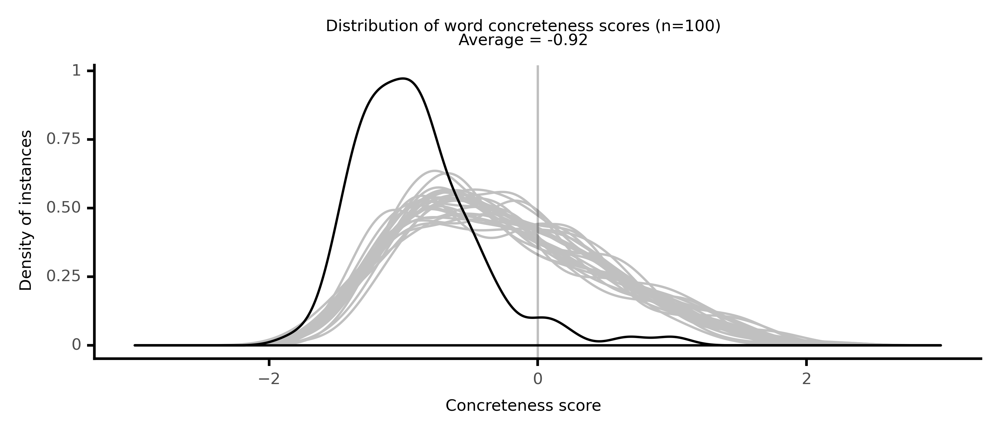

<ggplot: (8764115616477)>

100%|██████████| 100/100 [21:34<00:00, 12.95s/it]


In [9]:
show_extremes(dfall,name='abstract')